# Import packages

In [50]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import curve_fit
import torch
from torch.optim import Adam
import scipy.stats as stat
from scipy.stats import multivariate_normal
import sbi
import lsbi
from lsbi.network import BinaryClassifierLPop, BinaryClassifier
import math
import sys
import pickle
from datetime import datetime
import IPython
from concurrent.futures import ThreadPoolExecutor, TimeoutError
import time
from IPython.display import clear_output
from mpl_toolkits.mplot3d import Axes3D
from ipywidgets import interactive, HBox, VBox
import plotly.graph_objects as go
from ipywidgets import interact, FloatSlider
from torch import nn
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import ExponentialLR
from scipy.stats import norm
from torch.utils.data import DataLoader, TensorDataset

# Load and process data (if not specified it means for stats analysis)

In [2]:
# Define events as number of events total, this is the realy experimental data, not events per bin

def load_and_process_data(data_path):
    De = pd.read_csv(data_path, usecols=["Mass [GeV]", "Mass [GeV] LOW", "Mass [GeV] HIGH", "Events/10 GeV"])
    De_mass = De["Mass [GeV]"].values
    De_events_scaled = (De["Mass [GeV] HIGH"].values - De["Mass [GeV] LOW"].values) * De["Events/10 GeV"].values
    De_events_scaled_min = min([i for i in De_events_scaled if i != 0])
    De_event = De_events_scaled / De_events_scaled_min
    yerr = np.sqrt(De_event)
    return De_mass, De_event, yerr

# Load and process data (for curve fit and plotting)

In [3]:
def load_and_process_data_plotting(data_path):
    De = pd.read_csv(data_path, usecols=["Mass [GeV]", "Mass [GeV] LOW", "Mass [GeV] HIGH", "Events/10 GeV"])
    De_mass = De["Mass [GeV]"].values
    De_event = De["Events/10 GeV"].values
    yerr = np.sqrt(De_event)
    return De_mass, De_event, yerr

# Load and process data for plot checking

This is to check whether the Bayes factor is accurate  by seeing how each model optimises. If the Bayes factor comes out close to zero then we cna check this by seeing if both models optimise to similar losses.

In [4]:
def load_and_process_data_plot_check(data_path):
    De = pd.read_csv(data_path, usecols=["Mass [GeV]", "Mass [GeV] LOW", "Mass [GeV] HIGH", "Events/10 GeV"])
    De_mass = De["Mass [GeV]"].values
    return De_mass

# Checking stats scatter graph

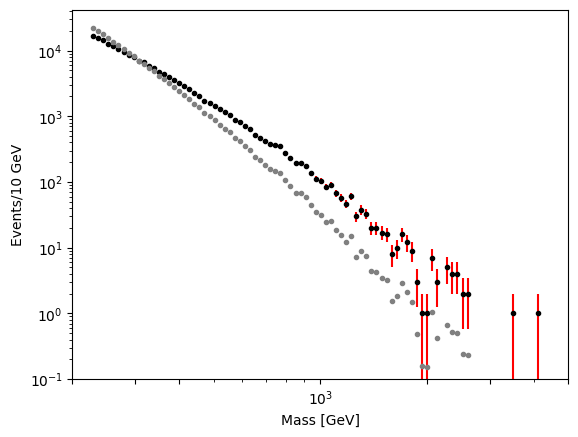

In [5]:
data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
De_mass, De_event, yerr = load_and_process_data(data_path)
De_mass_paper, De_event_paper, yerr_paper = load_and_process_data_plotting(data_path)

plt.errorbar(De_mass, De_event, yerr = yerr, fmt = '.', color = 'black', ecolor = 'red')
plt.errorbar(De_mass_paper, De_event_paper, fmt = '.', color = 'grey')
plt.xlim(0,4000)
plt.yscale("log")
plt.xscale("log")
plt.xlabel("Mass [GeV]")
plt.ylabel("Events/10 GeV")
plt.xlim(200, 4000)
plt.ylim(10**-1)
plt.xticks([200, 300, 400, 1000, 2000, 3000, 5000])
plt.show()

# Plot curve (using paper parameters and scatter date, not useful comparison)

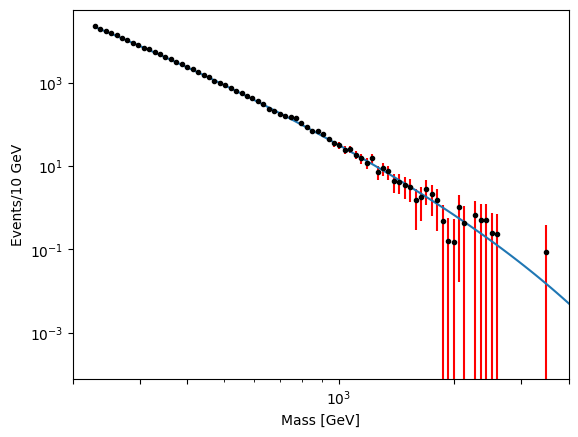

In [6]:
data_path = "/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv"
De_mass, De_event, yerr = load_and_process_data_plotting(data_path)

x_me = De_mass/13000
c_e = 1
a = 178000
b = 1.5
p0 = -12.38
p1 = -4.295
p2 = -0.9191
p3 = -0.0845
gamma = 2.4952
mz = 91.1876
# BW = (1/(2*np.pi)) + gamma/((De_mass - mz)**2 + (gamma**2)/4)
# BW1 = 1/((De_mass - mz)**2 + (gamma**2)/4)
BW2 = gamma / ((x_me*13000 - mz) ** 2 + gamma**2 / 4)

# curve = 178000/(np.trapz(De_event, De_mass)) * BW * ((1-x**(c_e))**b) * x ** (p0*(np.log10(x))**0 + p1*(np.log10(x)**1) + p2*(np.log10(x)**2) + p3*(np.log10(x))**3)
curve = BW2 * ((1-x_me**(c_e))**b) * x_me ** (p0*(np.log(x_me))**0 + p1*(np.log(x_me)**1) + p2*(np.log(x_me)**2) + p3*(np.log(x_me)**3))
norm = a/curve.sum(axis=-1)
curve1 = norm*curve
# print(f"{np.sum(De_event)}")

plt.errorbar(De_mass, De_event, yerr = yerr, fmt = '.', color = 'black', ecolor = 'red')
plt.plot(De_mass, curve1)
plt.xlim(0,4000)
plt.yscale("log")
plt.xscale("log")
plt.xlabel("Mass [GeV]")
plt.ylabel("Events/10 GeV")
plt.xlim(200, 4000)
plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
plt.show()

# Torch optimisation from agnostic prior distribution i = 2 (using stats data)

Initial Loss = 155.29806518554688
Final loss before filter = 7.247614860534668
Initial Loss = 154.6991424560547
Final loss before filter = 6.417407512664795
Initial Loss = 115.30853271484375
Final loss before filter = 4.97324275970459
Initial Loss = 69.56816864013672
Final loss before filter = 5.037042617797852
Initial Loss = 334.8861389160156
Final loss before filter = 6.9315314292907715
Initial Loss = 820.1826171875
Final loss before filter = 10.47519302368164
Initial Loss = 53.13823699951172
Final loss before filter = 5.942110538482666
Initial Loss = 78.9049301147461
Final loss before filter = 4.783339500427246
Initial Loss = 866.45849609375
Final loss before filter = 10.576117515563965
Initial Loss = 507.1123352050781
Final loss before filter = 8.976970672607422
Initial Loss = 765.8388671875
Final loss before filter = 8.002472877502441
Initial Loss = 62.138267517089844
Final loss before filter = 6.102444648742676
Initial Loss = 57.11666488647461
Final loss before filter = 4.7748541

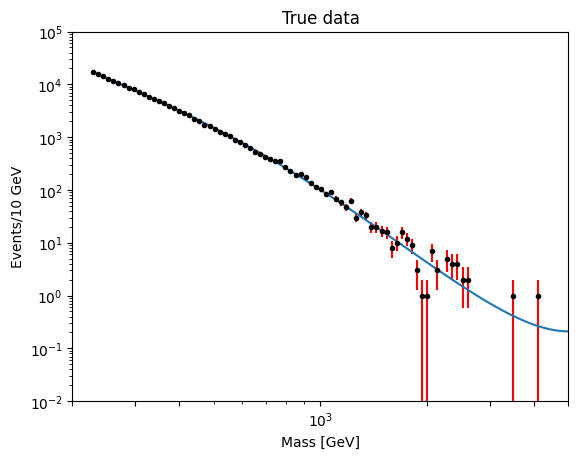

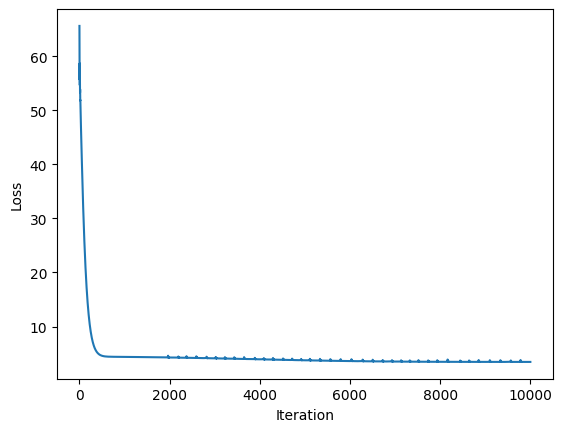

In [8]:
# By default optim_p2_poisson contains N = 10000 with loss filter of 4.3 and N filter = 4000

class optim_p2_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.2, -4.75, -0.95], high=[1.9 * 10**5, 5, -11.5, -4, -0.45])

    def curve_torch_2(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def adjust_theta_2(self):
        priors = self.create_priors()
        theta_opt = []
        for i in range(len(priors)):
            theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_2 = self.curve_torch_2(self.x_tensor, *theta_opt)

        if not all(y_val > 1 for y_val in y_pred_2[:80]) and all(y_val > 10**2 for y_val in y_pred_2[:1]) and all(y_pred_2[0] > elem for elem in y_pred_2[1:]):
            while not all(y_val > 1 for y_val in y_pred_2[:80]) and all(y_val > 10**2 for y_val in y_pred_2[:1]) and all(y_pred_2[0] > elem for elem in y_pred_2[1:]):
                priors = self.create_priors()
                theta_opt = []
                for i in range(len(priors)):
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_2 = self.curve_torch_2(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_2, self.y_tensor, self.y_err_tensor)
        else:
            loss = self.loglike(y_pred_2, self.y_tensor, self.y_err_tensor)
            theta_opt = theta_opt
            y_pred_2 = y_pred_2
        return loss, theta_opt, y_pred_2

    def run(self):
        success = False

        while not success:

            initial_loss, theta_opt, y_pred_2 = self.adjust_theta_2()
            theta_initial = theta_opt.clone().detach()
            self.theta_initial = theta_initial

            lr = 0.01
            optimizer = Adam([theta_opt], lr)
            loss = initial_loss
            losses = []
            max_N = 10000
            loss_crit = 1.5
            loss_filter = 4.4
            N_iter_filter = 1000
            N_iter = 0

            while N_iter < max_N:
                if N_iter == 0:
                    print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_2 = self.curve_torch_2(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_2, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == N_iter_filter and loss > loss_filter:
                    print(f"Final loss before filter = {losses[-1]}")
                    # print("Loss too high. Starting again.")
                    break
                # if N_iter == N_iter_filter and loss < loss_filter:
                    # print(f"Loss at filter = {losses[-1]}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.max_N = max_N
            self.loss_filter = loss_filter
            self.N_iter_filter = N_iter_filter
            self.learning_rate = lr
            self.losses = np.array(losses)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # Plot results

            plt.errorbar(self.De_mass, self.De_event, yerr=self.yerr, fmt='.', color='black', ecolor='red')
            y_pred_2_plot = self.curve_torch_2(self.x_tensor, *theta_final).detach().numpy()
            plt.plot(self.De_mass, y_pred_2_plot)
            plt.yscale("log")
            plt.xscale("log")
            plt.xlabel("Mass [GeV]")
            plt.ylabel("Events/10 GeV")
            plt.xlim(200, 5000)
            plt.ylim(bottom=10**-2, top=10**5)
            plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
            plt.title("True data")
            plt.show()

            # plt.errorbar(De_mass, De_event.round(), yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_2_plot = self.curve_torch_2(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_2_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("Rounded data")

            f_loss,a_loss = plt.subplots()
            a_loss.plot(losses)
            # a_loss.set_yscale("log")
            a_loss.set_ylabel("Loss")
            a_loss.set_xlabel("Iteration")
            # a_loss.set_xlim(N_iter-1000, N_iter)
            # a_loss.set_ylim(0.55, 0.6)


# Usage
data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'

optimizer_class = optim_p2_poisson(data_path)
optimizer_class.run()

# Torch optimisation from agnostic prior distributions i = 3 (using stats data)

Initial Loss = 183.81126403808594
Final loss before filter = 4.2263689041137695
Initial Loss = 3151.867431640625
Final loss before filter = 6.461467742919922
Initial Loss = 21162.73828125
Final loss before filter = 18.243289947509766
Initial Loss = 5982.4326171875
Final loss before filter = 15.95765495300293
Initial Loss = 7819.16162109375
Final loss before filter = 18.431367874145508
Initial Loss = 44.162750244140625
Final loss before filter = 5.540014266967773
Initial Loss = 10247.82421875
Final loss before filter = 5.178957462310791
Initial Loss = 9151.9775390625
Final loss before filter = 34.476219177246094
Initial Loss = 27821.912109375
Final loss before filter = 39.046268463134766
Initial Loss = 9529.9453125
Final loss before filter = 40.43220901489258
Initial Loss = 2345.677490234375
Final loss before filter = 6.228646278381348
Initial Loss = 10285.2255859375
Final loss before filter = 8.15925407409668
Initial Loss = 5044.55029296875
Final loss before filter = 14.921528816223145

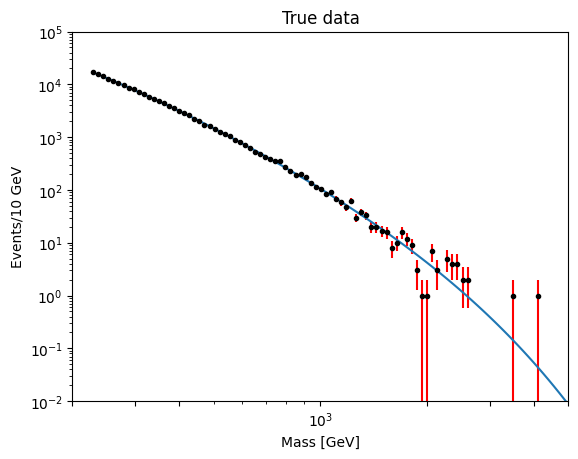

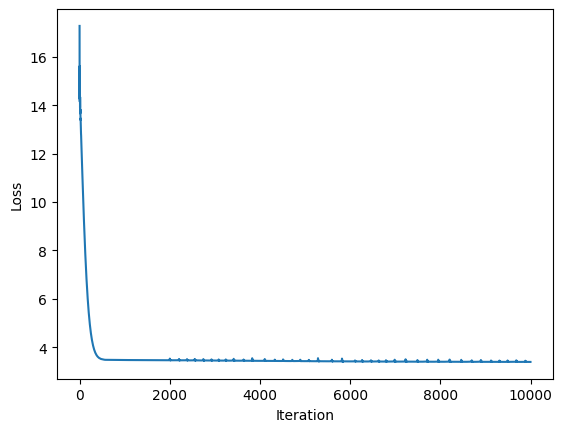

In [6]:
# By default optim_p3_poisson contains N = 1400 with loss filter of 3.37 and N filter = 1000

class optim_p3_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.5, -5.2, -0.95, -0.1], high=[1.9 * 10**5, 5, -11, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        # print(f"Norm = {norm_ft}")
        # print(f"Base function = {((1 - x ** self.c_e_ft) ** b_ft)}")
        # print(f"X function = {x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)}")
        # print(f"BW2 = {BW2}")
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def adjust_theta_3(self):
        priors = self.create_priors()
        theta_opt = []
        for i in range(len(priors)):
            theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
        
        if not all(y_val > 1 for y_val in y_pred_3[:80]) and all(y_val > 10**2 for y_val in y_pred_3[:1]) and all(y_pred_3[0] > elem for elem in y_pred_3[1:]):
            while not all(y_val > 1 for y_val in y_pred_3[:80]) and all(y_val > 10**2 for y_val in y_pred_3[:1]) and all(y_pred_3[0] > elem for elem in y_pred_3[1:]):
                priors = self.create_priors()
                theta_opt = []
                for i in range(len(priors)):
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        else:
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
            theta_opt = theta_opt
            y_pred_3 = y_pred_3
        return loss, theta_opt, y_pred_3

    def run(self):
        
        success = False

        while not success:
            initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3()
            theta_initial = theta_opt.clone().detach()
            self.theta_initial = theta_initial

            lr = 0.001
            loss = initial_loss
            losses = []
            max_N = 10000
            N_iter_filter = 1000
            loss_crit = 1.5
            loss_filter = 3.5
            N_iter = 0
            optimizer = Adam([theta_opt], lr)

            while N_iter < max_N:
                if N_iter == 0:
                    print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == N_iter_filter and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    print(f"Final loss before filter = {losses[-1]}")
                    break
                # if N_iter == N_iter_filter and loss < loss_filter:
                    # print(f"Loss at {N_iter_filter} iterations = {loss}")

            if N_iter == max_N:
                success = True

        if success == True:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])

            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.max_N = max_N
            self.loss_filter = loss_filter
            self.N_iter_filter = N_iter_filter
            self.learning_rate = lr
            self.losses = np.array(losses)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # Plot results

            plt.errorbar(self.De_mass, self.De_event, yerr=self.yerr, fmt='.', color='black', ecolor='red')
            y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            plt.plot(self.De_mass, y_pred_3_plot)
            plt.yscale("log")
            plt.xscale("log")
            plt.xlabel("Mass [GeV]")
            plt.ylabel("Events/10 GeV")
            plt.xlim(200, 5000)
            plt.ylim(bottom = 10**-2, top=10**5)
            plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
            plt.title("True data")
            plt.show()

            f_loss,a_loss = plt.subplots()
            a_loss.plot(losses)
            # a_loss.set_yscale("log")
            a_loss.set_ylabel("Loss")
            a_loss.set_xlabel("Iteration")
            # a_loss.set_xlim(N_iter-1000, N_iter)
            # a_loss.set_ylim(0.55, 0.6)

# Usage
data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'

optimizer_class = optim_p3_poisson(data_path)
optimizer_class.run()

# for j in range(5):
#     losses_to_avg = []
#     for i in range (60):
#         optimizer_class = optim_p3_poisson(data_path)
#         optimizer_class.run()

#         losses_array = optimizer_class.losses
#         final_loss = losses_array[-1]
#         losses_to_avg.append(final_loss)
#     print(f"Average loss = {np.mean(losses_to_avg)}")

# Torch optimisation from agnostic prior distributions i = 4 (using stats data)

Initial Loss = 6939.02099609375
Final loss before filter = 15.409482955932617
Initial Loss = 1767.456787109375
Final loss before filter = 5.251731872558594
Initial Loss = 5933.64892578125
Final loss before filter = 15.222404479980469
Initial Loss = 710.4585571289062
Final loss before filter = 4.533277988433838
Initial Loss = 18061.29296875
Final loss before filter = 52.54680633544922
Initial Loss = 11285.9453125
Final loss before filter = 11.452642440795898
Initial Loss = 1000.0694580078125
Final loss before filter = 3.989873170852661
Initial Loss = 14603.1943359375
Final loss before filter = 33.3562126159668
Initial Loss = 7403.55615234375
Final loss before filter = 16.5470027923584
Initial Loss = 1706.1416015625
Final loss before filter = 5.490742206573486
Initial Loss = 202.62002563476562
Final loss before filter = 6.356531620025635
Initial Loss = 15313.8486328125
Final loss before filter = 29.151498794555664
Initial Loss = 680.5632934570312
Final loss before filter = 4.052405357360

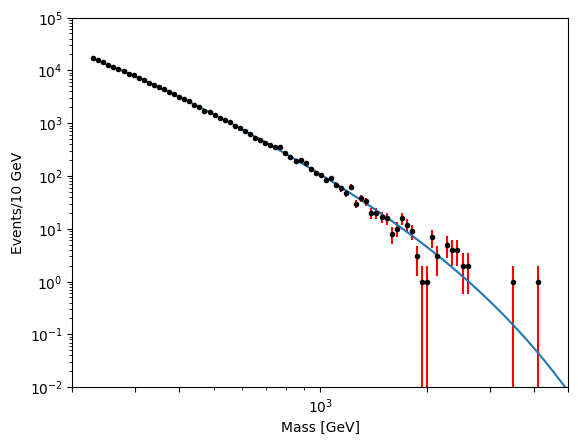

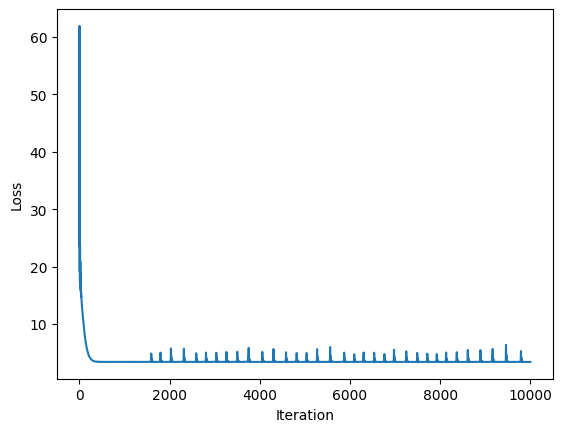

In [7]:
### Sped up version of class but now for fixd abp0

class optim_p4_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.5, -5.2, -0.95, -0.1, -0.006], high=[1.9 * 10**5, 5, -11, -3.5, -0.45, -0.04, -0.001])

    def curve_torch_4(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft, p4_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3 + p4_ft * log_x ** 4)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def adjust_theta_4(self):
        priors = self.create_priors()
        theta_opt = []
        for i in range(len(priors)):
            theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_4 = self.curve_torch_4(self.x_tensor, *theta_opt)

        if not all(y_val > 1 for y_val in y_pred_4[:80]) and all(y_val > 10**2 for y_val in y_pred_4[:1]) and all(y_pred_4[0] > elem for elem in y_pred_4[1:]):
            while not all(y_val > 1 for y_val in y_pred_4[:80]) and all(y_val > 10**2 for y_val in y_pred_4[:1]) and all(y_pred_4[0] > elem for elem in y_pred_4[1:]):
                priors = self.create_priors()
                theta_opt = []
                for i in range(len(priors)):
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_4 = self.curve_torch_4(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_4, self.y_tensor, self.y_err_tensor)
        else:
            loss = self.loglike(y_pred_4, self.y_tensor, self.y_err_tensor)
            theta_opt = theta_opt
            y_pred_4 = y_pred_4
        return loss, theta_opt, y_pred_4

    def run(self):
        success = False

        while not success:
            initial_loss, theta_opt, y_pred_4 = self.adjust_theta_4()
            theta_initial = theta_opt.clone().detach()
            self.theta_initial = theta_initial

            lr = 0.001
            loss = initial_loss
            losses = []
            max_N = 10000
            loss_crit = 1.5
            loss_filter = 3.5
            N_iter_filter = 1000
            N_iter = 0
            optimizer = Adam([theta_opt], lr)

            while N_iter < max_N:
                if N_iter == 0:
                    print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_4 = self.curve_torch_4(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_4, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == N_iter_filter and loss > loss_filter:
                    print(f"Final loss before filter = {losses[-1]}")
                    # print("Loss too high. Starting again.")
                    break
                # if N_iter == N_iter_filter and loss < loss_filter:
                    # print(f"Loss at 1000 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:
            
            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
                
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.max_N = max_N
            self.loss_filter = loss_filter
            self.N_iter_filter = N_iter_filter
            self.learning_rate = lr
            self.losses = np.array(losses)
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)

            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")

            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # Plot results

            plt.errorbar(self.De_mass, self.De_event, yerr=self.yerr, fmt='.', color='black', ecolor='red')
            y_pred_4_plot = self.curve_torch_4(self.x_tensor, *theta_final).detach().numpy()
            plt.plot(self.De_mass, y_pred_4_plot)
            plt.yscale("log")
            plt.xscale("log")
            plt.xlabel("Mass [GeV]")
            plt.ylabel("Events/10 GeV")
            plt.xlim(200, 5000)
            plt.ylim(bottom = 10**-2, top=10**5)
            plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
            plt.show()

            f_loss,a_loss = plt.subplots()
            a_loss.plot(losses)
            # a_loss.set_yscale("log")
            a_loss.set_ylabel("Loss")
            a_loss.set_xlabel("Iteration")
            # a_loss.set_xlim(N_iter-1000, N_iter)
            # a_loss.set_ylim(0.55, 0.6)

# Usage
data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'

optimizer_class = optim_p4_poisson(data_path)
optimizer_class.run()

# for j in range(5):
#     losses_to_avg = []
#     for i in range (60):
#         optimizer_class = optim_p4_poisson(data_path)
#         optimizer_class.run()

#         losses_array = optimizer_class.losses
#         final_loss = losses_array[-1]
#         losses_to_avg.append(final_loss)
#     print(f"Average loss = {np.mean(losses_to_avg)}")

# Calculating loglike for i = 2, 3, 4 for use later

## i = 2

In [67]:
# By default optim_p2_poisson contains N = 10000 with loss filter of 4.2 and N filter = 4000

class optim_p2_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.2, -4.75, -0.95], high=[1.9 * 10**5, 5, -11.5, -4, -0.45])

    def curve_torch_2(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 40

    def adjust_theta_2(self):
        priors = self.create_priors()
        theta_opt = []
        for i in range(len(priors)):
            theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_2 = self.curve_torch_2(self.x_tensor, *theta_opt)

        if not all(y_val > 1 for y_val in y_pred_2[:80]) and all(y_val > 10**2 for y_val in y_pred_2[:1]) and all(y_pred_2[0] > elem for elem in y_pred_2[1:]):
            while not all(y_val > 1 for y_val in y_pred_2[:80]) and all(y_val > 10**2 for y_val in y_pred_2[:1]) and all(y_pred_2[0] > elem for elem in y_pred_2[1:]):
                priors = self.create_priors()
                theta_opt = []
                for i in range(len(priors)):
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_2 = self.curve_torch_2(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_2, self.y_tensor, self.y_err_tensor)
        else:
            loss = self.loglike(y_pred_2, self.y_tensor, self.y_err_tensor)
            theta_opt = theta_opt
            y_pred_2 = y_pred_2
        return loss, theta_opt, y_pred_2

    def run(self):
        success = False

        while not success:

            initial_loss, theta_opt, y_pred_2 = self.adjust_theta_2()
            theta_initial = theta_opt.clone().detach()
            self.theta_initial = theta_initial

            lr = 0.01
            optimizer = Adam([theta_opt], lr)
            loss = initial_loss
            losses = []
            max_N = 10000
            loss_crit = 1.5
            loss_filter = 4.4
            N_iter_filter = 1000
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                #     print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_2 = self.curve_torch_2(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_2, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == N_iter_filter and loss > loss_filter:
                    print(f"Final loss before filter = {losses[-1]}")
                    # print("Loss too high. Starting again.")
                    break
                # if N_iter == N_iter_filter and loss < loss_filter:
                    # print(f"Loss at filter = {losses[-1]}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N and losses[-1] < loss_filter:
                success = True

        if success == True:

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.max_N = max_N
            self.loss_filter = loss_filter
            self.N_iter_filter = N_iter_filter
            self.learning_rate = lr
            self.losses = np.array(losses)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # # Plot results

            # plt.errorbar(self.De_mass, self.De_event, yerr=self.yerr, fmt='.', color='black', ecolor='red')
            # y_pred_2_plot = self.curve_torch_2(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(self.De_mass, y_pred_2_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 5000)
            # plt.ylim(bottom=10**-2, top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
            # plt.title("True data")
            # plt.show()

            # # plt.errorbar(De_mass, De_event.round(), yerr=yerr, fmt='.', color='black', ecolor='red')
            # # y_pred_2_plot = self.curve_torch_2(self.x_tensor, *theta_final).detach().numpy()
            # # plt.plot(De_mass, y_pred_2_plot)
            # # plt.yscale("log")
            # # plt.xscale("log")
            # # plt.xlabel("Mass [GeV]")
            # # plt.ylabel("Events/10 GeV")
            # # plt.xlim(200, 4000)
            # # plt.ylim(top=10**5)
            # # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # # plt.title("Rounded data")

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

# Usage
data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'

optimizer_class = optim_p2_poisson(data_path)
optimizer_class.run()

theta_initials = []
theta_finals = []
final_losses = []
max_N_array = []
loss_filter_array = []
N_iter_filter_array = []
lr_array= []

def save_multiple_arrays_with_timestamp(*arrays, base_filename='saved_opt_var_and_loss'):
    """
    Saves multiple NumPy arrays to a single file with a timestamp, keeping them separate.
    
    Parameters:
    - arrays: Multiple NumPy array objects passed as separate arguments.
    - base_filename: Optional. Base name of the file without extension.
    
    The function saves the file in the current directory with the format:
    `base_filename_YYYYMMDD_HHMMSS.npz`

    Array1 = log_K_array
    Array2 = log_K_array_sub_array_means
    Array3 = log_K_array_means
    """
    # Format the current date and time as YYYYMMDD_HHMMSS
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    
    # Construct the filename with base_filename and timestamp
    filename = f'{base_filename}_{timestamp}.npz'
    
    # Prepare the arrays dict to save; keys are array0, array1, etc.
    arrays_dict = {f'array{i}': array for i, array in enumerate(arrays)}
    
    # Save the arrays to the file using np.savez
    np.savez(filename, **arrays_dict)
    
    print(f'Arrays saved as {filename}')
    

for j in range(1000):
    optimizer_class.run()

    theta_initial = optimizer_class.theta_initial
    theta_final = optimizer_class.theta_final
    max_N = optimizer_class.max_N
    loss_filter = optimizer_class.loss_filter
    N_iter_filter = optimizer_class.N_iter_filter
    lr = optimizer_class.learning_rate
    losses_array = optimizer_class.losses

    final_loss = losses_array[-1]
    final_losses.append(final_loss)
    theta_initials.append(theta_initial.clone().detach().numpy())
    theta_finals.append(theta_final.clone().detach().numpy())
    max_N_array.append(max_N)
    loss_filter_array.append(loss_filter)
    N_iter_filter_array.append(N_iter_filter)
    lr_array.append(lr)


save_multiple_arrays_with_timestamp(final_losses, theta_initials, theta_finals, max_N_array, loss_filter_array, N_iter_filter_array, lr_array, base_filename='saved_opt_var_and_loss_p2')


Final loss before filter = 6.782723903656006
Final loss before filter = 13.969315528869629
Final loss before filter = 4.851410388946533
Final loss before filter = 6.372922897338867
Final loss before filter = 6.833518981933594
Final loss before filter = 5.886975288391113
Final loss before filter = 5.2506585121154785
Final loss before filter = 4.539872169494629
Final loss before filter = 6.083723545074463
Final loss before filter = 7.213179111480713
Final loss before filter = 5.208113670349121
Final loss before filter = 5.574755668640137
Final loss before filter = 5.826541900634766
Final loss before filter = 7.436766147613525
Final loss before filter = 7.157350540161133
Final loss before filter = 6.094940662384033
Final loss before filter = 6.313943386077881
Final loss before filter = 7.2912702560424805
Final loss before filter = 18.70038604736328
Final loss before filter = 4.986935615539551
Final loss before filter = 8.02207088470459
Final loss before filter = 6.6957106590271
Final loss

## i = 3

In [ ]:
class optim_p3_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.5, -5.2, -0.95, -0.1], high=[1.9 * 10**5, 5, -11, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        # print(f"Norm = {norm_ft}")
        # print(f"Base function = {((1 - x ** self.c_e_ft) ** b_ft)}")
        # print(f"X function = {x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)}")
        # print(f"BW2 = {BW2}")
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def adjust_theta_3(self):
        priors = self.create_priors()
        theta_opt = []
        for i in range(len(priors)):
            theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
        
        if not all(y_val > 1 for y_val in y_pred_3[:80]) and all(y_val > 10**2 for y_val in y_pred_3[:1]) and all(y_pred_3[0] > elem for elem in y_pred_3[1:]):
            while not all(y_val > 1 for y_val in y_pred_3[:80]) and all(y_val > 10**2 for y_val in y_pred_3[:1]) and all(y_pred_3[0] > elem for elem in y_pred_3[1:]):
                priors = self.create_priors()
                theta_opt = []
                for i in range(len(priors)):
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        else:
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
            theta_opt = theta_opt
            y_pred_3 = y_pred_3
        return loss, theta_opt, y_pred_3

    def run(self):
        
        success = False

        while not success:
            initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3()
            theta_initial = theta_opt.clone().detach()
            self.theta_initial = theta_initial

            lr = 0.001
            loss = initial_loss
            losses = []
            max_N = 10000
            N_iter_filter = 1000
            loss_crit = 1.5
            loss_filter = 3.5
            N_iter = 0
            optimizer = Adam([theta_opt], lr)

            while N_iter < max_N:
                # if N_iter == 0:
                #     print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == N_iter_filter and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    print(f"Final loss before filter = {losses[-1]}")
                    break
                # if N_iter == N_iter_filter and loss < loss_filter:
                    # print(f"Loss at {N_iter_filter} iterations = {loss}")

            if N_iter == max_N and losses[-1] < loss_filter:
                success = True

        if success == True:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])

            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.max_N = max_N
            self.loss_filter = loss_filter
            self.N_iter_filter = N_iter_filter
            self.learning_rate = lr
            self.losses = np.array(losses)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # # Plot results

            # plt.errorbar(self.De_mass, self.De_event, yerr=self.yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(self.De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 5000)
            # plt.ylim(bottom = 10**-2, top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
            # plt.title("True data")
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

# Usage
data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'

optimizer_class = optim_p3_poisson(data_path)

theta_initials = []
theta_finals = []
final_losses = []
max_N_array = []
loss_filter_array = []
N_iter_filter_array = []
lr_array= []

def save_multiple_arrays_with_timestamp(*arrays, base_filename='saved_opt_var_and_loss_p3'):
    """
    Saves multiple NumPy arrays to a single file with a timestamp, keeping them separate.
    
    Parameters:
    - arrays: Multiple NumPy array objects passed as separate arguments.
    - base_filename: Optional. Base name of the file without extension.
    
    The function saves the file in the current directory with the format:
    `base_filename_YYYYMMDD_HHMMSS.npz`

    Array1 = log_K_array
    Array2 = log_K_array_sub_array_means
    Array3 = log_K_array_means
    """
    # Format the current date and time as YYYYMMDD_HHMMSS
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    
    # Construct the filename with base_filename and timestamp
    filename = f'{base_filename}_{timestamp}.npz'
    
    # Prepare the arrays dict to save; keys are array0, array1, etc.
    arrays_dict = {f'array{i}': array for i, array in enumerate(arrays)}
    
    # Save the arrays to the file using np.savez
    np.savez(filename, **arrays_dict)
    
    print(f'Arrays saved as {filename}')
    

for j in range(1000):
    optimizer_class.run()

    theta_initial = optimizer_class.theta_initial
    theta_final = optimizer_class.theta_final
    max_N = optimizer_class.max_N
    loss_filter = optimizer_class.loss_filter
    N_iter_filter = optimizer_class.N_iter_filter
    lr = optimizer_class.learning_rate
    losses_array = optimizer_class.losses

    final_loss = losses_array[-1]
    final_losses.append(final_loss)
    theta_initials.append(theta_initial.clone().detach().numpy())
    theta_finals.append(theta_final.clone().detach().numpy())
    max_N_array.append(max_N)
    loss_filter_array.append(loss_filter)
    N_iter_filter_array.append(N_iter_filter)
    lr_array.append(lr)

save_multiple_arrays_with_timestamp(final_losses, theta_initials, theta_finals, max_N_array, loss_filter_array, N_iter_filter_array, lr_array, base_filename='saved_opt_var_and_loss_p3')


Final loss before filter = 72.85782623291016
Final loss before filter = 167.7430877685547
Final loss before filter = 52.656097412109375
Final loss before filter = 72.9185562133789
Final loss before filter = 33.59579086303711
Final loss before filter = 63.98338317871094
Final loss before filter = 3.5499134063720703
Final loss before filter = 14.220219612121582
Final loss before filter = 56.06797409057617
Final loss before filter = 29.20012664794922
Final loss before filter = 81.96065521240234
Final loss before filter = 26.53125
Final loss before filter = 5.425561904907227
Final loss before filter = 5.745451927185059
Final loss before filter = 10.469915390014648
Final loss before filter = 4.9247822761535645
Final loss before filter = 6.089963436126709
Final loss before filter = 61.380577087402344
Final loss before filter = 8.888283729553223
Final loss before filter = 3.8029279708862305
Final loss before filter = 8.722649574279785
Final loss before filter = 11.773289680480957
Final loss b

## i = 4

In [ ]:
class optim_p4_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.5, -5.2, -0.95, -0.1, -0.006], high=[1.9 * 10**5, 5, -11, -3.5, -0.45, -0.04, -0.001])

    def curve_torch_4(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft, p4_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3 + p4_ft * log_x ** 4)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def adjust_theta_4(self):
        priors = self.create_priors()
        theta_opt = []
        for i in range(len(priors)):
            theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_4 = self.curve_torch_4(self.x_tensor, *theta_opt)

        if not all(y_val > 1 for y_val in y_pred_4[:80]) and all(y_val > 10**2 for y_val in y_pred_4[:1]) and all(y_pred_4[0] > elem for elem in y_pred_4[1:]):
            while not all(y_val > 1 for y_val in y_pred_4[:80]) and all(y_val > 10**2 for y_val in y_pred_4[:1]) and all(y_pred_4[0] > elem for elem in y_pred_4[1:]):
                priors = self.create_priors()
                theta_opt = []
                for i in range(len(priors)):
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_4 = self.curve_torch_4(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_4, self.y_tensor, self.y_err_tensor)
        else:
            loss = self.loglike(y_pred_4, self.y_tensor, self.y_err_tensor)
            theta_opt = theta_opt
            y_pred_4 = y_pred_4
        return loss, theta_opt, y_pred_4

    def run(self):
        success = False

        while not success:
            initial_loss, theta_opt, y_pred_4 = self.adjust_theta_4()
            theta_initial = theta_opt.clone().detach()
            self.theta_initial = theta_initial

            lr = 0.001
            loss = initial_loss
            losses = []
            max_N = 10000
            loss_crit = 1.5
            loss_filter = 3.5
            N_iter_filter = 1000
            N_iter = 0
            optimizer = Adam([theta_opt], lr)

            while N_iter < max_N:
                # if N_iter == 0:
                #     print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_4 = self.curve_torch_4(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_4, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == N_iter_filter and loss > loss_filter:
                    print(f"Final loss before filter = {losses[-1]}")
                    # print("Loss too high. Starting again.")
                    break
                # if N_iter == N_iter_filter and loss < loss_filter:
                    # print(f"Loss at 1000 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N and losses[-1] < loss_filter:
                success = True

        if success == True:
            
            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
                
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.max_N = max_N
            self.loss_filter = loss_filter
            self.N_iter_filter = N_iter_filter
            self.learning_rate = lr
            self.losses = np.array(losses)
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)

            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")

            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # # Plot results

            # plt.errorbar(self.De_mass, self.De_event, yerr=self.yerr, fmt='.', color='black', ecolor='red')
            # y_pred_4_plot = self.curve_torch_4(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(self.De_mass, y_pred_4_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 5000)
            # plt.ylim(bottom = 10**-2, top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

# Usage
data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'

optimizer_class = optim_p4_poisson(data_path)

theta_initials = []
theta_finals = []
final_losses = []
max_N_array = []
loss_filter_array = []
N_iter_filter_array = []
lr_array= []

def save_multiple_arrays_with_timestamp(*arrays, base_filename='saved_opt_var_and_loss_p4'):
    """
    Saves multiple NumPy arrays to a single file with a timestamp, keeping them separate.
    
    Parameters:
    - arrays: Multiple NumPy array objects passed as separate arguments.
    - base_filename: Optional. Base name of the file without extension.
    
    The function saves the file in the current directory with the format:
    `base_filename_YYYYMMDD_HHMMSS.npz`

    Array1 = log_K_array
    Array2 = log_K_array_sub_array_means
    Array3 = log_K_array_means
    """
    # Format the current date and time as YYYYMMDD_HHMMSS
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    
    # Construct the filename with base_filename and timestamp
    filename = f'{base_filename}_{timestamp}.npz'
    
    # Prepare the arrays dict to save; keys are array0, array1, etc.
    arrays_dict = {f'array{i}': array for i, array in enumerate(arrays)}
    
    # Save the arrays to the file using np.savez
    np.savez(filename, **arrays_dict)
    
    print(f'Arrays saved as {filename}')
    

for j in range(1000):
    optimizer_class.run()

    theta_initial = optimizer_class.theta_initial
    theta_final = optimizer_class.theta_final
    max_N = optimizer_class.max_N
    loss_filter = optimizer_class.loss_filter
    N_iter_filter = optimizer_class.N_iter_filter
    lr = optimizer_class.learning_rate
    losses_array = optimizer_class.losses

    final_loss = losses_array[-1]
    final_losses.append(final_loss)
    theta_initials.append(theta_initial.clone().detach().numpy())
    theta_finals.append(theta_final.clone().detach().numpy())
    max_N_array.append(max_N)
    loss_filter_array.append(loss_filter)
    N_iter_filter_array.append(N_iter_filter)
    lr_array.append(lr)

save_multiple_arrays_with_timestamp(final_losses, theta_initials, theta_finals, max_N_array, loss_filter_array, N_iter_filter_array, lr_array, base_filename='saved_opt_var_and_loss_p4')

Final loss before filter = 13.359808921813965
Final loss before filter = 5.322621822357178
Final loss before filter = 88.97032928466797
Final loss before filter = 8.67476749420166
Final loss before filter = 22.76392364501953
Final loss before filter = 5.215037822723389
Final loss before filter = 3.526235818862915
Final loss before filter = 32.075706481933594
Final loss before filter = 23.45427703857422
Final loss before filter = 24.3134708404541
Final loss before filter = 3.5795202255249023
Final loss before filter = 6.4853596687316895
Final loss before filter = 5.049346923828125
Final loss before filter = 4.086604118347168
Final loss before filter = 20.726163864135742
Final loss before filter = 3.6026198863983154
Final loss before filter = 14.213221549987793
Final loss before filter = 3.696720600128174
Final loss before filter = 58.45246505737305
Final loss before filter = 17.47382164001465
Final loss before filter = 8.596689224243164
Final loss before filter = 42.31236267089844
Final

## Parameter spaces after optimisation

3.376145
3.4400434


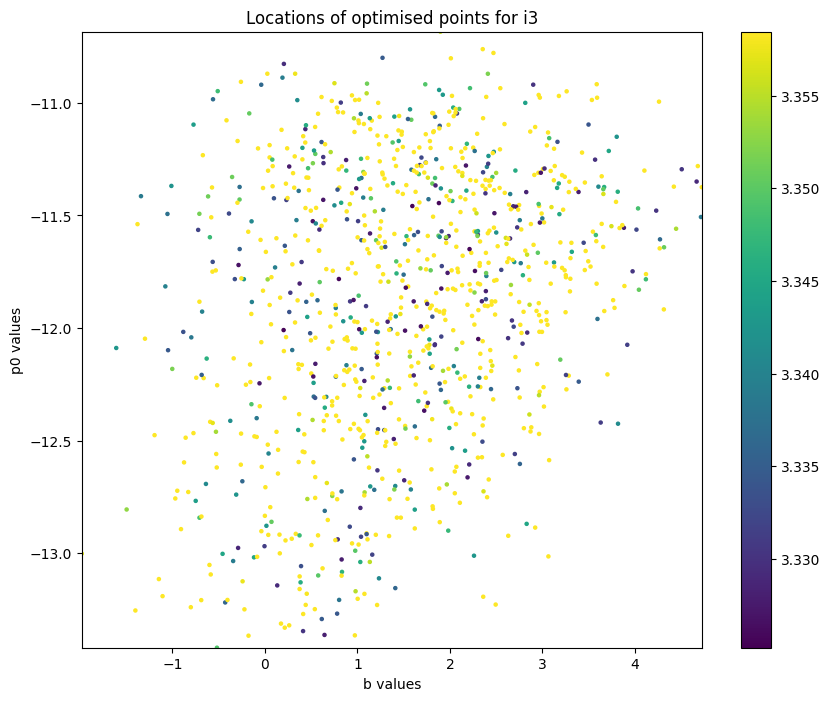

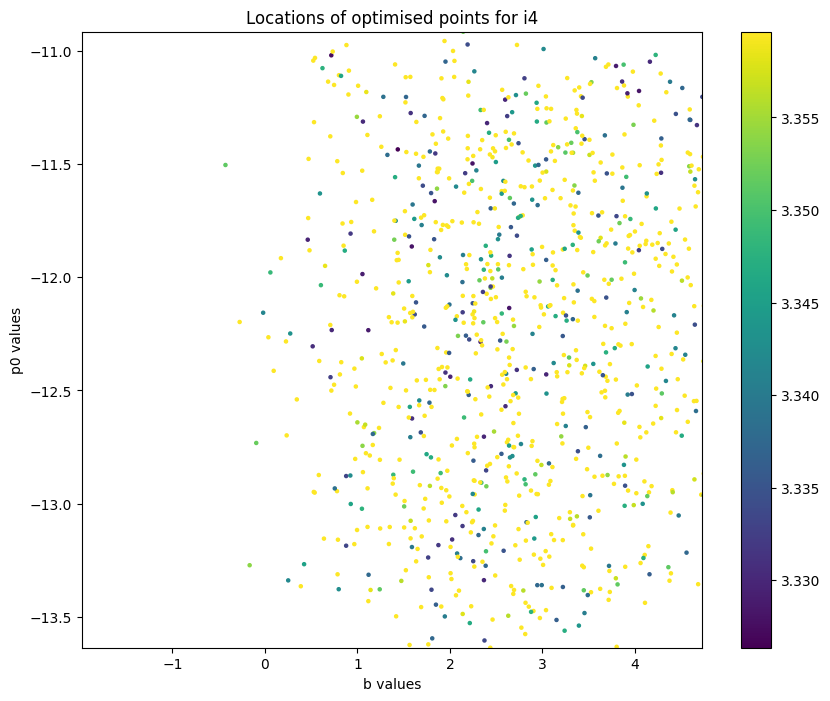

------------------------------------------------------------------------------------------------


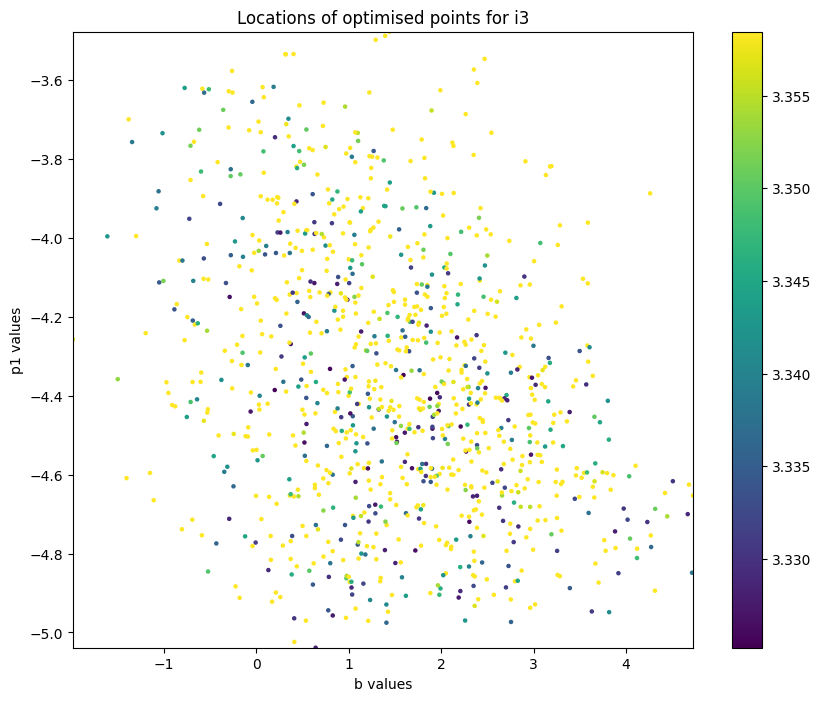

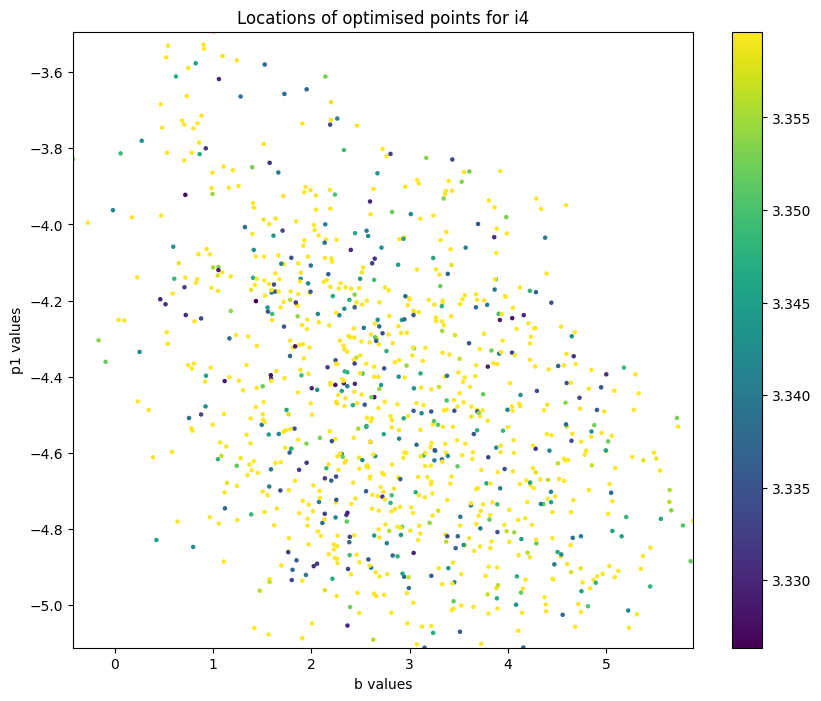

------------------------------------------------------------------------------------------------


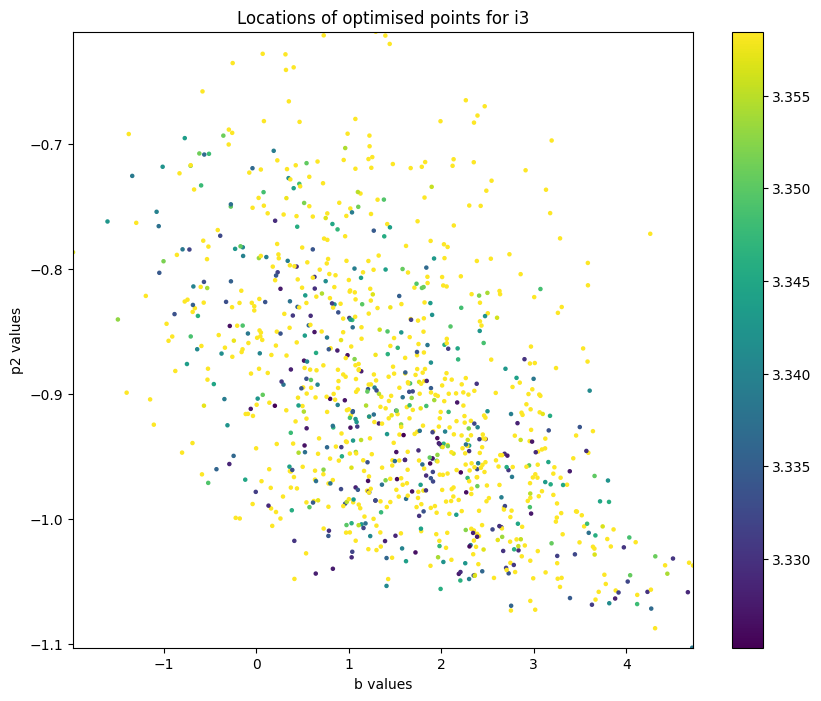

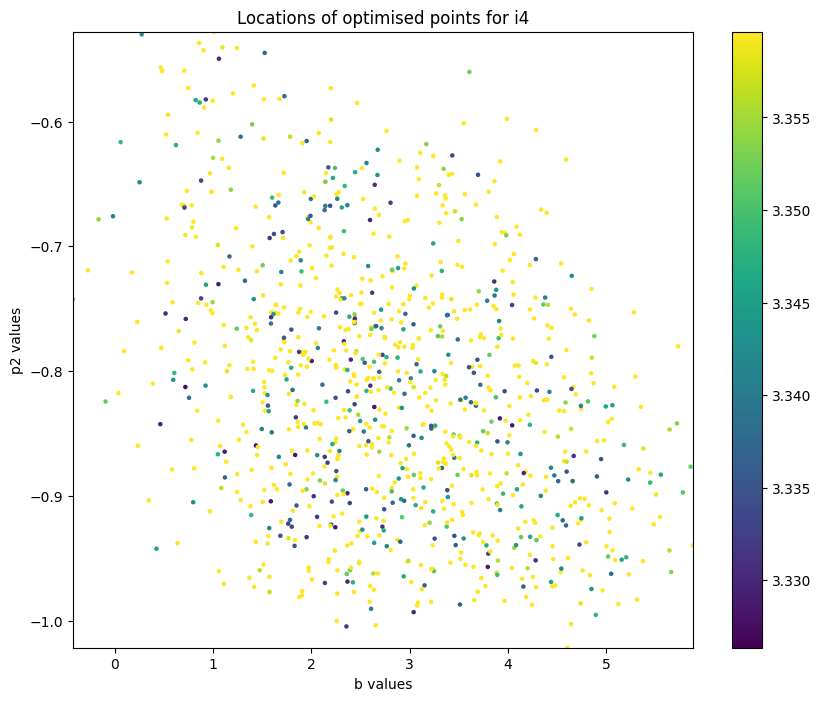

------------------------------------------------------------------------------------------------


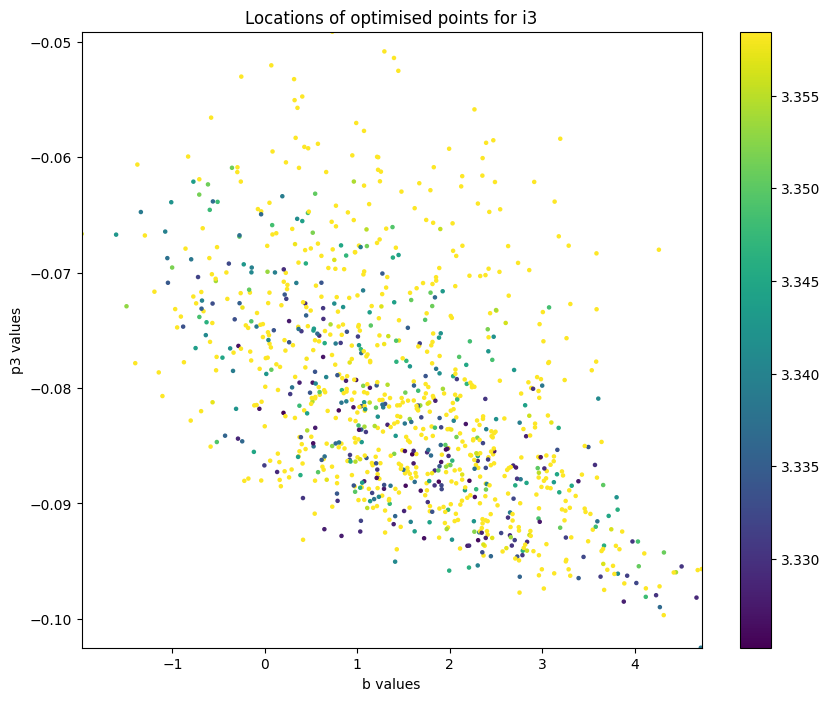

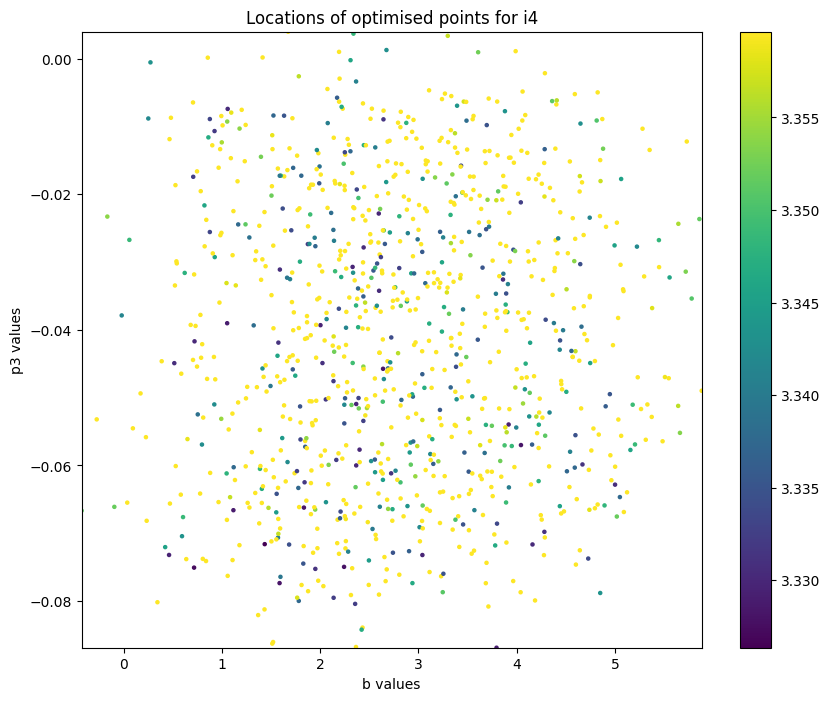

------------------------------------------------------------------------------------------------


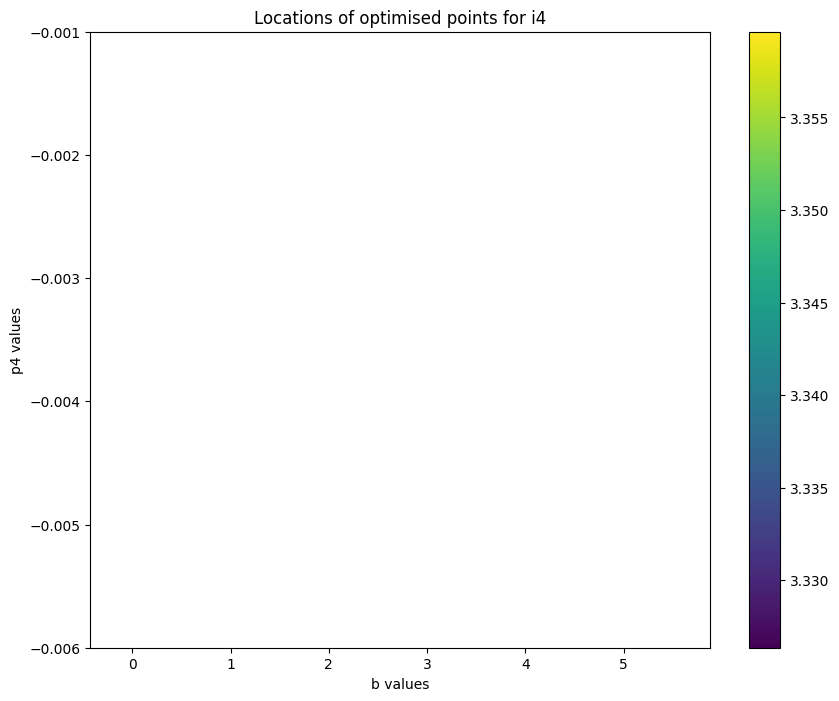

In [15]:
# Round 1

# filei3 = 'saved_opt_var_and_loss_p3_20240403_022348.npz'
# filei4 = 'saved_opt_var_and_loss_p4_20240403_061101.npz

# Final run

filei3 = 'saved_opt_var_and_loss_p3_20240411_143134.npz'
filei4 = 'saved_opt_var_and_loss_p4_20240411_185606.npz'

final_losses_3 = np.load(filei3)['array0']
final_losses_4 = np.load(filei4)['array0']

print(np.mean(final_losses_3))
print(np.mean(final_losses_4))

theta_finals_3 = np.load(filei3)['array2']
theta_finals_4 = np.load(filei4)['array2']

b_values_3 = np.array([theta_finals_3[i][1] for i in range(len(theta_finals_3))])
b_values_4 = np.array([theta_finals_4[i][1] for i in range(len(theta_finals_4))])
p0_values_3 = np.array([theta_finals_3[i][2] for i in range(len(theta_finals_3))])
p0_values_4 = np.array([theta_finals_4[i][2] for i in range(len(theta_finals_4))])
p1_values_3 = np.array([theta_finals_3[i][3] for i in range(len(theta_finals_3))])
p1_values_4 = np.array([theta_finals_4[i][3] for i in range(len(theta_finals_4))])
p2_values_3 = np.array([theta_finals_3[i][4] for i in range(len(theta_finals_3))])
p2_values_4 = np.array([theta_finals_4[i][4] for i in range(len(theta_finals_4))])
p3_values_3 = np.array([theta_finals_3[i][5] for i in range(len(theta_finals_3))])
p3_values_4 = np.array([theta_finals_4[i][5] for i in range(len(theta_finals_4))])
p4_values_4 = np.array([theta_finals_4[i][6] for i in range(len(theta_finals_4))])

plt.figure(figsize=(10, 8))
scatter = plt.scatter(b_values_3, p0_values_3, c=final_losses_3, cmap='viridis', s=5, vmin=final_losses_3.min(), vmax=final_losses_3.min()*1.01)
plt.colorbar(scatter)
plt.xlabel('b values')
plt.ylabel('p0 values')
plt.xlim(b_values_3.min(), b_values_3.max())
plt.ylim(p0_values_3.min(), p0_values_3.max())
plt.title('Locations of optimised points for i3')
plt.show()

plt.figure(figsize=(10, 8))
scatter = plt.scatter(b_values_4, p0_values_4, c=final_losses_4, cmap='viridis', s=5, vmin=final_losses_4.min(), vmax=final_losses_4.min()*1.01)
plt.colorbar(scatter)
plt.xlabel('b values')
plt.ylabel('p0 values')
plt.xlim(b_values_3.min(), b_values_3.max())
plt.ylim(p0_values_4.min(), p0_values_4.max())
plt.title('Locations of optimised points for i4')
plt.show()

print("------------------------------------------------------------------------------------------------")

plt.figure(figsize=(10, 8))
scatter = plt.scatter(b_values_3, p1_values_3, c=final_losses_3, cmap='viridis', s=5, vmin=final_losses_3.min(), vmax=final_losses_3.min()*1.01)
plt.colorbar(scatter)
plt.xlabel('b values')
plt.ylabel('p1 values')
plt.xlim(b_values_3.min(), b_values_3.max())
plt.ylim(p1_values_3.min(), p1_values_3.max())
plt.title('Locations of optimised points for i3')
plt.show()

plt.figure(figsize=(10, 8))
scatter = plt.scatter(b_values_4, p1_values_4, c=final_losses_4, cmap='viridis', s=5, vmin=final_losses_4.min(), vmax=final_losses_4.min()*1.01)
plt.colorbar(scatter)
plt.xlabel('b values')
plt.ylabel('p1 values')
plt.xlim(b_values_4.min(), b_values_4.max())
plt.ylim(p1_values_4.min(), p1_values_4.max())
plt.title('Locations of optimised points for i4')
plt.show()

print("------------------------------------------------------------------------------------------------")

plt.figure(figsize=(10, 8))
scatter = plt.scatter(b_values_3, p2_values_3, c=final_losses_3, cmap='viridis', s=5, vmin=final_losses_3.min(), vmax=final_losses_3.min()*1.01)
plt.colorbar(scatter)
plt.xlabel('b values')
plt.ylabel('p2 values')
plt.xlim(b_values_3.min(), b_values_3.max())
plt.ylim(p2_values_3.min(), p2_values_3.max())
plt.title('Locations of optimised points for i3')
plt.show()

plt.figure(figsize=(10, 8))
scatter = plt.scatter(b_values_4, p2_values_4, c=final_losses_4, cmap='viridis', s=5, vmin=final_losses_4.min(), vmax=final_losses_4.min()*1.01)
plt.colorbar(scatter)
plt.xlabel('b values')
plt.ylabel('p2 values')
plt.xlim(b_values_4.min(), b_values_4.max())
plt.ylim(p2_values_4.min(), p2_values_4.max())
plt.title('Locations of optimised points for i4')
plt.show()

print("------------------------------------------------------------------------------------------------")

plt.figure(figsize=(10, 8))
scatter = plt.scatter(b_values_3, p3_values_3, c=final_losses_3, cmap='viridis', s=5, vmin=final_losses_3.min(), vmax=final_losses_3.min()*1.01)
plt.colorbar(scatter)
plt.xlabel('b values')
plt.ylabel('p3 values')
plt.xlim(b_values_3.min(), b_values_3.max())
plt.ylim(p3_values_3.min(), p3_values_3.max())
plt.title('Locations of optimised points for i3')
plt.show()

plt.figure(figsize=(10, 8))
scatter = plt.scatter(b_values_4, p3_values_4, c=final_losses_4, cmap='viridis', s=5, vmin=final_losses_4.min(), vmax=final_losses_4.min()*1.01)
plt.colorbar(scatter)
plt.xlabel('b values')
plt.ylabel('p3 values')
plt.xlim(b_values_4.min(), b_values_4.max())
plt.ylim(p3_values_4.min(), p3_values_4.max())
plt.title('Locations of optimised points for i4')
plt.show()

print("------------------------------------------------------------------------------------------------")

plt.figure(figsize=(10, 8))
scatter = plt.scatter(b_values_4, p4_values_4, c=final_losses_4, cmap='viridis', s=5, vmin=final_losses_4.min(), vmax=final_losses_4.min()*1.01)
plt.colorbar(scatter)
plt.xlabel('b values')
plt.ylabel('p4 values')
plt.xlim(b_values_4.min(), b_values_4.max())
plt.ylim(-0.006, -0.001)
plt.title('Locations of optimised points for i4')
plt.show()


Initial Loss = 14.341445922851562
Final theta = tensor([ 1.8146e+05,  1.0787e+00, -1.2459e+01, -4.2787e+00, -8.2032e-01,
        -7.0363e-02]), Final loss = 3.6937625408172607, Number of iterations = 1400


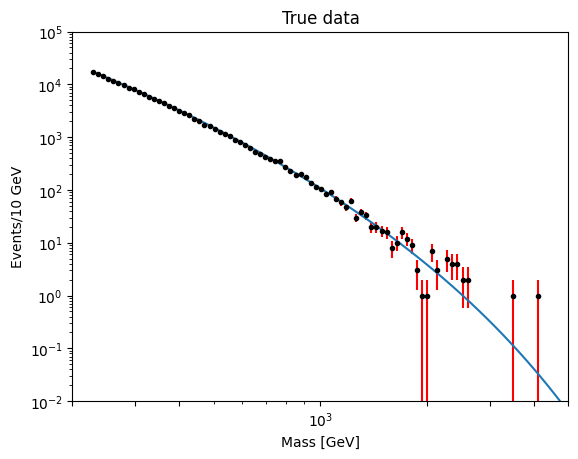

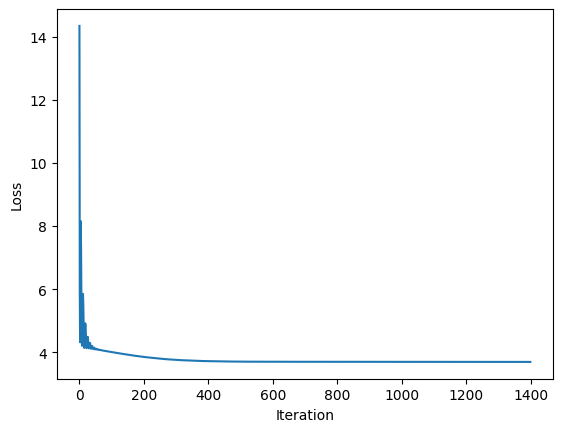

In [85]:
# By default optim_p3_poisson contains N = 1400 with loss filter of 3.37 and N filter = 1000

class optim_p3_poisson_test:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return [1.81458 * 10**5, 1.4356, -12.54932, -4.2346, -0.834582, -0.07345]

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def run(self):

        priors = self.create_priors()
        theta_opt = []
        for i in range(len(priors)):
            theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
        initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

        optimizer = Adam([theta_opt], lr=0.001)
        loss = initial_loss
        losses = []
        max_N = 1400
        loss_crit = 1.5
        loss_filter = 3.37
        N_iter = 0

        while N_iter < max_N:
            if N_iter == 0:
                print(f"Initial Loss = {loss}")
            optimizer.zero_grad()
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
            loss.backward()
            optimizer.step()
            losses.append(loss.detach().numpy())
            N_iter += 1
            # if loss < loss_crit:
            #     success = True
            #     break
            # if N_iter % 250 == 0:
                # print(f"N_iter = {N_iter}")
                # print(f"Loss = {loss}")
            # if N_iter == 1000 and loss > loss_filter:
            #     # print("Loss too high. Starting again.")
            #     print(f"Final loss before filter = {losses[-1]}")
            #     break
            # if N_iter == 1000 and loss < loss_filter:
            #     print(f"Loss at 1000 iterations = {loss}")
            # if N_iter == 1500 and loss < loss_filter:
            #     print(f"Loss at 1500 iterations = {loss}")
        # else:
            # print("Max number of iterations reach, no optimised value found. Starting again.")

        if N_iter == max_N:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # Plot results

            plt.errorbar(self.De_mass, self.De_event, yerr=self.yerr, fmt='.', color='black', ecolor='red')
            y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            plt.plot(self.De_mass, y_pred_3_plot)
            plt.yscale("log")
            plt.xscale("log")
            plt.xlabel("Mass [GeV]")
            plt.ylabel("Events/10 GeV")
            plt.xlim(200, 5000)
            plt.ylim(bottom = 10**-2, top=10**5)
            plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
            plt.title("True data")
            plt.show()

            f_loss,a_loss = plt.subplots()
            a_loss.plot(losses)
            # a_loss.set_yscale("log")
            a_loss.set_ylabel("Loss")
            a_loss.set_xlabel("Iteration")
            # a_loss.set_xlim(N_iter-1000, N_iter)
            # a_loss.set_ylim(0.55, 0.6)


# Usage
data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'

optimizer_class = optim_p3_poisson_test(data_path)
optimizer_class.run()

# for j in range(5):
#     losses_to_avg = []
#     for i in range (60):
#         optimizer_class = optim_p3_poisson(data_path)
#         optimizer_class.run()

#         losses_array = optimizer_class.losses
#         final_loss = losses_array[-1]
#         losses_to_avg.append(final_loss)
#     print(f"Average loss = {np.mean(losses_to_avg)}")

# AIC

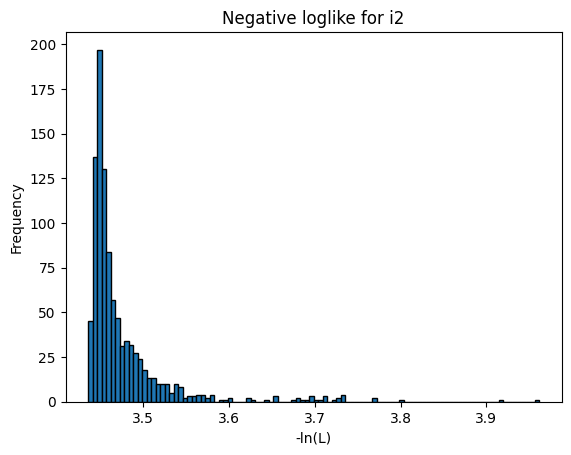

Mean -ln(K) = 3.4751029014587402, std dev = 0.053627025336027145, min value = 3.4358649253845215


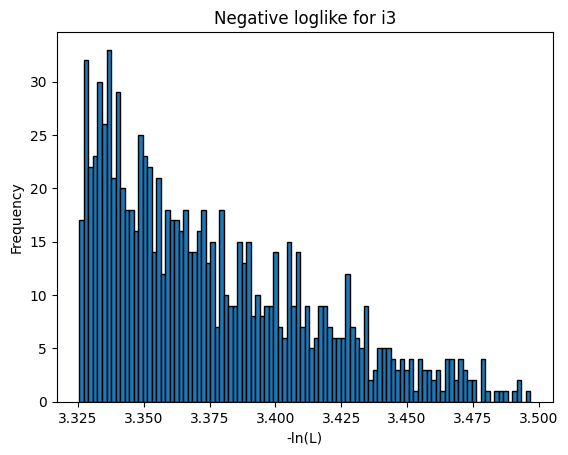

Mean -ln(K) = 3.3753323554992676, std dev = 0.03897508978843689, min value = 3.3255624771118164


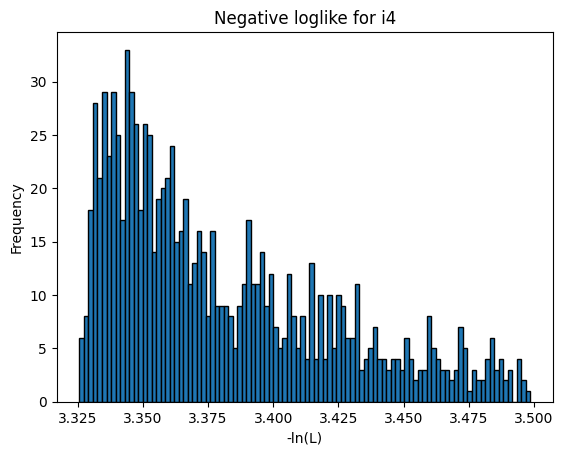

Mean -ln(K) = 3.380146026611328, std dev = 0.04278486222028732, min value = 3.325676918029785


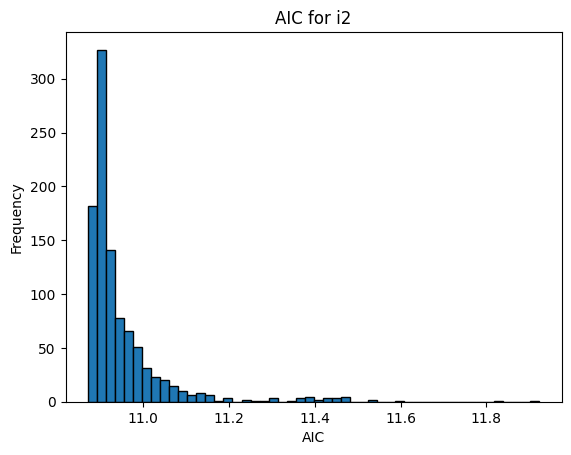

Mean AIC = 10.95020569038391, std dev = 0.1072540512980154, min value = 10.871729850769043


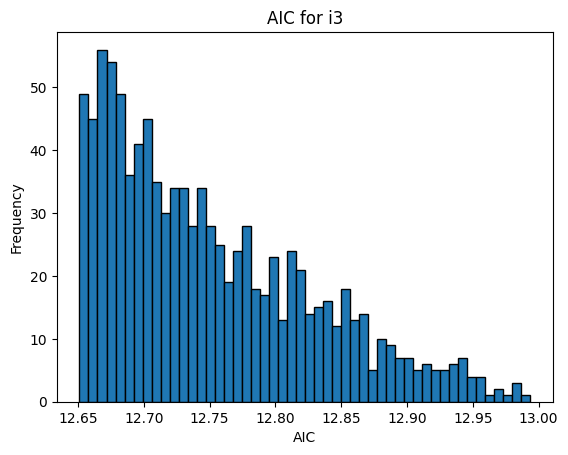

Mean AIC = 12.750664498806, std dev = 0.07795017700404859, min value = 12.651124954223633


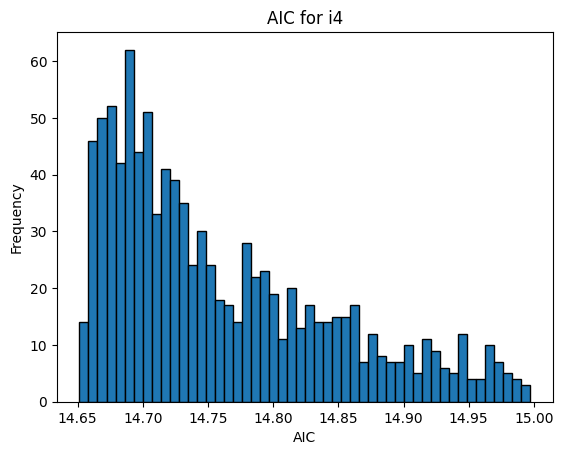

Mean AIC = 14.760291832447052, std dev = 0.0855697230451516, min value = 14.65135383605957


In [13]:
# Round 1

# file2 = 'saved_opt_var_and_loss_p2_20240406_041235.npz'
# file3 = 'saved_opt_var_and_loss_p3_20240406_080611.npz'
# file4 = 'saved_opt_var_and_loss_p4_20240406_094642.npz'

# # Final run 1 

# filei2 = 'saved_opt_var_and_loss_p2_20240411_043930.npz'
# filei3 = 'saved_opt_var_and_loss_p3_20240411_143134.npz'
# filei4 = 'saved_opt_var_and_loss_p4_20240411_185606.npz'

# Final run 2

filei2 = 'saved_opt_var_and_loss_p2_20240412_045341.npz'
filei3 = 'saved_opt_var_and_loss_p3_20240412_143022.npz'
filei4 = 'saved_opt_var_and_loss_p4_20240413_001004.npz'

final_losses_2 = np.load(filei2)['array0']
final_losses_3 = np.load(filei3)['array0']
final_losses_4 = np.load(filei4)['array0']

plt.hist(final_losses_2, bins=100, edgecolor='black')
plt.title(f'Negative loglike for i2')
plt.xlabel('-ln(L)')
plt.ylabel('Frequency')
plt.show()

print(f"Mean -ln(K) = {np.mean(final_losses_2)}, std dev = {np.std(final_losses_2)}, min value = {np.min(final_losses_2)}")

plt.hist(final_losses_3, bins=100, edgecolor='black')
plt.title(f'Negative loglike for i3')
plt.xlabel('-ln(L)')
plt.ylabel('Frequency')
plt.show()

print(f"Mean -ln(K) = {np.mean(final_losses_3)}, std dev = {np.std(final_losses_3)}, min value = {np.min(final_losses_3)}")

plt.hist(final_losses_4, bins=100, edgecolor='black')
plt.title(f'Negative loglike for i4')
plt.xlabel('-ln(L)')
plt.ylabel('Frequency')
plt.show()

print(f"Mean -ln(K) = {np.mean(final_losses_4)}, std dev = {np.std(final_losses_4)}, min value = {np.min(final_losses_4)}")

AIC_2_array = []
AIC_3_array = []
AIC_4_array = []

for i in range(len(final_losses_2)):
    AIC_2_array.append(2 * 2 + 2 * final_losses_2[i])
    AIC_3_array.append(2 * 3 + 2 * final_losses_3[i])
    AIC_4_array.append(2 * 4 + 2 * final_losses_4[i])

plt.hist(AIC_2_array, bins=50, edgecolor='black')
plt.title(f'AIC for i2')
plt.xlabel('AIC')
plt.ylabel('Frequency')
plt.show()

print(f"Mean AIC = {np.mean(AIC_2_array)}, std dev = {np.std(AIC_2_array)}, min value = {np.min(AIC_2_array)}")

plt.hist(AIC_3_array, bins=50, edgecolor='black')
plt.title(f'AIC for i3')
plt.xlabel('AIC')
plt.ylabel('Frequency')
plt.show()

print(f"Mean AIC = {np.mean(AIC_3_array)}, std dev = {np.std(AIC_3_array)}, min value = {np.min(AIC_3_array)}")

plt.hist(AIC_4_array, bins=50, edgecolor='black')
plt.title(f'AIC for i4')
plt.xlabel('AIC')
plt.ylabel('Frequency')
plt.show()

print(f"Mean AIC = {np.mean(AIC_4_array)}, std dev = {np.std(AIC_4_array)}, min value = {np.min(AIC_4_array)}")

# Narrowing priors (regular optimise other values) /correct for new data and run/

Manually narrowed priors down to ranges:

a: 1.6 to 1.8 * 10**5 (Using fact that must be equal to number of events)

b: 1 to 5 (using Desmos and plotting loglike against p (with fixed a and p0, 180000 and -12, no other parameters)

p0: -10 to -15 (Desmos)

p1: -3.5 to -5.2 (Desmos)

p2: -0.45 to -1

p3: -0.1 to -0.045

p4: -0.001 to -0.006

Should also check if b 1 to 10 looks reasonable (for all other priors in same ranges, range of other priors shouldnt affect allowed values of b since b only finely adjusts and that too the tail)

Results of narrowing down using the code below shows that p0 can be cut down to at least -11 to -14, and potentially -11 to -13.5 (maybe even further, repeat many times and check)

Check what it suggests about b

After narrowing:

Should check what gradient values look like on same scatter plot at values close to low loglike points ie. within +/- 0.5 of loglike critical, plot in different colour

## b vs p0 (regular optimise other values)

In [ ]:
### Sped up version of class but now for fixed abp0

# Fix b and p0

class optim_p3_fix_bp0:
    def __init__(self, data_path, constant_b, constant_p0):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x_me = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x_me, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1
        self.constant_b = constant_b
        self.constant_p0 = constant_p0

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, self.constant_b, self.constant_p0, -5.2, -0.95, -0.1], high=[1.9 * 10**5, self.constant_b, self.constant_p0, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)
        # valid_indices = y_err_tensor > 0
        # chi_sq = ((y_pred[valid_indices] - y[valid_indices]) ** 2) / (y_err_tensor[valid_indices] ** 2)
        # return torch.mean(chi_sq)

    def threshold(self):
        return 25

    def adjust_theta_3(self, y_pred_3):
        while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta = []
            theta_opt = []
            for i in range(len(priors)):
                if i == 0:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 1:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 2:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i >= 3:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta = torch.tensor(theta, dtype=torch.float32, requires_grad=True)
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta[2], theta_opt[1], theta_opt[2], theta_opt[3])
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta, theta_opt, y_pred_3

    def run(self):
        success = False

        while not success:
            priors = self.create_priors()
            theta = []
            theta_opt = []
            for i in range(len(priors)):
                if i == 0:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 1:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 2:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i >= 3:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta = torch.tensor(theta, dtype=torch.float32, requires_grad=True)
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)

            y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta[2], theta_opt[1], theta_opt[2], theta_opt[3])
            initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            else:
                pass
            #     # print("Valid start point found.")

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 1000
            loss_crit = 5
            loss_filter = 3.37
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                #     print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta[2], theta_opt[1], theta_opt[2], theta_opt[3])
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 500 and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    # print(f"Final loss before filter = {losses[-1]}")
                    break
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success:

            theta_final = []
        
            for i in range(len(theta)):
                if i == 0:
                    theta_final.append(theta_opt[i])
                if i == 1:
                    theta_final.append(theta[i])
                if i == 2:
                    theta_final.append(theta[i])
                if i >= 3:
                    theta_final.append(theta_opt[i-2])
        
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.losses_array = np.array(losses)

            # print(f"Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            # print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")

            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")

            # Plot results (ONLY NEED THIS FOR TORCH OPT i = 3 to plot result of each opt, not if opting for each b and p0 value)

            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # a_loss.set_xlim(N_iter-1000, N_iter)
            # a_loss.set_ylim(0.55, 0.6)

# Pairwise contour plots of loss (loglike() function)

def contour_plot_b_p0():

    # Grid of parameters
    b_ft_lower = 1 # Real is 10 Viewing is 
    b_ft_upper = 10 # Real is 1 Viewing is 
    p0_ft_lower = -13.5 # Real is -15 Viewing is -20
    p0_ft_upper = -11 # Real is -6 Viewing is 0

    b_ft_values = torch.linspace(b_ft_lower, b_ft_upper, 20)
    p0_ft_values = torch.linspace(p0_ft_lower, p0_ft_upper, 6)
    B, P0 = torch.meshgrid(b_ft_values, p0_ft_values)
    loglike_values = torch.zeros(B.shape)
    a_ft_values = torch.zeros(B.shape)
    p1_ft_values = torch.zeros(B.shape)
    p2_ft_values = torch.zeros(B.shape)
    p3_ft_values = torch.zeros(B.shape)
    # loglike_b_gradients = torch.zeros(B.shape)
    # loglike_p0_gradients = torch.zeros(B.shape)

    # Evaluate loglike over the grid for optimised values of other parameters
    for i in range(len(b_ft_values)):
        for j in range((len(p0_ft_values))):
            # Usage
            data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
            optimizer_class = optim_p3_fix_bp0(data_path, b_ft_values[i], p0_ft_values[j])
            optimizer_class.run()
            theta_final = optimizer_class.theta_final
            losses_array = optimizer_class.losses_array
            x_tensor = optimizer_class.x_tensor
            y_tensor = optimizer_class.y_tensor
            y_err_tensor = optimizer_class.y_err_tensor
            y_pred_3_b_p0 = optimizer_class.curve_torch_3(x_tensor, theta_final[0], b_ft_values[i], p0_ft_values[j], theta_final[3], theta_final[4], theta_final[5])
            loglike_values[i, j] = optimizer_class.loglike(y_pred_3_b_p0, y_tensor, y_err_tensor)
            a_ft_values[i, j] = theta_final[0]
            p1_ft_values[i, j] = theta_final[3]
            p2_ft_values[i, j] = theta_final[4]
            p3_ft_values[i, j] = theta_final[5]

            # b = b_ft_values[i]
            # p0 = p0_ft_values[j]
            # loglike_values[i,j].backward()
            # loglike_b_gradients[i,j] = b.grad.item()
            # loglike_p0_gradients[i,j] = p0.grad.item()

            # print(f"{b_ft_values[i]}, {p0_ft_values[j]}, {loglike_values[i,j]}")
            print(f"Calculated loglike_values{[i,j]}")


    # Save file

    def save_loglike_values(loglike_values, a_ft_values, b_ft_values, p0_ft_values, p1_ft_values, p2_ft_values, p3_ft_values, filename_prefix='loglike_history_bvsp0'):
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        filename = f"{filename_prefix}_{timestamp}.csv"
        
        loglike_values = loglike_values.detach().numpy()

        a_values_array = []
        b_values_array = []
        p0_values_array = []
        p1_values_array = []
        p2_values_array = []
        p3_values_array = []
        loglike_values_array = []
    
        for i in range(len(b_ft_values)):
            for j in range((len(p0_ft_values))):
                a_values_array.append(a_ft_values[i, j].item())
                b_values_array.append(b_ft_values[i].item())
                p0_values_array.append(p0_ft_values[j].item())
                p1_values_array.append(p1_ft_values[i, j].item())
                p2_values_array.append(p2_ft_values[i, j].item())
                p3_values_array.append(p3_ft_values[i, j].item())
                loglike_values_array.append(loglike_values[i, j].item())
    
        a_values_array = np.array(a_values_array)
        b_values_array = np.array(b_values_array)
        p0_values_array = np.array(p0_values_array)
        p1_values_array = np.array(p1_values_array)
        p2_values_array = np.array(p2_values_array)
        p3_values_array = np.array(p3_values_array)
        loglike_values_array = np.array(loglike_values_array)

        # Create a DataFrame with appropriate headers
        df = pd.DataFrame({
            'a_values': a_values_array,
            'b_values': b_values_array,
            'p0_values': p0_values_array,
            'p1_values': p1_values_array,
            'p2_values': p2_values_array,
            'p3_values': p3_values_array,
            'loglikelihood': loglike_values_array,
        })

        # Save the DataFrame to a new CSV file with headers
        df.to_csv(filename, index=False)
        print(f"Data saved to {filename}")

    save_loglike_values(loglike_values, a_ft_values, b_ft_values, p0_ft_values, p1_ft_values, p2_ft_values, p3_ft_values, filename_prefix='loglike_history_bvsp0')

    # # Save file with gradients

    # def save_loglike_values(loglike_values, b_ft_values, p0_ft_values, loglike_b_gradients, loglike_p0_gradients, filename_prefix='loglike_history'):
    #     timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
    #     filename = f"{filename_prefix}_{timestamp}.csv"
        
    #     loglike_values = loglike_values.detach().numpy()

    #     b_values_array = []
    #     p0_values_array = []
    #     loglike_values_array = []
    #     loglike_b_gradients_array = []
    #     loglike_p0_gradients_array = []
    
    #     for i in range(len(b_ft_values)):
    #         for j in range((len(b_ft_values))):
    #             b_values_array.append(b_ft_values[i].item())
    #             p0_values_array.append(p0_ft_values[j].item())
    #             loglike_values_array.append(loglike_values[i, j].item())
    #             loglike_b_gradients_array.append(loglike_b_gradients[i, j].item())
    #             loglike_b_gradients_array.append(loglike_p0_gradients[i, j].item())
    
    #     b_values_array = np.array(b_values_array)
    #     p0_values_array = np.array(p0_values_array)
    #     loglike_values_array = np.array(loglike_values_array)
    #     loglike_b_gradients_array = np.array(loglike_b_gradients_array)
    #     loglike_p0_gradients_array = np.array(loglike_p0_gradients_array)

    #     # Create a DataFrame with appropriate headers
    #     df = pd.DataFrame({
    #         'b_values': b_values_array,
    #         'p0_values': p0_values_array,
    #         'loglikelihood': loglike_values_array,
    #         'loglike b grad': loglike_b_gradients_array,
    #         'loglike p0 grad': loglike_p0_gradients_array,
    #     })

    #     # Save the DataFrame to a new CSV file with headers
    #     df.to_csv(filename, index=False)
    #     print(f"Data saved to {filename}")

    # save_loglike_values(loglike_values, b_ft_values, p0_ft_values, loglike_b_gradients, loglike_p0_gradients, filename_prefix='loglike_history')

    # Contour plotting
    
    plt.figure(figsize=(10, 8))
    loglike_values_np = loglike_values.detach().numpy()
    levels = np.linspace(loglike_values_np.min(), loglike_values_np.min()*3, num=10)
    contour = plt.contour(B.numpy(), P0.numpy(), loglike_values_np, levels=levels, cmap='viridis', vmin=0, vmax=levels[-1])
    plt.colorbar(contour)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Contour Plot')
    plt.show()
    
    # Scatter Plotting

    a_values_array = []
    b_values_array = []
    p0_values_array = []
    p1_values_array = []
    p2_values_array = []
    p3_values_array = []
    loglike_values_array = []
    # loglike_b_gradients_array = []
    # loglike_p0_gradients_array = []
    
    for i in range(len(b_ft_values)):
        for j in range((len(p0_ft_values))):
            a_values_array.append(a_ft_values[i, j].item())
            b_values_array.append(b_ft_values[i].item())
            p0_values_array.append(p0_ft_values[j].item())
            p1_values_array.append(p1_ft_values[i, j].item())
            p2_values_array.append(p2_ft_values[i, j].item())
            p3_values_array.append(p3_ft_values[i, j].item())
            loglike_values_array.append(loglike_values[i, j].item())
            # loglike_b_gradients_array.append(loglike_b_gradients[i, j].item())
            # loglike_b_gradients_array.append(loglike_p0_gradients[i, j].item())
    
    b_values_array = np.array(b_values_array)
    p0_values_array = np.array(p0_values_array)
    loglike_values_array = np.array(loglike_values_array)
    # loglike_b_gradients_array = np.array(loglike_b_gradients_array)
    # loglike_p0_gradients_array = np.array(loglike_p0_gradients_array)

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(b_values_array, p0_values_array, c=loglike_values_array, cmap='viridis', s=5, vmin=loglike_values_np.min(), vmax=loglike_values_np.min()*1.2)
    plt.colorbar(scatter)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Scatter Plot')

    critical_loglike_value = loglike_values_np.min() * 1.005

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            plt.text(b_values_array[i] + 0.02, p0_values_array[i], str(round(loglike_values_array[i], 2)), fontsize=9, color='red')
            # print(f"""Critical loglikelihood met, loglike = {loglike_val}, at: \n  
            #       a = {a_values_array[i]} \n        
            #       b = {b_values_array[i]} \n
            #       p0 = {p0_values_array[i]} \n
            #       p1 = {p1_values_array[i]} \n
            #       p2 = {p2_values_array[i]} \n
            #       p3 = {p3_values_array[i]}""")
        # if critical_loglike_value - critical_loglike_value/10 < loglike_val < critical_loglike_value + critical_loglike_value/10:
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i], str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='orange')
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i] - 0.02, str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='green')

    plt.show()

# Call contour plot function
for i in range(5):
    contour_plot_b_p0()

## Replot b vs p0

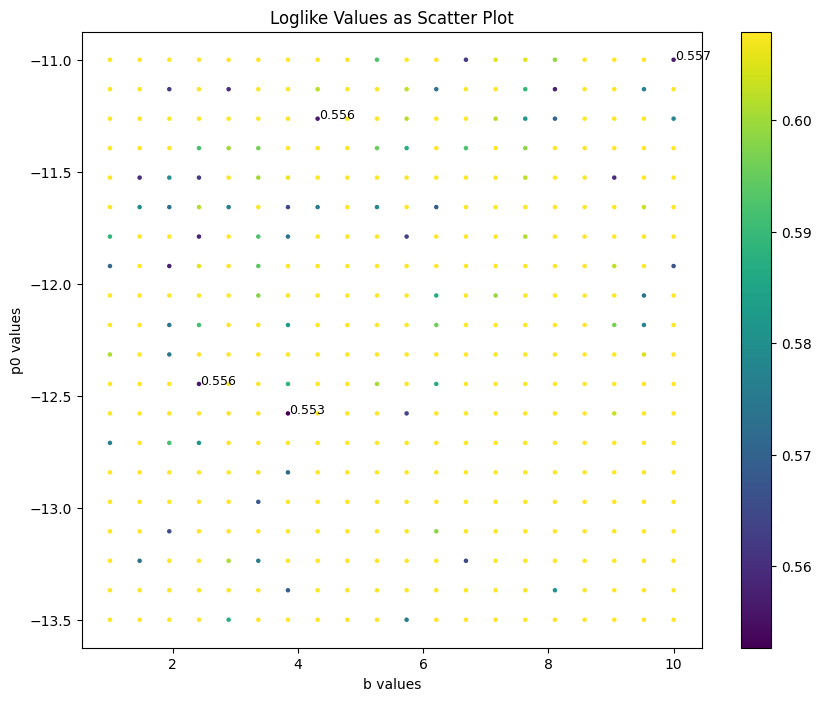

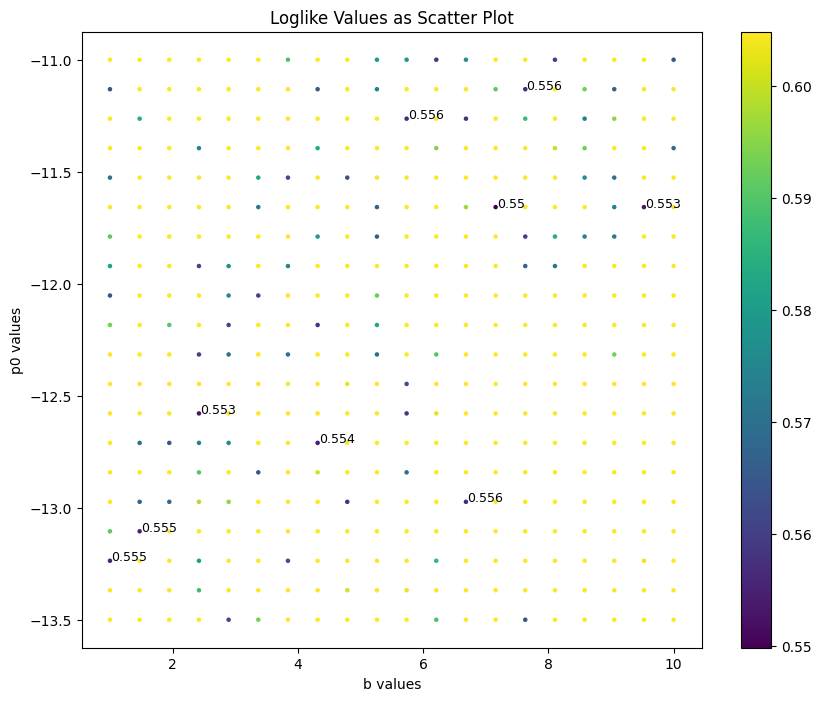

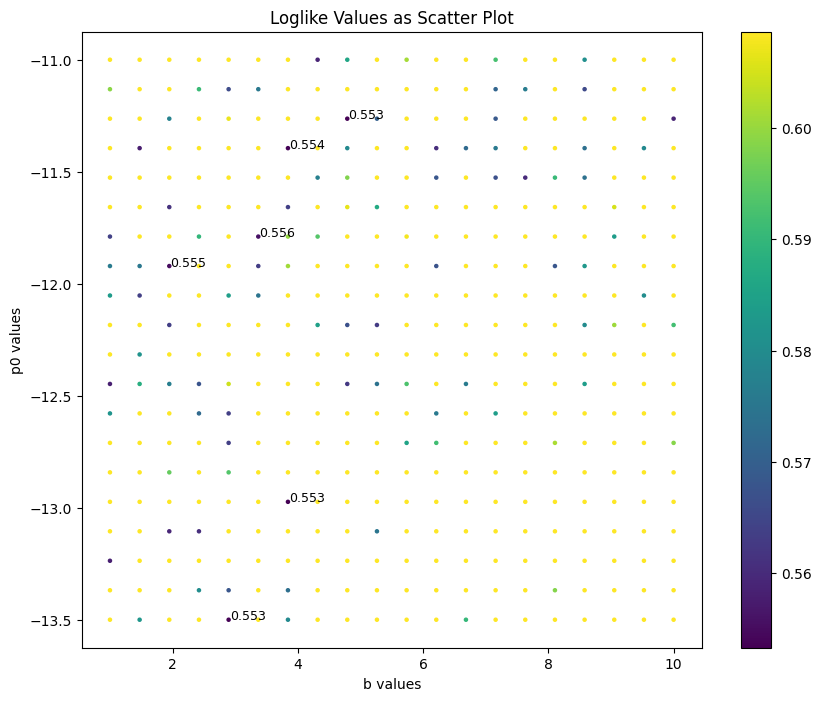

In [295]:
# Plotting results

def replot_scatter_b_p0(filename):
    
    data = pd.read_csv(filename)

    a_values_array = data['a_values']
    b_values_array = data['b_values']
    p0_values_array = data['p0_values']
    p1_values_array = data['p1_values']
    p2_values_array = data['p2_values']
    p3_values_array = data['p3_values']
    loglike_values_array = data['loglikelihood']

    # Scatter Plotting

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(b_values_array, p0_values_array, c=loglike_values_array, cmap='viridis', s=5, vmin=loglike_values_array.min(), vmax=loglike_values_array.min()*1.1)
    plt.colorbar(scatter)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Scatter Plot')

    critical_loglike_value = 0.557

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            plt.text(b_values_array[i] + 0.02, p0_values_array[i], str(round(loglike_values_array[i], 3)), fontsize=9, color='black')
        # if critical_loglike_value - critical_loglike_value/10 < loglike_val < critical_loglike_value + critical_loglike_value/10:
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i], str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='black')
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i] - 0.02, str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='grey')
            # print(f"""Critical loglike met, loglike = {loglike_val}\n 
            #       a = {a_values_array[i]}\n 
            #       b = {b_values_array[i]}\n
            #       p0 = {p0_values_array[i]}\n
            #       p1 = {p1_values_array[i]}\n
            #       p2 = {p2_values_array[i]}\n
            #       p3 = {p3_values_array[i]}""")
    plt.show()

# replot_scatter('loglike_history_20240307_063726_narrow_big_data.csv')
    
# replot_scatter('loglike_history_20240310_214317_all_params_2.csv')
    
# replot_scatter_b_p0('loglike_history_20240314_112350.csv') b 5 to 10

replot_scatter_b_p0('loglike_history_20240314_114139.csv') # b 1 to 10 repeat 1
replot_scatter_b_p0('loglike_history_20240314_114947.csv') # b 1 to 10 repeat 2
replot_scatter_b_p0('loglike_history_20240314_115737.csv') # b 1 to 10 repeat 3
    


# replot_scatter('loglike_history_20240306_194817_narrrow_w_new_ranges.csv')
# replot_scatter('loglike_history_20240306_200623_narrow_w_new_ranges_2.csv')
# replot_scatter('loglike_history_20240306_201303_narrow_w_new_ranges_3.csv')
# replot_scatter('loglike_history_20240306_204230_narrow_w_new_ranges_4.csv')
# replot_scatter('loglike_history_20240306_204924_narrow_w_new_ranges_5.csv')

## b vs p1 (regular optimise other values)

In [19]:
# Fix b and p1

class optim_p3_fix_bp1:
    def __init__(self, data_path, constant_b, constant_p1):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x_me = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x_me, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1
        self.constant_b = constant_b
        self.constant_p1 = constant_p1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, self.constant_b, -13.5, self.constant_p1, -0.95, -0.1], high=[1.9 * 10**5, self.constant_b, -11, self.constant_p1, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_3(self, y_pred_3):
        while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta = []
            theta_opt = []
            for i in range(len(priors)):
                if i == 0:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 1:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 2:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 3:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 4:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 5:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))

            theta = torch.tensor(theta, dtype=torch.float32, requires_grad=True)
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1], theta[3], theta_opt[2], theta_opt[3])
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta, theta_opt, y_pred_3

    def run(self):
        success = False

        while not success:
            priors = self.create_priors()
            theta = []
            theta_opt = []
            for i in range(len(priors)):
                if i == 0:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 1:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 2:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 3:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 4:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 5:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta = torch.tensor(theta, dtype=torch.float32, requires_grad=True)
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)

            y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1], theta[3], theta_opt[2], theta_opt[3])
            initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            else:
                pass
                # print("Valid start point found.")

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 1000
            loss_crit = 5
            loss_filter = 3
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                #     print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1], theta[3], theta_opt[2], theta_opt[3])
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 500 and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    # print(f"Final loss before filter = {losses[-1]}")
                    break
            # else:
            #     print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success:

            theta_final = []
        
            for i in range(len(theta)):
                if i == 0:
                    theta_final.append(theta_opt[i])
                if i == 1:
                    theta_final.append(theta[i])
                if i == 2:
                    theta_final.append(theta_opt[i-1])
                if i == 3:
                    theta_final.append(theta[i])
                if i == 4:
                    theta_final.append(theta_opt[i-2])
                if i == 5:
                    theta_final.append(theta_opt[i-2])
        
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.losses_array = np.array(losses)

            # print(f"Final loss = {losses[-1]}")

# Pairwise contour plots of loss (loglike() function)

def contour_plot_b_p1():

    # Grid of parameters
    b_ft_lower = 1 # Real is 10 Viewing is 
    b_ft_upper = 5 # Real is 1 Viewing is 
    p1_ft_lower = -5.2 # Real is -15 Viewing is -20
    p1_ft_upper = -3.5 # Real is -6 Viewing is 0

    b_ft_values = torch.linspace(b_ft_lower, b_ft_upper, 20)
    p1_ft_values = torch.linspace(p1_ft_lower, p1_ft_upper, 6)
    B, P1 = torch.meshgrid(b_ft_values, p1_ft_values)
    loglike_values = torch.zeros(B.shape)
    a_ft_values = torch.zeros(B.shape)
    p0_ft_values = torch.zeros(B.shape)
    p2_ft_values = torch.zeros(B.shape)
    p3_ft_values = torch.zeros(B.shape)
    # loglike_b_gradients = torch.zeros(B.shape)
    # loglike_p0_gradients = torch.zeros(B.shape)

    # Evaluate loglike over the grid for optimised values of other parameters
    for i in range(len(b_ft_values)):
        for j in range((len(p1_ft_values))):
            # Usage
            data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
            optimizer_class = optim_p3_fix_bp1(data_path, b_ft_values[i], p1_ft_values[j])
            optimizer_class.run()
            theta_final = optimizer_class.theta_final
            losses_array = optimizer_class.losses_array
            x_tensor = optimizer_class.x_tensor
            y_tensor = optimizer_class.y_tensor
            y_err_tensor = optimizer_class.y_err_tensor
            y_pred_3 = optimizer_class.curve_torch_3(x_tensor, theta_final[0], theta_final[1], theta_final[2], theta_final[3], theta_final[4], theta_final[5])
            loglike_values[i, j] = optimizer_class.loglike(y_pred_3, y_tensor, y_err_tensor)
            a_ft_values[i, j] = theta_final[0]
            p0_ft_values[i, j] = theta_final[2]
            p2_ft_values[i, j] = theta_final[4]
            p3_ft_values[i, j] = theta_final[5]

            # b = b_ft_values[i]
            # p0 = p0_ft_values[j]
            # loglike_values[i,j].backward()
            # loglike_b_gradients[i,j] = b.grad.item()
            # loglike_p0_gradients[i,j] = p0.grad.item()

            # print(f"{b_ft_values[i]}, {p0_ft_values[j]}, {loglike_values[i,j]}")
            print(f"Calculated loglike_values{[i,j]}")


    # Save file

    def save_loglike_values(loglike_values, a_ft_values, b_ft_values, p0_ft_values, p1_ft_values, p2_ft_values, p3_ft_values, filename_prefix='loglike_history_b_p1'):
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        filename = f"{filename_prefix}_{timestamp}.csv"
        
        loglike_values = loglike_values.detach().numpy()

        a_values_array = []
        b_values_array = []
        p0_values_array = []
        p1_values_array = []
        p2_values_array = []
        p3_values_array = []
        loglike_values_array = []
    
        for i in range(len(b_ft_values)):
            for j in range((len(p1_ft_values))):
                a_values_array.append(a_ft_values[i, j].item())
                b_values_array.append(b_ft_values[i].item())
                p0_values_array.append(p0_ft_values[i, j].item())
                p1_values_array.append(p1_ft_values[j].item())
                p2_values_array.append(p2_ft_values[i, j].item())
                p3_values_array.append(p3_ft_values[i, j].item())
                loglike_values_array.append(loglike_values[i, j].item())
    
        a_values_array = np.array(a_values_array)
        b_values_array = np.array(b_values_array)
        p0_values_array = np.array(p0_values_array)
        p1_values_array = np.array(p1_values_array)
        p2_values_array = np.array(p2_values_array)
        p3_values_array = np.array(p3_values_array)
        loglike_values_array = np.array(loglike_values_array)

        # Create a DataFrame with appropriate headers
        df = pd.DataFrame({
            'a_values': a_values_array,
            'b_values': b_values_array,
            'p0_values': p0_values_array,
            'p1_values': p1_values_array,
            'p2_values': p2_values_array,
            'p3_values': p3_values_array,
            'loglikelihood': loglike_values_array,
        })

        # Save the DataFrame to a new CSV file with headers
        df.to_csv(filename, index=False)
        print(f"Data saved to {filename}")

    save_loglike_values(loglike_values, a_ft_values, b_ft_values, p0_ft_values, p1_ft_values, p2_ft_values, p3_ft_values, filename_prefix='loglike_history_b_p1')

    # Contour plotting
    
    plt.figure(figsize=(10, 8))
    loglike_values_np = loglike_values.detach().numpy()
    levels = np.linspace(loglike_values_np.min(), loglike_values_np.min()*3, num=10)
    contour = plt.contour(B.numpy(), P1.numpy(), loglike_values_np, levels=levels, cmap='viridis', vmin=0, vmax=levels[-1])
    plt.colorbar(contour)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Contour Plot')
    plt.show()
    
    # Scatter Plotting

    a_values_array = []
    b_values_array = []
    p0_values_array = []
    p1_values_array = []
    p2_values_array = []
    p3_values_array = []
    loglike_values_array = []
    # loglike_b_gradients_array = []
    # loglike_p0_gradients_array = []
    
    for i in range(len(b_ft_values)):
        for j in range((len(p1_ft_values))):
            a_values_array.append(a_ft_values[i, j].item())
            b_values_array.append(b_ft_values[i].item())
            p0_values_array.append(p0_ft_values[i, j].item())
            p1_values_array.append(p1_ft_values[j].item())
            p2_values_array.append(p2_ft_values[i, j].item())
            p3_values_array.append(p3_ft_values[i, j].item())
            loglike_values_array.append(loglike_values[i, j].item())
            # loglike_b_gradients_array.append(loglike_b_gradients[i, j].item())
            # loglike_b_gradients_array.append(loglike_p0_gradients[i, j].item())
    
    b_values_array = np.array(b_values_array)
    p1_values_array = np.array(p1_values_array)
    loglike_values_array = np.array(loglike_values_array)
    # loglike_b_gradients_array = np.array(loglike_b_gradients_array)
    # loglike_p0_gradients_array = np.array(loglike_p0_gradients_array)

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(b_values_array, p1_values_array, c=loglike_values_array, cmap='viridis', s=5, vmin=loglike_values_np.min(), vmax=loglike_values_np.min()*1.2)
    plt.colorbar(scatter)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Scatter Plot')

    critical_loglike_value = loglike_values_np.min() * 1.005

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            plt.text(b_values_array[i] + 0.02, p1_values_array[i], str(round(loglike_values_array[i], 2)), fontsize=9, color='red')
            # print(f"""Critical loglikelihood met, loglike = {loglike_val}, at: \n  
            #       a = {a_values_array[i]} \n        
            #       b = {b_values_array[i]} \n
            #       p0 = {p0_values_array[i]} \n
            #       p1 = {p1_values_array[i]} \n
            #       p2 = {p2_values_array[i]} \n
            #       p3 = {p3_values_array[i]}""")
        # if critical_loglike_value - critical_loglike_value/10 < loglike_val < critical_loglike_value + critical_loglike_value/10:
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i], str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='orange')
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i] - 0.02, str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='green')

    plt.show()

# Call contour plot function
    
for i in range(5):
    contour_plot_b_p1()

Initial Loss = 24.00551414489746
Final loss before filter = 3.706258773803711
Initial Loss = 22.21378517150879
Final loss before filter = 4.568360805511475
Initial Loss = 24.690032958984375
Final loss before filter = 3.695075035095215
Initial Loss = 21.050273895263672
Final loss before filter = 3.30654239654541
Initial Loss = 19.21385383605957
Final loss before filter = 3.821995973587036
Initial Loss = 23.943622589111328
Final loss before filter = 4.618109226226807
Initial Loss = 18.715944290161133
Final loss before filter = 5.609067916870117
Initial Loss = 17.680118560791016
Final loss before filter = 7.169319152832031
Initial Loss = 18.49734878540039
Final loss before filter = 3.2181947231292725
Initial Loss = 17.37824821472168
Final loss before filter = 3.2986936569213867
Initial Loss = 23.689340591430664
Final loss before filter = 3.9284985065460205
Initial Loss = 18.285154342651367
Final loss before filter = 3.470438003540039
Initial Loss = 24.937610626220703
Final loss before fil

KeyboardInterrupt: 

## Replot b vs p1

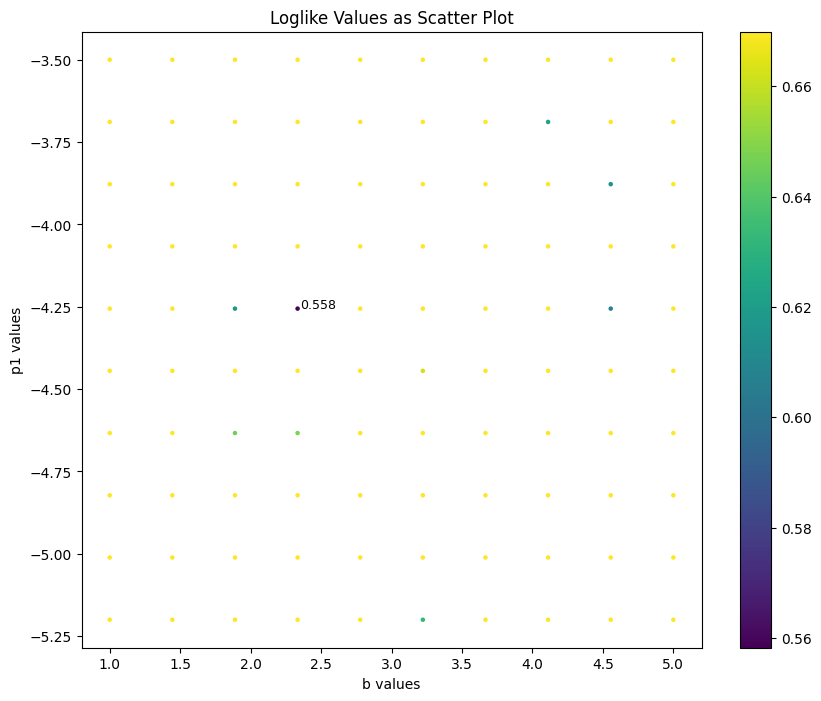

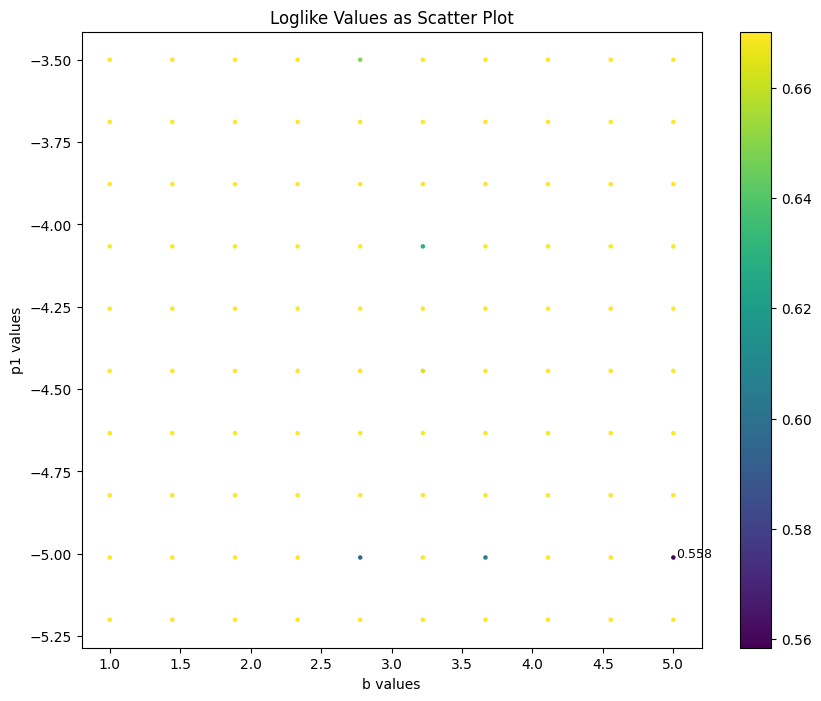

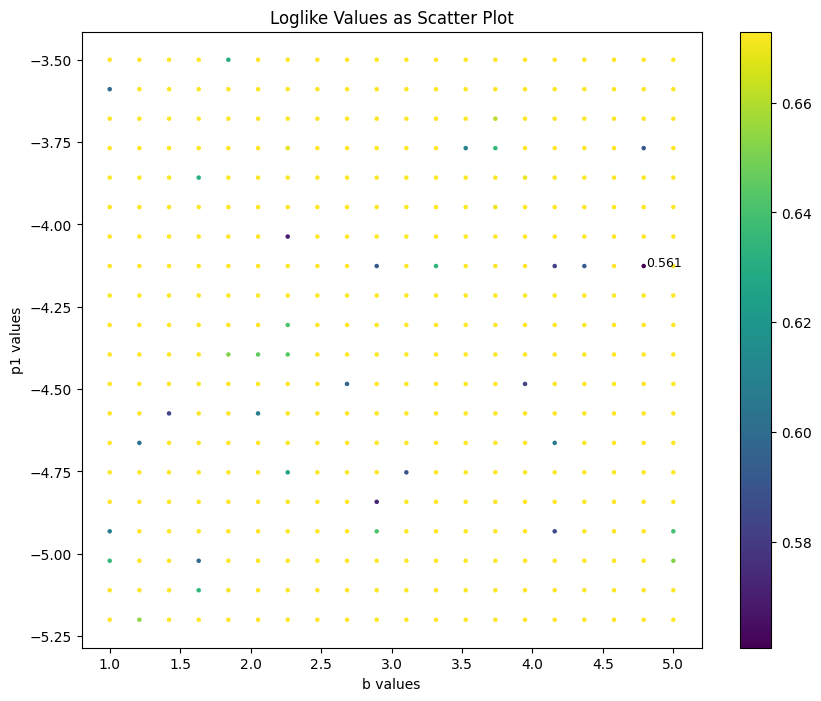

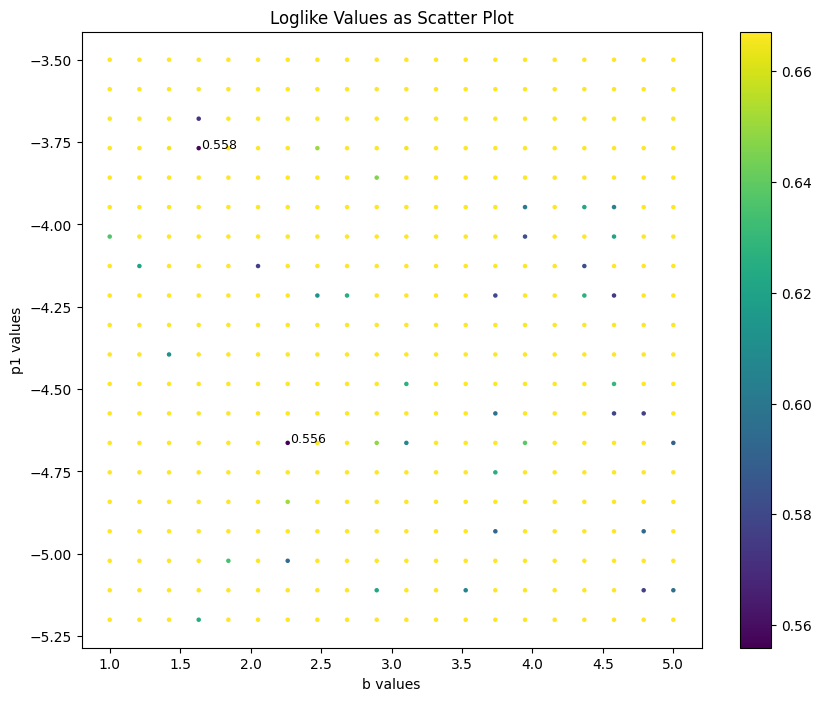

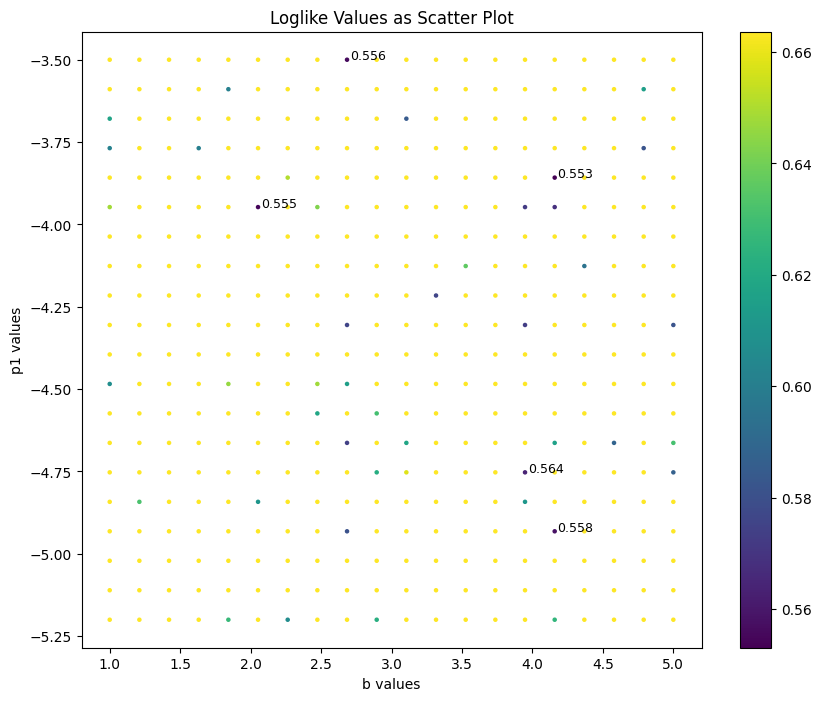

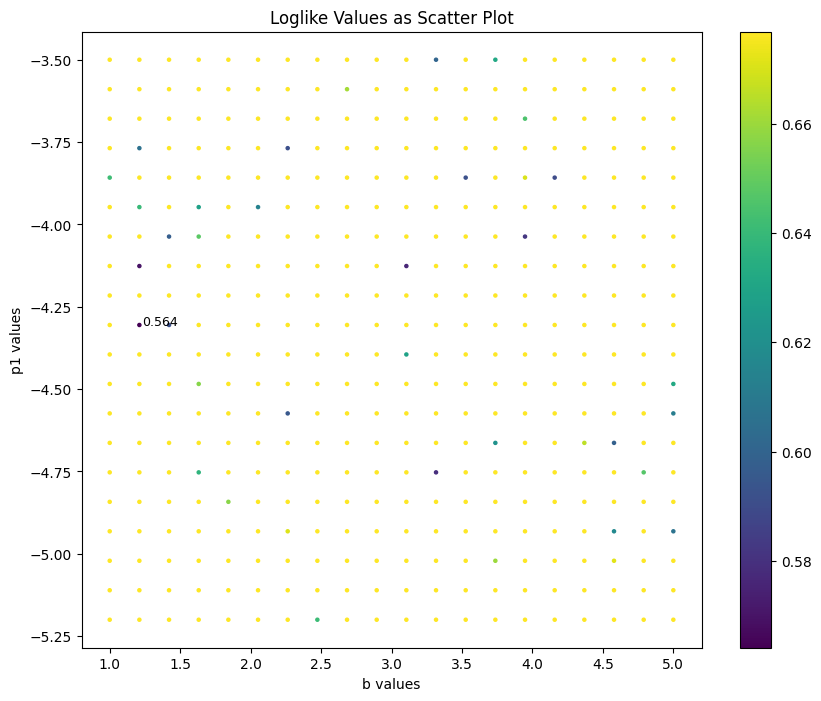

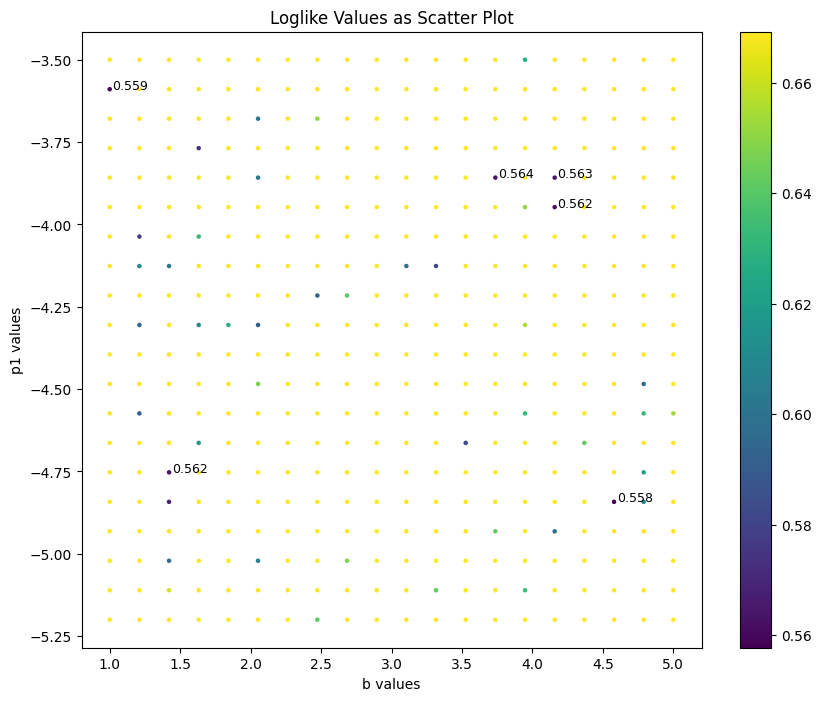

In [243]:
# Plotting results

def replot_scatter_b_p1(filename):
    
    data = pd.read_csv(filename)

    a_values_array = data['a_values']
    b_values_array = data['b_values']
    p0_values_array = data['p0_values']
    p1_values_array = data['p1_values']
    p2_values_array = data['p2_values']
    p3_values_array = data['p3_values']
    loglike_values_array = data['loglikelihood']

    # Scatter Plotting

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(b_values_array, p1_values_array, c=loglike_values_array, cmap='viridis', s=5, vmin=loglike_values_array.min(), vmax=loglike_values_array.min()*1.2)
    plt.colorbar(scatter)
    plt.xlabel('b values')
    plt.ylabel('p1 values')
    plt.title('Loglike Values as Scatter Plot')

    critical_loglike_value = 0.565

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            plt.text(b_values_array[i] + 0.02, p1_values_array[i], str(round(loglike_values_array[i], 3)), fontsize=9, color='black')
        # if critical_loglike_value - critical_loglike_value/10 < loglike_val < critical_loglike_value + critical_loglike_value/10:
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i], str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='black')
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i] - 0.02, str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='grey')
            # print(f"""Critical loglike met, loglike = {loglike_val}\n 
            #       a = {a_values_array[i]}\n 
            #       b = {b_values_array[i]}\n
            #       p0 = {p0_values_array[i]}\n
            #       p1 = {p1_values_array[i]}\n
            #       p2 = {p2_values_array[i]}\n
            #       p3 = {p3_values_array[i]}""")
    plt.show()

replot_scatter_b_p1('loglike_history_b_p1_20240312_212506_1.csv')
replot_scatter_b_p1('loglike_history_b_p1_20240312_212601_2.csv')
replot_scatter_b_p1('loglike_history_b_p1_20240312_213046_3.csv')
replot_scatter_b_p1('loglike_history_b_p1_20240312_213406_4.csv')
replot_scatter_b_p1('loglike_history_b_p1_20240312_213657_5.csv')
replot_scatter_b_p1('loglike_history_b_p1_20240312_214003_6.csv')
replot_scatter_b_p1('loglike_history_b_p1_20240312_214317_7.csv')

## Plot curves at critical loglike values

In [ ]:
def plot_curve_loglike_crit(filename):
    
    data = pd.read_csv(filename)

    a_values_array = data['a_values']
    b_values_array = data['b_values']
    p0_values_array = data['p0_values']
    p1_values_array = data['p1_values']
    p2_values_array = data['p2_values']
    p3_values_array = data['p3_values']
    loglike_values_array = data['loglikelihood']
    # losses_array = data['losses']

    optimizer_class = optim_p3_poisson(data_path)

    x_tensor = optimizer_class.x_tensor
    curve_torch_3 = optimizer_class.curve_torch_3()

    critical_loglike_value = 0.56

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            print(f"""Critical loglike met, loglike = {loglike_val}\n 
                  a = {a_values_array[i]}\n 
                  b = {b_values_array[i]}\n
                  p0 = {p0_values_array[i]}\n
                  p1 = {p1_values_array[i]}\n
                  p2 = {p2_values_array[i]}\n
                  p3 = {p3_values_array[i]}""")
            
            plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            y_pred_3 = curve_torch_3(x_tensor, a_values_array[i], b_values_array[i], p0_values_array[i], p1_values_array[i], p2_values_array[i], p3_values_array[i]).detach().numpy()
            plt.plot(De_mass, y_pred_3)
            plt.yscale("log")
            plt.xscale("log")
            plt.xlabel("Mass [GeV]")
            plt.ylabel("Events/10 GeV")
            plt.xlim(200, 4000)
            plt.ylim(top=10**5)
            plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses_array)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

plot_curve_loglike_crit('loglike_history_20240310_212607_all_params.csv')

## Gradient (misc)

In [1]:
def calc_gradients(b, p0):
    # Placeholder for your model evaluation and log-likelihood calculation
    # You would replace this with calls to your model and log-likelihood functions
    # Ensure `b` and `p0` are PyTorch tensors with `requires_grad=True`
    optimizer_class = optim_p3_fix_abp0(data_path, b, p0)
    optimizer_class.run()
    theta_final = optimizer_class.theta_final
    y_pred_3_b_p0 = optimizer_class.curve_torch_3(x_tensor, theta_final[0], b, p0, theta_final[3], theta_final[4], theta_final[5])
    loglike_values[i, j] = optimizer_class.loglike(y_pred_3_b_p0, y_tensor, y_err_tensor)
    log_likelihood = 
    
    # Calculate gradients
    log_likelihood.backward()
    
    # Access the gradients
    b_grad = b.grad.item()
    p0_grad = p0.grad.item()
    
    return b_grad, p0_grad

SyntaxError: invalid syntax (294395746.py, line 10)

# Narrowing priors (best each point method) /correct for new data and run/

Testing some code which will find the best loglike for each point, so will reduce stochastic effects of starting point etc. Does this by doing following process: choose starting point and optimise, if doesn't reach good loglikelihood within counter_lim then ups the critical loglieklihood and repeats, does this until critical loglikelihood is 0.6, if by then still hasn't reached this loglike then just end loop and plot. This means that can be more sure of loglike of each point since each point has been given a large nnumber of repeats to reach a critical logliekihood.

Modification: Maybe try same start point a few times before changing start point? Would it make much difference or will it optimise in same way? Surely will optimise same way becasue will take the same steps and apth since always steps in steepest gradient direction.

Need to check: Threshold requird to b high for some poionts but doesn't need to for others? Does it affect the other poiint which it doesn't need to be low for? Can I loop over threshold or maybe that would take too long?

## b vs p0

Calculated loglike_values[0, 0]
Calculated loglike_values[0, 1]
Calculated loglike_values[0, 2]
Calculated loglike_values[0, 3]
Calculated loglike_values[0, 4]
Calculated loglike_values[1, 0]
Calculated loglike_values[1, 1]
Calculated loglike_values[1, 2]
Calculated loglike_values[1, 3]
Calculated loglike_values[1, 4]
Calculated loglike_values[2, 0]
Calculated loglike_values[2, 1]
Calculated loglike_values[2, 2]
Calculated loglike_values[2, 3]
Calculated loglike_values[2, 4]
Calculated loglike_values[3, 0]
Calculated loglike_values[3, 1]
Calculated loglike_values[3, 2]
Calculated loglike_values[3, 3]
Calculated loglike_values[3, 4]
Calculated loglike_values[4, 0]
Calculated loglike_values[4, 1]
Calculated loglike_values[4, 2]
Calculated loglike_values[4, 3]
Calculated loglike_values[4, 4]
Calculated loglike_values[5, 0]
Calculated loglike_values[5, 1]
Calculated loglike_values[5, 2]
Calculated loglike_values[5, 3]
Calculated loglike_values[5, 4]
Calculated loglike_values[6, 0]
Calculat

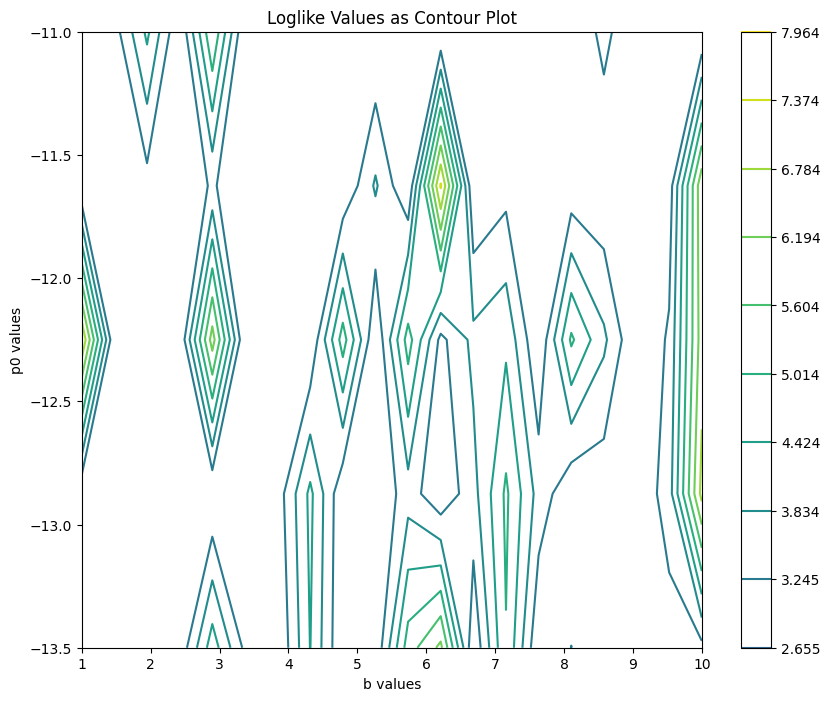

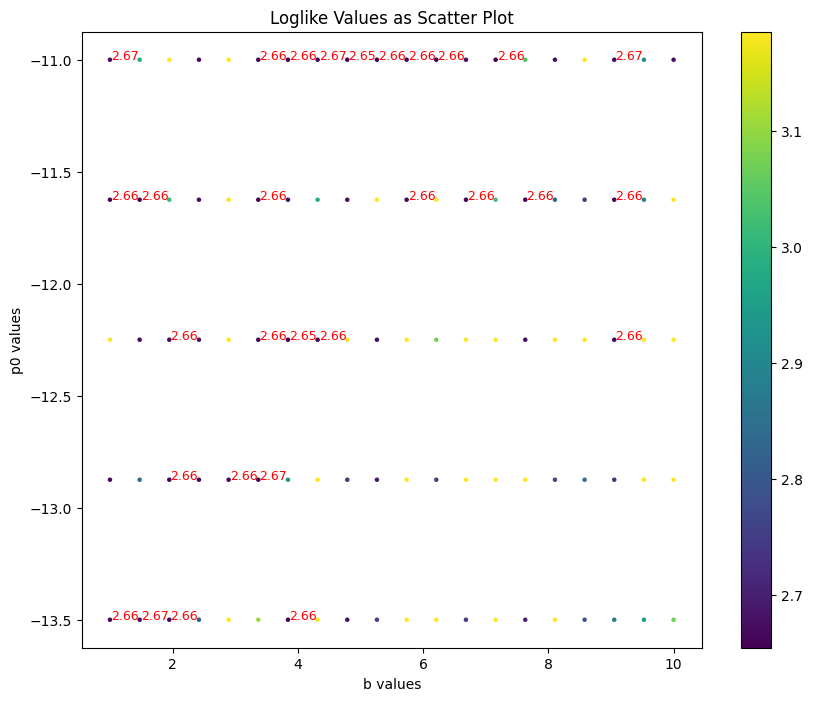

Calculated loglike_values[0, 0]
Calculated loglike_values[0, 1]
Calculated loglike_values[0, 2]
Calculated loglike_values[0, 3]
Calculated loglike_values[0, 4]
Calculated loglike_values[1, 0]
Calculated loglike_values[1, 1]
Calculated loglike_values[1, 2]
Calculated loglike_values[1, 3]
Calculated loglike_values[1, 4]
Calculated loglike_values[2, 0]
Calculated loglike_values[2, 1]
Calculated loglike_values[2, 2]
Calculated loglike_values[2, 3]
Calculated loglike_values[2, 4]
Calculated loglike_values[3, 0]
Calculated loglike_values[3, 1]
Calculated loglike_values[3, 2]
Calculated loglike_values[3, 3]
Calculated loglike_values[3, 4]
Calculated loglike_values[4, 0]
Calculated loglike_values[4, 1]
Calculated loglike_values[4, 2]
Calculated loglike_values[4, 3]
Calculated loglike_values[4, 4]
Calculated loglike_values[5, 0]
Calculated loglike_values[5, 1]
Calculated loglike_values[5, 2]
Calculated loglike_values[5, 3]
Calculated loglike_values[5, 4]
Calculated loglike_values[6, 0]
Calculat

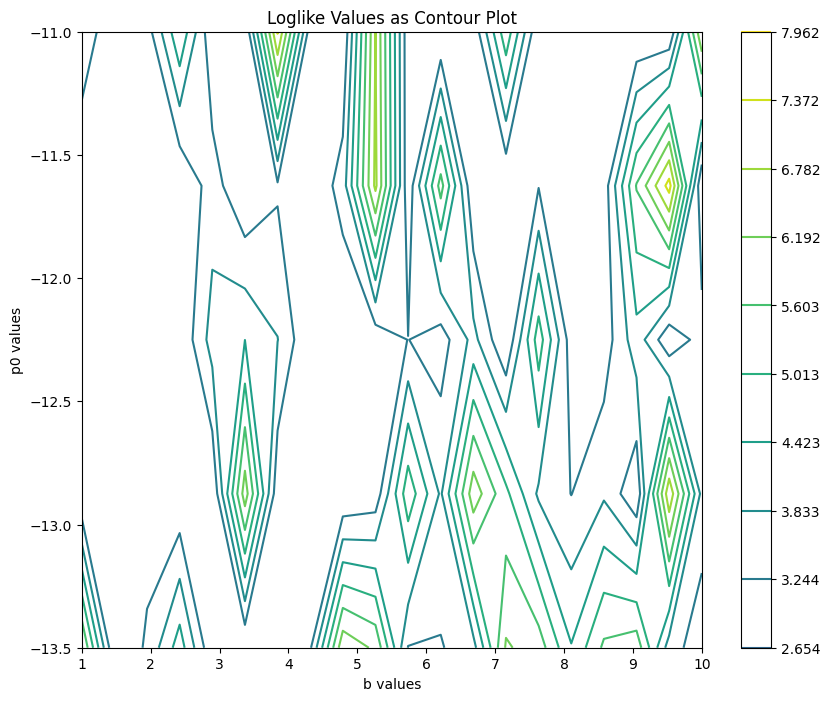

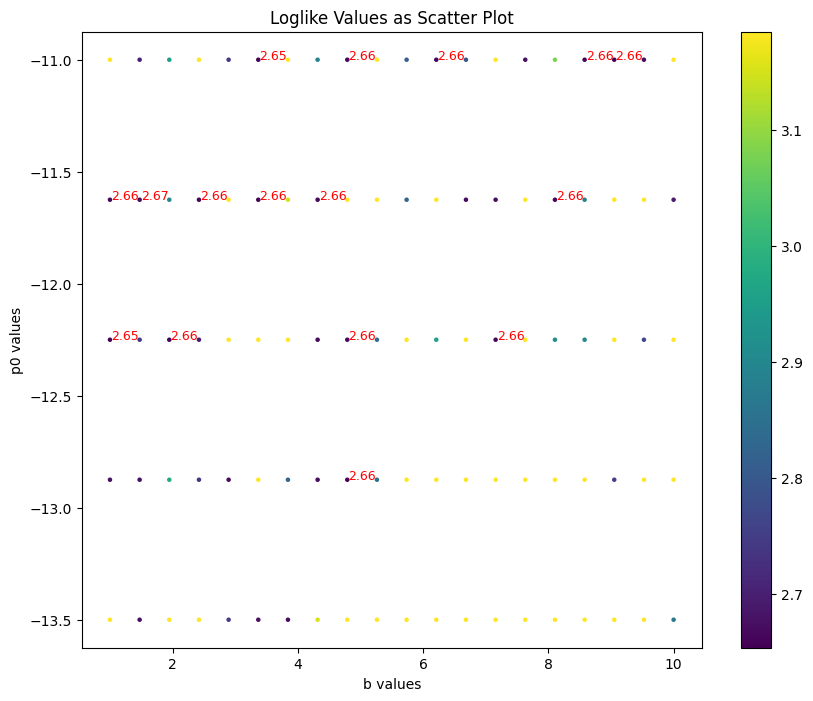

Calculated loglike_values[0, 0]
Calculated loglike_values[0, 1]
Calculated loglike_values[0, 2]
Calculated loglike_values[0, 3]
Calculated loglike_values[0, 4]
Calculated loglike_values[1, 0]
Calculated loglike_values[1, 1]
Calculated loglike_values[1, 2]
Calculated loglike_values[1, 3]
Calculated loglike_values[1, 4]
Calculated loglike_values[2, 0]
Calculated loglike_values[2, 1]
Calculated loglike_values[2, 2]
Calculated loglike_values[2, 3]
Calculated loglike_values[2, 4]
Calculated loglike_values[3, 0]
Calculated loglike_values[3, 1]
Calculated loglike_values[3, 2]
Calculated loglike_values[3, 3]
Calculated loglike_values[3, 4]
Calculated loglike_values[4, 0]
Calculated loglike_values[4, 1]
Calculated loglike_values[4, 2]
Calculated loglike_values[4, 3]
Calculated loglike_values[4, 4]
Calculated loglike_values[5, 0]
Calculated loglike_values[5, 1]
Calculated loglike_values[5, 2]
Calculated loglike_values[5, 3]
Calculated loglike_values[5, 4]
Calculated loglike_values[6, 0]
Calculat

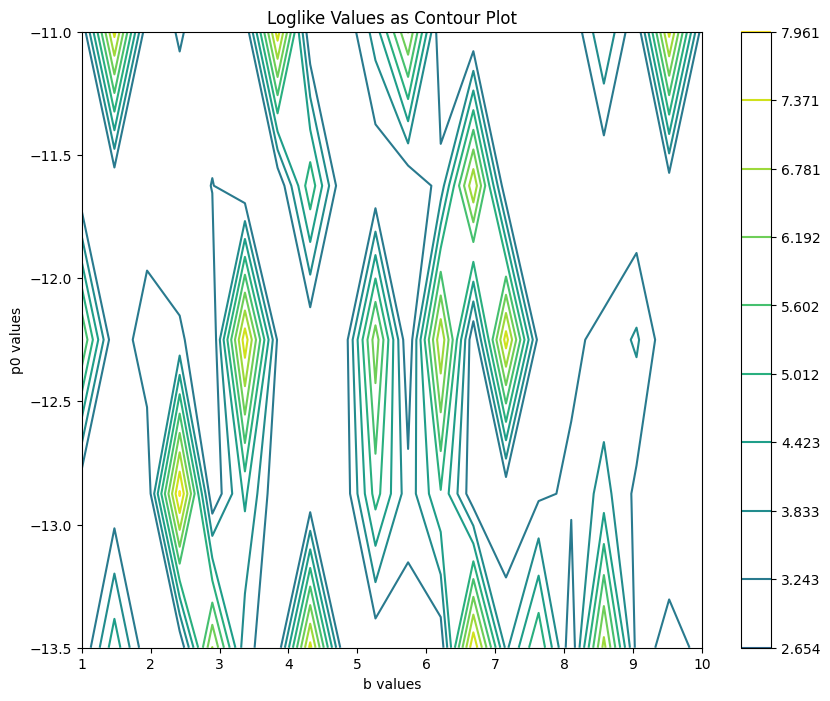

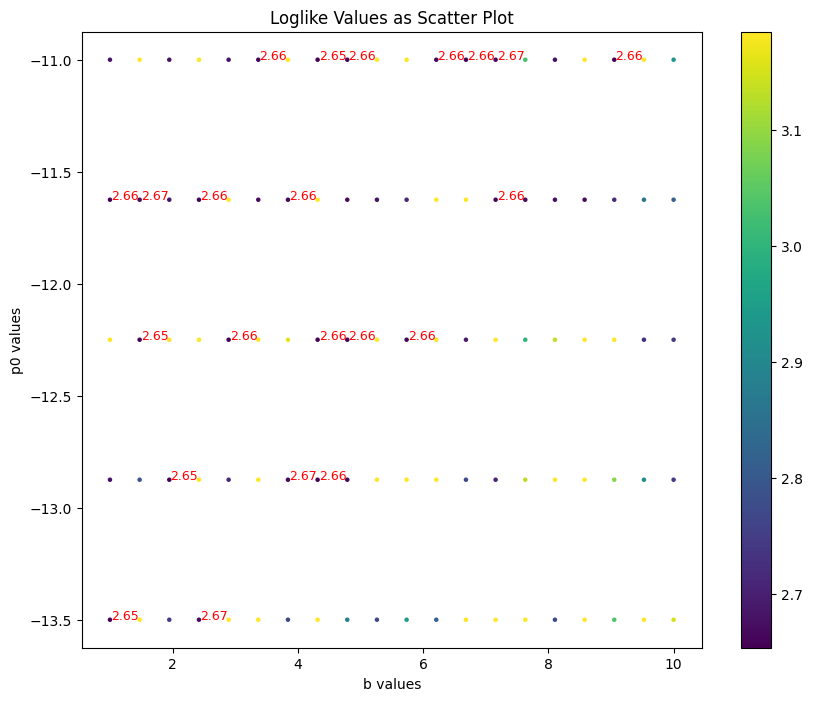

In [52]:
class optim_p3_fix_bp0_best_each_point:
    def __init__(self, data_path, constant_b, constant_p0):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x_me = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x_me, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1
        self.constant_b = constant_b
        self.constant_p0 = constant_p0

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, self.constant_b, self.constant_p0, -5.2, -0.95, -0.1], high=[1.9 * 10**5, self.constant_b, self.constant_p0, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_3(self):
        priors = self.create_priors()
        theta = []
        theta_opt = []
        for i in range(len(priors)):
            if i == 0:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 1:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 2:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 3:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 4:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 5:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))

        theta = torch.tensor(theta, dtype=torch.float32, requires_grad=True)
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta[2], theta_opt[1], theta_opt[2], theta_opt[3])
        loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

        if self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) >= self.threshold():
            while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
                priors = self.create_priors()
                theta = []
                theta_opt = []
                for i in range(len(priors)):
                    if i == 0:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 1:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 2:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 3:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 4:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 5:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))

                theta = torch.tensor(theta, dtype=torch.float32, requires_grad=True)
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta[2], theta_opt[1], theta_opt[2], theta_opt[3])
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta, theta_opt, y_pred_3

    def run(self):
        success = False

        while not success:

            counter = 0
            counter_lim = 5
            max_N = 1000
            loss_crit = 5
            loss_filter = 0.6
            loss_accept = 2.65
            final_loss_accept = 2.68
            losses_graphs = []
            final_losses = []

            while loss_accept < final_loss_accept:
                while counter <= counter_lim:

                    initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3()
                    optimizer = Adam([theta_opt], lr=0.001)
                    loss = initial_loss
                    losses = []
                    N_iter = 0

                    while N_iter < max_N:
                        # if N_iter == 0:
                        #     print(f"Initial Loss = {loss}")
                        optimizer.zero_grad()
                        y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta[2], theta_opt[1], theta_opt[2], theta_opt[3])
                        loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                        loss.backward()
                        optimizer.step()
                        losses.append(loss.detach().numpy())
                        N_iter += 1
                        if N_iter == max_N and loss > loss_accept:
                            # print(f"Final Loss too high. Adding 1 to counter.")
                            # print(f"Final Loss = {losses[-1]}, too high. Adding 1 to counter.")
                            final_losses.append(loss.detach().numpy())
                            losses_graphs.append(losses)
                            counter += 1
                            break
                        if N_iter == max_N and loss <= loss_accept:
                            counter = counter_lim + 1
                            break
                    if loss <= loss_accept:
                        break
                    if counter == counter_lim and loss > loss_accept:
                        # print("Counter limit reached. Adding 0.01 to loss_accept and resetting counter.")
                        loss_accept += 0.01
                        # print(f"Loss_accept = {loss_accept}, Final_loss_accept = {final_loss_accept}")
                        counter = 0
                        # if loss_accept >= final_loss_accept:
                            # print(f"Loss accept has reached limit.")
                        break
                if loss <= loss_accept:
                    break
                if loss_accept >= final_loss_accept:
                    break
            if loss <= loss_accept:
                success = True
                break
            if loss_accept >= final_loss_accept: #Once total count has been reached, change success to true regardless of loglike value obtained
                final_losses = np.array(final_losses)
                losses_graphs = np.array(losses_graphs)
                loss = final_losses.min()
                index = final_losses.argmin()
                losses = losses_graphs[index]
                success = True
                break

        # if loss < loss_accept: # If escaped total count and counter loops and loss < loss accept then success achieved
        #     print(f"Success achieved, Final loss = {losses[-1]}, Loss accept = {loss_accept}")

        # if loss >= loss_accept: # If escaped total count and counter loops only after limit then must mean loss >= loss accept so no success achieved
        #     print(f"Limit reached, Final loss = {losses[-1]}, Loss accept = {loss_accept}")

        if success == True:

            theta_final = []
        
            for i in range(len(theta)):
                if i == 0:
                    theta_final.append(theta_opt[i])
                if i == 1:
                    theta_final.append(theta[i])
                if i == 2:
                    theta_final.append(theta[i])
                if i == 3:
                    theta_final.append(theta_opt[i-2])
                if i == 4:
                    theta_final.append(theta_opt[i-2])
                if i == 5:
                    theta_final.append(theta_opt[i-2])
        
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.losses_array = np.array(losses)

# Pairwise contour plots of loss (loglike() function)

def contour_plot_bp0_best_each_point():

    # Grid of parameters
    b_ft_lower = 1 # Real is 10 Viewing is 
    b_ft_upper = 10 # Real is 1 Viewing is 
    p0_ft_lower = -13.5 # Real is -15 Viewing is -20
    p0_ft_upper = -11 # Real is -6 Viewing is 0

    b_ft_values = torch.linspace(b_ft_lower, b_ft_upper, 20)
    p0_ft_values = torch.linspace(p0_ft_lower, p0_ft_upper, 5)
    B, P0 = torch.meshgrid(b_ft_values, p0_ft_values)
    loglike_values = torch.zeros(B.shape)
    a_ft_values = torch.zeros(B.shape)
    p1_ft_values = torch.zeros(B.shape)
    p2_ft_values = torch.zeros(B.shape)
    p3_ft_values = torch.zeros(B.shape)
    # loglike_b_gradients = torch.zeros(B.shape)
    # loglike_p0_gradients = torch.zeros(B.shape)

    # Evaluate loglike over the grid for optimised values of other parameters
    for i in range(len(b_ft_values)):
        for j in range((len(p0_ft_values))):
            # Usage
            data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
            optimizer_class = optim_p3_fix_bp0_best_each_point(data_path, b_ft_values[i], p0_ft_values[j])
            optimizer_class.run()
            theta_final = optimizer_class.theta_final
            losses_array = optimizer_class.losses_array
            x_tensor = optimizer_class.x_tensor
            y_tensor = optimizer_class.y_tensor
            y_err_tensor = optimizer_class.y_err_tensor
            y_pred_3 = optimizer_class.curve_torch_3(x_tensor, theta_final[0], theta_final[1], theta_final[2], theta_final[3], theta_final[4], theta_final[5])
            loglike_values[i, j] = optimizer_class.loglike(y_pred_3, y_tensor, y_err_tensor)
            a_ft_values[i, j] = theta_final[0]
            p1_ft_values[i, j] = theta_final[3]
            p2_ft_values[i, j] = theta_final[4]
            p3_ft_values[i, j] = theta_final[5]

            # b = b_ft_values[i]
            # p0 = p0_ft_values[j]
            # loglike_values[i,j].backward()
            # loglike_b_gradients[i,j] = b.grad.item()
            # loglike_p0_gradients[i,j] = p0.grad.item()

            # print(f"{b_ft_values[i]}, {p0_ft_values[j]}, {loglike_values[i,j]}")
            print(f"Calculated loglike_values{[i,j]}")


    # Save file

    def save_loglike_values(loglike_values, a_ft_values, b_ft_values, p0_ft_values, p1_ft_values, p2_ft_values, p3_ft_values, filename_prefix='loglike_history_b_p0_best_each_point'):
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        filename = f"{filename_prefix}_{timestamp}.csv"
        
        loglike_values = loglike_values.detach().numpy()

        a_values_array = []
        b_values_array = []
        p0_values_array = []
        p1_values_array = []
        p2_values_array = []
        p3_values_array = []
        loglike_values_array = []
    
        for i in range(len(b_ft_values)):
            for j in range((len(p0_ft_values))):
                a_values_array.append(a_ft_values[i, j].item())
                b_values_array.append(b_ft_values[i].item())
                p0_values_array.append(p0_ft_values[j].item())
                p1_values_array.append(p1_ft_values[i, j].item())
                p2_values_array.append(p2_ft_values[i, j].item())
                p3_values_array.append(p3_ft_values[i, j].item())
                loglike_values_array.append(loglike_values[i, j].item())
    
        a_values_array = np.array(a_values_array)
        b_values_array = np.array(b_values_array)
        p0_values_array = np.array(p0_values_array)
        p1_values_array = np.array(p1_values_array)
        p2_values_array = np.array(p2_values_array)
        p3_values_array = np.array(p3_values_array)
        loglike_values_array = np.array(loglike_values_array)

        # Create a DataFrame with appropriate headers
        df = pd.DataFrame({
            'a_values': a_values_array,
            'b_values': b_values_array,
            'p0_values': p0_values_array,
            'p1_values': p1_values_array,
            'p2_values': p2_values_array,
            'p3_values': p3_values_array,
            'loglikelihood': loglike_values_array,
        })

        # Save the DataFrame to a new CSV file with headers
        df.to_csv(filename, index=False)
        print(f"Data saved to {filename}")

    save_loglike_values(loglike_values, a_ft_values, b_ft_values, p0_ft_values, p1_ft_values, p2_ft_values, p3_ft_values, filename_prefix='loglike_history_b_p0_best_each_point')

    # Contour plotting
    
    plt.figure(figsize=(10, 8))
    loglike_values_np = loglike_values.detach().numpy()
    levels = np.linspace(loglike_values_np.min(), loglike_values_np.min()*3, num=10)
    contour = plt.contour(B.numpy(), P0.numpy(), loglike_values_np, levels=levels, cmap='viridis', vmin=0, vmax=levels[-1])
    plt.colorbar(contour)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Contour Plot')
    plt.show()
    
    # Scatter Plotting

    a_values_array = []
    b_values_array = []
    p0_values_array = []
    p1_values_array = []
    p2_values_array = []
    p3_values_array = []
    loglike_values_array = []
    # loglike_b_gradients_array = []
    # loglike_p0_gradients_array = []
    
    for i in range(len(b_ft_values)):
        for j in range((len(p0_ft_values))):
            a_values_array.append(a_ft_values[i, j].item())
            b_values_array.append(b_ft_values[i].item())
            p0_values_array.append(p0_ft_values[j].item())
            p1_values_array.append(p1_ft_values[i, j].item())
            p2_values_array.append(p2_ft_values[i, j].item())
            p3_values_array.append(p3_ft_values[i, j].item())
            loglike_values_array.append(loglike_values[i, j].item())
            # loglike_b_gradients_array.append(loglike_b_gradients[i, j].item())
            # loglike_b_gradients_array.append(loglike_p0_gradients[i, j].item())
    
    b_values_array = np.array(b_values_array)
    p0_values_array = np.array(p0_values_array)
    loglike_values_array = np.array(loglike_values_array)
    # loglike_b_gradients_array = np.array(loglike_b_gradients_array)
    # loglike_p0_gradients_array = np.array(loglike_p0_gradients_array)

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(b_values_array, p0_values_array, c=loglike_values_array, cmap='viridis', s=5, vmin=loglike_values_np.min(), vmax=loglike_values_np.min()*1.2)
    plt.colorbar(scatter)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Scatter Plot')

    critical_loglike_value = loglike_values_np.min() * 1.005

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            plt.text(b_values_array[i] + 0.02, p0_values_array[i], str(round(loglike_values_array[i], 2)), fontsize=9, color='red')
            # print(f"""Critical loglikelihood met, loglike = {loglike_val}, at: \n  
            #       a = {a_values_array[i]} \n        
            #       b = {b_values_array[i]} \n
            #       p0 = {p0_values_array[i]} \n
            #       p1 = {p1_values_array[i]} \n
            #       p2 = {p2_values_array[i]} \n
            #       p3 = {p3_values_array[i]}""")
        # if critical_loglike_value - critical_loglike_value/10 < loglike_val < critical_loglike_value + critical_loglike_value/10:
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i], str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='orange')
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i] - 0.02, str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='green')

    plt.show()

# Call contour plot function
    
for i in range(3):
    contour_plot_bp0_best_each_point()

## Replot b vs p0

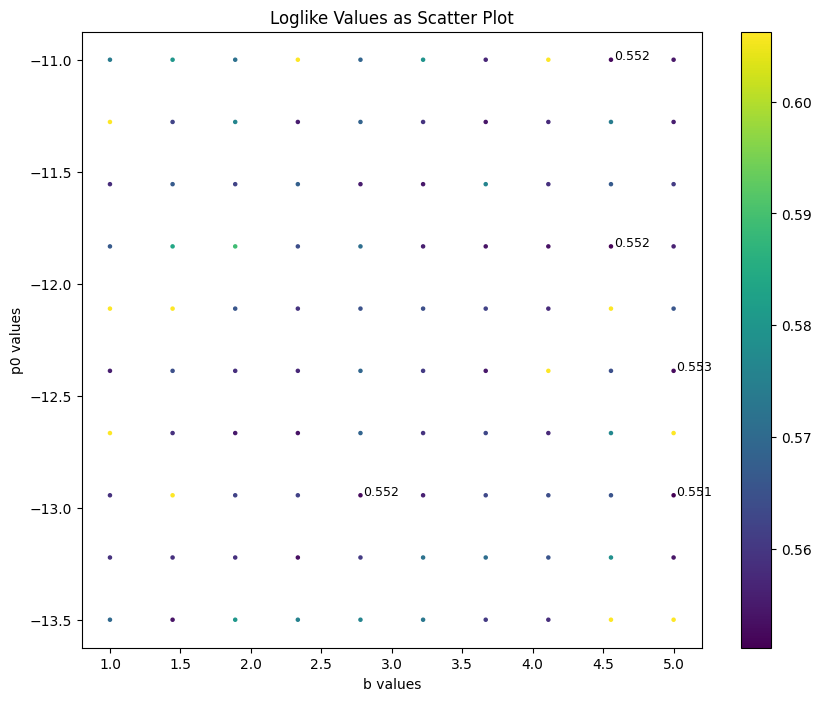

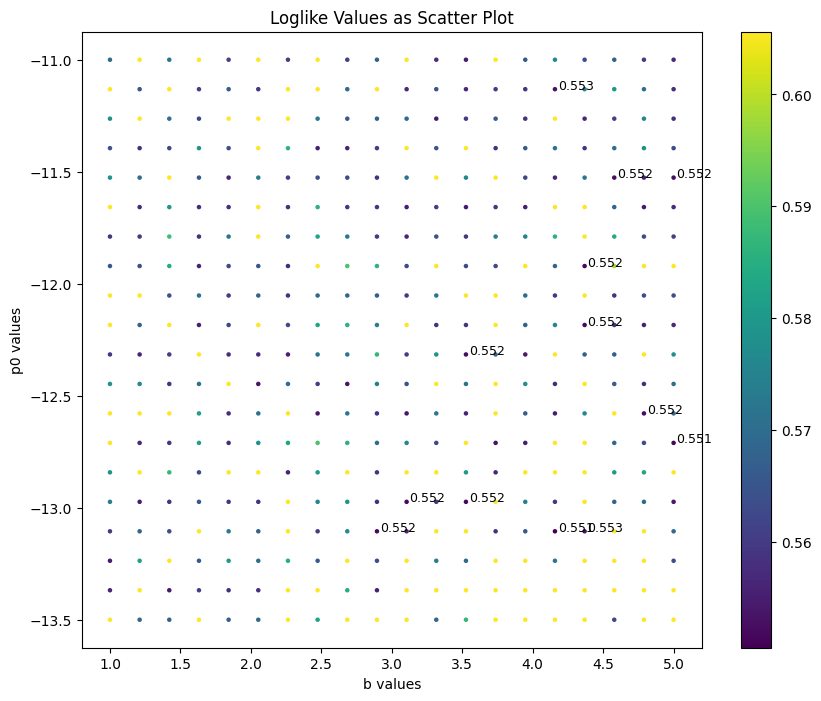

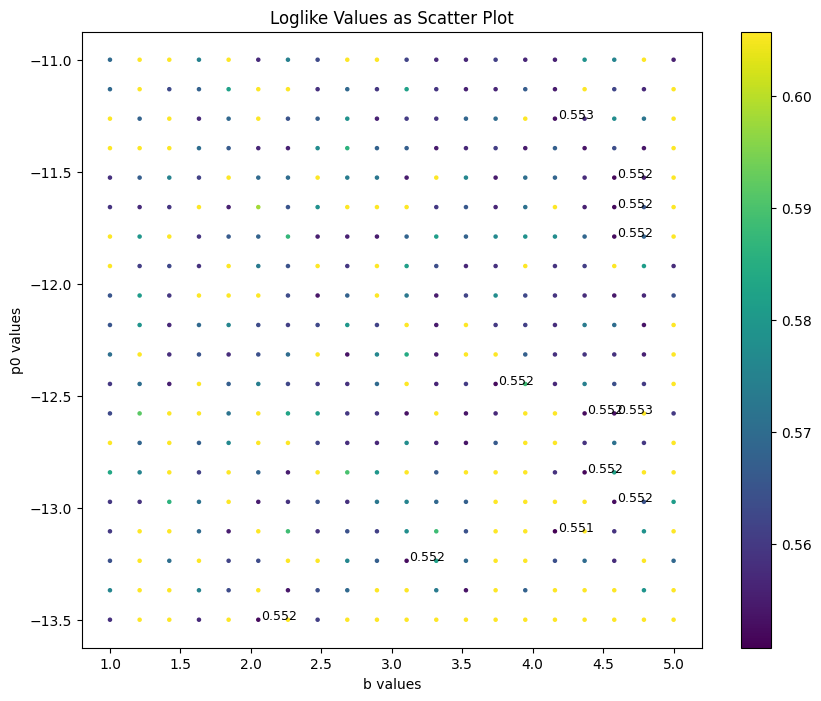

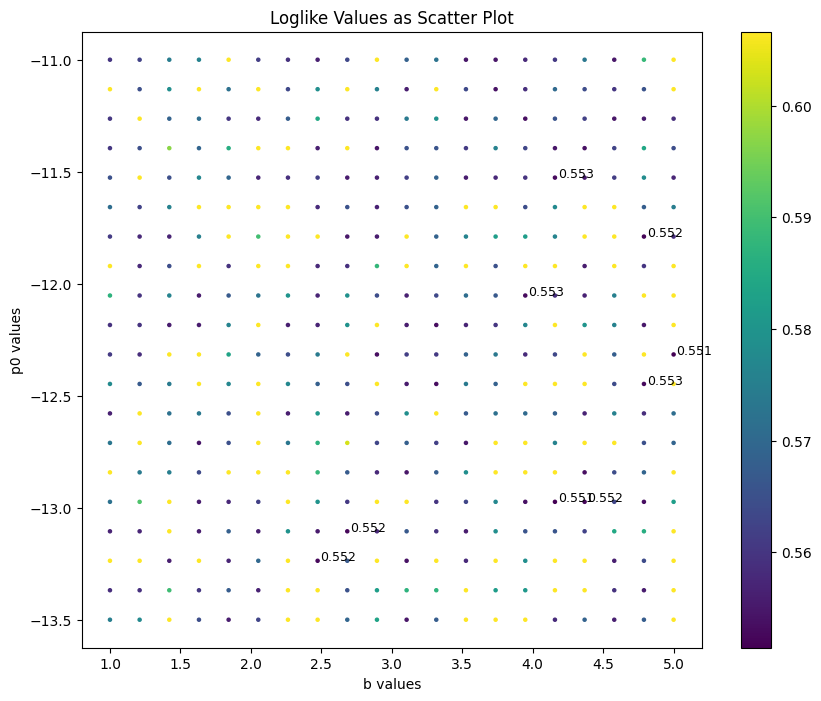

In [ ]:
# Plotting results

def replot_scatter_b_p0(filename):
    
    data = pd.read_csv(filename)

    a_values_array = data['a_values']
    b_values_array = data['b_values']
    p0_values_array = data['p0_values']
    p1_values_array = data['p1_values']
    p2_values_array = data['p2_values']
    p3_values_array = data['p3_values']
    loglike_values_array = data['loglikelihood']

    # Scatter Plotting

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(b_values_array, p0_values_array, c=loglike_values_array, cmap='viridis', s=5, vmin=loglike_values_array.min(), vmax=loglike_values_array.min()*1.1)
    plt.colorbar(scatter)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Scatter Plot')

    critical_loglike_value = 0.553

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            plt.text(b_values_array[i] + 0.02, p0_values_array[i], str(round(loglike_values_array[i], 3)), fontsize=9, color='black')
        # if critical_loglike_value - critical_loglike_value/10 < loglike_val < critical_loglike_value + critical_loglike_value/10:
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i], str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='black')
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i] - 0.02, str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='grey')
            # print(f"""Critical loglike met, loglike = {loglike_val}\n 
            #       a = {a_values_array[i]}\n 
            #       b = {b_values_array[i]}\n
            #       p0 = {p0_values_array[i]}\n
            #       p1 = {p1_values_array[i]}\n
            #       p2 = {p2_values_array[i]}\n
            #       p3 = {p3_values_array[i]}""")
    plt.show()

replot_scatter_b_p0("loglike_history_b_p0_best_each_point_20240313_235235.csv")
replot_scatter_b_p0("loglike_history_b_p0_best_each_point_20240314_014006.csv")
replot_scatter_b_p0("loglike_history_b_p0_best_each_point_20240314_030139.csv")
replot_scatter_b_p0("loglike_history_b_p0_best_each_point_20240314_042215.csv")

## b vs p1

In [ ]:
class optim_p3_fix_bp1_best_each_point:
    def __init__(self, data_path, constant_b, constant_p1):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x_me = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x_me, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1
        self.constant_b = constant_b
        self.constant_p1 = constant_p1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, self.constant_b, -13.5, self.constant_p1, -0.95, -0.1], high=[1.9 * 10**5, self.constant_b, -11, self.constant_p1, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 100

    def adjust_theta_3(self):
        priors = self.create_priors()
        theta = []
        theta_opt = []
        for i in range(len(priors)):
            if i == 0:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 1:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 2:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 3:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 4:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 5:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))

        theta = torch.tensor(theta, dtype=torch.float32, requires_grad=True)
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1], theta[3], theta_opt[2], theta_opt[3])
        loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

        if self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) >= self.threshold():
            while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
                priors = self.create_priors()
                theta = []
                theta_opt = []
                for i in range(len(priors)):
                    if i == 0:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 1:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 2:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 3:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 4:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 5:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))

                theta = torch.tensor(theta, dtype=torch.float32, requires_grad=True)
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1], theta[3], theta_opt[2], theta_opt[3])
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta, theta_opt, y_pred_3

    def run(self):
        success = False

        while not success:

            counter = 0
            counter_lim = 20
            max_N = 1000
            loss_crit = 5
            loss_filter = 0.6
            loss_accept = 0.55
            final_loss_accept = 0.60

            while loss_accept < final_loss_accept:
                while counter <= counter_lim:

                    initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3()
                    optimizer = Adam([theta_opt], lr=0.001)
                    loss = initial_loss
                    losses = []
                    N_iter = 0

                    while N_iter < max_N:
                        # if N_iter == 0:
                        #     print(f"Initial Loss = {loss}")
                        optimizer.zero_grad()
                        y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1], theta[3], theta_opt[2], theta_opt[3])
                        loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                        loss.backward()
                        optimizer.step()
                        losses.append(loss.detach().numpy())
                        N_iter += 1
                        if N_iter == max_N and loss > loss_accept:
                            # print(f"Final Loss too high. Adding 1 to counter.")
                            # print(f"Final Loss = {losses[-1]}, too high. Adding 1 to counter.")
                            counter += 1
                            break
                        if N_iter == max_N and loss <= loss_accept:
                            counter = counter_lim + 1
                            break
                    if loss <= loss_accept:
                        break
                    if counter == counter_lim and loss >= loss_accept:
                        # print("Counter limit reached. Adding 0.01 to loss_accept and resetting counter.")
                        loss_accept += 0.01
                        # print(f"Loss_accept = {loss_accept}, Final_loss_accept = {final_loss_accept}")
                        counter = 0
                        # if loss_accept >= final_loss_accept:
                            # print(f"Loss accept has reached limit.")
                        break
                if loss <= loss_accept:
                    break
                if loss_accept >= final_loss_accept:
                    break
            if loss <= loss_accept:
                success = True
                break
            if loss_accept >= final_loss_accept: #Once total count has been reached, change success to true regardless of loglike value obtained
                success = True
                break

        # if loss < loss_accept: # If escaped total count and counter loops and loss < loss accept then success achieved
        #     print(f"Success achieved, Final loss = {losses[-1]}, Loss accept = {loss_accept}")

        # if loss >= loss_accept: # If escaped total count and counter loops only after limit then must mean loss >= loss accept so no success achieved
        #     print(f"Limit reached, Final loss = {losses[-1]}, Loss accept = {loss_accept}")

        if success == True:

            theta_final = []
        
            for i in range(len(theta)):
                if i == 0:
                    theta_final.append(theta_opt[i])
                if i == 1:
                    theta_final.append(theta[i])
                if i == 2:
                    theta_final.append(theta_opt[i-1])
                if i == 3:
                    theta_final.append(theta[i])
                if i == 4:
                    theta_final.append(theta_opt[i-2])
                if i == 5:
                    theta_final.append(theta_opt[i-2])
        
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.losses_array = np.array(losses)

# Pairwise contour plots of loss (loglike() function)

def contour_plot_bp1_best_each_point():

    # Grid of parameters
    b_ft_lower = 1 # Real is 10 Viewing is 
    b_ft_upper = 5 # Real is 1 Viewing is 
    p1_ft_lower = -5.2 # Real is -15 Viewing is -20
    p1_ft_upper = -3.5 # Real is -6 Viewing is 0

    b_ft_values = torch.linspace(b_ft_lower, b_ft_upper, 20)
    p1_ft_values = torch.linspace(p1_ft_lower, p1_ft_upper, 6)
    B, P1 = torch.meshgrid(b_ft_values, p1_ft_values)
    loglike_values = torch.zeros(B.shape)
    a_ft_values = torch.zeros(B.shape)
    p0_ft_values = torch.zeros(B.shape)
    p2_ft_values = torch.zeros(B.shape)
    p3_ft_values = torch.zeros(B.shape)
    # loglike_b_gradients = torch.zeros(B.shape)
    # loglike_p0_gradients = torch.zeros(B.shape)

    # Evaluate loglike over the grid for optimised values of other parameters
    for i in range(len(b_ft_values)):
        for j in range((len(p1_ft_values))):
            # Usage
            data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
            optimizer_class = optim_p3_fix_bp1_best_each_point(data_path, b_ft_values[i], p1_ft_values[j])
            optimizer_class.run()
            theta_final = optimizer_class.theta_final
            losses_array = optimizer_class.losses_array
            x_tensor = optimizer_class.x_tensor
            y_tensor = optimizer_class.y_tensor
            y_err_tensor = optimizer_class.y_err_tensor
            y_pred_3 = optimizer_class.curve_torch_3(x_tensor, theta_final[0], theta_final[1], theta_final[2], theta_final[3], theta_final[4], theta_final[5])
            loglike_values[i, j] = optimizer_class.loglike(y_pred_3, y_tensor, y_err_tensor)
            a_ft_values[i, j] = theta_final[0]
            p0_ft_values[i, j] = theta_final[2]
            p2_ft_values[i, j] = theta_final[4]
            p3_ft_values[i, j] = theta_final[5]

            # b = b_ft_values[i]
            # p0 = p0_ft_values[j]
            # loglike_values[i,j].backward()
            # loglike_b_gradients[i,j] = b.grad.item()
            # loglike_p0_gradients[i,j] = p0.grad.item()

            # print(f"{b_ft_values[i]}, {p0_ft_values[j]}, {loglike_values[i,j]}")
            print(f"Calculated loglike_values{[i,j]}")


    # Save file

    def save_loglike_values(loglike_values, a_ft_values, b_ft_values, p0_ft_values, p1_ft_values, p2_ft_values, p3_ft_values, filename_prefix='loglike_history_b_p1_best_each_point'):
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        filename = f"{filename_prefix}_{timestamp}.csv"
        
        loglike_values = loglike_values.detach().numpy()

        a_values_array = []
        b_values_array = []
        p0_values_array = []
        p1_values_array = []
        p2_values_array = []
        p3_values_array = []
        loglike_values_array = []
    
        for i in range(len(b_ft_values)):
            for j in range((len(p1_ft_values))):
                a_values_array.append(a_ft_values[i, j].item())
                b_values_array.append(b_ft_values[i].item())
                p0_values_array.append(p0_ft_values[i, j].item())
                p1_values_array.append(p1_ft_values[j].item())
                p2_values_array.append(p2_ft_values[i, j].item())
                p3_values_array.append(p3_ft_values[i, j].item())
                loglike_values_array.append(loglike_values[i, j].item())
    
        a_values_array = np.array(a_values_array)
        b_values_array = np.array(b_values_array)
        p0_values_array = np.array(p0_values_array)
        p1_values_array = np.array(p1_values_array)
        p2_values_array = np.array(p2_values_array)
        p3_values_array = np.array(p3_values_array)
        loglike_values_array = np.array(loglike_values_array)

        # Create a DataFrame with appropriate headers
        df = pd.DataFrame({
            'a_values': a_values_array,
            'b_values': b_values_array,
            'p0_values': p0_values_array,
            'p1_values': p1_values_array,
            'p2_values': p2_values_array,
            'p3_values': p3_values_array,
            'loglikelihood': loglike_values_array,
        })

        # Save the DataFrame to a new CSV file with headers
        df.to_csv(filename, index=False)
        print(f"Data saved to {filename}")

    save_loglike_values(loglike_values, a_ft_values, b_ft_values, p0_ft_values, p1_ft_values, p2_ft_values, p3_ft_values, filename_prefix='loglike_history_b_p1_best_each_point')

    # Contour plotting
    
    plt.figure(figsize=(10, 8))
    loglike_values_np = loglike_values.detach().numpy()
    levels = np.linspace(loglike_values_np.min(), loglike_values_np.min()*3, num=10)
    contour = plt.contour(B.numpy(), P1.numpy(), loglike_values_np, levels=levels, cmap='viridis', vmin=0, vmax=levels[-1])
    plt.colorbar(contour)
    plt.xlabel('b values')
    plt.ylabel('p1 values')
    plt.title('Loglike Values as Contour Plot')
    plt.show()
    
    # Scatter Plotting

    a_values_array = []
    b_values_array = []
    p0_values_array = []
    p1_values_array = []
    p2_values_array = []
    p3_values_array = []
    loglike_values_array = []
    # loglike_b_gradients_array = []
    # loglike_p0_gradients_array = []
    
    for i in range(len(b_ft_values)):
        for j in range((len(p1_ft_values))):
            a_values_array.append(a_ft_values[i, j].item())
            b_values_array.append(b_ft_values[i].item())
            p0_values_array.append(p0_ft_values[i, j].item())
            p1_values_array.append(p1_ft_values[j].item())
            p2_values_array.append(p2_ft_values[i, j].item())
            p3_values_array.append(p3_ft_values[i, j].item())
            loglike_values_array.append(loglike_values[i, j].item())
            # loglike_b_gradients_array.append(loglike_b_gradients[i, j].item())
            # loglike_b_gradients_array.append(loglike_p0_gradients[i, j].item())
    
    b_values_array = np.array(b_values_array)
    p1_values_array = np.array(p1_values_array)
    loglike_values_array = np.array(loglike_values_array)
    # loglike_b_gradients_array = np.array(loglike_b_gradients_array)
    # loglike_p0_gradients_array = np.array(loglike_p0_gradients_array)

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(b_values_array, p1_values_array, c=loglike_values_array, cmap='viridis', s=5, vmin=loglike_values_np.min(), vmax=loglike_values_np.min()*1.2)
    plt.colorbar(scatter)
    plt.xlabel('b values')
    plt.ylabel('p1 values')
    plt.title('Loglike Values as Scatter Plot')

    critical_loglike_value = loglike_values_np.min() * 1.005

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            plt.text(b_values_array[i] + 0.02, p1_values_array[i], str(round(loglike_values_array[i], 2)), fontsize=9, color='red')
            # print(f"""Critical loglikelihood met, loglike = {loglike_val}, at: \n  
            #       a = {a_values_array[i]} \n        
            #       b = {b_values_array[i]} \n
            #       p0 = {p0_values_array[i]} \n
            #       p1 = {p1_values_array[i]} \n
            #       p2 = {p2_values_array[i]} \n
            #       p3 = {p3_values_array[i]}""")
        # if critical_loglike_value - critical_loglike_value/10 < loglike_val < critical_loglike_value + critical_loglike_value/10:
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i], str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='orange')
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i] - 0.02, str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='green')

    plt.show()

# Call contour plot function
    
for i in range(3):
    contour_plot_bp1_best_each_point()

## Replot b vs p1

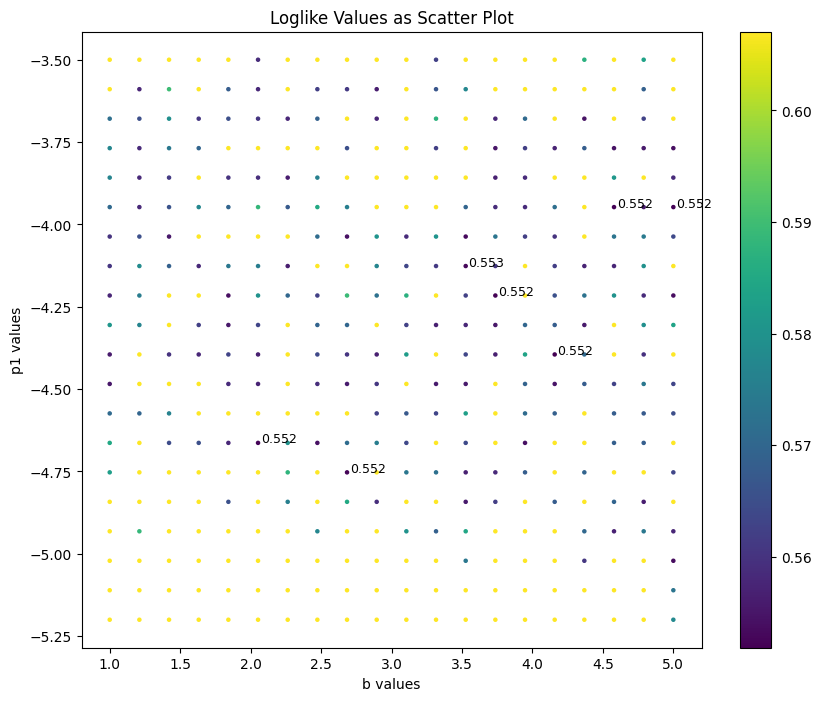

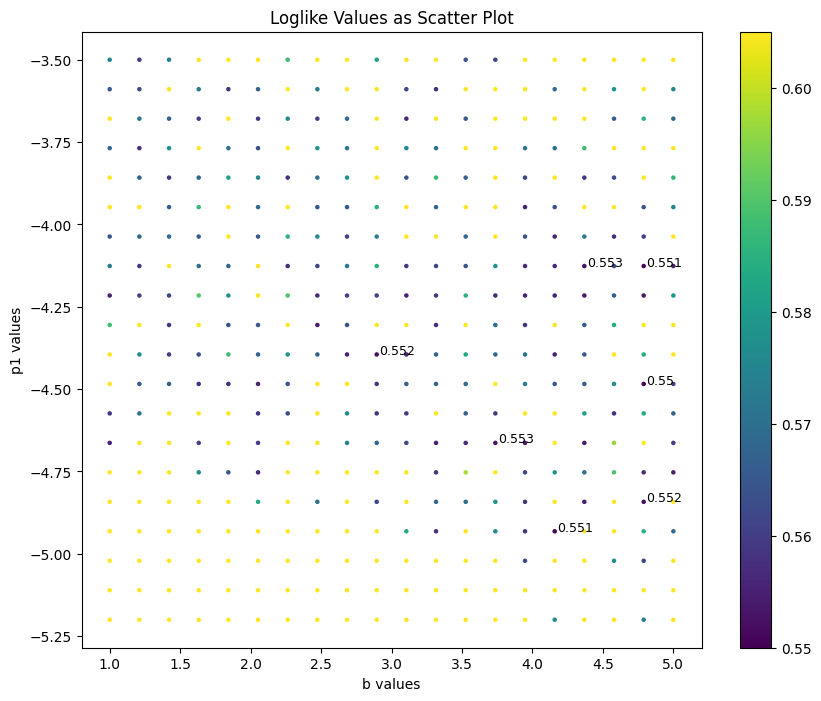

In [ ]:
# Plotting results

def replot_scatter_b_p1(filename):
    
    data = pd.read_csv(filename)

    a_values_array = data['a_values']
    b_values_array = data['b_values']
    p0_values_array = data['p0_values']
    p1_values_array = data['p1_values']
    p2_values_array = data['p2_values']
    p3_values_array = data['p3_values']
    loglike_values_array = data['loglikelihood']

    # Scatter Plotting

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(b_values_array, p1_values_array, c=loglike_values_array, cmap='viridis', s=5, vmin=loglike_values_array.min(), vmax=loglike_values_array.min()*1.1)
    plt.colorbar(scatter)
    plt.xlabel('b values')
    plt.ylabel('p1 values')
    plt.title('Loglike Values as Scatter Plot')

    critical_loglike_value = 0.553

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            plt.text(b_values_array[i] + 0.02, p1_values_array[i], str(round(loglike_values_array[i], 3)), fontsize=9, color='black')
        # if critical_loglike_value - critical_loglike_value/10 < loglike_val < critical_loglike_value + critical_loglike_value/10:
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i], str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='black')
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i] - 0.02, str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='grey')
            # print(f"""Critical loglike met, loglike = {loglike_val}\n 
            #       a = {a_values_array[i]}\n 
            #       b = {b_values_array[i]}\n
            #       p0 = {p0_values_array[i]}\n
            #       p1 = {p1_values_array[i]}\n
            #       p2 = {p2_values_array[i]}\n
            #       p3 = {p3_values_array[i]}""")
    plt.show()

replot_scatter_b_p1("loglike_history_b_p1_best_each_point_20240314_072059.csv")
replot_scatter_b_p1("loglike_history_b_p1_best_each_point_20240314_103842.csv")

## b vs p2

In [ ]:
class optim_p3_fix_bp2_best_each_point:
    def __init__(self, data_path, constant_b, constant_p2):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x_me = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x_me, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1
        self.constant_b = constant_b
        self.constant_p2 = constant_p2

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, self.constant_b, -13.5, -5.2, self.constant_p2, -0.1], high=[1.9 * 10**5, self.constant_b, -11, -3.5, self.constant_p2, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 100

    def adjust_theta_3(self):
        priors = self.create_priors()
        theta = []
        theta_opt = []
        for i in range(len(priors)):
            if i == 0:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 1:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 2:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 3:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 4:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            if i == 5:
                theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))

        theta = torch.tensor(theta, dtype=torch.float32, requires_grad=True)
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1], theta_opt[2], theta[4], theta_opt[3])
        loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

        if self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) >= self.threshold():
            while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
                priors = self.create_priors()
                theta = []
                theta_opt = []
                for i in range(len(priors)):
                    if i == 0:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 1:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 2:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 3:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 4:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                    if i == 5:
                        theta.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                        theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))

                theta = torch.tensor(theta, dtype=torch.float32, requires_grad=True)
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1], theta_opt[2], theta[4], theta_opt[3])
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta, theta_opt, y_pred_3

    def run(self):
        success = False

        while not success:

            counter = 0
            counter_lim = 20
            max_N = 1000
            loss_crit = 5
            loss_filter = 0.6
            loss_accept = 0.55
            final_loss_accept = 0.60

            while loss_accept < final_loss_accept:
                while counter <= counter_lim:

                    initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3()
                    optimizer = Adam([theta_opt], lr=0.001)
                    loss = initial_loss
                    losses = []
                    N_iter = 0

                    while N_iter < max_N:
                        # if N_iter == 0:
                        #     print(f"Initial Loss = {loss}")
                        optimizer.zero_grad()
                        y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1], theta_opt[2], theta[4], theta_opt[3])
                        loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                        loss.backward()
                        optimizer.step()
                        losses.append(loss.detach().numpy())
                        N_iter += 1
                        if N_iter == max_N and loss > loss_accept:
                            # print(f"Final Loss too high. Adding 1 to counter.")
                            # print(f"Final Loss = {losses[-1]}, too high. Adding 1 to counter.")
                            counter += 1
                            break
                        if N_iter == max_N and loss <= loss_accept:
                            counter = counter_lim + 1
                            break
                    if loss <= loss_accept:
                        break
                    if counter == counter_lim and loss >= loss_accept:
                        # print("Counter limit reached. Adding 0.01 to loss_accept and resetting counter.")
                        loss_accept += 0.01
                        # print(f"Loss_accept = {loss_accept}, Final_loss_accept = {final_loss_accept}")
                        counter = 0
                        # if loss_accept >= final_loss_accept:
                            # print(f"Loss accept has reached limit.")
                        break
                if loss <= loss_accept:
                    break
                if loss_accept >= final_loss_accept:
                    break
            if loss <= loss_accept:
                success = True
                break
            if loss_accept >= final_loss_accept: #Once total count has been reached, change success to true regardless of loglike value obtained
                success = True
                break

        # if loss < loss_accept: # If escaped total count and counter loops and loss < loss accept then success achieved
        #     print(f"Success achieved, Final loss = {losses[-1]}, Loss accept = {loss_accept}")

        # if loss >= loss_accept: # If escaped total count and counter loops only after limit then must mean loss >= loss accept so no success achieved
        #     print(f"Limit reached, Final loss = {losses[-1]}, Loss accept = {loss_accept}")

        if success == True:

            theta_final = []
        
            for i in range(len(theta)):
                if i == 0:
                    theta_final.append(theta_opt[i])
                if i == 1:
                    theta_final.append(theta[i])
                if i == 2:
                    theta_final.append(theta_opt[i-1])
                if i == 3:
                    theta_final.append(theta_opt[i-1])
                if i == 4:
                    theta_final.append(theta[i])
                if i == 5:
                    theta_final.append(theta_opt[i-2])
        
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.losses_array = np.array(losses)

# Pairwise contour plots of loss (loglike() function)

def contour_plot_bp2_best_each_point():

    # Grid of parameters
    b_ft_lower = 1 # Real is 10 Viewing is 
    b_ft_upper = 5 # Real is 1 Viewing is 
    p2_ft_lower = -0.95 # Real is -15 Viewing is -20
    p2_ft_upper = -0.45 # Real is -6 Viewing is 0

    b_ft_values = torch.linspace(b_ft_lower, b_ft_upper, 20)
    p2_ft_values = torch.linspace(p2_ft_lower, p2_ft_upper, 20)
    B, P2 = torch.meshgrid(b_ft_values, p2_ft_values)
    loglike_values = torch.zeros(B.shape)
    a_ft_values = torch.zeros(B.shape)
    p0_ft_values = torch.zeros(B.shape)
    p1_ft_values = torch.zeros(B.shape)
    p3_ft_values = torch.zeros(B.shape)
    # loglike_b_gradients = torch.zeros(B.shape)
    # loglike_p0_gradients = torch.zeros(B.shape)

    # Evaluate loglike over the grid for optimised values of other parameters
    for i in range(len(b_ft_values)):
        for j in range((len(p2_ft_values))):
            # Usage
            data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
            optimizer_class = optim_p3_fix_bp2_best_each_point(data_path, b_ft_values[i], p2_ft_values[j])
            optimizer_class.run()
            theta_final = optimizer_class.theta_final
            losses_array = optimizer_class.losses_array
            x_tensor = optimizer_class.x_tensor
            y_tensor = optimizer_class.y_tensor
            y_err_tensor = optimizer_class.y_err_tensor
            y_pred_3 = optimizer_class.curve_torch_3(x_tensor, theta_final[0], theta_final[1], theta_final[2], theta_final[3], theta_final[4], theta_final[5])
            loglike_values[i, j] = optimizer_class.loglike(y_pred_3, y_tensor, y_err_tensor)
            a_ft_values[i, j] = theta_final[0]
            p0_ft_values[i, j] = theta_final[2]
            p1_ft_values[i, j] = theta_final[3]
            p3_ft_values[i, j] = theta_final[5]

            # b = b_ft_values[i]
            # p0 = p0_ft_values[j]
            # loglike_values[i,j].backward()
            # loglike_b_gradients[i,j] = b.grad.item()
            # loglike_p0_gradients[i,j] = p0.grad.item()

            # print(f"{b_ft_values[i]}, {p0_ft_values[j]}, {loglike_values[i,j]}")
            print(f"Calculated loglike_values{[i,j]}")


    # Save file

    def save_loglike_values(loglike_values, a_ft_values, b_ft_values, p0_ft_values, p1_ft_values, p2_ft_values, p3_ft_values, filename_prefix='loglike_history_b_p2_best_each_point'):
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        filename = f"{filename_prefix}_{timestamp}.csv"
        
        loglike_values = loglike_values.detach().numpy()

        a_values_array = []
        b_values_array = []
        p0_values_array = []
        p1_values_array = []
        p2_values_array = []
        p3_values_array = []
        loglike_values_array = []
    
        for i in range(len(b_ft_values)):
            for j in range((len(p2_ft_values))):
                a_values_array.append(a_ft_values[i, j].item())
                b_values_array.append(b_ft_values[i].item())
                p0_values_array.append(p0_ft_values[i, j].item())
                p1_values_array.append(p1_ft_values[i, j].item())
                p2_values_array.append(p2_ft_values[j].item())
                p3_values_array.append(p3_ft_values[i, j].item())
                loglike_values_array.append(loglike_values[i, j].item())
    
        a_values_array = np.array(a_values_array)
        b_values_array = np.array(b_values_array)
        p0_values_array = np.array(p0_values_array)
        p1_values_array = np.array(p1_values_array)
        p2_values_array = np.array(p2_values_array)
        p3_values_array = np.array(p3_values_array)
        loglike_values_array = np.array(loglike_values_array)

        # Create a DataFrame with appropriate headers
        df = pd.DataFrame({
            'a_values': a_values_array,
            'b_values': b_values_array,
            'p0_values': p0_values_array,
            'p1_values': p1_values_array,
            'p2_values': p2_values_array,
            'p3_values': p3_values_array,
            'loglikelihood': loglike_values_array,
        })

        # Save the DataFrame to a new CSV file with headers
        df.to_csv(filename, index=False)
        print(f"Data saved to {filename}")

    save_loglike_values(loglike_values, a_ft_values, b_ft_values, p0_ft_values, p1_ft_values, p2_ft_values, p3_ft_values, filename_prefix='loglike_history_b_p2_best_each_point')

    # Contour plotting
    
    plt.figure(figsize=(10, 8))
    loglike_values_np = loglike_values.detach().numpy()
    levels = np.linspace(loglike_values_np.min(), loglike_values_np.min()*3, num=10)
    contour = plt.contour(B.numpy(), P2.numpy(), loglike_values_np, levels=levels, cmap='viridis', vmin=0, vmax=levels[-1])
    plt.colorbar(contour)
    plt.xlabel('b values')
    plt.ylabel('p2 values')
    plt.title('Loglike Values as Contour Plot')
    plt.show()
    
    # Scatter Plotting

    a_values_array = []
    b_values_array = []
    p0_values_array = []
    p1_values_array = []
    p2_values_array = []
    p3_values_array = []
    loglike_values_array = []
    # loglike_b_gradients_array = []
    # loglike_p0_gradients_array = []
    
    for i in range(len(b_ft_values)):
        for j in range((len(p2_ft_values))):
            a_values_array.append(a_ft_values[i, j].item())
            b_values_array.append(b_ft_values[i].item())
            p0_values_array.append(p0_ft_values[i, j].item())
            p1_values_array.append(p1_ft_values[i, j].item())
            p2_values_array.append(p2_ft_values[j].item())
            p3_values_array.append(p3_ft_values[i, j].item())
            loglike_values_array.append(loglike_values[i, j].item())
            # loglike_b_gradients_array.append(loglike_b_gradients[i, j].item())
            # loglike_b_gradients_array.append(loglike_p0_gradients[i, j].item())
    
    b_values_array = np.array(b_values_array)
    p2_values_array = np.array(p2_values_array)
    loglike_values_array = np.array(loglike_values_array)
    # loglike_b_gradients_array = np.array(loglike_b_gradients_array)
    # loglike_p0_gradients_array = np.array(loglike_p0_gradients_array)

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(b_values_array, p2_values_array, c=loglike_values_array, cmap='viridis', s=5, vmin=loglike_values_np.min(), vmax=loglike_values_np.min()*1.2)
    plt.colorbar(scatter)
    plt.xlabel('b values')
    plt.ylabel('p2 values')
    plt.title('Loglike Values as Scatter Plot')

    critical_loglike_value = 0.57

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            plt.text(b_values_array[i] + 0.02, p2_values_array[i], str(round(loglike_values_array[i], 2)), fontsize=9, color='red')
            # print(f"""Critical loglikelihood met, loglike = {loglike_val}, at: \n  
            #       a = {a_values_array[i]} \n        
            #       b = {b_values_array[i]} \n
            #       p0 = {p0_values_array[i]} \n
            #       p1 = {p1_values_array[i]} \n
            #       p2 = {p2_values_array[i]} \n
            #       p3 = {p3_values_array[i]}""")
        # if critical_loglike_value - critical_loglike_value/10 < loglike_val < critical_loglike_value + critical_loglike_value/10:
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i], str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='orange')
        #     plt.text(b_values_array[i] - 0.02, p0_values_array[i] - 0.02, str(round(loglike_b_gradients_array[i], 2)), fontsize=9, color='green')

    plt.show()

# Call contour plot function
    
for i in range(3):
    contour_plot_bp2_best_each_point()

In [ ]:
# Generate datasets
            
log_K_array = []

for j in range(500):

    # Usage
    N = 10**3
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    for i in range(N):
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p4_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_4 = []
    for i in range(N):
        theta = optimizer_class.create_priors()
        y_pred_4_rvs_priors = optimizer_class.curve_torch_4(x_tensor, *theta)
        y_pred_4_rvs_priors_plus_noise = torch.poisson(y_pred_4_rvs_priors)
        array_vector_datasets_4.append(y_pred_4_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    D3 = np.array(array_vector_datasets_3)
    D4 = np.array(array_vector_datasets_4)

    X = x_me

    class CustomBinaryClassifierLPop(BinaryClassifierLPop):
        def fit(self, X, y, **kwargs):
            # kwargs['batch_size'] = 128
            kwargs['num_epochs'] = 30
            super().fit(X, y, **kwargs)

    evidence_network = CustomBinaryClassifierLPop(len(X))

    data = np.concatenate((D3, D4))
    labels = np.concatenate((np.zeros(N), np.ones(N)))

    for k in range(1):
        # log_K_sub_array = []
        evidence_network.fit(data, labels)

        log_K = evidence_network.predict(De_event[...,None].T).squeeze()
        # log_K_sub_array.append(log_K)
        print(f"Bayes Factor = {log_K}")

    log_K_array.append(log_K)

plt.hist(log_K_array, bins=50, edgecolor='black')
plt.title('Histogram of log_k')
plt.xlabel('log_k')
plt.ylabel('Frequency')
plt.show()

# Generate data and caluclating Bayes factor

## Blind coverage test with i = 2 data (WORKS)

Datasets simulated
Datasets simulated
Using device:  cpu
Epoch 1/30, Loss: 0.5907297134399414
Epoch 2/30, Loss: 0.47206759452819824
Epoch 3/30, Loss: 0.35939058661460876
Epoch 4/30, Loss: 0.2693898677825928
Epoch 5/30, Loss: 0.2052532434463501
Epoch 6/30, Loss: 0.15205444395542145
Epoch 7/30, Loss: 0.1188410222530365
Epoch 8/30, Loss: 0.08978644758462906
Epoch 9/30, Loss: 0.07660099118947983
Epoch 10/30, Loss: 0.07142765820026398
Epoch 11/30, Loss: 0.06417987495660782
Epoch 12/30, Loss: 0.05658116936683655
Epoch 13/30, Loss: 0.061654843389987946
Epoch 14/30, Loss: 0.049181461334228516
Epoch 15/30, Loss: 0.03483264893293381
Epoch 16/30, Loss: 0.032466765493154526
Epoch 17/30, Loss: 0.038687530905008316
Epoch 18/30, Loss: 0.04156079515814781
Epoch 19/30, Loss: 0.04220464080572128
Epoch 20/30, Loss: 0.03734307736158371
Epoch 21/30, Loss: 0.032853398472070694
Epoch 22/30, Loss: 0.026473961770534515
Epoch 23/30, Loss: 0.01841495931148529
Epoch 24/30, Loss: 0.031582895666360855
Epoch 25/30, 

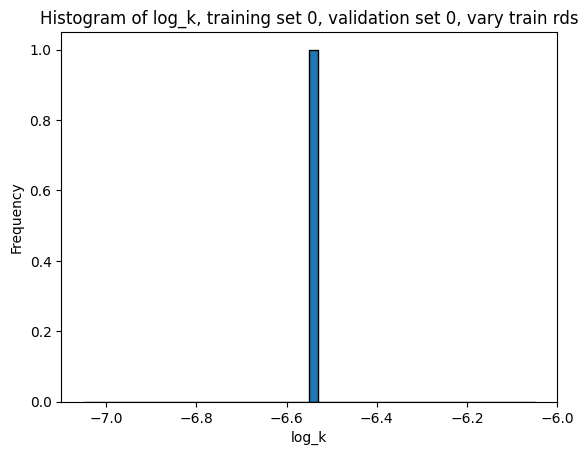

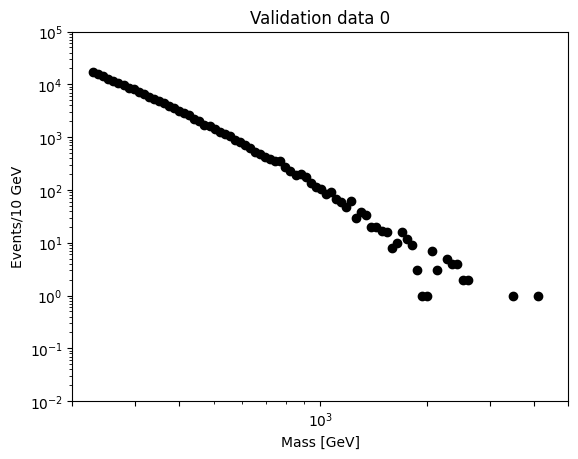

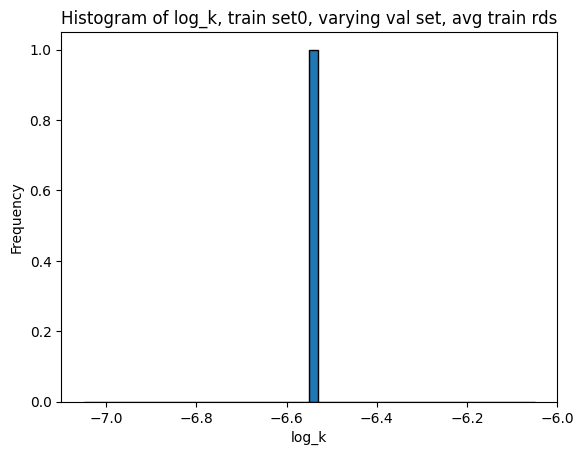

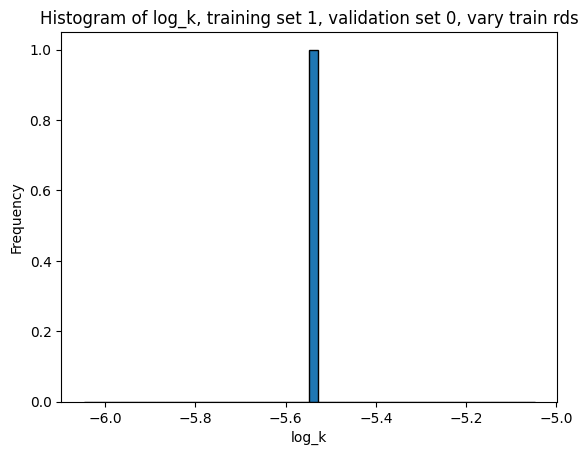

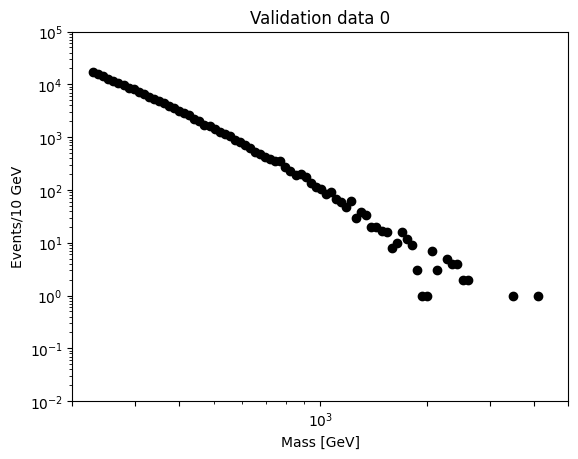

...

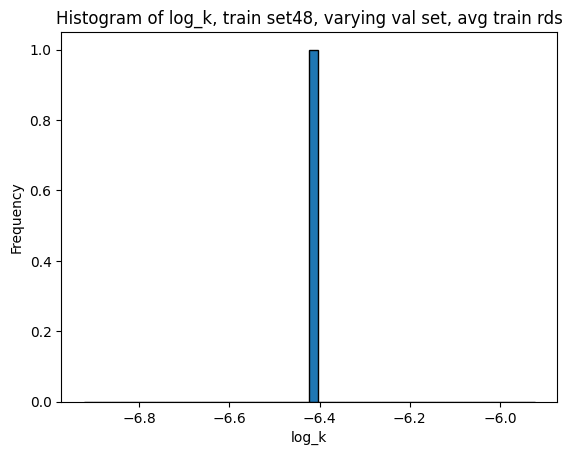

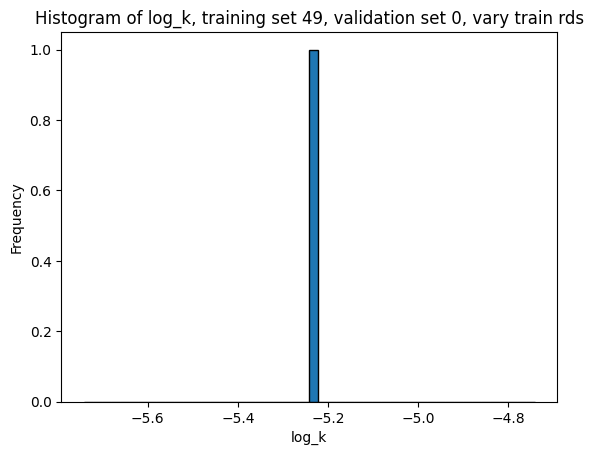

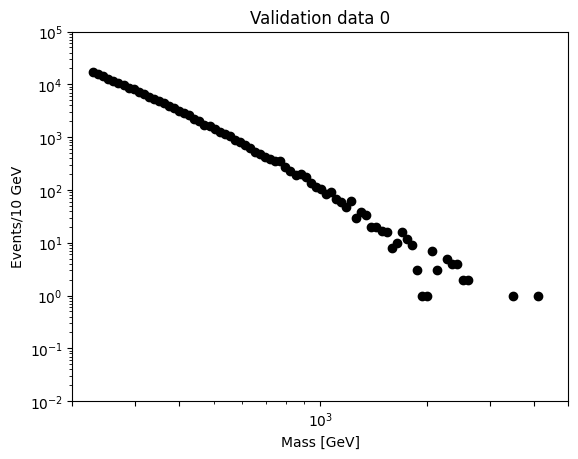

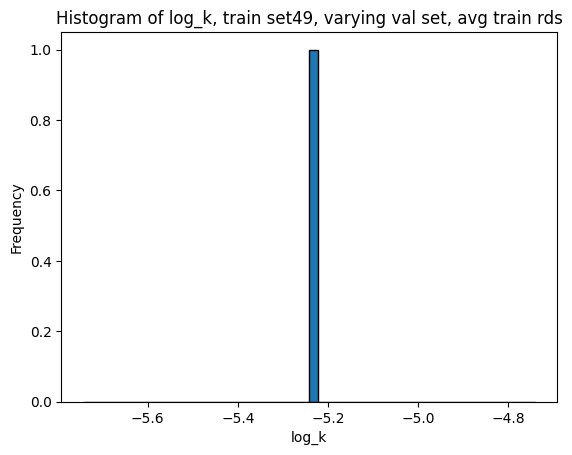

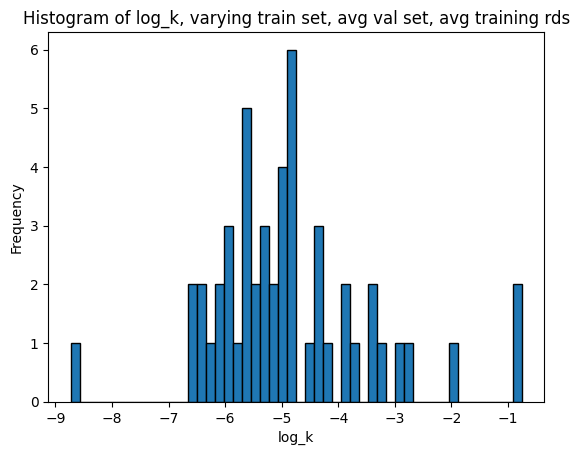

In [189]:
# Load and process data

De_mass, De_event, yerr = load_and_process_data('/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv')

# Save function for arrays

def save_multiple_arrays_with_timestamp(*arrays, base_filename='saved_log_K_arrays_BCT_i2'):
    """
    Saves multiple NumPy arrays to a single file with a timestamp, keeping them separate.
    
    Parameters:
    - arrays: Multiple NumPy array objects passed as separate arguments.
    - base_filename: Optional. Base name of the file without extension.
    
    The function saves the file in the current directory with the format:
    `base_filename_YYYYMMDD_HHMMSS.npz`

    Array1 = log_K_array
    Array2 = log_K_array_sub_array_means
    Array3 = log_K_array_means
    """
    # Format the current date and time as YYYYMMDD_HHMMSS
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    
    # Construct the filename with base_filename and timestamp
    filename = f'{base_filename}_{timestamp}.npz'
    
    # Prepare the arrays dict to save; keys are array0, array1, etc.
    arrays_dict = {f'array{i}': array for i, array in enumerate(arrays)}
    
    # Save the arrays to the file using np.savez
    np.savez(filename, **arrays_dict)
    
    print(f'Arrays saved as {filename}')

# Generate datasets
            
log_K_array = []
log_K_array_means = []
log_K_array_sub_array_means = []
num_sim_dataset_arrays_train_on = 50
num_sim_datasets_per_array = 10**3
num_val_datasets = 1
num_train_rounds = 1

for i in range(num_sim_dataset_arrays_train_on):

    # Usage
    N = num_sim_datasets_per_array
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    while len(array_vector_datasets_3) < N:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise[:1]) and all(y_pred_3_rvs_priors_plus_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_noise[1:]):
            array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p2_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_2 = []
    while len(array_vector_datasets_2) < N:
        theta = optimizer_class.create_priors()
        y_pred_2_rvs_priors = optimizer_class.curve_torch_2(x_tensor, *theta)
        y_pred_2_rvs_priors_plus_noise = torch.poisson(y_pred_2_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_2_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_2_rvs_priors_plus_noise[:1]) and all(y_pred_2_rvs_priors_plus_noise[0] > elem for elem in y_pred_2_rvs_priors_plus_noise[1:]):
            array_vector_datasets_2.append(y_pred_2_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Simulating validation datasets from i = 3

    array_vector_datasets_2_validation = []
    theta_validation = []

    while len(array_vector_datasets_2_validation) < num_val_datasets:
        optimizer_class = optim_p2_poisson(data_path)
        x_tensor = optimizer_class.x_tensor
        theta = optimizer_class.create_priors()
        y_pred_2_rvs_priors_validation = optimizer_class.curve_torch_2(x_tensor, *theta)
        y_pred_2_rvs_priors_plus_noise_validation = torch.poisson(y_pred_2_rvs_priors_validation)
        if all(y_val > 1 for y_val in y_pred_2_rvs_priors_plus_noise_validation[:80]) and all(y_val > 10**2 for y_val in y_pred_2_rvs_priors_plus_noise_validation[:1]) and all(y_pred_2_rvs_priors_plus_noise_validation[0] > elem for elem in y_pred_2_rvs_priors_plus_noise_validation[1:]):
            array_vector_datasets_2_validation.append(y_pred_2_rvs_priors_plus_noise_validation.detach().numpy())
            theta_validation.append(theta)

    D3 = np.array(array_vector_datasets_3)
    D2 = np.array(array_vector_datasets_2)

    X = x_tensor

    class CustomBinaryClassifier(BinaryClassifier):
        def fit(self, X, y, **kwargs):
            # kwargs['batch_size'] = 128
            kwargs['num_epochs'] = 30
            super().fit(X, y, **kwargs)

    data = np.concatenate((D2, D3))
    labels = np.concatenate((np.zeros(N), np.ones(N)))

    log_K_sub_array = []
    log_K_sub_array_means = []

    for j in range(num_val_datasets):

        array_vector_datasets_validation_subset = array_vector_datasets_2_validation[j]
        log_K_sub2_array = []
        valid_log_K_found = False

        # Outer loop to ensure all log_K values are finite
        while not valid_log_K_found:
            temp_log_K_sub2_array = []
            all_finite = True
            inf_counter = 0

            for k in range(num_train_rounds):
                finite_log_K_found = False  # Indicator for the current training round
                
                while not finite_log_K_found: # Calling a new instance of evidence_network each time to start training from fresh
                    evidence_network = CustomBinaryClassifier(len(X))
                    evidence_network.fit(data, labels)
                    log_K = evidence_network.predict(array_vector_datasets_validation_subset[...,None].T).squeeze()

                    if np.isnan(log_K):
                        print("Nan produced, retraining network.")
                    elif -10 <= log_K <= 10:
                        print(f"Bayes Factor = {log_K}")
                        temp_log_K_sub2_array.append(log_K)
                        finite_log_K_found = True
                    elif log_K < -10:
                        print(f"Bayes Factor = {log_K}")
                        print("Out of bounds Bayes Factor detected, appending -10 instead.")
                        max_value = -10
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True
                        inf_counter += 1
                    elif log_K > 10:
                        print(f"Bayes Factor = {log_K}")
                        print("Out of bounds Bayes Factor detected, appending 10 instead.")
                        max_value = 10
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True
                        inf_counter += 1
                    if inf_counter >= 20:
                        print("Sufficient inf produced to use new training set.")
                        break
                if inf_counter >= 20:
                    print("Sufficient inf produced to use new training set.")
                    break
            # # Check if the entire set of log_K values are finite
            # if all(not np.isinf(log_K).any() for log_K in temp_log_K_sub2_array):
            log_K_sub2_array = temp_log_K_sub2_array  # Save the valid results
            valid_log_K_found = True  # Exit the outer while loop
            if inf_counter >= 20:
                print("Sufficient inf produced to use new training set.")
                break
        if inf_counter >= 20:
            print("Sufficient inf produced to use new training set.")
            break
        
        log_K_sub_array.append(log_K_sub2_array)
        log_K_sub_array_means.append(np.mean(log_K_sub2_array))

    log_K_array.append(log_K_sub_array)
    log_K_array_sub_array_means.append(log_K_sub_array_means)
    log_K_array_means.append(np.mean(log_K_sub_array_means))

# Rename for clarity

logk_trainsets_valsets_trainrounds = log_K_array
logk_given_trainset_across_valsets_trainrounds_means = log_K_array_sub_array_means
logk_across_trainset_valsets_means_trainrounds_means = log_K_array_means

# Save arrays

# save_multiple_arrays_with_timestamp(logk_trainsets_valsets_trainrounds, logk_given_trainset_across_valsets_trainrounds_means, logk_across_trainset_valsets_means_trainrounds_means, base_filename='log_K_arrays_i2vi3')

for i in range(num_sim_dataset_arrays_train_on):

    for j in range(num_val_datasets):

        plt.hist(log_K_array[i][j], bins=50, edgecolor='black')
        plt.title(f'Histogram of log_k, training set {i}, validation set {j}, vary train rds')
        plt.xlabel('log_k')
        plt.ylabel('Frequency')
        plt.show()
            
        data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        optimizer_class = optim_p3_poisson(data_path)
        curve_torch_3 = optimizer_class.curve_torch_3
        plt.scatter(optimizer_class.De_mass, array_vector_datasets_validation[j], color='black')
        plt.yscale("log")
        plt.xscale("log")
        plt.xlabel("Mass [GeV]")
        plt.ylabel("Events/10 GeV")
        plt.xlim(200, 5000)
        plt.ylim(bottom = 10**-2, top=10**5)
        plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
        plt.title(f"Validation data {j}")
        plt.show()
    
    plt.hist(log_K_array_sub_array_means[i], bins=50, edgecolor='black')
    plt.title(f'Histogram of log_k, train set{i}, varying val set, avg train rds')
    plt.xlabel('log_k')
    plt.ylabel('Frequency')
    plt.show()

plt.hist(log_K_array_means, bins=50, edgecolor='black')
plt.title(f'Histogram of log_k, varying train set, avg val set, avg training rds')
plt.xlabel('log_k')
plt.ylabel('Frequency')
plt.show()

## Blind coverage test with i = 3 data (WORKS)

In [117]:
# Generate datasets
            
log_K_array = []
log_K_array_means = []
log_K_array_sub_array_means = []
num_sim_dataset_arrays_train_on = 1
num_sim_datasets_per_array = 10**5
num_val_datasets = 10
num_train_rounds = 50

for i in range(num_sim_dataset_arrays_train_on):

    # Usage
    N = num_sim_datasets_per_array
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    while len(array_vector_datasets_3) < N:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise[:1]) and all(y_pred_3_rvs_priors_plus_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_noise[1:]):
            array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p4_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_4 = []
    while len(array_vector_datasets_4) < N:
        theta = optimizer_class.create_priors()
        y_pred_4_rvs_priors = optimizer_class.curve_torch_4(x_tensor, *theta)
        y_pred_4_rvs_priors_plus_noise = torch.poisson(y_pred_4_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_4_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_4_rvs_priors_plus_noise[:1]) and all(y_pred_4_rvs_priors_plus_noise[0] > elem for elem in y_pred_4_rvs_priors_plus_noise[1:]):
            array_vector_datasets_4.append(y_pred_4_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Simulating validation datasets from i = 3

    array_vector_datasets_3_validation = []
    theta_validation = []

    while len(array_vector_datasets_3_validation) < num_val_datasets:
        optimizer_class = optim_p3_poisson(data_path)
        x_tensor = optimizer_class.x_tensor
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors_validation = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise_validation = torch.poisson(y_pred_3_rvs_priors_validation)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise_validation[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise_validation[:1]) and all(y_pred_3_rvs_priors_plus_noise_validation[0] > elem for elem in y_pred_3_rvs_priors_plus_noise_validation[1:]):
            array_vector_datasets_3_validation.append(y_pred_3_rvs_priors_plus_noise_validation.detach().numpy())
            theta_validation.append(theta)

    D3 = np.array(array_vector_datasets_3)
    D4 = np.array(array_vector_datasets_4)

    X = x_tensor

    class CustomBinaryClassifier(BinaryClassifier):
        def fit(self, X, y, **kwargs):
            # kwargs['batch_size'] = 128
            kwargs['num_epochs'] = 30
            super().fit(X, y, **kwargs)

    evidence_network = CustomBinaryClassifier(len(X))

    data = np.concatenate((D3, D4))
    labels = np.concatenate((np.zeros(N), np.ones(N)))

    log_K_sub_array = []
    log_K_sub_array_means = []

    for j in range(num_val_datasets):

        array_vector_datasets_3_validation_subset = array_vector_datasets_3_validation[j]
        log_K_sub2_array = []
        valid_log_K_found = False

        # Outer loop to ensure all log_K values are finite
        while not valid_log_K_found:
            temp_log_K_sub2_array = []
            all_finite = True

            for k in range(num_train_rounds):
                finite_log_K_found = False  # Indicator for the current training round
                
                while not finite_log_K_found:
                    evidence_network.fit(data, labels)
                    log_K = evidence_network.predict(array_vector_datasets_3_validation_subset[...,None].T).squeeze()

                    if not np.isinf(log_K).any():
                        print(f"Bayes Factor = {log_K}")
                        temp_log_K_sub2_array.append(log_K)
                        finite_log_K_found = True
                    else:
                        print(f"Bayes Factor = {log_K}")
                        print("Infinite Bayes Factor detected, appending -20 instead.")
                        max_value = -20
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True

            # # Check if the entire set of log_K values are finite
            # if all(not np.isinf(log_K).any() for log_K in temp_log_K_sub2_array):
            log_K_sub2_array = temp_log_K_sub2_array  # Save the valid results
            valid_log_K_found = True  # Exit the outer while loop
        
        log_K_sub_array.append(log_K_sub2_array)
        log_K_sub_array_means.append(np.mean(log_K_sub2_array))

    log_K_array.append(log_K_sub_array)
    log_K_array_sub_array_means.append(log_K_sub_array_means)
    log_K_array_means.append(np.mean(log_K_sub_array_means))



for i in range(num_sim_dataset_arrays_train_on):

    for j in range(num_val_datasets):

        plt.hist(log_K_array[i][j], bins=50, edgecolor='black')
        plt.title(f'Histogram of log_k, training set {i}, validation set {j}, vary train rds')
        plt.xlabel('log_k')
        plt.ylabel('Frequency')
        plt.show()
            
        print(f"theta_validation = {theta_validation[j]}")
        data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        optimizer_class = optim_p3_poisson(data_path)
        curve_torch_3 = optimizer_class.curve_torch_3
        plt.scatter(optimizer_class.De_mass, array_vector_datasets_3_validation[j], color='black')
        plt.yscale("log")
        plt.xscale("log")
        plt.xlabel("Mass [GeV]")
        plt.ylabel("Events/10 GeV")
        plt.xlim(200, 5000)
        plt.ylim(bottom = 10**-2, top=10**5)
        plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
        plt.title(f"Validation data {j}")
        plt.show()
    
    plt.hist(log_K_array_sub_array_means[i], bins=50, edgecolor='black')
    plt.title(f'Histogram of log_k, train set{i}, varying val set, avg train rds')
    plt.xlabel('log_k')
    plt.ylabel('Frequency')
    plt.show()

plt.hist(log_K_array_means, bins=50, edgecolor='black')
plt.title(f'Histogram of log_k, varying train set, avg val set, avg training rds')
plt.xlabel('log_k')
plt.ylabel('Frequency')
plt.show()
    

Datasets simulated


KeyboardInterrupt: 

## Blind coverage test with i = 4 data (WORKS)

Datasets simulated
Datasets simulated
Using device:  cpu
Epoch 1/30, Loss: 0.6788270473480225
Epoch 2/30, Loss: 0.6398502588272095
Epoch 3/30, Loss: 0.6179842352867126
Epoch 4/30, Loss: 0.5921362638473511
Epoch 5/30, Loss: 0.5722799301147461
Epoch 6/30, Loss: 0.5452722311019897
Epoch 7/30, Loss: 0.5323904156684875
Epoch 8/30, Loss: 0.5310531854629517
Epoch 9/30, Loss: 0.5272682905197144
Epoch 10/30, Loss: 0.5140780806541443
Epoch 11/30, Loss: 0.501983642578125
Epoch 12/30, Loss: 0.5063914060592651
Epoch 13/30, Loss: 0.49444571137428284
Epoch 14/30, Loss: 0.4882538318634033
Epoch 15/30, Loss: 0.4856732189655304
Epoch 16/30, Loss: 0.4758452773094177
Epoch 17/30, Loss: 0.49452877044677734
Epoch 18/30, Loss: 0.4801711440086365
Epoch 19/30, Loss: 0.4778289198875427
Epoch 20/30, Loss: 0.46226853132247925
Epoch 21/30, Loss: 0.4601688086986542
Epoch 22/30, Loss: 0.45742613077163696
Epoch 23/30, Loss: 0.4632745683193207
Epoch 24/30, Loss: 0.47190937399864197
Epoch 25/30, Loss: 0.441907167434692

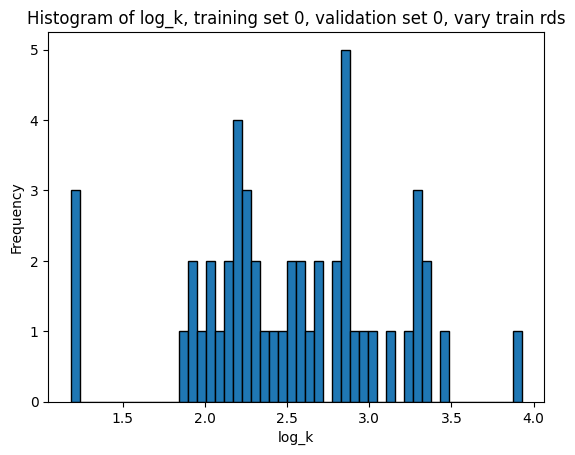

theta_validation = [ 1.81573363e+05  2.69756263e+00 -1.21524406e+01 -4.88916304e+00
 -7.75466126e-01 -4.52330786e-02 -2.18237841e-03]


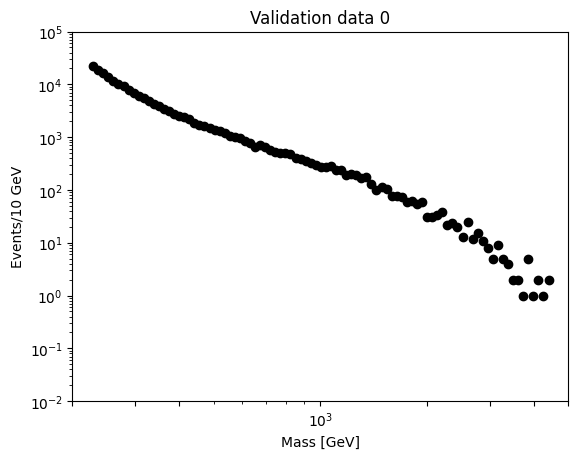

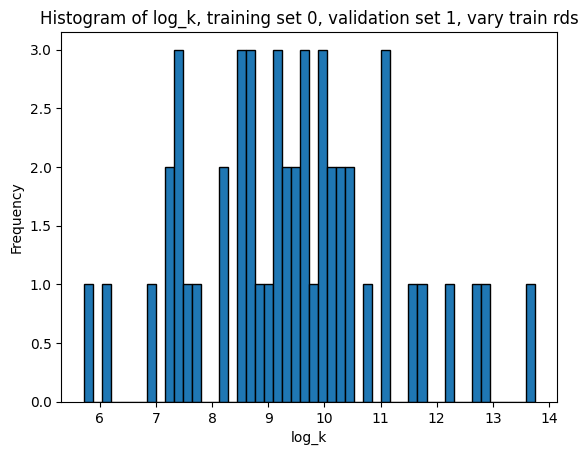

theta_validation = [ 1.75128056e+05  2.70300505e+00 -1.10547825e+01 -4.64713007e+00
 -7.58890201e-01 -5.30509667e-02 -2.86789602e-03]


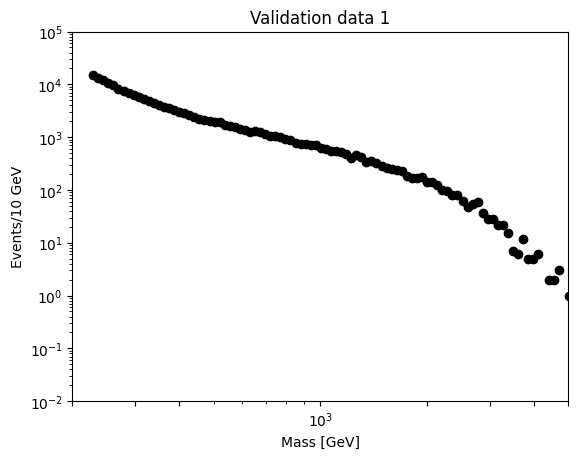

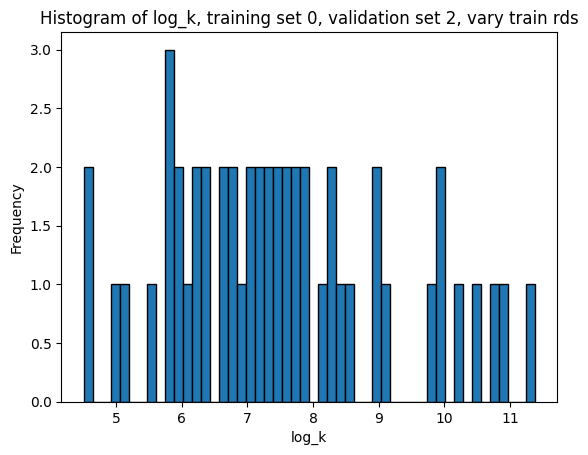

theta_validation = [ 1.71993575e+05  2.72173147e+00 -1.13780852e+01 -4.92882211e+00
 -9.10893916e-01 -7.76467255e-02 -5.15714683e-03]


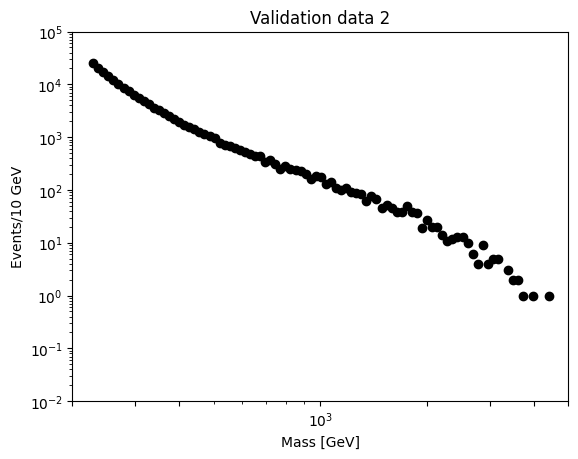

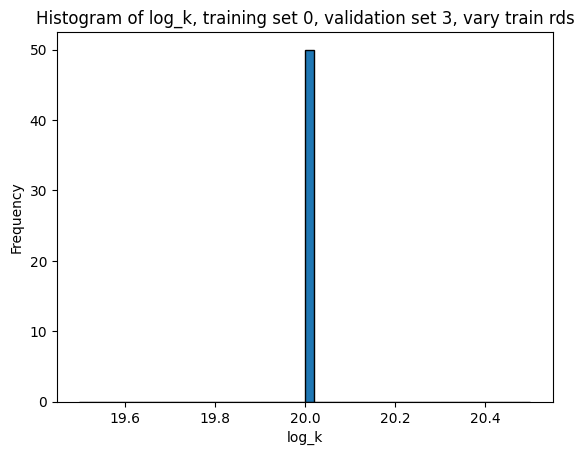

theta_validation = [ 1.86274306e+05  2.22031296e+00 -1.27780472e+01 -4.80682104e+00
 -6.36151597e-01 -5.08991228e-02 -5.14631749e-03]


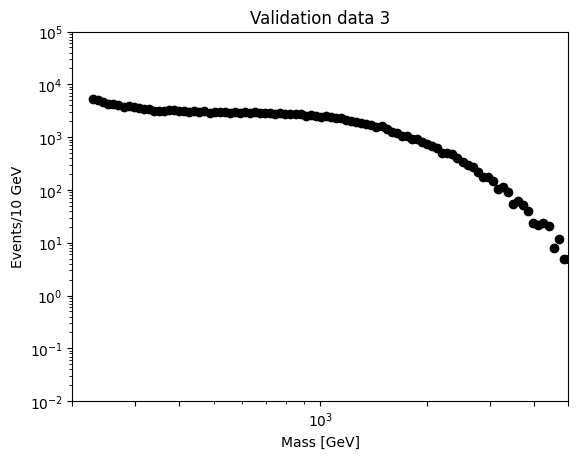

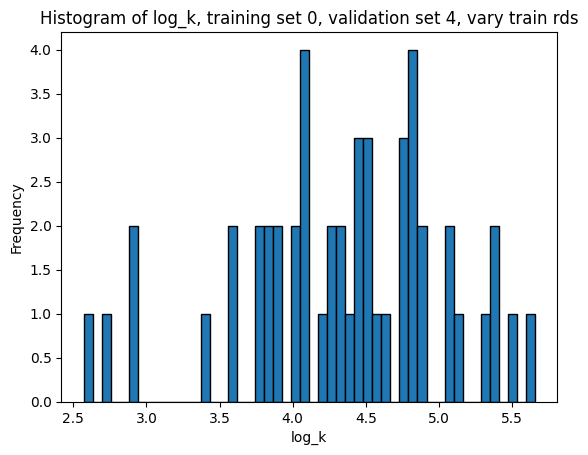

theta_validation = [ 1.84338218e+05  1.54227757e+00 -1.15867481e+01 -4.23570301e+00
 -6.79573589e-01 -4.48776275e-02 -1.68585934e-03]


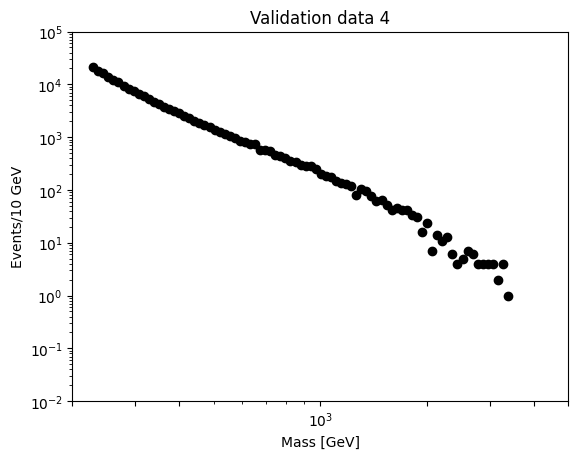

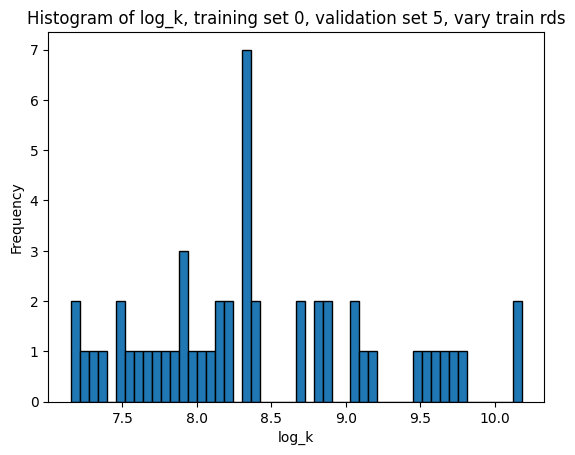

theta_validation = [ 1.72637981e+05  1.92731593e+00 -1.11491108e+01 -4.84206000e+00
 -7.92874972e-01 -6.36433958e-02 -3.35277868e-03]


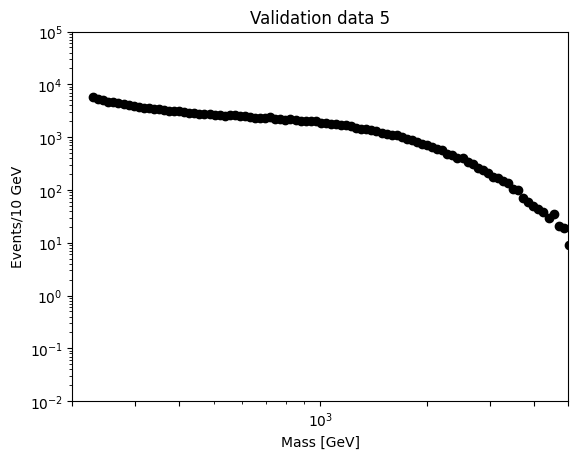

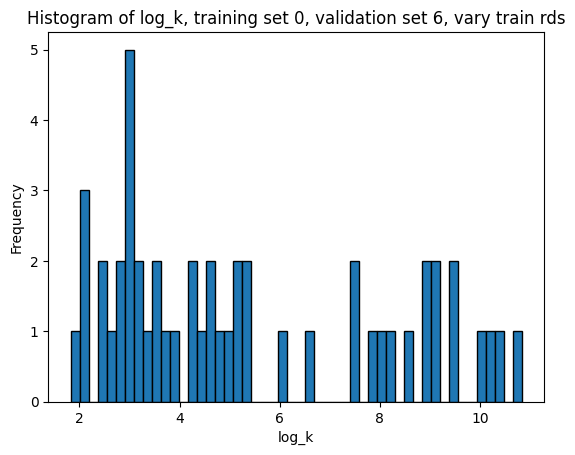

theta_validation = [ 1.85477820e+05  2.74388220e+00 -1.23368615e+01 -4.62867669e+00
 -7.68577890e-01 -6.91604484e-02 -3.03402759e-03]


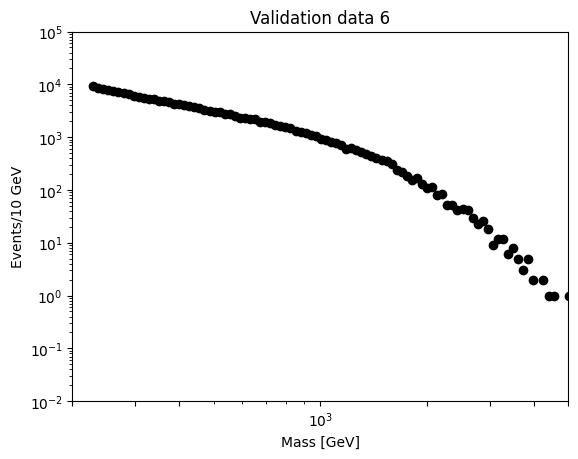

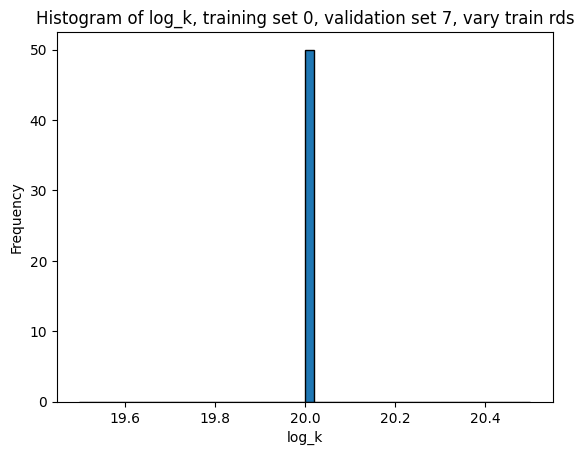

theta_validation = [ 1.77279180e+05  1.84917969e+00 -1.20406566e+01 -5.06837050e+00
 -8.57614409e-01 -7.69415309e-02 -5.76137284e-03]


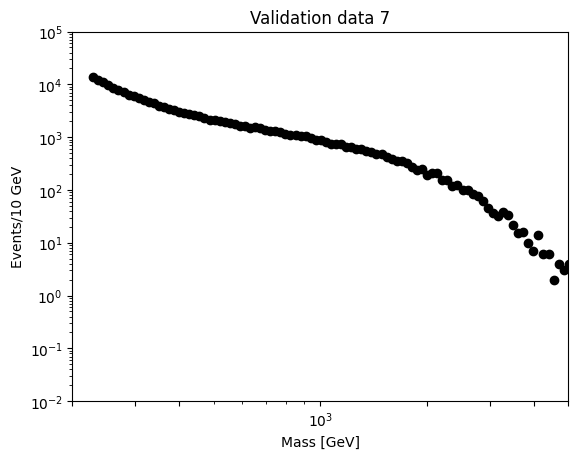

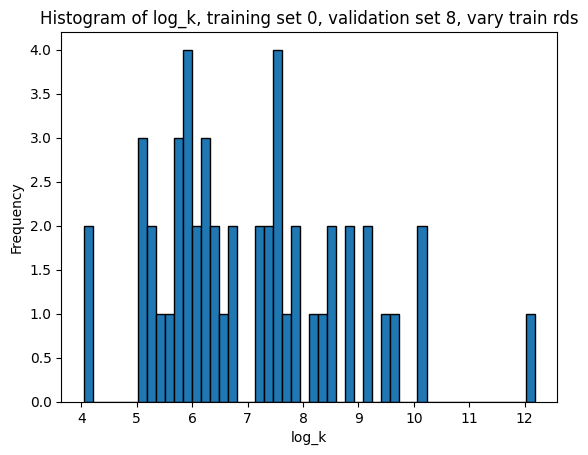

theta_validation = [ 1.83248103e+05  1.13690656e+00 -1.20432439e+01 -3.89901132e+00
 -5.98492067e-01 -5.35200043e-02 -2.80235431e-03]


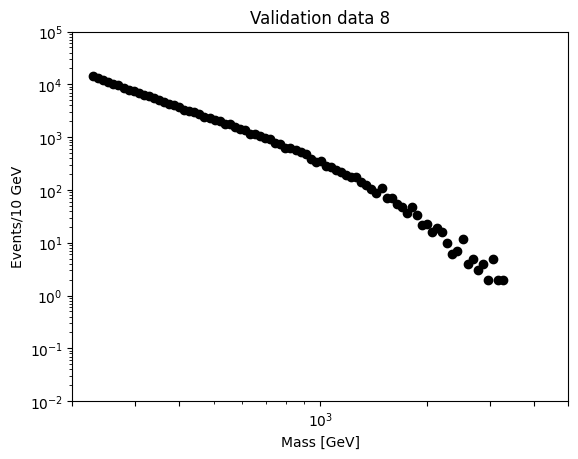

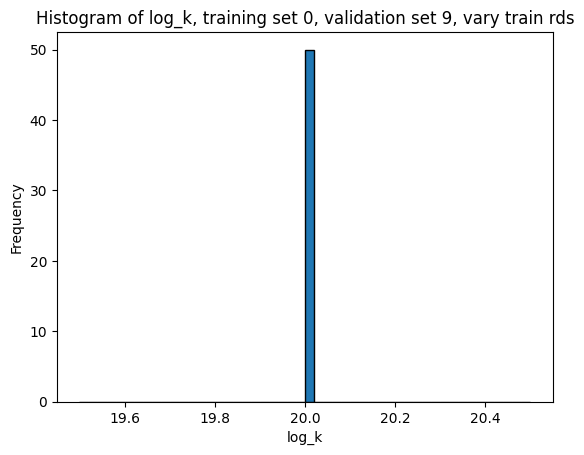

theta_validation = [ 1.75814212e+05  4.80030706e+00 -1.14046471e+01 -3.88720096e+00
 -5.73721815e-01 -5.19862571e-02 -3.12454142e-03]


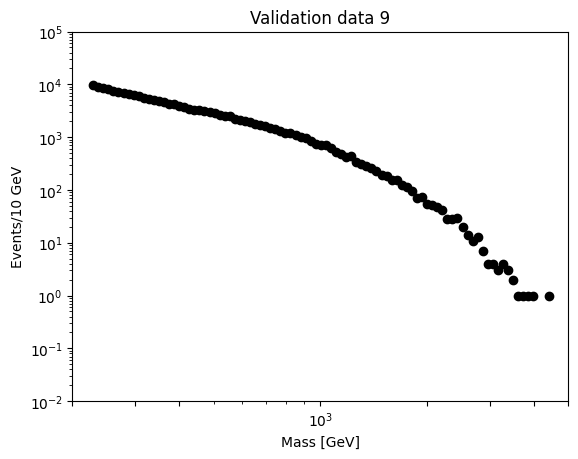

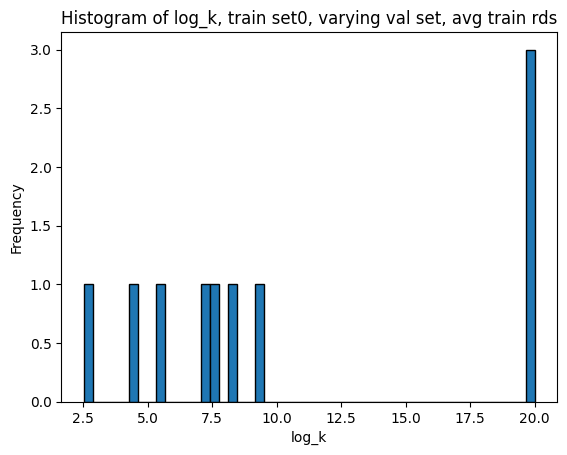

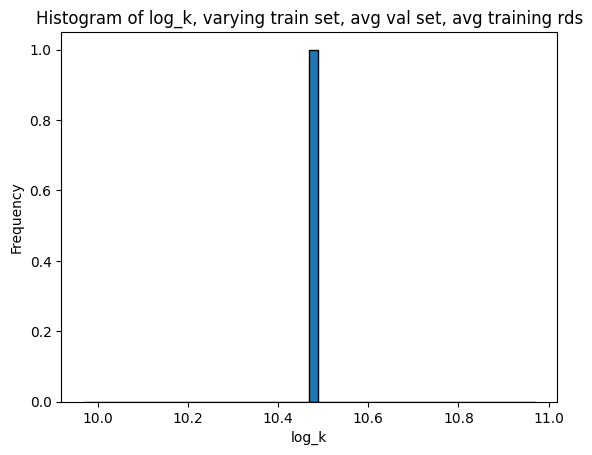

In [17]:
# Generate datasets
            
log_K_array = []
log_K_array_means = []
log_K_array_sub_array_means = []
num_sim_dataset_arrays_train_on = 1
num_sim_datasets_per_array = 10**3
num_val_datasets = 10
num_train_rounds = 50

for i in range(num_sim_dataset_arrays_train_on):

    # Usage
    N = num_sim_datasets_per_array
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    while len(array_vector_datasets_3) < N:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise[:1]) and all(y_pred_3_rvs_priors_plus_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_noise[1:]):
            array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p4_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_4 = []
    while len(array_vector_datasets_4) < N:
        theta = optimizer_class.create_priors()
        y_pred_4_rvs_priors = optimizer_class.curve_torch_4(x_tensor, *theta)
        y_pred_4_rvs_priors_plus_noise = torch.poisson(y_pred_4_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_4_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_4_rvs_priors_plus_noise[:1]) and all(y_pred_4_rvs_priors_plus_noise[0] > elem for elem in y_pred_4_rvs_priors_plus_noise[1:]):
            array_vector_datasets_4.append(y_pred_4_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Simulating validation datasets from i = 4

    array_vector_datasets_4_validation = []
    theta_validation = []

    while len(array_vector_datasets_4_validation) < num_val_datasets:
        optimizer_class = optim_p4_poisson(data_path)
        x_tensor = optimizer_class.x_tensor
        theta = optimizer_class.create_priors()
        y_pred_4_rvs_priors_validation = optimizer_class.curve_torch_4(x_tensor, *theta)
        y_pred_4_rvs_priors_plus_noise_validation = torch.poisson(y_pred_4_rvs_priors_validation)
        if all(y_val > 1 for y_val in y_pred_4_rvs_priors_plus_noise_validation[:80]) and all(y_val > 10**2 for y_val in y_pred_4_rvs_priors_plus_noise_validation[:1]) and all(y_pred_4_rvs_priors_plus_noise_validation[0] > elem for elem in y_pred_4_rvs_priors_plus_noise_validation[1:]):
            array_vector_datasets_4_validation.append(y_pred_4_rvs_priors_plus_noise_validation.detach().numpy())
            theta_validation.append(theta)

    D3 = np.array(array_vector_datasets_3)
    D4 = np.array(array_vector_datasets_4)

    X = x_tensor

    class CustomBinaryClassifier(BinaryClassifier):
        def fit(self, X, y, **kwargs):
            # kwargs['batch_size'] = 128
            kwargs['num_epochs'] = 30
            super().fit(X, y, **kwargs)

    evidence_network = CustomBinaryClassifier(len(X))

    data = np.concatenate((D3, D4))
    labels = np.concatenate((np.zeros(N), np.ones(N)))

    log_K_sub_array = []
    log_K_sub_array_means = []

    for j in range(num_val_datasets):

        array_vector_datasets_4_validation_subset = array_vector_datasets_4_validation[j]
        log_K_sub2_array = []
        valid_log_K_found = False

        # for k in range(num_train_rounds):
        #     evidence_network.fit(data, labels)
        #     log_K = evidence_network.predict(array_vector_datasets_4_validation_subset[...,None].T).squeeze()
        #     print(f"Bayes Factor = {log_K}")
        #     log_K_sub2_array.append(log_K)

        # Outer loop to ensure all log_K values are finite
        while not valid_log_K_found:
            temp_log_K_sub2_array = []
            all_finite = True

            for k in range(num_train_rounds):
                finite_log_K_found = False  # Indicator for the current training round
                
                while not finite_log_K_found:
                    evidence_network.fit(data, labels)
                    log_K = evidence_network.predict(array_vector_datasets_4_validation_subset[...,None].T).squeeze()

                    if not np.isinf(log_K).any():
                        print(f"Bayes Factor = {log_K}")
                        temp_log_K_sub2_array.append(log_K)
                        finite_log_K_found = True
                    else:
                        print(f"Bayes Factor = {log_K}")
                        print("Infinite Bayes Factor detected, appending 20 instead.")
                        max_value = 20
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True

            # # Check if the entire set of log_K values are finite
            # if all(not np.isinf(log_K).any() for log_K in temp_log_K_sub2_array):
            log_K_sub2_array = temp_log_K_sub2_array  # Save the valid results
            valid_log_K_found = True  # Exit the outer while loop
        
        log_K_sub_array.append(log_K_sub2_array)
        log_K_sub_array_means.append(np.mean(log_K_sub2_array))

    log_K_array.append(log_K_sub_array)
    log_K_array_sub_array_means.append(log_K_sub_array_means)
    log_K_array_means.append(np.mean(log_K_sub_array_means))



for i in range(num_sim_dataset_arrays_train_on):

    for j in range(num_val_datasets):

        plt.hist(log_K_array[i][j], bins=50, edgecolor='black')
        plt.title(f'Histogram of log_k, training set {i}, validation set {j}, vary train rds')
        plt.xlabel('log_k')
        plt.ylabel('Frequency')
        plt.show()
            
        print(f"theta_validation = {theta_validation[j]}")
        data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        optimizer_class = optim_p4_poisson(data_path)
        curve_torch_4 = optimizer_class.curve_torch_4
        plt.scatter(optimizer_class.De_mass, array_vector_datasets_4_validation[j], color='black')
        plt.yscale("log")
        plt.xscale("log")
        plt.xlabel("Mass [GeV]")
        plt.ylabel("Events/10 GeV")
        plt.xlim(200, 5000)
        plt.ylim(bottom = 10**-2, top=10**5)
        plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
        plt.title(f"Validation data {j}")
        plt.show()
    
    plt.hist(log_K_array_sub_array_means[i], bins=50, edgecolor='black')
    plt.title(f'Histogram of log_k, train set{i}, varying val set, avg train rds')
    plt.xlabel('log_k')
    plt.ylabel('Frequency')
    plt.show()

plt.hist(log_K_array_means, bins=50, edgecolor='black')
plt.title(f'Histogram of log_k, varying train set, avg val set, avg training rds')
plt.xlabel('log_k')
plt.ylabel('Frequency')
plt.show()
    

## Real data Bayes factor (i2 vs i3)

Datasets simulated
Datasets simulated
Using device:  cpu
Epoch 1/30, Loss: 0.6500071883201599
Epoch 2/30, Loss: 0.5880386829376221
Epoch 3/30, Loss: 0.5341418981552124
Epoch 4/30, Loss: 0.4936649799346924
Epoch 5/30, Loss: 0.4716522693634033
Epoch 6/30, Loss: 0.4323666989803314
Epoch 7/30, Loss: 0.4369938373565674
Epoch 8/30, Loss: 0.41822415590286255
Epoch 9/30, Loss: 0.4000045359134674
Epoch 10/30, Loss: 0.3888853192329407
Epoch 11/30, Loss: 0.3861212432384491
Epoch 12/30, Loss: 0.37808164954185486
Epoch 13/30, Loss: 0.402077317237854
Epoch 14/30, Loss: 0.37774181365966797
Epoch 15/30, Loss: 0.36323046684265137
Epoch 16/30, Loss: 0.36800992488861084
Epoch 17/30, Loss: 0.37427157163619995
Epoch 18/30, Loss: 0.3728952705860138
Epoch 19/30, Loss: 0.3671039938926697
Epoch 20/30, Loss: 0.3606606721878052
Epoch 21/30, Loss: 0.35703420639038086
Epoch 22/30, Loss: 0.3554345667362213
Epoch 23/30, Loss: 0.3386046886444092
Epoch 24/30, Loss: 0.34630948305130005
Epoch 25/30, Loss: 0.348244875669

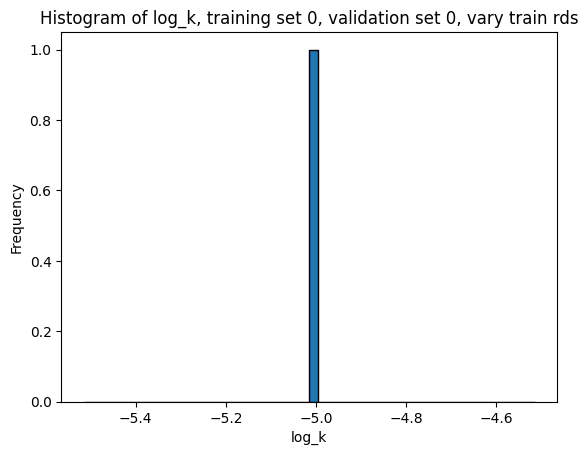

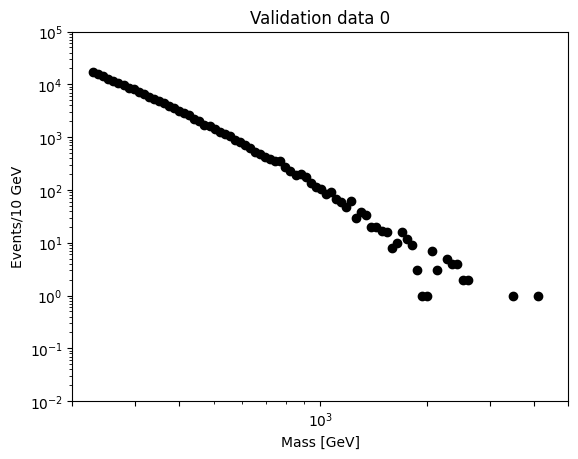

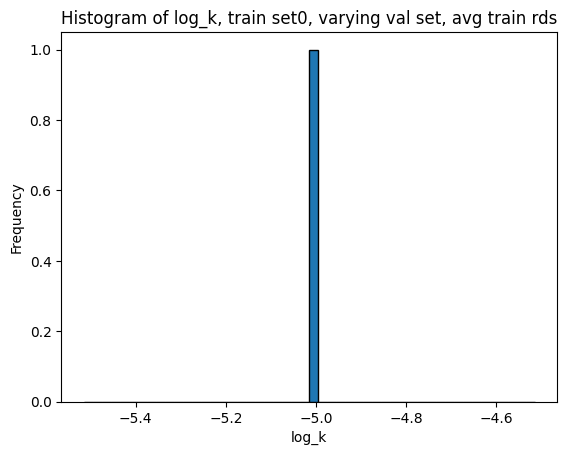

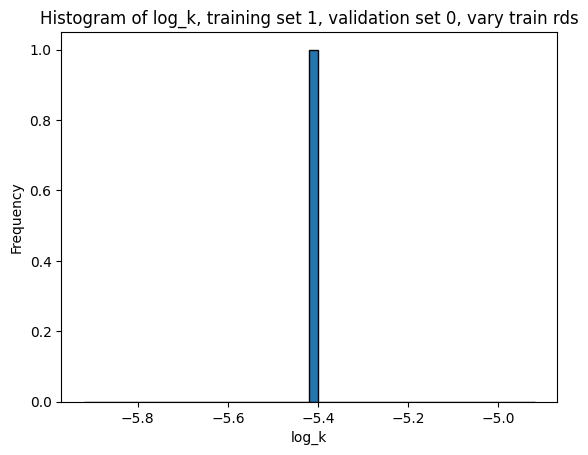

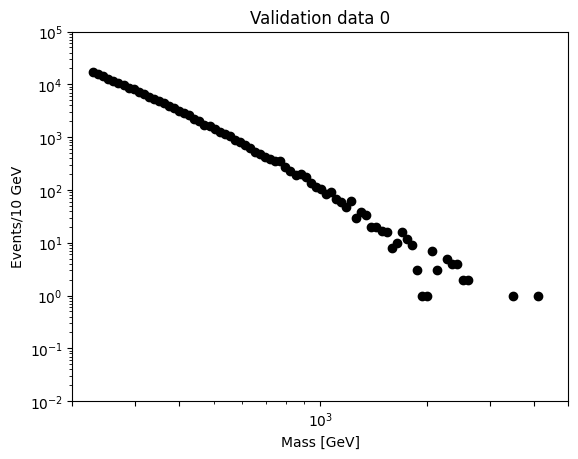

...

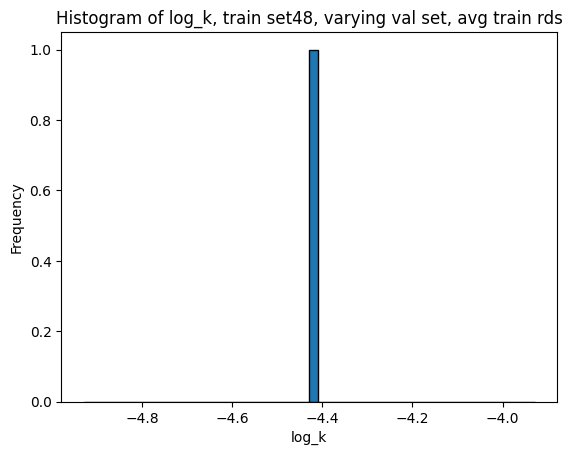

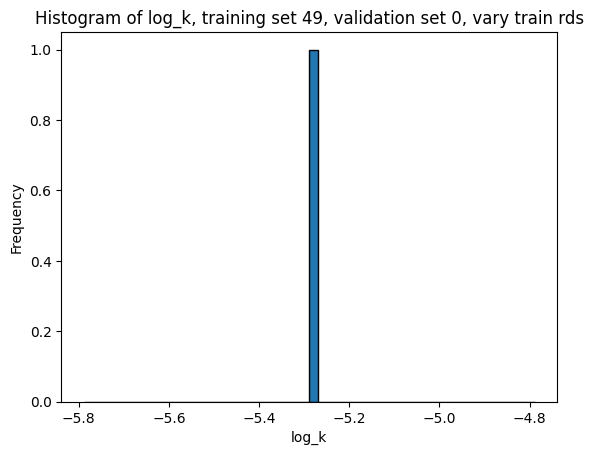

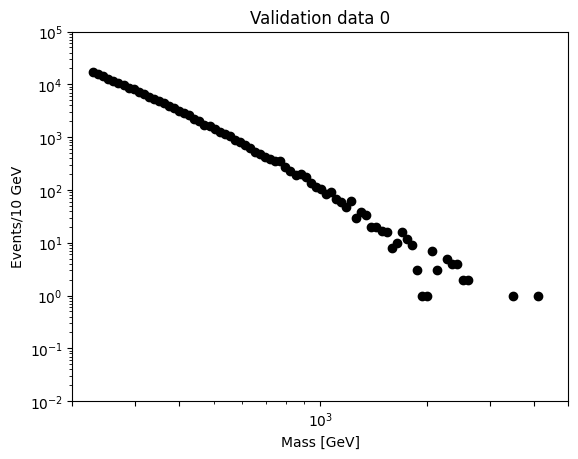

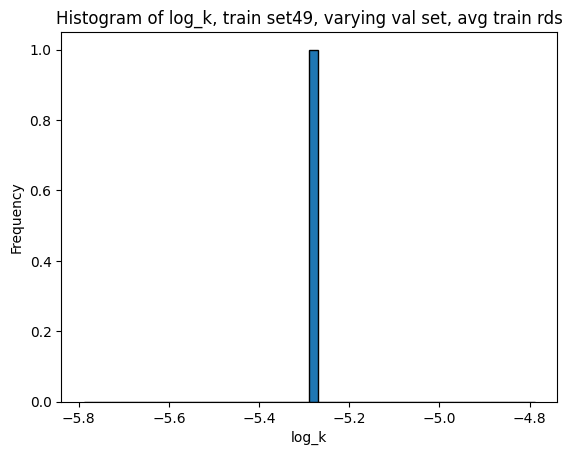

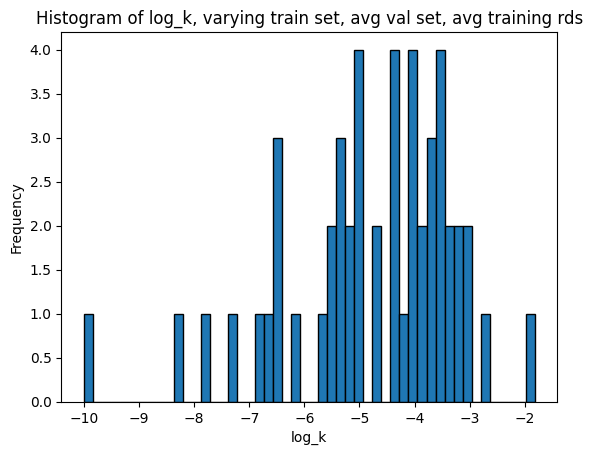

In [194]:
# Load and process data

De_mass, De_event, yerr = load_and_process_data('/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv')

# Save function for arrays

def save_multiple_arrays_with_timestamp(*arrays, base_filename='saved_log_K_arrays_i2vi3'):
    """
    Saves multiple NumPy arrays to a single file with a timestamp, keeping them separate.
    
    Parameters:
    - arrays: Multiple NumPy array objects passed as separate arguments.
    - base_filename: Optional. Base name of the file without extension.
    
    The function saves the file in the current directory with the format:
    `base_filename_YYYYMMDD_HHMMSS.npz`

    Array1 = log_K_array
    Array2 = log_K_array_sub_array_means
    Array3 = log_K_array_means
    """
    # Format the current date and time as YYYYMMDD_HHMMSS
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    
    # Construct the filename with base_filename and timestamp
    filename = f'{base_filename}_{timestamp}.npz'
    
    # Prepare the arrays dict to save; keys are array0, array1, etc.
    arrays_dict = {f'array{i}': array for i, array in enumerate(arrays)}
    
    # Save the arrays to the file using np.savez
    np.savez(filename, **arrays_dict)
    
    print(f'Arrays saved as {filename}')

# Generate datasets
            
log_K_array = []
log_K_array_means = []
log_K_array_sub_array_means = []
num_sim_dataset_arrays_train_on = 50
num_sim_datasets_per_array = 10**3
num_val_datasets = 1
num_train_rounds = 1

for i in range(num_sim_dataset_arrays_train_on):

    # Usage
    N = num_sim_datasets_per_array
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    while len(array_vector_datasets_3) < N:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise[:1]) and all(y_pred_3_rvs_priors_plus_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_noise[1:]):
            array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p2_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_2 = []
    while len(array_vector_datasets_2) < N:
        theta = optimizer_class.create_priors()
        y_pred_2_rvs_priors = optimizer_class.curve_torch_2(x_tensor, *theta)
        y_pred_2_rvs_priors_plus_noise = torch.poisson(y_pred_2_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_2_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_2_rvs_priors_plus_noise[:1]) and all(y_pred_2_rvs_priors_plus_noise[0] > elem for elem in y_pred_2_rvs_priors_plus_noise[1:]):
            array_vector_datasets_2.append(y_pred_2_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Validation datasets as real data

    array_vector_datasets_validation = []

    array_vector_datasets_validation.append(De_event)

    D3 = np.array(array_vector_datasets_3)
    D4 = np.array(array_vector_datasets_2)

    X = x_tensor

    class CustomBinaryClassifier(BinaryClassifier):
        def fit(self, X, y, **kwargs):
            # kwargs['batch_size'] = 128
            kwargs['num_epochs'] = 30
            super().fit(X, y, **kwargs)

    data = np.concatenate((D3, D4))
    labels = np.concatenate((np.zeros(N), np.ones(N)))

    log_K_sub_array = []
    log_K_sub_array_means = []

    for j in range(num_val_datasets):

        array_vector_datasets_validation_subset = array_vector_datasets_validation[j]
        log_K_sub2_array = []
        valid_log_K_found = False

        # Outer loop to ensure all log_K values are finite
        while not valid_log_K_found:
            temp_log_K_sub2_array = []
            all_finite = True
            inf_counter = 0

            for k in range(num_train_rounds):
                finite_log_K_found = False  # Indicator for the current training round
                
                while not finite_log_K_found: # Calling a new instance of evidence_network each time to start training from fresh
                    evidence_network = CustomBinaryClassifier(len(X))
                    evidence_network.fit(data, labels)
                    log_K = evidence_network.predict(array_vector_datasets_validation_subset[...,None].T).squeeze()

                    if np.isnan(log_K):
                        print("Nan produced, retraining network.")
                    elif -10 <= log_K <= 10:
                        print(f"Bayes Factor = {log_K}")
                        temp_log_K_sub2_array.append(log_K)
                        finite_log_K_found = True
                    elif log_K < -10:
                        print(f"Bayes Factor = {log_K}")
                        print("Out of bounds Bayes Factor detected, appending -10 instead.")
                        max_value = -10
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True
                        inf_counter += 1
                    elif log_K > 10:
                        print(f"Bayes Factor = {log_K}")
                        print("Out of bounds Bayes Factor detected, appending 10 instead.")
                        max_value = 10
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True
                        inf_counter += 1
                    if inf_counter >= 20:
                        print("Sufficient inf produced to use new training set.")
                        break
                if inf_counter >= 20:
                    print("Sufficient inf produced to use new training set.")
                    break
            # # Check if the entire set of log_K values are finite
            # if all(not np.isinf(log_K).any() for log_K in temp_log_K_sub2_array):
            log_K_sub2_array = temp_log_K_sub2_array  # Save the valid results
            valid_log_K_found = True  # Exit the outer while loop
            if inf_counter >= 20:
                print("Sufficient inf produced to use new training set.")
                break
        if inf_counter >= 20:
            print("Sufficient inf produced to use new training set.")
            break
        
        log_K_sub_array.append(log_K_sub2_array)
        log_K_sub_array_means.append(np.mean(log_K_sub2_array))

    log_K_array.append(log_K_sub_array)
    log_K_array_sub_array_means.append(log_K_sub_array_means)
    log_K_array_means.append(np.mean(log_K_sub_array_means))

# Rename for clarity

logk_trainsets_valsets_trainrounds = log_K_array
logk_given_trainset_across_valsets_trainrounds_means = log_K_array_sub_array_means
logk_across_trainset_valsets_means_trainrounds_means = log_K_array_means

# Save arrays

save_multiple_arrays_with_timestamp(logk_trainsets_valsets_trainrounds, logk_given_trainset_across_valsets_trainrounds_means, logk_across_trainset_valsets_means_trainrounds_means, base_filename='log_K_arrays_i2vi3')

for i in range(num_sim_dataset_arrays_train_on):

    for j in range(num_val_datasets):

        plt.hist(log_K_array[i][j], bins=50, edgecolor='black')
        plt.title(f'Histogram of log_k, training set {i}, validation set {j}, vary train rds')
        plt.xlabel('log_k')
        plt.ylabel('Frequency')
        plt.show()
            
        data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        optimizer_class = optim_p3_poisson(data_path)
        curve_torch_3 = optimizer_class.curve_torch_3
        plt.scatter(optimizer_class.De_mass, array_vector_datasets_validation[j], color='black')
        plt.yscale("log")
        plt.xscale("log")
        plt.xlabel("Mass [GeV]")
        plt.ylabel("Events/10 GeV")
        plt.xlim(200, 5000)
        plt.ylim(bottom = 10**-2, top=10**5)
        plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
        plt.title(f"Validation data {j}")
        plt.show()
    
    plt.hist(log_K_array_sub_array_means[i], bins=50, edgecolor='black')
    plt.title(f'Histogram of log_k, train set{i}, varying val set, avg train rds')
    plt.xlabel('log_k')
    plt.ylabel('Frequency')
    plt.show()

plt.hist(log_K_array_means, bins=50, edgecolor='black')
plt.title(f'Histogram of log_k, varying train set, avg val set, avg training rds')
plt.xlabel('log_k')
plt.ylabel('Frequency')
plt.show()

## Real data Bayes factor (i3 vs i4)

Datasets simulated
Datasets simulated
Using device:  cpu
Epoch 1/30, Loss: 0.6679458022117615
Epoch 2/30, Loss: 0.6423169374465942
Epoch 3/30, Loss: 0.6195605993270874
Epoch 4/30, Loss: 0.605858564376831
Epoch 5/30, Loss: 0.5881366729736328
Epoch 6/30, Loss: 0.5705362558364868
Epoch 7/30, Loss: 0.5550059080123901
Epoch 8/30, Loss: 0.5469312071800232
Epoch 9/30, Loss: 0.5418609976768494
Epoch 10/30, Loss: 0.5161104202270508
Epoch 11/30, Loss: 0.5102647542953491
Epoch 12/30, Loss: 0.5064696073532104
Epoch 13/30, Loss: 0.4910602867603302
Epoch 14/30, Loss: 0.49187755584716797
Epoch 15/30, Loss: 0.49150213599205017
Epoch 16/30, Loss: 0.49718666076660156
Epoch 17/30, Loss: 0.48306697607040405
Epoch 18/30, Loss: 0.4753252863883972
Epoch 19/30, Loss: 0.47899580001831055
Epoch 20/30, Loss: 0.4652464985847473
Epoch 21/30, Loss: 0.4586794078350067
Epoch 22/30, Loss: 0.4505929946899414
Epoch 23/30, Loss: 0.4555117189884186
Epoch 24/30, Loss: 0.4581698775291443
Epoch 25/30, Loss: 0.443397998809814

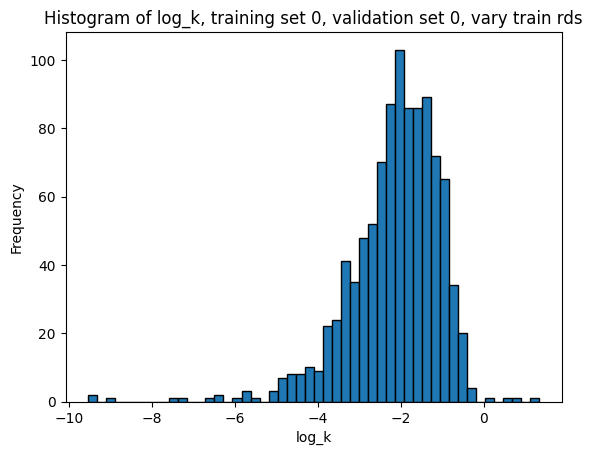

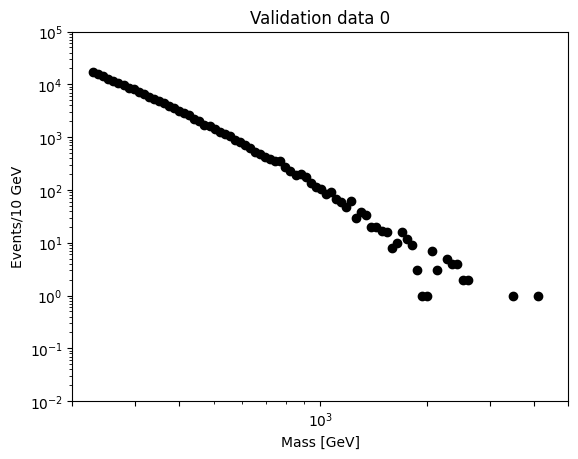

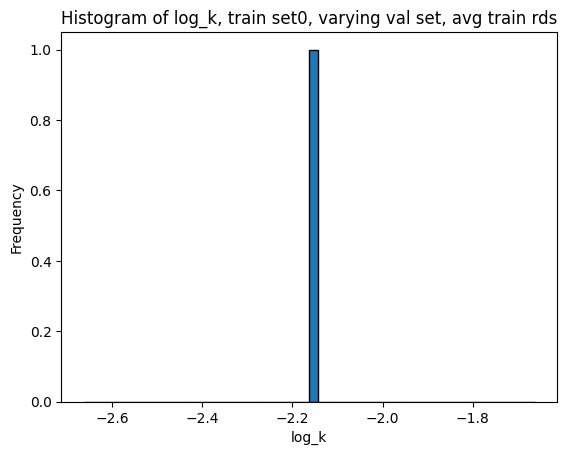

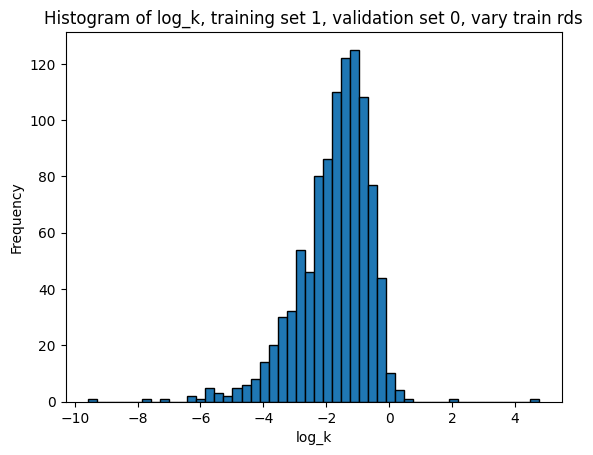

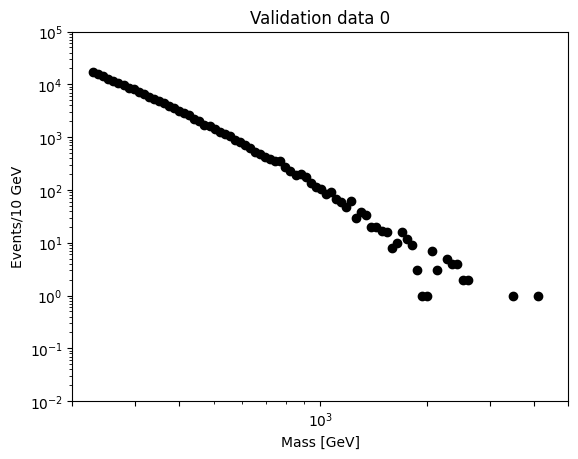

...

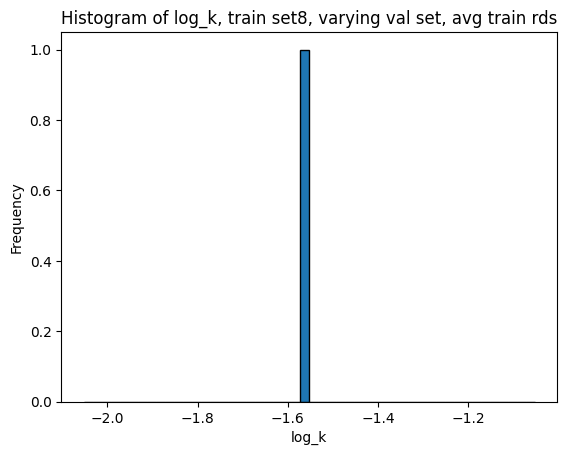

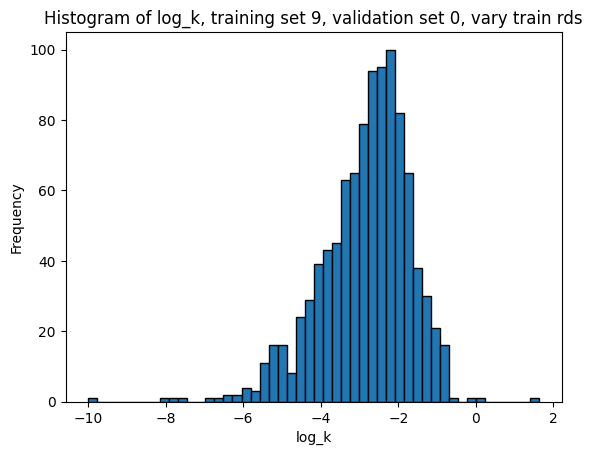

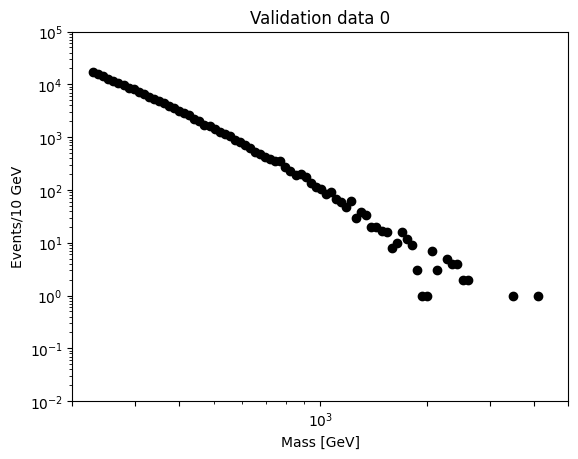

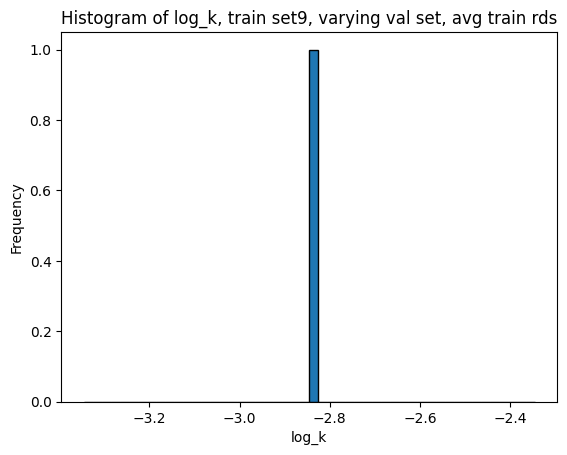

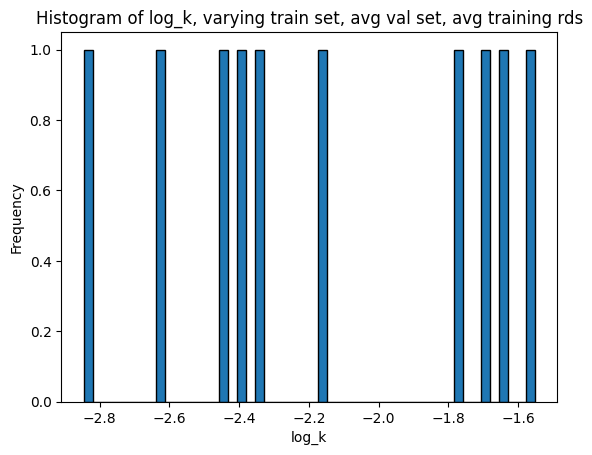

In [14]:
# Load and process data

De_mass, De_event, yerr = load_and_process_data('/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv')

# Save function for arrays

def save_multiple_arrays_with_timestamp(*arrays, base_filename='saved_log_K_arrays_i3vi4'):
    """
    Saves multiple NumPy arrays to a single file with a timestamp, keeping them separate.
    
    Parameters:
    - arrays: Multiple NumPy array objects passed as separate arguments.
    - base_filename: Optional. Base name of the file without extension.
    
    The function saves the file in the current directory with the format:
    `base_filename_YYYYMMDD_HHMMSS.npz`

    Array1 = log_K_array
    Array2 = log_K_array_sub_array_means
    Array3 = log_K_array_means
    """
    # Format the current date and time as YYYYMMDD_HHMMSS
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    
    # Construct the filename with base_filename and timestamp
    filename = f'{base_filename}_{timestamp}.npz'
    
    # Prepare the arrays dict to save; keys are array0, array1, etc.
    arrays_dict = {f'array{i}': array for i, array in enumerate(arrays)}
    
    # Save the arrays to the file using np.savez
    np.savez(filename, **arrays_dict)
    
    print(f'Arrays saved as {filename}')

# Generate datasets
            
log_K_array = []
log_K_array_means = []
log_K_array_sub_array_means = []
num_sim_dataset_arrays_train_on = 10
num_sim_datasets_per_array = 10**3
num_val_datasets = 1
num_train_rounds = 1000

for i in range(num_sim_dataset_arrays_train_on):

    # Usage
    N = num_sim_datasets_per_array
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    while len(array_vector_datasets_3) < N:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise[:1]) and all(y_pred_3_rvs_priors_plus_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_noise[1:]):
            array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p4_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_4 = []
    while len(array_vector_datasets_4) < N:
        theta = optimizer_class.create_priors()
        y_pred_4_rvs_priors = optimizer_class.curve_torch_4(x_tensor, *theta)
        y_pred_4_rvs_priors_plus_noise = torch.poisson(y_pred_4_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_4_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_4_rvs_priors_plus_noise[:1]) and all(y_pred_4_rvs_priors_plus_noise[0] > elem for elem in y_pred_4_rvs_priors_plus_noise[1:]):
            array_vector_datasets_4.append(y_pred_4_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Validation datasets as real data

    array_vector_datasets_validation = []

    array_vector_datasets_validation.append(De_event)

    D3 = np.array(array_vector_datasets_3)
    D4 = np.array(array_vector_datasets_4)

    X = x_tensor

    class CustomBinaryClassifier(BinaryClassifier):
        def fit(self, X, y, **kwargs):
            # kwargs['batch_size'] = 128
            kwargs['num_epochs'] = 30
            super().fit(X, y, **kwargs)

    data = np.concatenate((D3, D4))
    labels = np.concatenate((np.zeros(N), np.ones(N)))

    log_K_sub_array = []
    log_K_sub_array_means = []

    for j in range(num_val_datasets):

        array_vector_datasets_validation_subset = array_vector_datasets_validation[j]
        log_K_sub2_array = []
        valid_log_K_found = False

        # Outer loop to ensure all log_K values are finite
        while not valid_log_K_found:
            temp_log_K_sub2_array = []
            all_finite = True
            inf_counter = 0

            for k in range(num_train_rounds):
                finite_log_K_found = False  # Indicator for the current training round
                
                while not finite_log_K_found: # Calling a new instance of evidence_network each time to start training from fresh
                    evidence_network = CustomBinaryClassifier(len(X))
                    evidence_network.fit(data, labels)
                    log_K = evidence_network.predict(array_vector_datasets_validation_subset[...,None].T).squeeze()

                    if np.isnan(log_K):
                        print("Nan produced, retraining network.")
                    elif -10 <= log_K <= 10:
                        print(f"Bayes Factor = {log_K}")
                        temp_log_K_sub2_array.append(log_K)
                        finite_log_K_found = True
                    elif log_K < -10:
                        print(f"Bayes Factor = {log_K}")
                        print("Out of bounds Bayes Factor detected, appending -10 instead.")
                        max_value = -10
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True
                        inf_counter += 1
                    elif log_K > 10:
                        print(f"Bayes Factor = {log_K}")
                        print("Out of bounds Bayes Factor detected, appending 10 instead.")
                        max_value = 10
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True
                        inf_counter += 1
                    if inf_counter >= 20:
                        print("Sufficient inf produced to use new training set.")
                        break
                if inf_counter >= 20:
                    print("Sufficient inf produced to use new training set.")
                    break
            # # Check if the entire set of log_K values are finite
            # if all(not np.isinf(log_K).any() for log_K in temp_log_K_sub2_array):
            log_K_sub2_array = temp_log_K_sub2_array  # Save the valid results
            valid_log_K_found = True  # Exit the outer while loop
            if inf_counter >= 20:
                print("Sufficient inf produced to use new training set.")
                break
        if inf_counter >= 20:
            print("Sufficient inf produced to use new training set.")
            break
        
        log_K_sub_array.append(log_K_sub2_array)
        log_K_sub_array_means.append(np.mean(log_K_sub2_array))

    log_K_array.append(log_K_sub_array)
    log_K_array_sub_array_means.append(log_K_sub_array_means)
    log_K_array_means.append(np.mean(log_K_sub_array_means))

# Rename for clarity

logk_trainsets_valsets_trainrounds = log_K_array
logk_given_trainset_across_valsets_trainrounds_means = log_K_array_sub_array_means
logk_across_trainset_valsets_means_trainrounds_means = log_K_array_means

# Save arrays

save_multiple_arrays_with_timestamp(logk_trainsets_valsets_trainrounds, logk_given_trainset_across_valsets_trainrounds_means, logk_across_trainset_valsets_means_trainrounds_means, base_filename='log_K_arrays_i3vi4')

for i in range(num_sim_dataset_arrays_train_on):

    for j in range(num_val_datasets):

        plt.hist(log_K_array[i][j], bins=50, edgecolor='black')
        plt.title(f'Histogram of log_k, training set {i}, validation set {j}, vary train rds')
        plt.xlabel('log_k')
        plt.ylabel('Frequency')
        plt.show()
            
        data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        optimizer_class = optim_p3_poisson(data_path)
        curve_torch_3 = optimizer_class.curve_torch_3
        plt.scatter(optimizer_class.De_mass, array_vector_datasets_validation[j], color='black')
        plt.yscale("log")
        plt.xscale("log")
        plt.xlabel("Mass [GeV]")
        plt.ylabel("Events/10 GeV")
        plt.xlim(200, 5000)
        plt.ylim(bottom = 10**-2, top=10**5)
        plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
        plt.title(f"Validation data {j}")
        plt.show()
    
    plt.hist(log_K_array_sub_array_means[i], bins=50, edgecolor='black')
    plt.title(f'Histogram of log_k, train set{i}, varying val set, avg train rds')
    plt.xlabel('log_k')
    plt.ylabel('Frequency')
    plt.show()

plt.hist(log_K_array_means, bins=50, edgecolor='black')
plt.title(f'Histogram of log_k, varying train set, avg val set, avg training rds')
plt.xlabel('log_k')
plt.ylabel('Frequency')
plt.show()
    

## Replotting

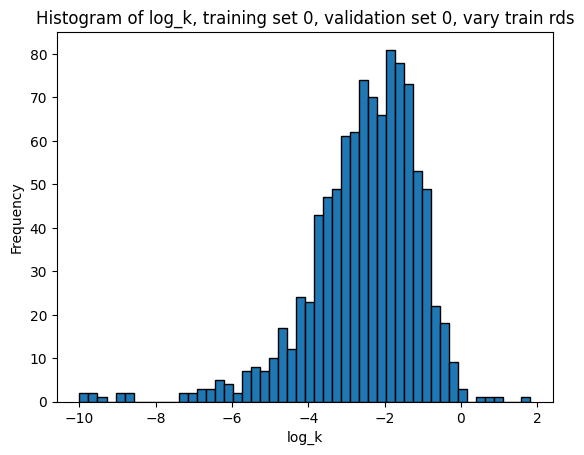

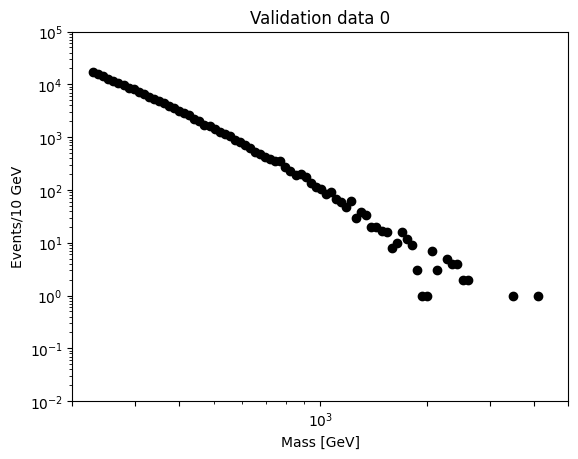

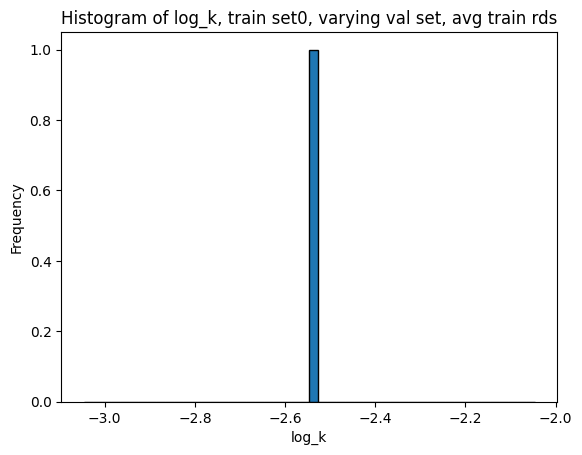

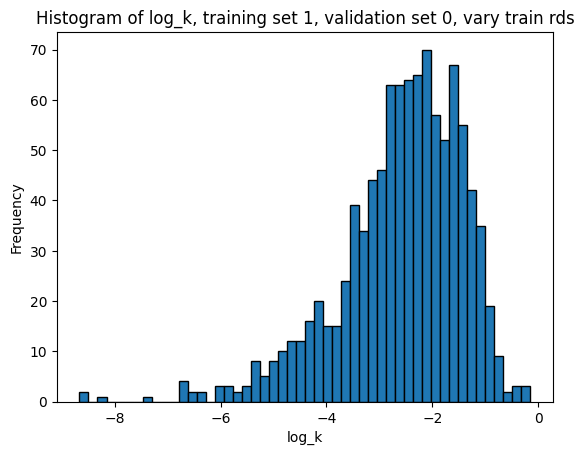

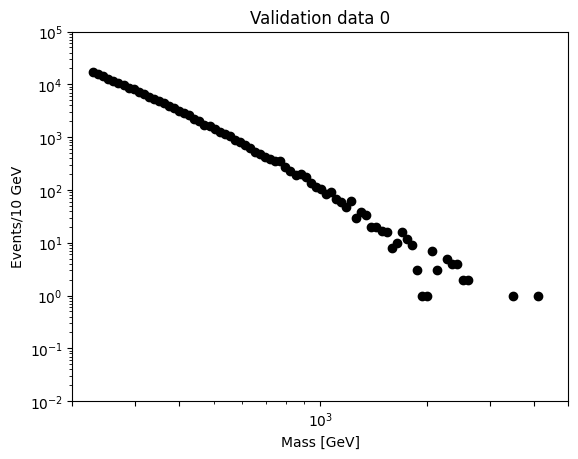

...

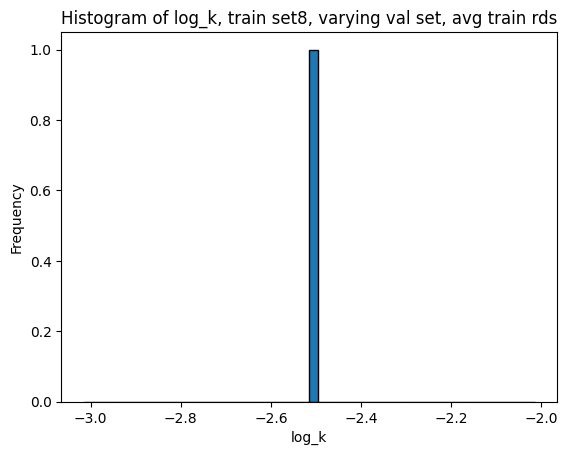

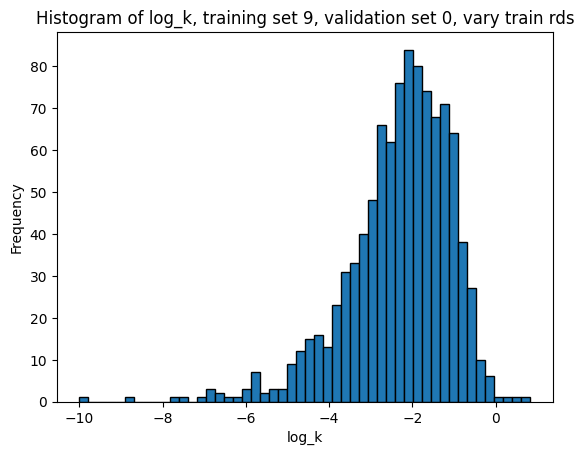

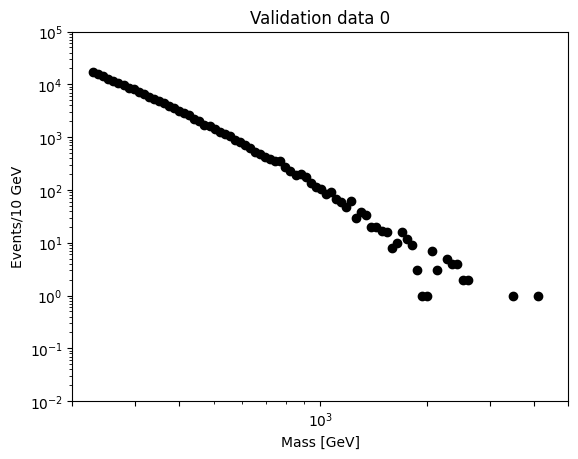

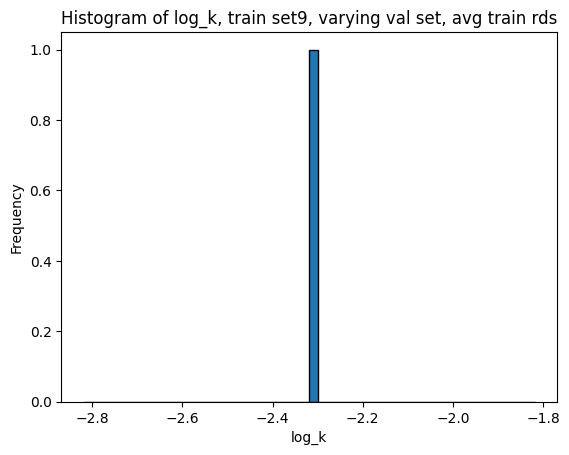

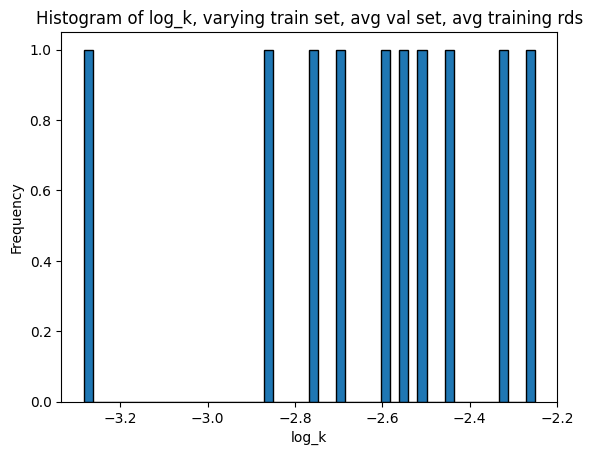

In [13]:
file = 'log_K_arrays_20240402_151843.npz'

np.load(file)

logk_trainsets_valsets_trainrounds = np.load(file)['array0']
logk_given_trainset_across_valsets_trainrounds_means = np.load(file)['array1']
logk_across_trainset_valsets_means_trainrounds_means = np.load(file)['array2']

log_K_array = logk_trainsets_valsets_trainrounds
log_K_array_sub_array_means = logk_given_trainset_across_valsets_trainrounds_means
log_K_array_means = logk_across_trainset_valsets_means_trainrounds_means

for i in range(num_sim_dataset_arrays_train_on):

    for j in range(num_val_datasets):

        plt.hist(log_K_array[i][j], bins=50, edgecolor='black')
        plt.title(f'Histogram of log_k, training set {i}, validation set {j}, vary train rds')
        plt.xlabel('log_k')
        plt.ylabel('Frequency')
        plt.show()
            
        data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        optimizer_class = optim_p3_poisson(data_path)
        curve_torch_3 = optimizer_class.curve_torch_3
        plt.scatter(optimizer_class.De_mass, array_vector_datasets_validation[j], color='black')
        plt.yscale("log")
        plt.xscale("log")
        plt.xlabel("Mass [GeV]")
        plt.ylabel("Events/10 GeV")
        plt.xlim(200, 5000)
        plt.ylim(bottom = 10**-2, top=10**5)
        plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
        plt.title(f"Validation data {j}")
        plt.show()
    
    plt.hist(log_K_array_sub_array_means[i], bins=50, edgecolor='black')
    plt.title(f'Histogram of log_k, train set{i}, varying val set, avg train rds')
    plt.xlabel('log_k')
    plt.ylabel('Frequency')
    plt.show()

plt.hist(log_K_array_means, bins=50, edgecolor='black')
plt.title(f'Histogram of log_k, varying train set, avg val set, avg training rds')
plt.xlabel('log_k')
plt.ylabel('Frequency')
plt.show()

# Testing area 3 (i = 2 model)

## Classifier to compare i = 2 and i = 3 models

In [41]:
class optim_p2_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.2, -4.75, -0.95], high=[1.9 * 10**5, 5, -11.5, -4, -0.45])

    def curve_torch_2(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_2(self, y_pred_2):
        while not self.loglike(y_pred_2, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_2 = self.curve_torch_2(self.x_tensor, *theta_opt)
            loss = self.loglike(y_pred_2, self.y_tensor, self.y_err_tensor)
        return loss, theta_opt, y_pred_2

    def run(self):
        success = False

        while not success:
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_2 = self.curve_torch_2(self.x_tensor, *theta_opt)
            initial_loss = self.loglike(y_pred_2, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_2 = self.adjust_theta_2(y_pred_2)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_2 = self.adjust_theta_2(y_pred_2)
            else:
                # print("Valid start point found.")
                pass

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 10000
            loss_crit = 1.5
            loss_filter = 3.1
            N_iter_filter = 4000
            N_iter = 0

            while N_iter < max_N:
                if N_iter == 0:
                    print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_2 = self.curve_torch_2(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_2, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == N_iter_filter and loss > loss_filter:
                    print(f"Final loss before filter = {losses[-1]}")
                    # print("Loss too high. Starting again.")
                    break
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1500 and loss < loss_filter:
                #     print(f"Loss at 1500 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # Plot results

            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_2_plot = self.curve_torch_2(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_2_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("True data")
            # plt.show()

            # plt.errorbar(De_mass, De_event.round(), yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_2_plot = self.curve_torch_2(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_2_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("Rounded data")

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

class optim_p3_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.5, -5.2, -0.95, -0.1], high=[1.9 * 10**5, 5, -11, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_3(self, y_pred_3):
        while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta_opt, y_pred_3

    def run(self):
        
        success = False

        while not success:
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            else:
                # print("Valid start point found.")
                pass

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 1400
            loss_crit = 1.5
            loss_filter = 2.7
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                    # print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 1000 and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    break
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1500 and loss < loss_filter:
                #     print(f"Loss at 1500 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # # Plot results

            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("True data")
            # plt.show()

            # plt.errorbar(De_mass, De_event.round(), yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("Rounded data")
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

for i in range(5):

    # Usage
    N = 10**5
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    for i in range(N):
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p2_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_2 = []
    for i in range(N):
        theta = optimizer_class.create_priors()
        y_pred_2_rvs_priors = optimizer_class.curve_torch_2(x_tensor, *theta)
        y_pred_2_rvs_priors_plus_noise = torch.poisson(y_pred_2_rvs_priors)
        array_vector_datasets_2.append(y_pred_2_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    D3 = np.array(array_vector_datasets_3)
    D2 = np.array(array_vector_datasets_2)

    X = x_me
    
    class CustomBinaryClassifierLPop(BinaryClassifierLPop):
        def fit(self, X, y, **kwargs):
            # kwargs['batch_size'] = 128
            kwargs['num_epochs'] = 30 
            super().fit(X, y, **kwargs)

    evidence_network = CustomBinaryClassifierLPop(len(X))

    data = np.concatenate((D3, D2))
    labels = np.concatenate((np.zeros(N), np.ones(N)))

    evidence_network.fit(data, labels)

    log_K = evidence_network.predict(De_event[...,None].T).squeeze()
    print(f"Bayes Factor = {log_K}")

Datasets simulated
Datasets simulated
Using device:  cpu
Epoch 1/30, Loss: 0.2871611416339874
Epoch 2/30, Loss: 0.2566356956958771
Epoch 3/30, Loss: 0.1868879497051239
Epoch 4/30, Loss: 0.16755957901477814
Epoch 5/30, Loss: 0.18858885765075684
Epoch 6/30, Loss: 0.15664388239383698
Epoch 7/30, Loss: 0.37266767024993896
Epoch 8/30, Loss: 0.2297218143939972
Epoch 9/30, Loss: 0.15413451194763184
Epoch 10/30, Loss: 0.13265401124954224
Epoch 11/30, Loss: 0.13788072764873505
Epoch 12/30, Loss: 0.1218581348657608
Epoch 13/30, Loss: 0.11032348871231079
Epoch 14/30, Loss: 0.09974649548530579
Epoch 15/30, Loss: 0.10184581577777863
Epoch 16/30, Loss: 0.15214556455612183
Epoch 17/30, Loss: 0.0900050550699234
Epoch 18/30, Loss: 0.11621733009815216
Epoch 19/30, Loss: 0.0889551118016243
Epoch 20/30, Loss: 0.09515368193387985
Epoch 21/30, Loss: 0.07991550862789154
Epoch 22/30, Loss: 0.09258532524108887
Epoch 23/30, Loss: 0.07734322547912598
Epoch 24/30, Loss: 0.08059243112802505
Epoch 25/30, Loss: 0.06

# Comparing different ranges of b

## b 1 to 5 vs 5 to 10

In [55]:
class optim_p3_poisson_b_lower:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.5, -5.2, -0.95, -0.1], high=[1.9 * 10**5, 5, -11, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_3(self, y_pred_3):
        while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta_opt, y_pred_3

    def run(self):
        
        success = False

        while not success:
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            else:
                # print("Valid start point found.")
                pass

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 1400
            loss_crit = 1.5
            loss_filter = 2.7
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                    # print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 1000 and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    break
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1500 and loss < loss_filter:
                #     print(f"Loss at 1500 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # Plot results

            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("True data")
            # plt.show()

            # plt.errorbar(De_mass, De_event.round(), yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("Rounded data")
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

class optim_p3_poisson_b_upper:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 5, -13.5, -5.2, -0.95, -0.1], high=[1.9 * 10**5, 10, -11, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_3(self, y_pred_3):
        while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta_opt, y_pred_3

    def run(self):
        
        success = False

        while not success:
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            else:
                # print("Valid start point found.")
                pass

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 1400
            loss_crit = 1.5
            loss_filter = 2.7
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                    # print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 1000 and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    break
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1500 and loss < loss_filter:
                #     print(f"Loss at 1500 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # Plot results

            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("True data")
            # plt.show()

            # plt.errorbar(De_mass, De_event.round(), yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("Rounded data")
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

# b_lower = 1 to 5
# b_upper = 5 to 10
            

for k in range(5):

    # Usage
    N = 5 * 10**5
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson_b_lower(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_b1to5 = []
    for i in range(N):
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        array_vector_datasets_b1to5.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    optimizer_class = optim_p3_poisson_b_upper(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_b5to10 = []
    for i in range(N):
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        array_vector_datasets_b5to10.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    D3 = np.array(array_vector_datasets_b1to5)
    D4 = np.array(array_vector_datasets_b5to10)

    X = x_me

    print(f"Bayes factors for same datasets but different training rounds. Dataset {k}:")

    class CustomBinaryClassifierLPop(BinaryClassifierLPop):
        def fit(self, X, y, **kwargs):
            # Setting custom batch size and number of epochs
            # kwargs['batch_size'] = 128 # Custom batch size
            kwargs['num_epochs'] = 30  # Custom number of epochs
            super().fit(X, y, **kwargs)

    for j in range(1):

        evidence_network = CustomBinaryClassifierLPop(len(X))

        data = np.concatenate((D3, D4))
        labels = np.concatenate((np.zeros(N), np.ones(N)))

        evidence_network.fit(data, labels)

        log_K = evidence_network.predict(De_event[...,None].T).squeeze()
        print(f"Bayes Factor = {log_K}")

KeyboardInterrupt: 

## b 1 to 3 vs 3 to 5

In [13]:
class optim_p3_poisson_b_1to3:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.5, -5.2, -0.95, -0.1], high=[1.9 * 10**5, 3, -11, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_3(self, y_pred_3):
        while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta_opt, y_pred_3

    def run(self):
        
        success = False

        while not success:
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            else:
                # print("Valid start point found.")
                pass

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 1400
            loss_crit = 1.5
            loss_filter = 2.7
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                    # print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 1000 and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    break
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1500 and loss < loss_filter:
                #     print(f"Loss at 1500 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # Plot results

            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("True data")
            # plt.show()

            # plt.errorbar(De_mass, De_event.round(), yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("Rounded data")
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

class optim_p3_poisson_b_3to5:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 3, -13.5, -5.2, -0.95, -0.1], high=[1.9 * 10**5, 5, -11, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_3(self, y_pred_3):
        while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta_opt, y_pred_3

    def run(self):
        
        success = False

        while not success:
            priors = self.create_priors()
            theta_opt = []
            for i in range(len(priors)):
                theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
            initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3(y_pred_3)
            else:
                # print("Valid start point found.")
                pass

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 1400
            loss_crit = 1.5
            loss_filter = 2.7
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                    # print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 1000 and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    break
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1500 and loss < loss_filter:
                #     print(f"Loss at 1500 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
        
            print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # Plot results

            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("True data")
            # plt.show()

            # plt.errorbar(De_mass, De_event.round(), yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])
            # plt.title("Rounded data")
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

for k in range(5):

    # Usage
    N = 5*10**5
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson_b_1to3(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_b1to3 = []
    for i in range(N):
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        array_vector_datasets_b1to3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    optimizer_class = optim_p3_poisson_b_3to5(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_b3to5 = []
    for i in range(N):
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        array_vector_datasets_b3to5.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    D3 = np.array(array_vector_datasets_b1to3)
    D4 = np.array(array_vector_datasets_b3to5)

    X = x_me

    print(f"Bayes factors for same datasets but different training rounds. Dataset {k}:")

    for j in range(1):

        evidence_network = BinaryClassifierLPop(len(X))

        data = np.concatenate((D3, D4))
        labels = np.concatenate((np.zeros(N), np.ones(N)))

        evidence_network.fit(data, labels)

        log_K = evidence_network.predict(De_event[...,None].T).squeeze()
        print(f"Bayes Factor = {log_K}")

Datasets simulated
Datasets simulated
Bayes factors for same datasets but different training rounds. Dataset 0:
Using device:  cpu
Epoch 1/10, Loss: 0.944184422492981
Epoch 2/10, Loss: 0.9019119143486023
Epoch 3/10, Loss: 0.896341860294342
Epoch 4/10, Loss: 0.8691199421882629
Epoch 5/10, Loss: 0.8561193346977234
Epoch 6/10, Loss: 0.8486142754554749
Epoch 7/10, Loss: 0.8392848372459412
Epoch 8/10, Loss: 0.8358536958694458
Epoch 9/10, Loss: 0.8308072090148926
Epoch 10/10, Loss: 0.8259832859039307
Bayes Factor = 0.029862668365240097
Datasets simulated
Datasets simulated
Bayes factors for same datasets but different training rounds. Dataset 1:
Using device:  cpu
Epoch 1/10, Loss: 0.9557458162307739
Epoch 2/10, Loss: 0.9263389110565186
Epoch 3/10, Loss: 0.8993358016014099
Epoch 4/10, Loss: 0.878789484500885
Epoch 5/10, Loss: 0.8677655458450317
Epoch 6/10, Loss: 0.8580744862556458
Epoch 7/10, Loss: 0.8521579504013062
Epoch 8/10, Loss: 0.8483471870422363
Epoch 9/10, Loss: 0.8400741219520569
E

# Signal detection

A similar method is used to do signal detection instead this time we use a background only model and a background model plus a signal where we think there might be a bump and compare the models using the classifier. First I will do manual detection but this will be automated later to scan a given range and apply signal tests for a given width of signal in each range.

## Using specific signals

Datasets simulated
Datasets simulated
Using device:  cpu
Epoch 1/30, Loss: 0.48489078879356384
Epoch 2/30, Loss: 0.3868665099143982
Epoch 3/30, Loss: 0.378438264131546
Epoch 4/30, Loss: 0.3768891990184784
Epoch 5/30, Loss: 0.37724974751472473
Epoch 6/30, Loss: 0.37724390625953674
Epoch 7/30, Loss: 0.37708571553230286
Epoch 8/30, Loss: 0.378027081489563
Epoch 9/30, Loss: 0.3774571716785431
Epoch 10/30, Loss: 0.3765528202056885
Epoch 11/30, Loss: 0.37546631693840027
Epoch 12/30, Loss: 0.3764053285121918
Epoch 13/30, Loss: 0.3757643699645996
Epoch 14/30, Loss: 0.37606897950172424
Epoch 15/30, Loss: 0.3758407533168793
Epoch 16/30, Loss: 0.375507652759552
Epoch 17/30, Loss: 0.3764413893222809
Epoch 18/30, Loss: 0.3752036690711975
Epoch 19/30, Loss: 0.37543344497680664
Epoch 20/30, Loss: 0.37554657459259033
Epoch 21/30, Loss: 0.3753693699836731
Epoch 22/30, Loss: 0.37484994530677795
Epoch 23/30, Loss: 0.3755381107330322
Epoch 24/30, Loss: 0.374038428068161
Epoch 25/30, Loss: 0.37354606389999

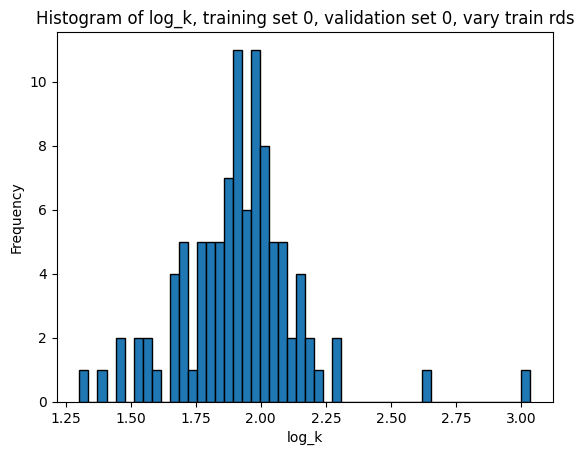

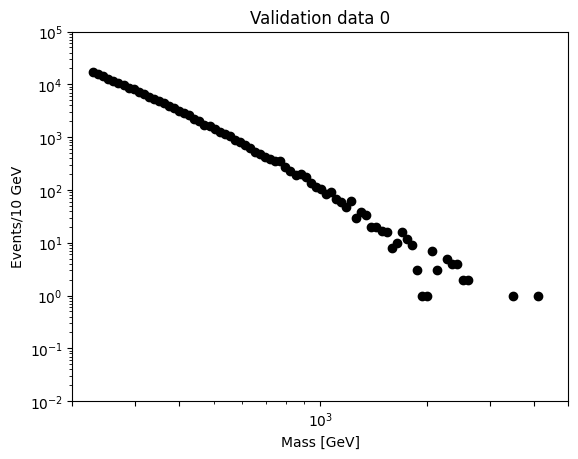

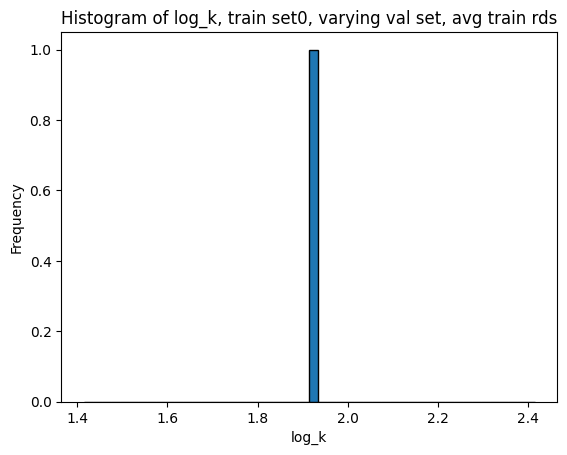

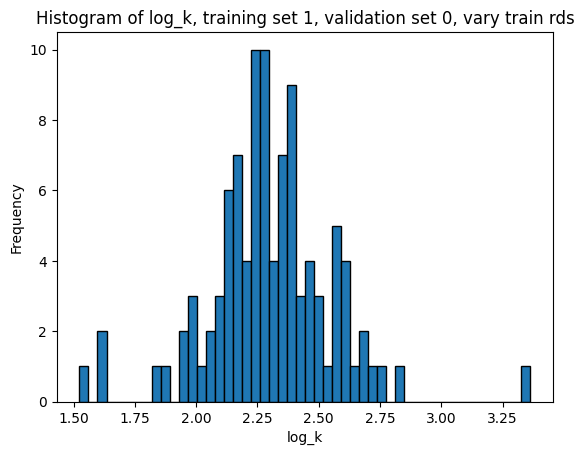

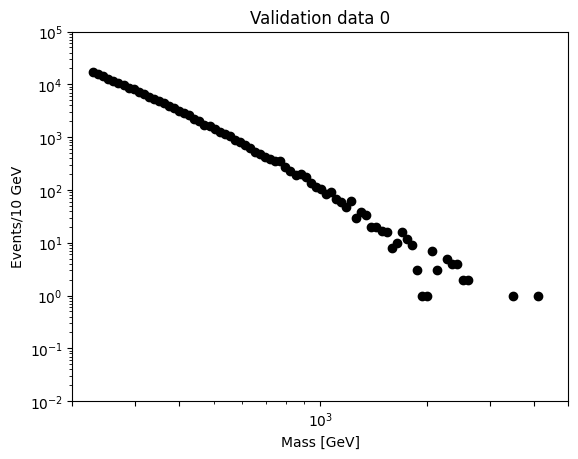

...

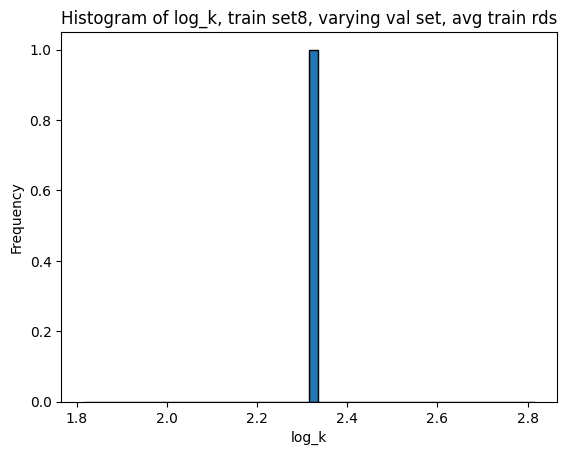

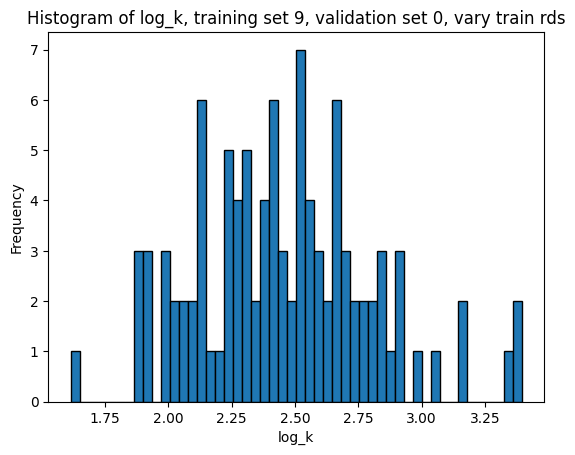

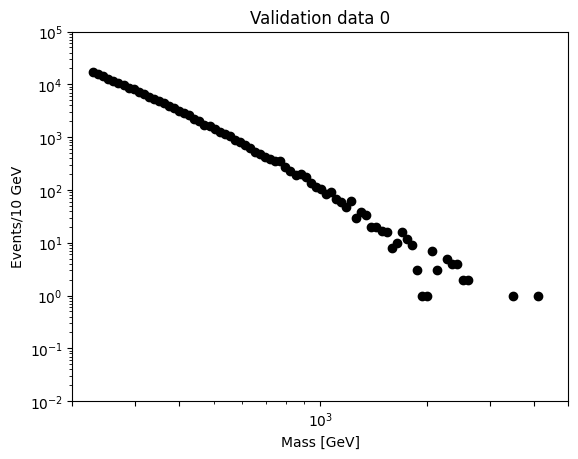

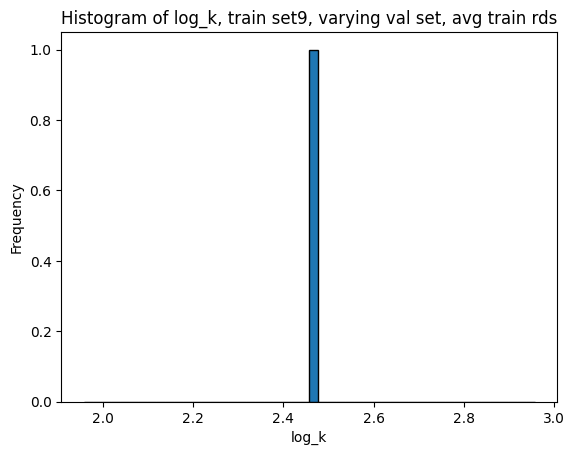

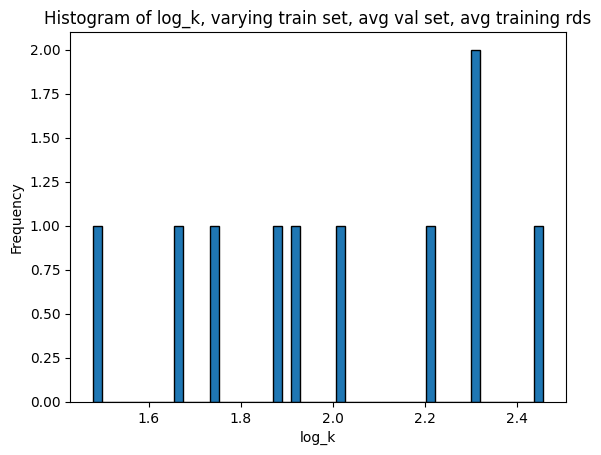

In [121]:
# Using i = 3 model

class optim_p3_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.5, -5.2, -0.95, -0.1], high=[1.9 * 10**5, 5, -11, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        # print(f"Norm = {norm_ft}")
        # print(f"Base function = {((1 - x ** self.c_e_ft) ** b_ft)}")
        # print(f"X function = {x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)}")
        # print(f"BW2 = {BW2}")
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_3(self):
        priors = self.create_priors()
        theta_opt = []
        for i in range(len(priors)):
            theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
        
        if self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) > self.threshold():
            while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
                priors = self.create_priors()
                theta_opt = []
                for i in range(len(priors)):
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        else:
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
            theta_opt = theta_opt
            y_pred_3 = y_pred_3
        return loss, theta_opt, y_pred_3

    def run(self):
        
        success = False

        while not success:
            initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3()
            theta_initial = theta_opt.clone().detach()
            self.theta_initial = theta_initial

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 1400
            loss_crit = 1.5
            loss_filter = 3.37
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                    # print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 1000 and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    # print(f"Final loss before filter = {losses[-1]}")
                    break
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1500 and loss < loss_filter:
                #     print(f"Loss at 1500 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])

            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.max_N = max_N
            self.loss_filter = loss_filter
            self.N_iter_filter = N_iter_filter
            self.learning_rate = lr
            self.losses = np.array(losses)
        
            # print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # # Plot results

            # plt.errorbar(self.De_mass, self.De_event, yerr=self.yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(self.De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 5000)
            # plt.ylim(bottom = 10**-2, top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
            # plt.title("True data")
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

def gaussian_signal(x, mean, std_dev, amplitude):
    prefactor = amplitude / np.sqrt(2 * np.pi * std_dev**2)
    exponent = -((x - mean)**2) / (2 * std_dev**2)
    return prefactor * np.exp(exponent)

# signal_means = [770.867, 908.401, 107.475, 1220.72, 1347.085, 1695.165, 2354]
lower_bounds = [721.172, 850.664, 1035.895, 1181.29, 1261.465, 1587.42, 2133.19]
upper_bounds = [823.187, 938.723, 1106.205, 1261.465, 1392.05, 1810.22, 2513.785]
curve = [115.326, 51.119, 22.146, 11.115, 6.570, 1.79, 0.239]
data_points = [138.689, 59.348, 25.893, 15.22, 7.462, 2.875, 0.518]

# Load and process data

De_mass, De_event, yerr = load_and_process_data('/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv')

# Save function for arrays

def save_multiple_arrays_with_timestamp(*arrays, base_filename='saved_log_K_arrays'):
    """
    Saves multiple NumPy arrays to a single file with a timestamp, keeping them separate.
    
    Parameters:
    - arrays: Multiple NumPy array objects passed as separate arguments.
    - base_filename: Optional. Base name of the file without extension.
    
    The function saves the file in the current directory with the format:
    `base_filename_YYYYMMDD_HHMMSS.npz`

    Array1 = log_K_array
    Array2 = log_K_array_sub_array_means
    Array3 = log_K_array_means
    """
    # Format the current date and time as YYYYMMDD_HHMMSS
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    
    # Construct the filename with base_filename and timestamp
    filename = f'{base_filename}_{timestamp}.npz'
    
    # Prepare the arrays dict to save; keys are array0, array1, etc.
    arrays_dict = {f'array{i}': array for i, array in enumerate(arrays)}
    
    # Save the arrays to the file using np.savez
    np.savez(filename, **arrays_dict)
    
    print(f'Arrays saved as {filename}')

# Generate datasets
            
log_K_array = []
log_K_array_means = []
log_K_array_sub_array_means = []
num_sim_dataset_arrays_train_on = 10
num_sim_datasets_per_array = 10**3
num_val_datasets = 1
num_train_rounds = 100
N = num_sim_datasets_per_array

for i in range(num_sim_dataset_arrays_train_on):

    # Background only model
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    while len(array_vector_datasets_3) < N:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise[:1]) and all(y_pred_3_rvs_priors_plus_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_noise[1:]):
            array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Background plus signal model
    signal_number = len(signal_means)
    M = round(N/signal_number)
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3_signal = []

    # For signal have so far chosen to have perceived width of signal to be equal to 2 sigma

    for j in range(len(signal_means)):
        dataset_counter = 0
        while dataset_counter < N:
            theta = optimizer_class.create_priors()
            y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
            signal_x_range = x_tensor
            signal = gaussian_signal(signal_x_range, mean = signal_means[j], std_dev = (upper_bounds[j] - lower_bounds[j])/4, amplitude = data_points[j] - curve[j])
            y_pred_3_rvs_priors_plus_signal = y_pred_3_rvs_priors + signal
            y_pred_3_rvs_priors_plus_signal_and_noise = torch.poisson(y_pred_3_rvs_priors_plus_signal)
            if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_signal_and_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_signal_and_noise[:1]) and all(y_pred_3_rvs_priors_plus_signal_and_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_signal_and_noise[1:]):
                array_vector_datasets_3_signal.append(y_pred_3_rvs_priors_plus_signal_and_noise.detach().numpy())
                dataset_counter += 1

    print("Datasets simulated")

    # Validation datasets as real data

    array_vector_datasets_validation = []

    array_vector_datasets_validation.append(De_event)

    D3 = np.array(array_vector_datasets_3)
    D4 = np.array(array_vector_datasets_3_signal)

    X = optimizer_class.x_tensor

    class CustomBinaryClassifier(BinaryClassifier):
        def fit(self, X, y, **kwargs):
            # kwargs['batch_size'] = 128
            kwargs['num_epochs'] = 30
            super().fit(X, y, **kwargs)

    data = np.concatenate((D3, D4))
    labels = np.concatenate((np.zeros(N), np.ones(len(signal_means)*N)))

    log_K_sub_array = []
    log_K_sub_array_means = []

    for j in range(num_val_datasets):

        array_vector_datasets_validation_subset = array_vector_datasets_validation[j]
        log_K_sub2_array = []
        valid_log_K_found = False

        # Outer loop to ensure all log_K values are finite
        while not valid_log_K_found:
            temp_log_K_sub2_array = []
            all_finite = True
            inf_counter = 0

            for k in range(num_train_rounds):
                finite_log_K_found = False  # Indicator for the current training round
                
                while not finite_log_K_found: # Calling a new instance of evidence_network each time to start training from fresh
                    evidence_network = CustomBinaryClassifier(len(X))
                    evidence_network.fit(data, labels)
                    log_K = evidence_network.predict(array_vector_datasets_validation_subset[...,None].T).squeeze()

                    if np.isnan(log_K):
                        print("Nan produced, retraining network.")
                    elif -10 <= log_K <= 10:
                        print(f"Bayes Factor = {log_K}")
                        temp_log_K_sub2_array.append(log_K)
                        finite_log_K_found = True
                    elif log_K < -10:
                        print(f"Bayes Factor = {log_K}")
                        print("Out of bounds Bayes Factor detected, appending -10 instead.")
                        max_value = -10
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True
                        inf_counter += 1
                    elif log_K > 10:
                        print(f"Bayes Factor = {log_K}")
                        print("Out of bounds Bayes Factor detected, appending 10 instead.")
                        max_value = 10
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True
                        inf_counter += 1
                    if inf_counter >= 20:
                        print("Sufficient inf produced to use new training set.")
                        break
                if inf_counter >= 20:
                    print("Sufficient inf produced to use new training set.")
                    break
            # # Check if the entire set of log_K values are finite
            # if all(not np.isinf(log_K).any() for log_K in temp_log_K_sub2_array):
            log_K_sub2_array = temp_log_K_sub2_array  # Save the valid results
            valid_log_K_found = True  # Exit the outer while loop
            if inf_counter >= 20:
                print("Sufficient inf produced to use new training set.")
                break
        if inf_counter >= 20:
            print("Sufficient inf produced to use new training set.")
            break
        
        log_K_sub_array.append(log_K_sub2_array)
        log_K_sub_array_means.append(np.mean(log_K_sub2_array))

    log_K_array.append(log_K_sub_array)
    log_K_array_sub_array_means.append(log_K_sub_array_means)
    log_K_array_means.append(np.mean(log_K_sub_array_means))

# Rename for clarity

logk_trainsets_valsets_trainrounds = log_K_array
logk_given_trainset_across_valsets_trainrounds_means = log_K_array_sub_array_means
logk_across_trainset_valsets_means_trainrounds_means = log_K_array_means

# Save arrays

# save_multiple_arrays_with_timestamp(logk_trainsets_valsets_trainrounds, logk_given_trainset_across_valsets_trainrounds_means, logk_across_trainset_valsets_means_trainrounds_means, base_filename='log_K_arrays')

for i in range(num_sim_dataset_arrays_train_on):

    for j in range(num_val_datasets):

        plt.hist(log_K_array[i][j], bins=50, edgecolor='black')
        plt.title(f'Histogram of log_k, training set {i}, validation set {j}, vary train rds')
        plt.xlabel('log_k')
        plt.ylabel('Frequency')
        plt.show()
            
        data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        optimizer_class = optim_p3_poisson(data_path)
        curve_torch_3 = optimizer_class.curve_torch_3
        plt.scatter(optimizer_class.De_mass, array_vector_datasets_validation[j], color='black')
        plt.yscale("log")
        plt.xscale("log")
        plt.xlabel("Mass [GeV]")
        plt.ylabel("Events/10 GeV")
        plt.xlim(200, 5000)
        plt.ylim(bottom = 10**-2, top=10**5)
        plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
        plt.title(f"Validation data {j}")
        plt.show()
    
    plt.hist(log_K_array_sub_array_means[i], bins=50, edgecolor='black')
    plt.title(f'Histogram of log_k, train set{i}, varying val set, avg train rds')
    plt.xlabel('log_k')
    plt.ylabel('Frequency')
    plt.show()

plt.hist(log_K_array_means, bins=50, edgecolor='black')
plt.title(f'Histogram of log_k, varying train set, avg val set, avg training rds')
plt.xlabel('log_k')
plt.ylabel('Frequency')
plt.show()

## Using samples from priors

In [37]:
# Using i = 3 model

class optim_p3_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.5, -5.2, -0.95, -0.1], high=[1.9 * 10**5, 5, -11, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        # print(f"Norm = {norm_ft}")
        # print(f"Base function = {((1 - x ** self.c_e_ft) ** b_ft)}")
        # print(f"X function = {x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)}")
        # print(f"BW2 = {BW2}")
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_3(self):
        priors = self.create_priors()
        theta_opt = []
        for i in range(len(priors)):
            theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
        
        if self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) > self.threshold():
            while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
                priors = self.create_priors()
                theta_opt = []
                for i in range(len(priors)):
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        else:
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
            theta_opt = theta_opt
            y_pred_3 = y_pred_3
        return loss, theta_opt, y_pred_3

    def run(self):
        
        success = False

        while not success:
            initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3()
            theta_initial = theta_opt.clone().detach()
            self.theta_initial = theta_initial

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 1400
            loss_crit = 1.5
            loss_filter = 3.37
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                    # print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 1000 and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    # print(f"Final loss before filter = {losses[-1]}")
                    break
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1500 and loss < loss_filter:
                #     print(f"Loss at 1500 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])

            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.max_N = max_N
            self.loss_filter = loss_filter
            self.N_iter_filter = N_iter_filter
            self.learning_rate = lr
            self.losses = np.array(losses)
        
            # print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # # Plot results

            # plt.errorbar(self.De_mass, self.De_event, yerr=self.yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(self.De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 5000)
            # plt.ylim(bottom = 10**-2, top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
            # plt.title("True data")
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

def gaussian_signal(x, mean, full_width, amplitude):

    std_dev = full_width / 4

    # gen gaussian dists
    gaussian_dist = norm(mean, std_dev).pdf(x)
    # normalise to 1
    gaussian_dist /= gaussian_dist.max(axis=-1)[..., None]

    # scale by amplitude
    gaussian_dist *= amplitude

    return gaussian_dist

def signal_priors():
    return np.random.uniform(low=[700, 50, 0.1], high=[4000, 600, 30])

# Load and process data

De_mass, De_event, yerr = load_and_process_data('/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv')

# Save function for arrays

def save_multiple_arrays_with_timestamp(*arrays, base_filename='saved_log_K_arrays'):
    """
    Saves multiple NumPy arrays to a single file with a timestamp, keeping them separate.
    
    Parameters:
    - arrays: Multiple NumPy array objects passed as separate arguments.
    - base_filename: Optional. Base name of the file without extension.
    
    The function saves the file in the current directory with the format:
    `base_filename_YYYYMMDD_HHMMSS.npz`

    Array1 = log_K_array
    Array2 = log_K_array_sub_array_means
    Array3 = log_K_array_means
    """
    # Format the current date and time as YYYYMMDD_HHMMSS
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    
    # Construct the filename with base_filename and timestamp
    filename = f'{base_filename}_{timestamp}.npz'
    
    # Prepare the arrays dict to save; keys are array0, array1, etc.
    arrays_dict = {f'array{i}': array for i, array in enumerate(arrays)}
    
    # Save the arrays to the file using np.savez
    np.savez(filename, **arrays_dict)
    
    print(f'Arrays saved as {filename}')

# Generate datasets
            
log_K_array = []
log_K_array_means = []
log_K_array_sub_array_means = []
num_sim_dataset_arrays_train_on = 10
num_sim_datasets_per_array = 10
num_val_datasets = 1
num_train_rounds = 100
N = num_sim_datasets_per_array

for i in range(num_sim_dataset_arrays_train_on):

    # Background only model
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    while len(array_vector_datasets_3) < N:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise[:1]) and all(y_pred_3_rvs_priors_plus_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_noise[1:]):
            array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Background plus signal model
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3_signal = []
    while len(array_vector_datasets_3_signal) < N:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        signal_x_range = x_tensor
        signal_values = signal_priors()
        signal = gaussian_signal(signal_x_range, mean = signal_values[0], full_width = signal_values[1], amplitude = signal_values[2])
        y_pred_3_rvs_priors_plus_signal = y_pred_3_rvs_priors + signal
        y_pred_3_rvs_priors_plus_signal_and_noise = torch.poisson(y_pred_3_rvs_priors_plus_signal)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_signal_and_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_signal_and_noise[:1]) and all(y_pred_3_rvs_priors_plus_signal_and_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_signal_and_noise[1:]):
            array_vector_datasets_3_signal.append(y_pred_3_rvs_priors_plus_signal_and_noise.detach().numpy())

    print("Datasets simulated")

    # Validation datasets as real data

    array_vector_datasets_validation = []

    array_vector_datasets_validation.append(De_event)

    D3 = np.array(array_vector_datasets_3)
    D4 = np.array(array_vector_datasets_3_signal)

    X = optimizer_class.x_tensor

    class CustomBinaryClassifier(BinaryClassifier):
        def fit(self, X, y, **kwargs):
            # kwargs['batch_size'] = 128
            kwargs['num_epochs'] = 30
            super().fit(X, y, **kwargs)

    data = np.concatenate((D3, D4))
    labels = np.concatenate((np.zeros(N), np.ones(len(signal_means)*N)))

    log_K_sub_array = []
    log_K_sub_array_means = []

    for j in range(num_val_datasets):

        array_vector_datasets_validation_subset = array_vector_datasets_validation[j]
        log_K_sub2_array = []
        valid_log_K_found = False

        # Outer loop to ensure all log_K values are finite
        while not valid_log_K_found:
            temp_log_K_sub2_array = []
            all_finite = True
            inf_counter = 0

            for k in range(num_train_rounds):
                finite_log_K_found = False  # Indicator for the current training round
                
                while not finite_log_K_found: # Calling a new instance of evidence_network each time to start training from fresh
                    evidence_network = CustomBinaryClassifier(len(X))
                    evidence_network.fit(data, labels)
                    log_K = evidence_network.predict(array_vector_datasets_validation_subset[...,None].T).squeeze()

                    if np.isnan(log_K):
                        print("Nan produced, retraining network.")
                    elif -10 <= log_K <= 10:
                        print(f"Bayes Factor = {log_K}")
                        temp_log_K_sub2_array.append(log_K)
                        finite_log_K_found = True
                    elif log_K < -10:
                        print(f"Bayes Factor = {log_K}")
                        print("Out of bounds Bayes Factor detected, appending -10 instead.")
                        max_value = -10
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True
                        inf_counter += 1
                    elif log_K > 10:
                        print(f"Bayes Factor = {log_K}")
                        print("Out of bounds Bayes Factor detected, appending 10 instead.")
                        max_value = 10
                        temp_log_K_sub2_array.append(max_value)
                        finite_log_K_found = True
                        inf_counter += 1
                    if inf_counter >= 20:
                        print("Sufficient inf produced to use new training set.")
                        break
                if inf_counter >= 20:
                    print("Sufficient inf produced to use new training set.")
                    break
            # # Check if the entire set of log_K values are finite
            # if all(not np.isinf(log_K).any() for log_K in temp_log_K_sub2_array):
            log_K_sub2_array = temp_log_K_sub2_array  # Save the valid results
            valid_log_K_found = True  # Exit the outer while loop
            if inf_counter >= 20:
                print("Sufficient inf produced to use new training set.")
                break
        if inf_counter >= 20:
            print("Sufficient inf produced to use new training set.")
            break
        
        log_K_sub_array.append(log_K_sub2_array)
        log_K_sub_array_means.append(np.mean(log_K_sub2_array))

    log_K_array.append(log_K_sub_array)
    log_K_array_sub_array_means.append(log_K_sub_array_means)
    log_K_array_means.append(np.mean(log_K_sub_array_means))

# Rename for clarity

logk_trainsets_valsets_trainrounds = log_K_array
logk_given_trainset_across_valsets_trainrounds_means = log_K_array_sub_array_means
logk_across_trainset_valsets_means_trainrounds_means = log_K_array_means

# Save arrays

# save_multiple_arrays_with_timestamp(logk_trainsets_valsets_trainrounds, logk_given_trainset_across_valsets_trainrounds_means, logk_across_trainset_valsets_means_trainrounds_means, base_filename='log_K_arrays')

for i in range(num_sim_dataset_arrays_train_on):

    for j in range(num_val_datasets):

        plt.hist(log_K_array[i][j], bins=50, edgecolor='black')
        plt.title(f'Histogram of log_k, training set {i}, validation set {j}, vary train rds')
        plt.xlabel('log_k')
        plt.ylabel('Frequency')
        plt.show()
            
        # data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        # optimizer_class = optim_p3_poisson(data_path)
        # curve_torch_3 = optimizer_class.curve_torch_3
        # plt.scatter(optimizer_class.De_mass, array_vector_datasets_validation[j], color='black')
        # plt.yscale("log")
        # plt.xscale("log")
        # plt.xlabel("Mass [GeV]")
        # plt.ylabel("Events/10 GeV")
        # plt.xlim(200, 5000)
        # plt.ylim(bottom = 10**-2, top=10**5)
        # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
        # plt.title(f"Validation data {j}")
        # plt.show()
    
    plt.hist(log_K_array_sub_array_means[i], bins=50, edgecolor='black')
    plt.title(f'Histogram of log_k, train set{i}, varying val set, avg train rds')
    plt.xlabel('log_k')
    plt.ylabel('Frequency')
    plt.show()

plt.hist(log_K_array_means, bins=50, edgecolor='black')
plt.title(f'Histogram of log_k, varying train set, avg val set, avg training rds')
plt.xlabel('log_k')
plt.ylabel('Frequency')
plt.show()

Datasets simulated


/var/folders/rw/0z5hx32j3mj7xfk6t229lqy40000gn/T/ipykernel_844/1045044597.py:194: RuntimeWarning: invalid value encountered in divide
  gaussian_dist /= gaussian_dist.max(axis=-1)[..., None]


RuntimeError: invalid Poisson rate, expected rate to be non-negative

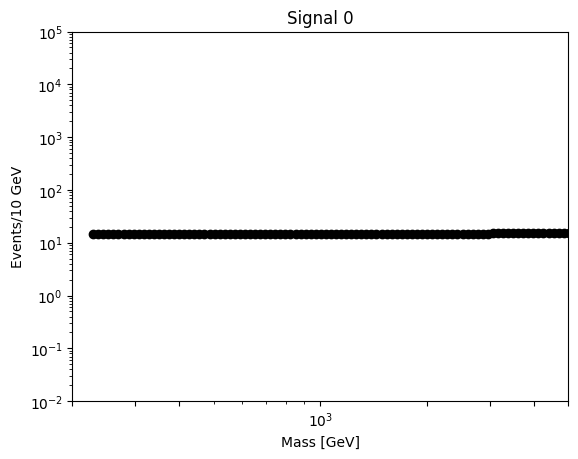

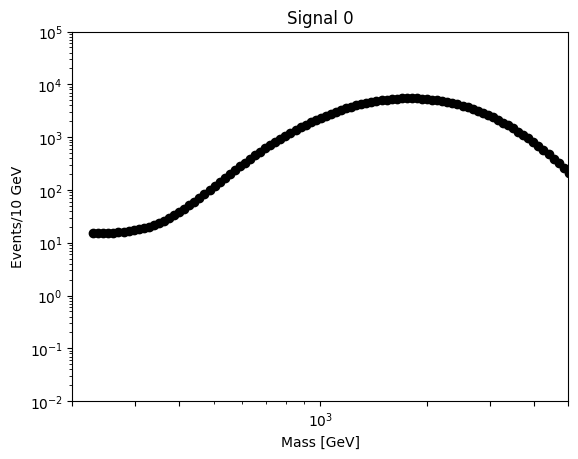

/var/folders/rw/0z5hx32j3mj7xfk6t229lqy40000gn/T/ipykernel_844/2190968464.py:192: RuntimeWarning: invalid value encountered in divide
  gaussian_dist /= gaussian_dist.max(axis=-1)


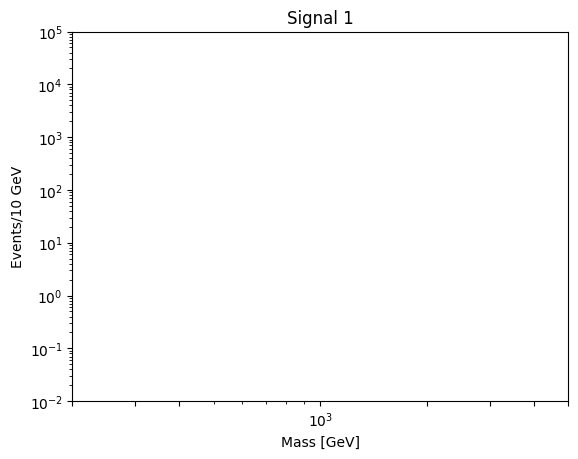

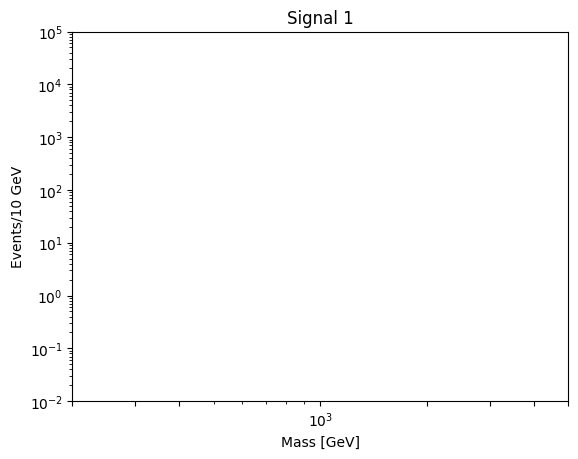

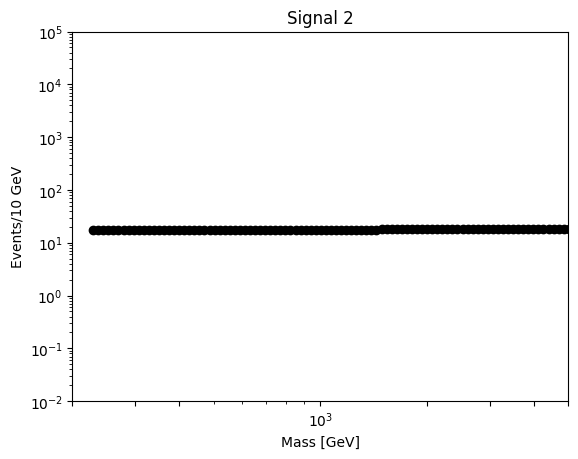

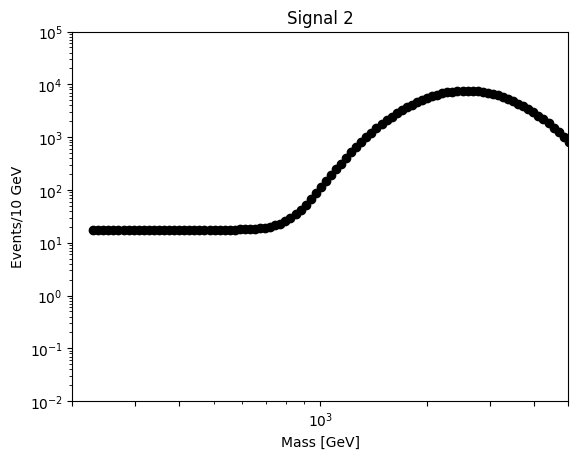

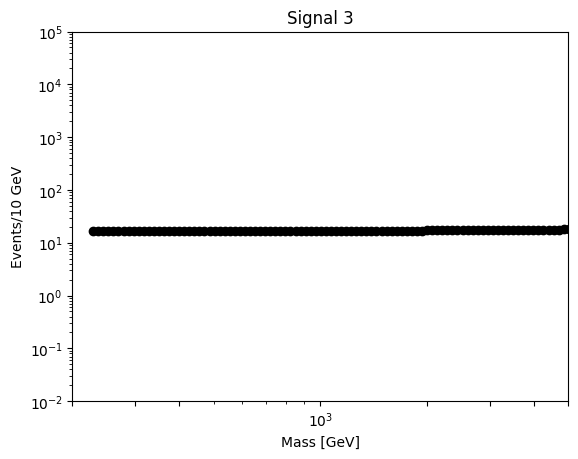

...

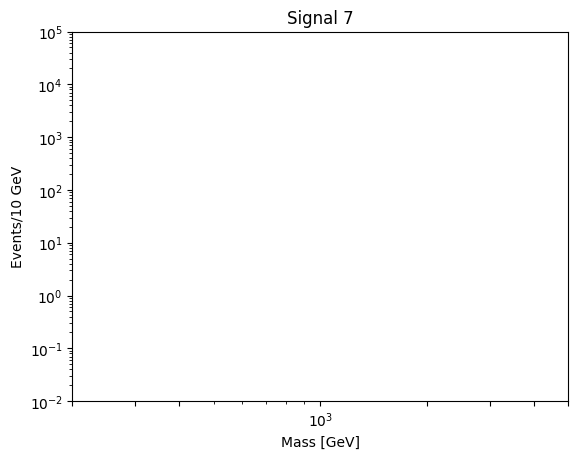

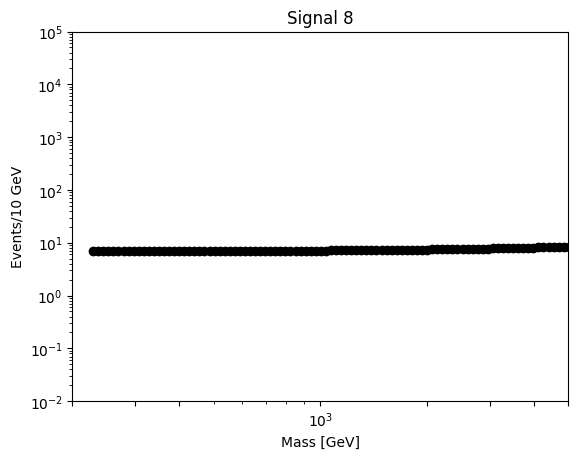

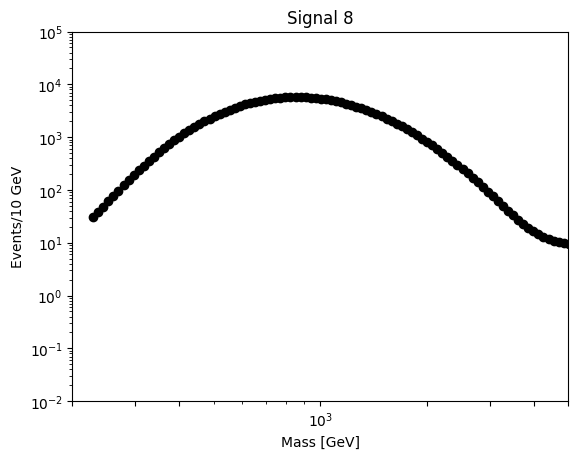

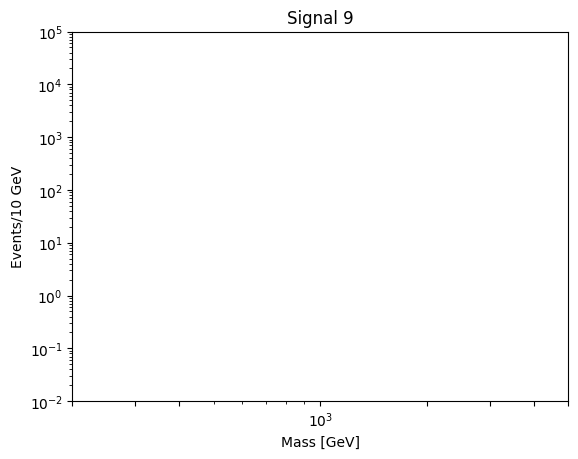

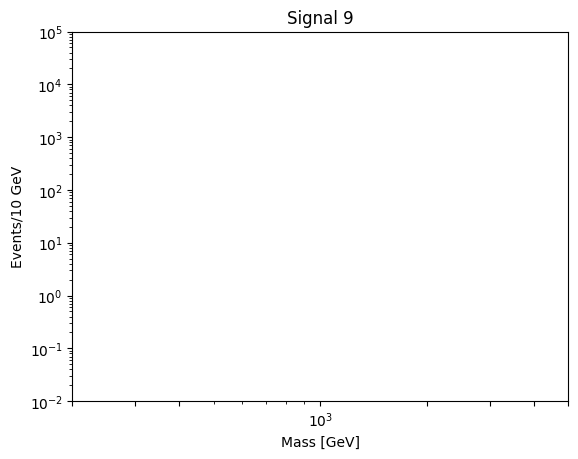

In [45]:
class optim_p3_poisson:
    def __init__(self, data_path):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1

    def create_priors(self):
        return np.random.uniform(low=[1.7 * 10**5, 1, -13.5, -5.2, -0.95, -0.1], high=[1.9 * 10**5, 5, -11, -3.5, -0.45, -0.04])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        # print(f"Norm = {norm_ft}")
        # print(f"Base function = {((1 - x ** self.c_e_ft) ** b_ft)}")
        # print(f"X function = {x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)}")
        # print(f"BW2 = {BW2}")
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        # y = y.round()
        return nn.PoissonNLLLoss(log_input=False, full=True)(y_pred, y)

    def threshold(self):
        return 25

    def adjust_theta_3(self):
        priors = self.create_priors()
        theta_opt = []
        for i in range(len(priors)):
            theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
        theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
        y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
        
        if self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) > self.threshold():
            while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
                priors = self.create_priors()
                theta_opt = []
                for i in range(len(priors)):
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        else:
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
            theta_opt = theta_opt
            y_pred_3 = y_pred_3
        return loss, theta_opt, y_pred_3

    def run(self):
        
        success = False

        while not success:
            initial_loss, theta_opt, y_pred_3 = self.adjust_theta_3()
            theta_initial = theta_opt.clone().detach()
            self.theta_initial = theta_initial

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 1400
            loss_crit = 1.5
            loss_filter = 3.37
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                    # print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, *theta_opt)
                loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 1000 and loss > loss_filter:
                    # print("Loss too high. Starting again.")
                    # print(f"Final loss before filter = {losses[-1]}")
                    break
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1000 and loss < loss_filter:
                #     print(f"Loss at 1000 iterations = {loss}")
                # if N_iter == 1500 and loss < loss_filter:
                #     print(f"Loss at 1500 iterations = {loss}")
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success == True:

            self.losses = np.array(losses)

            theta_final = []

            for i in range(len(theta_opt)):
                theta_final.append(theta_opt[i])

            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)
            self.max_N = max_N
            self.loss_filter = loss_filter
            self.N_iter_filter = N_iter_filter
            self.learning_rate = lr
            self.losses = np.array(losses)
        
            # print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
            # # Save results if good

            # timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
            # filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
            # filename_theta_final = f"Theta_3_final_{timestamp}.txt"

            # with open(filename_theta_initial, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))
            # with open(filename_theta_final, 'w') as f:
            #     f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = curve_torch_3(x_tensor, *theta_final).detach().numpy()
            # plt.plot(De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")




            # # Plot results

            # plt.errorbar(self.De_mass, self.De_event, yerr=self.yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_plot = self.curve_torch_3(self.x_tensor, *theta_final).detach().numpy()
            # plt.plot(self.De_mass, y_pred_3_plot)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 5000)
            # plt.ylim(bottom = 10**-2, top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
            # plt.title("True data")
            # plt.show()

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")
            # # a_loss.set_xlim(N_iter-1000, N_iter)
            # # a_loss.set_ylim(0.55, 0.6)

def gaussian_signal(x, mean, full_width, amplitude):

    std_dev = full_width / 4

    # gen gaussian dists
    gaussian_dist = norm(mean, std_dev).pdf(x)
    # normalise to 1
    gaussian_dist /= gaussian_dist.max(axis=-1)

    # scale by amplitude
    gaussian_dist *= amplitude

    return gaussian_dist

def signal_priors():
    return np.random.uniform(low=[700, 50, 0.1], high=[4000, 600, 30])

# Background plus signal model
data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
optimizer_class = optim_p3_poisson(data_path)
x_tensor = optimizer_class.x_tensor
array_vector_datasets_3_signal = []
for i in range(10):
    theta = optimizer_class.create_priors()
    y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
    signal_x_range = x_tensor
    signal_values = signal_priors()
    signal = gaussian_signal(signal_x_range, mean = signal_values[0], full_width = signal_values[1], amplitude = signal_values[2])
    y_pred_3_rvs_priors_plus_signal = y_pred_3_rvs_priors + signal
    plt.scatter(optimizer_class.De_mass, signal, color='black')
    plt.yscale("log")
    plt.xscale("log")
    plt.xlabel("Mass [GeV]")
    plt.ylabel("Events/10 GeV")
    plt.xlim(200, 5000)
    plt.ylim(bottom = 10**-2, top=10**5)
    plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])

    plt.title(f"Signal {i}")
    plt.show()

    plt.scatter(optimizer_class.De_mass, y_pred_3_rvs_priors_plus_signal, color='black')
    plt.yscale("log")
    plt.xscale("log")
    plt.xlabel("Mass [GeV]")
    plt.ylabel("Events/10 GeV")
    plt.xlim(200, 5000)
    plt.ylim(bottom = 10**-2, top=10**5)
    plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
    plt.title(f"Signal {i}")
    plt.show()
    # y_pred_3_rvs_priors_plus_signal_and_noise = torch.poisson(y_pred_3_rvs_priors_plus_signal)
    # if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_signal_and_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_signal_and_noise[:1]) and all(y_pred_3_rvs_priors_plus_signal_and_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_signal_and_noise[1:]):
    #     array_vector_datasets_3_signal.append(y_pred_3_rvs_priors_plus_signal_and_noise.detach().numpy())

Done


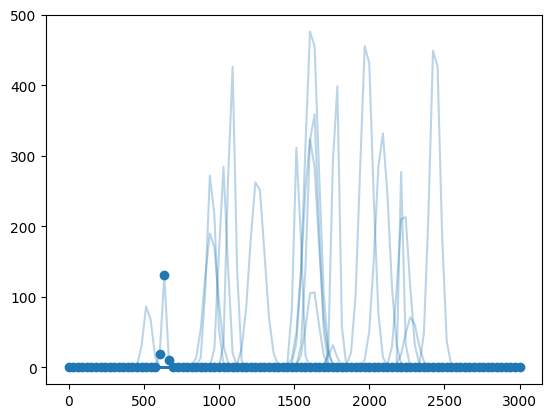

In [49]:
x = np.linspace(0, 3000, 100)
N_samples = 1000

# gen prior samples on range mean in [500, 2500] and sigma in [10, 50] and amplitude in [0, 500]
mean = np.random.rand(N_samples) * 2000 + 500
sigma = np.random.rand(N_samples) * 40 + 10
amplitude = np.random.rand(N_samples) * 500

# gen gaussian dists
gaussian_dists = norm(loc=mean[..., None], scale=sigma[..., None]).pdf(x)
# normalise to 1
gaussian_dists /= gaussian_dists.max(axis=-1)[..., None]

# scale by amplitude
gaussian_dists *= amplitude[..., None]


# plot the first 20 signals
f, a = plt.subplots(1, 1)
a.plot(x, gaussian_dists[:20].T, color="C0", alpha=0.3)

# draw the actual discrete "data"
a.scatter(x, gaussian_dists[0])

f.savefig("signal_gen.pdf")


print("Done")

# Multimodal classifier

Datasets simulated
Datasets simulated
Datasets simulated
Using device:  cpu
Epoch 1/200, Loss: 0.978348970413208
Epoch 2/200, Loss: 0.8001248240470886
Epoch 3/200, Loss: 0.6894771456718445
Epoch 4/200, Loss: 0.6052075028419495
Epoch 5/200, Loss: 0.5534396767616272
Epoch 6/200, Loss: 0.5199715495109558
Epoch 7/200, Loss: 0.48553577065467834
Epoch 8/200, Loss: 0.46743568778038025
Epoch 9/200, Loss: 0.44444766640663147
Epoch 10/200, Loss: 0.457393079996109
Epoch 11/200, Loss: 0.443342000246048
Epoch 12/200, Loss: 0.43297648429870605
Epoch 13/200, Loss: 0.4255692660808563
Epoch 14/200, Loss: 0.4169515073299408
Epoch 15/200, Loss: 0.40812984108924866
Epoch 16/200, Loss: 0.40800631046295166
Epoch 17/200, Loss: 0.4039158523082733
Epoch 18/200, Loss: 0.40657076239585876
Epoch 19/200, Loss: 0.4052942097187042
Epoch 20/200, Loss: 0.4085221290588379
Epoch 21/200, Loss: 0.3906128704547882
Epoch 22/200, Loss: 0.3864860534667969
Epoch 23/200, Loss: 0.3791791498661041
Epoch 24/200, Loss: 0.3819450438

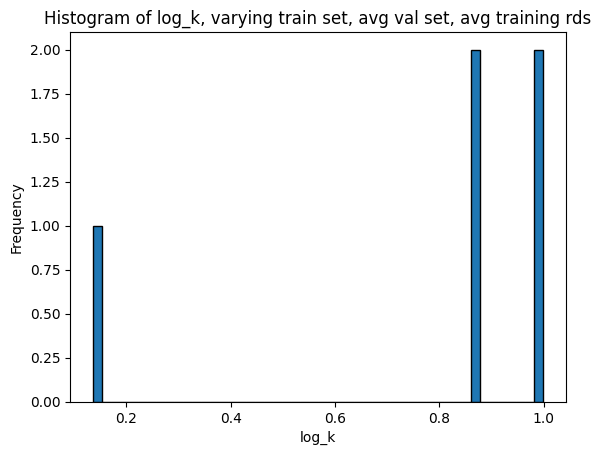

In [15]:
class MultiClassifierBase(nn.Module):
    def __init__(self, input_dim, num_classes, internal_dim=64, initial_dim=700):
        super(MultiClassifierBase, self).__init__()

        self.model = nn.Sequential(
            nn.Linear(input_dim, initial_dim),
            nn.LeakyReLU(),
            nn.BatchNorm1d(initial_dim),
            nn.Linear(initial_dim, internal_dim),
            nn.LeakyReLU(),
            nn.BatchNorm1d(internal_dim),
            nn.Linear(internal_dim, internal_dim),
            nn.LeakyReLU(),
            nn.BatchNorm1d(internal_dim),
            nn.Linear(internal_dim, internal_dim),
            nn.LeakyReLU(),
            nn.BatchNorm1d(internal_dim),
            nn.Linear(internal_dim, internal_dim),
            nn.LeakyReLU(),
            nn.Linear(internal_dim, num_classes),
        )

    def forward(self, x):
        """Forward pass through the network, logit output."""
        return self.model(x)

    def loss(self, x, y):
        """Loss function for the network."""
        raise NotImplementedError

    def predict(self, x):
        """Predict the Bayes Factor."""
        raise NotImplementedError

    def fit(self, X, y, **kwargs):

        num_epochs = kwargs.get("num_epochs", 10)
        batch_size = kwargs.get("batch_size", 512)
        decay_rate = kwargs.get("decay_rate", 0.95)
        lr = kwargs.get("lr", 0.001)
        device = torch.device(kwargs.get("device", "cpu"))

        print("Using device: ", device)

        # Convert labels to torch tensor
        X = torch.tensor(X, dtype=torch.float32)
        labels = torch.tensor(y, dtype=torch.long)  # Ensure this is a 1D tensor of class indices

        # Create a DataLoader for batch training
        dataset = torch.utils.data.TensorDataset(X, labels)
        dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

        # Define the loss function and optimizer
        criterion = self.loss
        optimizer = optim.Adam(self.parameters(), lr=lr)

        # Create the scheduler and pass in the optimizer and decay rate
        scheduler = ExponentialLR(optimizer, gamma=decay_rate)

        # Create a DataLoader for batch training
        self.to(device=device, dtype=torch.float32)

        for epoch in range(num_epochs):
            epoch_loss = []
            for i, (inputs, targets) in enumerate(dataloader):
                # Clear gradients
                optimizer.zero_grad()
                inputs = inputs.to(device)
                # Forward pass
                loss = criterion(inputs, targets)
                epoch_loss.append(loss.item())
                # Backward pass and optimize
                loss.backward()
                optimizer.step()

            # Print loss for every epoch
            scheduler.step()
            mean_loss = torch.mean(torch.tensor(epoch_loss)).item()
            print(f"Epoch {epoch+1}/{num_epochs}, Loss: {mean_loss}")

        # once training is done, set the model to eval(), ensures batchnorm
        # and dropout are not used during inference
        self.model.eval()

class MultiClassifier(MultiClassifierBase):
    """
    Extends the BinaryClassifierBase to use a BCE loss function.

    Furnishes with a direction prediction of the Bayes Factor.
    """

    def loss(self, x, y):
        """Binary cross entropy loss function for the network."""
        y_ = self.forward(x)
        return nn.CrossEntropyLoss()(y_, y.long())

    def predict(self, x):
        """Predict the log Bayes Factor.

        log K = lnP(Class 1) - lnP(Class 0)
        """
        # ensure model is in eval just in case
        self.model.eval()

        x = torch.tensor(x, dtype=torch.float32)
        x = torch.atleast_2d(x)
        pred = self.forward(x)
        pred = nn.Softmax(dim=1)(pred)
        return pred.detach().numpy()

# Load and process data

De_mass, De_event, yerr = load_and_process_data('/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv')

# Save function for arrays

def save_multiple_arrays_with_timestamp(*arrays, base_filename='saved_log_K_arrays'):
    """
    Saves multiple NumPy arrays to a single file with a timestamp, keeping them separate.
    
    Parameters:
    - arrays: Multiple NumPy array objects passed as separate arguments.
    - base_filename: Optional. Base name of the file without extension.
    
    The function saves the file in the current directory with the format:
    `base_filename_YYYYMMDD_HHMMSS.npz`

    Array1 = log_K_array
    Array2 = log_K_array_sub_array_means
    Array3 = log_K_array_means
    """
    # Format the current date and time as YYYYMMDD_HHMMSS
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    
    # Construct the filename with base_filename and timestamp
    filename = f'{base_filename}_{timestamp}.npz'
    
    # Prepare the arrays dict to save; keys are array0, array1, etc.
    arrays_dict = {f'array{i}': array for i, array in enumerate(arrays)}
    
    # Save the arrays to the file using np.savez
    np.savez(filename, **arrays_dict)
    
    print(f'Arrays saved as {filename}')

# Generate datasets
            
log_K_3way_ratios_array = []
log_K_3way_3rdval_array = []
log_K_array = []
log_K_array_means = []
log_K_array_sub_array_means = []
num_sim_dataset_arrays_train_on = 1
num_sim_datasets_per_array = 10**3
num_val_datasets = 5
num_train_rounds = 1

for i in range(num_sim_dataset_arrays_train_on):

    N = num_sim_datasets_per_array

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p2_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_2 = []
    while len(array_vector_datasets_2) < N:
        theta = optimizer_class.create_priors()
        y_pred_2_rvs_priors = optimizer_class.curve_torch_2(x_tensor, *theta)
        y_pred_2_rvs_priors_plus_noise = torch.poisson(y_pred_2_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_2_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_2_rvs_priors_plus_noise[:1]) and all(y_pred_2_rvs_priors_plus_noise[0] > elem for elem in y_pred_2_rvs_priors_plus_noise[1:]):
            array_vector_datasets_2.append(y_pred_2_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    while len(array_vector_datasets_3) < N:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise[:1]) and all(y_pred_3_rvs_priors_plus_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_noise[1:]):
            array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p4_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_4 = []
    while len(array_vector_datasets_4) < N:
        theta = optimizer_class.create_priors()
        y_pred_4_rvs_priors = optimizer_class.curve_torch_4(x_tensor, *theta)
        y_pred_4_rvs_priors_plus_noise = torch.poisson(y_pred_4_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_4_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_4_rvs_priors_plus_noise[:1]) and all(y_pred_4_rvs_priors_plus_noise[0] > elem for elem in y_pred_4_rvs_priors_plus_noise[1:]):
            array_vector_datasets_4.append(y_pred_4_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # # Validation datasets as real data

    # array_vector_datasets_validation = []

    # array_vector_datasets_validation.append(De_event)

    # Validation dataset as i = 4 model

    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p4_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_validation = []
    while len(array_vector_datasets_validation) < num_val_datasets:
        theta = optimizer_class.create_priors()
        y_pred_4_rvs_priors = optimizer_class.curve_torch_4(x_tensor, *theta)
        y_pred_4_rvs_priors_plus_noise = torch.poisson(y_pred_4_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_4_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_4_rvs_priors_plus_noise[:1]) and all(y_pred_4_rvs_priors_plus_noise[0] > elem for elem in y_pred_4_rvs_priors_plus_noise[1:]):
            array_vector_datasets_validation.append(y_pred_4_rvs_priors_plus_noise.detach().numpy())


    D2 = np.array(array_vector_datasets_2)
    D3 = np.array(array_vector_datasets_3)
    D4 = np.array(array_vector_datasets_4)

    X = x_tensor

    class CustomMultiClassifier(MultiClassifier):
        def fit(self, X, y, **kwargs):
            # kwargs['batch_size'] = 128
            kwargs['num_epochs'] = 200
            super().fit(X, y, **kwargs)

    data = np.concatenate((D2, D3, D4))
    labels = np.concatenate((np.zeros(N), np.ones(N), np.full(N, 2)))

    for j in range(num_val_datasets):
                
        array_vector_datasets_validation_subset = array_vector_datasets_validation[j]

        for k in range(num_train_rounds):
            evidence_network = CustomMultiClassifier(len(X), num_classes = 3)
            evidence_network.fit(data, labels)
            log_K_3way_ratios = evidence_network.predict(array_vector_datasets_validation_subset[...,None].T).squeeze()
            log_K_3way_ratios_array.append(log_K_3way_ratios)
            log_K_3way_3rdval_array.append(log_K_3way_ratios[2])

#     log_K_sub_array = []
#     log_K_sub_array_means = []

#     for j in range(num_val_datasets):

#         array_vector_datasets_validation_subset = array_vector_datasets_validation[j]
#         log_K_sub2_array = []
#         valid_log_K_found = False

#         # Outer loop to ensure all log_K values are finite
#         while not valid_log_K_found:
#             temp_log_K_sub2_array = []
#             all_finite = True
#             inf_counter = 0

#             for k in range(num_train_rounds):
#                 finite_log_K_found = False  # Indicator for the current training round
                
#                 while not finite_log_K_found: # Calling a new instance of evidence_network each time to start training from fresh
#                     evidence_network = CustomMultiClassifier(len(X))
#                     evidence_network.fit(data, labels)
#                     log_K = evidence_network.predict(array_vector_datasets_validation_subset[...,None].T).squeeze()

#                     if np.isnan(log_K):
#                         print("Nan produced, retraining network.")
#                     elif -10 <= log_K <= 10:
#                         print(f"Bayes Factor = {log_K}")
#                         temp_log_K_sub2_array.append(log_K)
#                         finite_log_K_found = True
#                     elif log_K < -10:
#                         print(f"Bayes Factor = {log_K}")
#                         print("Out of bounds Bayes Factor detected, appending -10 instead.")
#                         max_value = -10
#                         temp_log_K_sub2_array.append(max_value)
#                         finite_log_K_found = True
#                         inf_counter += 1
#                     elif log_K > 10:
#                         print(f"Bayes Factor = {log_K}")
#                         print("Out of bounds Bayes Factor detected, appending 10 instead.")
#                         max_value = 10
#                         temp_log_K_sub2_array.append(max_value)
#                         finite_log_K_found = True
#                         inf_counter += 1
#                     if inf_counter >= 20:
#                         print("Sufficient inf produced to use new training set.")
#                         break
#                 if inf_counter >= 20:
#                     print("Sufficient inf produced to use new training set.")
#                     break
#             # # Check if the entire set of log_K values are finite
#             # if all(not np.isinf(log_K).any() for log_K in temp_log_K_sub2_array):
#             log_K_sub2_array = temp_log_K_sub2_array  # Save the valid results
#             valid_log_K_found = True  # Exit the outer while loop
#             if inf_counter >= 20:
#                 print("Sufficient inf produced to use new training set.")
#                 break
#         if inf_counter >= 20:
#             print("Sufficient inf produced to use new training set.")
#             break
        
#         log_K_sub_array.append(log_K_sub2_array)
#         log_K_sub_array_means.append(np.mean(log_K_sub2_array))

#     log_K_array.append(log_K_sub_array)
#     log_K_array_sub_array_means.append(log_K_sub_array_means)
#     log_K_array_means.append(np.mean(log_K_sub_array_means))

# # Rename for clarity

# logk_trainsets_valsets_trainrounds = log_K_array
# logk_given_trainset_across_valsets_trainrounds_means = log_K_array_sub_array_means
# logk_across_trainset_valsets_means_trainrounds_means = log_K_array_means

# # Save arrays

# save_multiple_arrays_with_timestamp(logk_trainsets_valsets_trainrounds, logk_given_trainset_across_valsets_trainrounds_means, logk_across_trainset_valsets_means_trainrounds_means, base_filename='log_K_arrays_i2vi3')

# for i in range(num_sim_dataset_arrays_train_on):

#     for j in range(num_val_datasets):

#         plt.hist(log_K_array[i][j], bins=50, edgecolor='black')
#         plt.title(f'Histogram of log_k, training set {i}, validation set {j}, vary train rds')
#         plt.xlabel('log_k')
#         plt.ylabel('Frequency')
#         plt.show()
            
#         data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
#         optimizer_class = optim_p3_poisson(data_path)
#         curve_torch_3 = optimizer_class.curve_torch_3
#         plt.scatter(optimizer_class.De_mass, array_vector_datasets_validation[j], color='black')
#         plt.yscale("log")
#         plt.xscale("log")
#         plt.xlabel("Mass [GeV]")
#         plt.ylabel("Events/10 GeV")
#         plt.xlim(200, 5000)
#         plt.ylim(bottom = 10**-2, top=10**5)
#         plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000, 5000])
#         plt.title(f"Validation data {j}")
#         plt.show()
    
#     plt.hist(log_K_array_sub_array_means[i], bins=50, edgecolor='black')
#     plt.title(f'Histogram of log_k, train set{i}, varying val set, avg train rds')
#     plt.xlabel('log_k')
#     plt.ylabel('Frequency')
#     plt.show()

# plt.hist(log_K_array_means, bins=50, edgecolor='black')
# plt.title(f'Histogram of log_k, varying train set, avg val set, avg training rds')
# plt.xlabel('log_k')
# plt.ylabel('Frequency')
# plt.show()
            
plt.hist(log_K_3way_3rdval_array, bins=50, edgecolor='black')
plt.title(f'Histogram of log_k, varying train set, avg val set, avg training rds')
plt.xlabel('log_k')
plt.ylabel('Frequency')
plt.show()


# Testing areas (not in use rn)

## Testing area 1 (countour and interactive contour)

In [ ]:
### Sped up version of class but now for fixd abp0

def curve_torch_3(x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
    c_e_ft = 1
    BW2 = gamma / ((x * 13000 - mz) ** 2 + (gamma ** 2) / 4)
    log_x = torch.log(x)
    curve_ft = BW2 * ((1 - x ** c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
    norm_ft = a_ft / curve_ft.sum()
    return norm_ft * curve_ft

def loglike(y_pred, y, y_err_tensor):
    valid_indices = y_err_tensor > 0
    chi_sq = ((y_pred[valid_indices] - y[valid_indices]) ** 2) / (y_err_tensor[valid_indices] ** 2)
    return torch.mean(chi_sq)

class optim_p3_fix_abp0:
    def __init__(self, data_path, constant_a, constant_b, constant_p0):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x_me = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x_me, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1
        self.constant_a = constant_a
        self.constant_b = constant_b
        self.constant_p0 = constant_p0

    def create_priors(self):
        return np.random.uniform(low=[self.constant_a, self.constant_b, self.constant_p0, -7, -1, -0.1], high=[self.constant_a, self.constant_b, self.constant_p0, -1, -0.5, -0.03])

    def curve_torch_3(self, x, a_ft, b_ft, p0_ft, p1_ft, p2_ft, p3_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft + p1_ft * log_x + p2_ft * log_x ** 2 + p3_ft * log_x ** 3)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        valid_indices = y_err_tensor > 0
        chi_sq = ((y_pred[valid_indices] - y[valid_indices]) ** 2) / (y_err_tensor[valid_indices] ** 2)
        return torch.mean(chi_sq)

    def threshold(self):
        return 25

    def adjust_theta_3(self, theta, y_pred_3):
        loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta = []
            theta_opt = []
            for i in range(len(priors)):
                if i <= 2:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                if i >= 3:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta = torch.tensor(theta, dtype=torch.float32)
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, theta[0], theta[1], theta[2], theta_opt[0], theta_opt[1], theta_opt[2])
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta, theta_opt, y_pred_3

    def run(self):
        success = False

        while not success:
            priors = self.create_priors()
            theta = []
            theta_opt = []
            for i in range(len(priors)):
                if i <= 2:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                if i >= 3:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta = torch.tensor(theta, dtype=torch.float32)
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)

            y_pred_3 = self.curve_torch_3(self.x_tensor, theta[0], theta[1], theta[2], theta_opt[0], theta_opt[1], theta_opt[2])
            initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3(theta, y_pred_3)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3(theta, y_pred_3)
            else:
                pass
                # print("Valid start point found.")

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 2500
            loss_crit = 5
            N_iter = 0

            while N_iter < max_N:
                if N_iter == 0:
                    print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, theta[0], theta[1], theta[2], theta_opt[0], theta_opt[1], theta_opt[2])
                loss = self.loglike(y_pred_3, y_tensor, y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                if loss < loss_crit:
                    success = True
                    break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                if N_iter == 1000 and loss > 5.3:
                    # print("Loss too high. Starting again.")
                    break
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            theta_final = []

            for i in range(len(theta)):
                if i <= 2:
                    theta_final.append(theta[i])
            for i in range(len(theta)):
                if i <= 2:
                    theta_final.append(theta_opt[i])
            
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)

        if success:
            print(f"Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            # print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            
        #     # Save results if good

        #     timestamp = datetime.now().strftime("%Y%m%d%H%M%S")
        #     filename_theta_initial = f"Theta_3_initial_{timestamp}.txt"
        #     filename_theta_final = f"Theta_3_final_{timestamp}.txt"

        #     with open(filename_theta_initial, 'w') as f:
        #         f.write(str(self.theta_final.tolist()))
        #     with open(filename_theta_final, 'w') as f:
        #         f.write(str(self.theta_final.tolist()))

            # #Save figures
            # plt.errorbar(De_mass, De_event, yerr=yerr, fmt='.', color='black', ecolor='red')
            # y_pred_3_np = curve_torch_3(self.x_tensor, self.theta_final[0], self.theta_final[1], self.theta_final[2], self.theta_final[3], self.theta_final[4], self.theta_final[5]).detach().numpy()
            # plt.plot(De_mass, y_pred_3_np)
            # plt.yscale("log")
            # plt.xscale("log")
            # plt.xlabel("Mass [GeV]")
            # plt.ylabel("Events/10 GeV")
            # plt.xlim(200, 4000)
            # plt.ylim(top=10**5)
            # plt.xticks([200, 300, 400, 1000, 2000, 3000, 4000])

            # filename_fig = f"Fig_3_{timestamp}.pdf"
            # plt.savefig(filename_fig)

            # f_loss,a_loss = plt.subplots()
            # a_loss.plot(losses)
            # a_loss.set_yscale("log")
            # a_loss.set_ylabel("Loss")
            # a_loss.set_xlabel("Iteration")

            # filename_figloss = f"Fig_3_loss_{timestamp}.pdf"
            # f_loss.savefig(filename_figloss, bbox_inches="tight")

# Pairwise contour plots of loss (loglike() function)

def contour_plot():

    prior_0 = 180000

    # Tensor everything

    theta_0 = torch.tensor(prior_0, dtype=torch.float32)

    # Grid of parameters
    b_ft_lower = 1 # Real is 10 Viewing is 
    b_ft_upper = 5 # Real is 1 Viewing is 
    p0_ft_lower = -15 # Real is -15 Viewing is -20
    p0_ft_upper = -10 # Real is -6 Viewing is 0

    b_ft_values = torch.linspace(b_ft_lower, b_ft_upper, 20)
    p0_ft_values = torch.linspace(p0_ft_lower, p0_ft_upper, 20)
    B, P0 = torch.meshgrid(b_ft_values, p0_ft_values)
    loglike_values = torch.zeros(B.shape)

    # Evaluate loglike over the grid for optimised values of other parameters
    for i in range(len(b_ft_values)):
        for j in range((len(b_ft_values))):
            # Usage
            data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
            optimizer_class = optim_p3_fix_abp0(data_path, theta_0, b_ft_values[i], p0_ft_values[j])
            optimizer_class.run()
            theta_final = optimizer_class.theta_final
            y_pred_3_b_p0 = optimizer_class.curve_torch_3(x_tensor, theta_0, b_ft_values[i], p0_ft_values[j], theta_final[3], theta_final[4], theta_final[5])
            loglike_values[i, j] = optimizer_class.loglike(y_pred_3_b_p0, y_tensor, y_err_tensor)
            # print(f"{b_ft_values[i]}, {p0_ft_values[j]}, {loglike_values[i,j]}")
            print(f"Calculated loglike_values{[i,j]}")

    # Save file

    def save_loglike_values(loglike_values, b_ft_values, p0_ft_values, filename_prefix='loglike_history'):
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        filename = f"{filename_prefix}_{timestamp}.csv"
        
        loglike_values = loglike_values.detach().numpy()

        b_values_array = []
        p0_values_array = []
        loglike_values_array = []
    
        for i in range(len(b_ft_values)):
            for j in range((len(b_ft_values))):
                b_values_array.append(b_ft_values[i].item())
                p0_values_array.append(p0_ft_values[j].item())
                loglike_values_array.append(loglike_values[i, j].item())
    
        b_values_array = np.array(b_values_array)
        p0_values_array = np.array(p0_values_array)
        loglike_values_array = np.array(loglike_values_array)

        # Create a DataFrame with appropriate headers
        df = pd.DataFrame({
            'b_values': b_values_array,
            'p0_values': p0_values_array,
            'loglikelihood': loglike_values_array
        })

        # Save the DataFrame to a new CSV file with headers
        df.to_csv(filename, index=False)
        print(f"Data saved to {filename}")

    save_loglike_values(loglike_values, b_ft_values, p0_ft_values, filename_prefix='loglike_history')

    # Contour plotting
    plt.figure(figsize=(10, 8))
    loglike_values_np = loglike_values.detach().numpy()
    levels = np.linspace(loglike_values_np.min(), loglike_values_np.min()*3, num=10)
    contour = plt.contour(B.numpy(), P0.numpy(), loglike_values_np, levels=levels, cmap='viridis', vmin=0, vmax=levels[-1])
    plt.colorbar(contour)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Contour Plot')
    # print(b_ft_values)
    # print(p0_ft_values)
    # print(B)
    # print(P0)
    # print(loglike_values_np)
    plt.show()
    
    # Scatter Plotting

    b_values_array = []
    p0_values_array = []
    loglike_values_array = []
    
    for i in range(len(b_ft_values)):
        for j in range((len(b_ft_values))):
            b_values_array.append(b_ft_values[i].item())
            p0_values_array.append(p0_ft_values[j].item())
            loglike_values_array.append(loglike_values[i, j].item())
    
    b_values_array = np.array(b_values_array)
    p0_values_array = np.array(p0_values_array)
    loglike_values_array = np.array(loglike_values_array)

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(b_values_array, p0_values_array, c=loglike_values_array, cmap='viridis', s=5, vmin=0, vmax=200)
    plt.colorbar(scatter)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Scatter Plot')

    critical_loglike_value = 100

    # Iterate over all points
    for i, loglike_val in enumerate(loglike_values_array):
        if loglike_val < critical_loglike_value:
            plt.text(b_values_array[i] + 0.02, p0_values_array[i], str(round(loglike_val, 1)), fontsize=9, color='red')
    
    plt.show()

# Call contour plot function

contour_plot()


/opt/homebrew/lib/python3.11/site-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/aten/src/ATen/native/TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Initial Loss = 14.499194145202637
Final loss = 4.97276095256275, Number of iterations = 236
Calculated loglike_values[0, 0]
Initial Loss = 3.0020503997802734
Final loss = 3.002050579637366, Number of iterations = 1
Calculated loglike_values[0, 1]
Initial Loss = 18.03022575378418
Final loss = 4.989245038994372, Number of iterations = 179
Calculated loglike_values[0, 2]
Initial Loss = 22.889698028564453
Final loss = 4.562416827243167, Number of iterations = 2
Calculated loglike_values[0, 3]
Initial Loss = 23.95747184753418
Final loss = 4.996158234424199, Number of iterations = 187
Calculated loglike_values[0, 4]
Initial Loss = 7.649322509765625
Final loss = 4.996157076553314, Number of iterations = 19
Calculated loglike_values[0, 5]
Initial Loss = 10.765313148498535
Final loss = 4.970135328162962, Number of iterations = 39
Calculated loglike_values[0, 6]
Initial Loss = 10.147253036499023
Final loss = 4.982616617772652, Number of iterations = 185
Calculated loglike_values[0, 7]
Initial Lo

KeyboardInterrupt: 

[[1. 1. 3. 3.]
 [1. 1. 3. 3.]
 [1. 1. 3. 3.]
 [1. 1. 3. 3.]]
[[-15. -15. -15. -15.]
 [-10. -10. -10. -10.]
 [-15. -15. -15. -15.]
 [-10. -10. -10. -10.]]
[15629.19335938   451.95657349  3324.58300781   742.27453613]


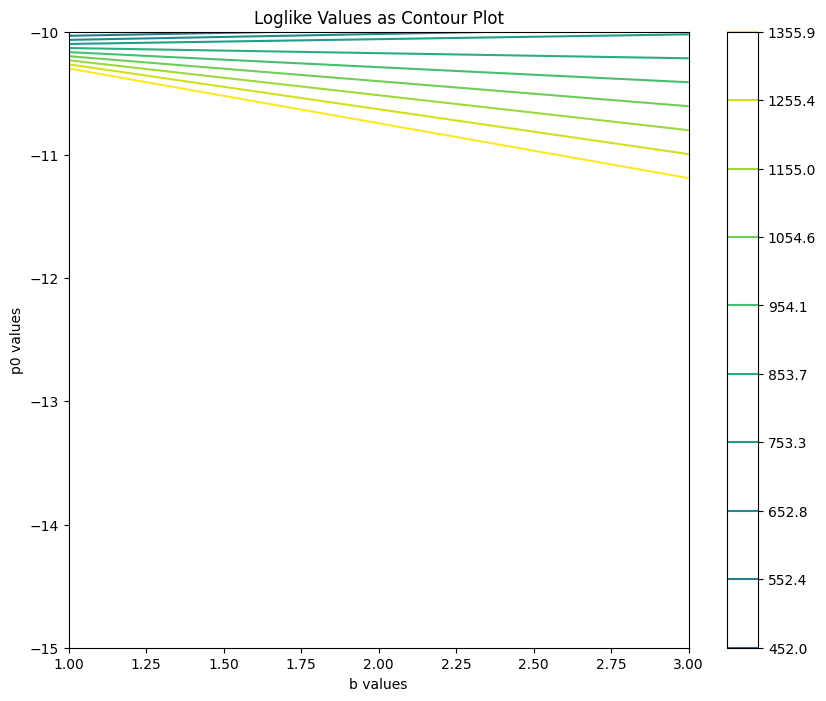

In [ ]:
def replot_contour(filename):
    
    data = pd.read_csv(filename)

    b_values = data['b_values'].values
    p0_values = data['p0_values'].values
    loglike_values = data['loglikelihood'].values

    def unique_ordered(arr):
        # Initialize an empty list to keep track of unique items
        unique_list = []
        # Iterate over each item in the array
        for item in arr:
            # If the item is not already in the list, append it
            if item not in unique_list:
                unique_list.append(item)
        # Convert the list back to a numpy array and return
        return np.array(unique_list)
        

    # Since the original data might not be in a grid form suitable for contour plots,
    # we need to create a grid. Assuming b_values and p0_values are sorted and unique:
    b_values_shape = unique_ordered(b_values)
    b_values = b_values.reshape(len(b_values_shape), len(b_values_shape))
    p0_values = p0_values.reshape(len(b_values_shape), len(b_values_shape))

    B, P0 = np.meshgrid(b_values, p0_values)

    print(B)
    print(P0)
    print(loglike_values)
    
    # Reshape loglikelihood to match the shape of B and P0 for contour plotting
    loglike_grid = loglike_values.reshape(len(b_values_shape), len(b_values_shape))

    # Contour plotting
    plt.figure(figsize=(10, 8))
    levels = np.linspace(loglike_grid.min(), loglike_grid.min()*3, num=10)
    contour = plt.contour(b_values, p0_values, loglike_grid, levels=levels, cmap='viridis', vmin=0, vmax=levels[-1])
    plt.colorbar(contour)
    plt.xlabel('b values')
    plt.ylabel('p0 values')
    plt.title('Loglike Values as Contour Plot')
    plt.show()

replot_contour('loglike_history_20240229_004748.csv')

In [ ]:
def int_contour(filename):# Load the data

    data = pd.read_csv(filename)

    b_values = data['b_values'].values
    p0_values = data['p0_values'].values
    loglike_values = data['loglikelihood'].values

    def unique_ordered(arr):
        # Initialize an empty list to keep track of unique items
        unique_list = []
        # Iterate over each item in the array
        for item in arr:
            for i in range(len(arr)):
                if arr[i] == item:
                    # If the item is not already in the list, append it
                    if item not in unique_list:
                        unique_list.append(item)
        # Convert the list back to a numpy array and return
        return np.array(unique_list)
        

    # Since the original data might not be in a grid form suitable for contour plots,
    # we need to create a grid. Assuming b_values and p0_values are sorted and unique:
    b_values_shape = unique_ordered(b_values)
    # b_values = b_values.reshape(len(b_values_shape), len(b_values_shape))
    # p0_values = p0_values.reshape(len(b_values_shape), len(b_values_shape))
    b_values = unique_ordered(b_values)
    p0_values = unique_ordered(p0_values)

    B, P0 = np.meshgrid(b_values, p0_values)
    
    # Reshape loglikelihood to match the shape of B and P0 for contour plotting
    loglike_grid = loglike_values.reshape(len(b_values_shape), len(b_values_shape))

    fig = go.Figure(data=[go.Surface(z=-loglike_grid, x=B, y=P0)])

    # Customizing the layout
    fig.update_layout(
        title='Interactive 3D Plot of Log-Likelihood',
        autosize=False,
        width=800, 
        height=800,
        margin=dict(l=65, r=50, b=65, t=90),
        scene=dict(
            xaxis_title='b values',
            yaxis_title='p0 values',
            zaxis_title='- Log-Likelihood',))
            # zaxis=dict(range=[-4, 0])))

    fig.update_traces(contours_z=dict(show=True, usecolormap=True, highlightcolor="limegreen", project_z=True))

    # Update scenes for better 3D interaction controls

    fig.update_scenes(
        aspectratio=dict(x=1, y=1, z=0.7),
        camera_eye=dict(x=1.25, y=1.25, z=1.25)
    )

    fig.show()

    print(b_values)
    print(p0_values)
    print(loglike_grid)

int_contour('loglike_history_20240229_060044_IMP_b1to5_p0-15to-10.csv')

[1. 3.]
[-15. -10.]
[[15629.19335938   451.95657349]
 [ 3324.58300781   742.27453613]]


In [ ]:
def int_contour(filename):# Load the data

    data = pd.read_csv(filename)

    b_values = data['b_values'].values
    p0_values = data['p0_values'].values
    loglike_values = data['loglikelihood'].values

    def unique_ordered(arr):
        # Initialize an empty list to keep track of unique items
        unique_list = []
        # Iterate over each item in the array
        for item in arr:
            # If the item is not already in the list, append it
            if item not in unique_list:
                unique_list.append(item)
        # Convert the list back to a numpy array and return
        return np.array(unique_list)
        

    # Since the original data might not be in a grid form suitable for contour plots,
    # we need to create a grid. Assuming b_values and p0_values are sorted and unique:
    b_values_shape = unique_ordered(b_values)
    b_values = b_values.reshape(len(b_values_shape), len(b_values_shape))
    p0_values = p0_values.reshape(len(b_values_shape), len(b_values_shape))
    
    # Reshape loglikelihood to match the shape of B and P0 for contour plotting
    loglike_grid = loglike_values.reshape(len(b_values_shape), len(b_values_shape))

    fig = go.Figure(data=[go.Surface(z=-loglike_grid, x=b_values, y=p0_values, cmin=-100, cmax=0)])

    # Customizing the layout
    fig.update_layout(
        title='Interactive 3D Plot of Log-Likelihood',
        autosize=False,
        width=800, 
        height=800,
        margin=dict(l=65, r=50, b=65, t=90),
        scene=dict(
            xaxis_title='b values',
            yaxis_title='p0 values',
            zaxis_title='- Log-Likelihood',))
            # zaxis=dict(range=[-8, 0])))

    fig.update_traces(contours_z=dict(show=True, usecolormap=True, highlightcolor="limegreen", project_z=True))

    # Update scenes for better 3D interaction controls

    fig.update_scenes(
        aspectratio=dict(x=1, y=1, z=0.7),
        camera_eye=dict(x=1.25, y=1.25, z=1.25))

    fig.show()

int_contour('loglike_history_20240229_060044_IMP_b1to5_p0-15to-10.csv')

In [ ]:
# Load the data
filename = 'loglike_history_20240227_112528_IMP_2_b3to5.5_p0-14to-11.csv'  # Update this to your actual filename
data = pd.read_csv(filename)

b_values = data['b_values'].values
b_values = b_values[::-1]
p0_values = data['p0_values'].values
p0_values = p0_values[::-1]
loglike_values = data['loglikelihood'].values
loglike_values = loglike_values[::-1]

# Assuming your b_values and p0_values are already grid-like, reshape them
unique_b = np.unique(b_values)
unique_p0 = np.unique(p0_values)
B, P0 = np.meshgrid(unique_b, unique_p0)

# Reshape loglike_values similarly
loglike_values = loglike_values.reshape(B.shape)

# # Create the plot
# fig = plt.figure(figsize=(10, 7))
# ax = fig.add_subplot(111, projection='3d')

# Plotting the 3D contour
# levels = np.linspace(loglike_values.min(), 200, num=1000)
# surf = ax.contour3D(B, P0, -loglike_values, levels=levels, cmap='viridis', vmin=0, vmax=200, edgecolor='none', rstride=1, cstride=1, linewidth=0, antialiased=False)
# fig.colorbar(surf)

# ax.set_xlabel('b values')
# ax.set_ylabel('p0 values')
# ax.set_zlabel('Log-Likelihood')
# ax.set_title('3D Contour Plot of Log-Likelihood against b and p0')
# ax.set_zlim(bottom=0, top=200)

fig = go.Figure(data=[go.Surface(z=-loglike_values, x=B, y=P0, cmin=-4, cmax=0)])

# Customizing the layout
fig.update_layout(
    title='Interactive 3D Plot of Log-Likelihood',
    autosize=False,
    width=800, 
    height=800,
    margin=dict(l=65, r=50, b=65, t=90),
    scene=dict(
        xaxis_title='b values',
        yaxis_title='p0 values',
        zaxis_title='- Log-Likelihood',
        zaxis=dict(range=[-4, 0])))

fig.update_traces(contours_z=dict(show=True, usecolormap=True, highlightcolor="limegreen", project_z=True))

# Update scenes for better 3D interaction controls

fig.update_scenes(
    aspectratio=dict(x=1, y=1, z=0.7),
    camera_eye=dict(x=1.25, y=1.25, z=1.25)
)

fig.show()

In [ ]:
# Load the data
filename = 'loglike_history_20240227_120001_IMP_3_b5.5to8_p0-14to-11.csv'  # Update this to your actual filename
data = pd.read_csv(filename)

b_values = data['b_values'].values
p0_values = data['p0_values'].values
loglike_values = data['loglikelihood'].values

# Assuming your b_values and p0_values are already grid-like, reshape them
unique_b = np.unique(b_values)
unique_p0 = np.unique(p0_values)
B, P0 = np.meshgrid(unique_b, unique_p0)

# Reshape loglike_values similarly
loglike_values = loglike_values.reshape(B.shape)

# # Create the plot
# fig = plt.figure(figsize=(10, 7))
# ax = fig.add_subplot(111, projection='3d')

# Plotting the 3D contour
# levels = np.linspace(loglike_values.min(), 200, num=1000)
# surf = ax.contour3D(B, P0, -loglike_values, levels=levels, cmap='viridis', vmin=0, vmax=200, edgecolor='none', rstride=1, cstride=1, linewidth=0, antialiased=False)
# fig.colorbar(surf)

# ax.set_xlabel('b values')
# ax.set_ylabel('p0 values')
# ax.set_zlabel('Log-Likelihood')
# ax.set_title('3D Contour Plot of Log-Likelihood against b and p0')
# ax.set_zlim(bottom=0, top=200)

fig = go.Figure(data=[go.Surface(z=loglike_values, x=B, y=P0, cmin=-4, cmax=0)])

# Customizing the layout
fig.update_layout(
    title='Interactive 3D Plot of Log-Likelihood',
    autosize=False,
    width=800, 
    height=800,
    margin=dict(l=65, r=50, b=65, t=90),
    scene=dict(
        xaxis_title='b values',
        yaxis_title='p0 values',
        zaxis_title='Log-Likelihood',
        zaxis=dict(range=[9, 0])))

fig.update_traces(contours_z=dict(show=True, usecolormap=True, highlightcolor="limegreen", project_z=True))

# Update scenes for better 3D interaction controls

fig.update_scenes(
    aspectratio=dict(x=1, y=1, z=0.7),
    camera_eye=dict(x=1.25, y=1.25, z=1.25)
)

fig.show()

## Testing area 2 (Scanning b against loglikelihood, optimising all others)

Final loss = 1012.0423969775399, Number of iterations = 5000
Calculated loglike_values[0]
Final loss = 1846.179174687742, Number of iterations = 5000
Calculated loglike_values[1]
Final loss = 1231.1938654544858, Number of iterations = 5000
Calculated loglike_values[2]
Final loss = 1278.323215043453, Number of iterations = 5000
Calculated loglike_values[3]
Final loss = 1474.604621629812, Number of iterations = 5000
Calculated loglike_values[4]
Final loss = 1165.169770722607, Number of iterations = 5000
Calculated loglike_values[5]
Final loss = 955.3012160268364, Number of iterations = 5000
Calculated loglike_values[6]
Final loss = 1317.8890843504091, Number of iterations = 5000
Calculated loglike_values[7]
Final loss = 1827.6877121046525, Number of iterations = 5000
Calculated loglike_values[8]
Final loss = 866.0620625747374, Number of iterations = 5000
Calculated loglike_values[9]
Final loss = 1692.8675771929165, Number of iterations = 5000
Calculated loglike_values[10]
Final loss = 83

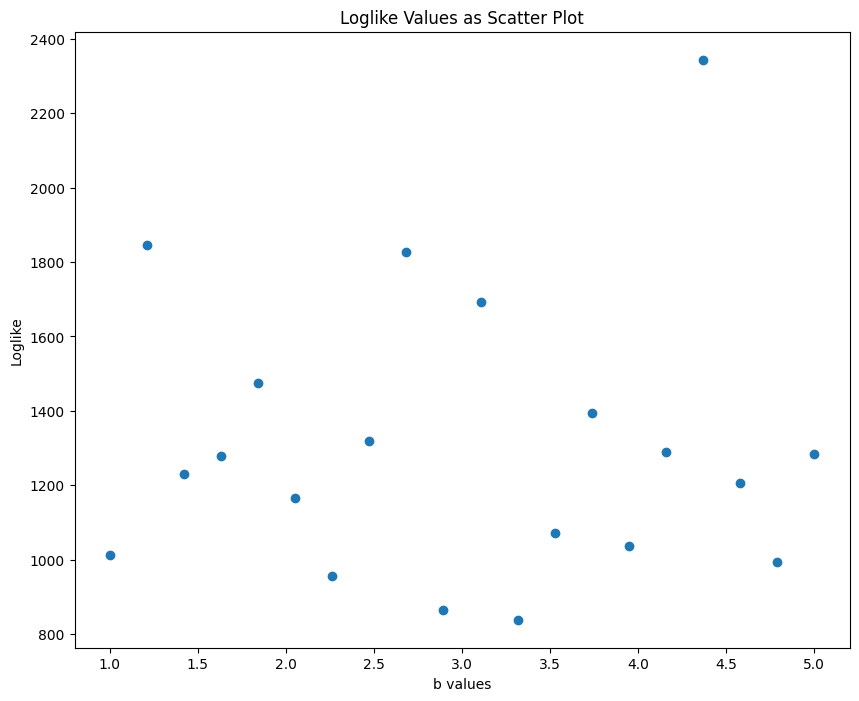

In [ ]:
class optim_p3_only_abp0:
    def __init__(self, data_path, constant_b):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x_me = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x_me, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1
        self.constant_b = constant_b

    def create_priors(self):
        return np.random.uniform(low=[10**5, self.constant_b, -15], high=[2 * 10**5, self.constant_b, -10])
    
    def curve_torch_3(self, x, a_ft, b_ft, p0_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** (p0_ft)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        valid_indices = y_err_tensor > 0
        chi_sq = ((y_pred[valid_indices] - y[valid_indices]) ** 2) / (y_err_tensor[valid_indices] ** 2)
        return torch.mean(chi_sq)

    def threshold(self):
        return 10**5

    def adjust_theta_3(self, theta, y_pred_3):
        loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta = []
            theta_opt = []
            for i in range(len(priors)):
                if i == 0:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 1:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                if i == 2:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta = torch.tensor(theta, dtype=torch.float32)
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1])
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta, theta_opt, y_pred_3

    def run(self):
        success = False

        while not success:
            priors = self.create_priors()
            theta = []
            theta_opt = []
            for i in range(len(priors)):
                if i == 0:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 1:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                if i == 2:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
            theta = torch.tensor(theta, dtype=torch.float32)
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)

            y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1])
            initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3(theta, y_pred_3)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3(theta, y_pred_3)
            else:
                pass
            #     # print("Valid start point found.")

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 5000
            loss_crit = 5
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                #     print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1], theta_opt[1])
                loss = self.loglike(y_pred_3, y_tensor, y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                # if N_iter == 1000 and loss > 5.3:
                #     # print("Loss too high. Starting again.")
                #     break
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success:

            theta_final = []
        
            for i in range(len(theta)):
                if i == 0:
                    theta_final.append(theta_opt[i])
                if i == 1:
                    theta_final.append(theta[i])
                if i == 2:
                    theta_final.append(theta_opt[i-1])
        
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)

            print(f"Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            # print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")

# Pairwise contour plots of loss (loglike() function)

def b_loglike_scan_only_abp0():

    # Grid of parameters
    b_ft_lower = 1 # Real is 10 Viewing is 
    b_ft_upper = 5 # Real is 1 Viewing is 

    b_ft_values = torch.linspace(b_ft_lower, b_ft_upper, 20)
    loglike_values = torch.zeros(b_ft_values.shape)

    # Evaluate loglike over the grid for optimised values of other parameters
    for i in range(len(b_ft_values)):
        # Usage
        data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        optimizer_class = optim_p3_only_abp0(data_path, b_ft_values[i])
        optimizer_class.run()
        theta_final = optimizer_class.theta_final
        y_pred_3_b_p0 = optimizer_class.curve_torch_3(x_tensor, theta_final[0], b_ft_values[i], theta_final[2])
        loglike_values[i] = optimizer_class.loglike(y_pred_3_b_p0, y_tensor, y_err_tensor)
        # print(f"{b_ft_values[i]}, {p0_ft_values[j]}, {loglike_values[i,j]}")
        print(f"Calculated loglike_values{[i]}")

    # Save file

    def save_loglike_values(loglike_values, b_ft_values, filename_prefix='loglike_history_bvsloglike'):
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        filename = f"{filename_prefix}_{timestamp}.csv"
        
        loglike_values = loglike_values.detach().numpy()

        b_values_array = []
        loglike_values_array = []
    
        for i in range(len(b_ft_values)):
            b_values_array.append(b_ft_values[i].item())
            loglike_values_array.append(loglike_values[i].item())
    
        b_values_array = np.array(b_values_array)
        loglike_values_array = np.array(loglike_values_array)

        # Create a DataFrame with appropriate headers
        df = pd.DataFrame({
            'b_values': b_values_array,
            'loglikelihood': loglike_values_array
        })

        # Save the DataFrame to a new CSV file with headers
        df.to_csv(filename, index=False)
        print(f"Data saved to {filename}")

    save_loglike_values(loglike_values, b_ft_values, filename_prefix='loglike_history_bvsloglike')
    
    # Scatter Plotting

    b_values_array = []
    loglike_values_array = []
    
    for i in range(len(b_ft_values)):
        b_values_array.append(b_ft_values[i].item())
        loglike_values_array.append(loglike_values[i].item())
    
    b_values_array = np.array(b_values_array)
    loglike_values_array = np.array(loglike_values_array)

    plt.figure(figsize=(10, 8))
    plt.scatter(b_values_array, loglike_values_array)
    plt.xlabel('b values')
    plt.ylabel('Loglike')
    plt.title('Loglike Values as Scatter Plot')

    # critical_loglike_value = 100

    # # Iterate over all points
    # for i, loglike_val in enumerate(loglike_values_array):
    #     if loglike_val < critical_loglike_value:
    #         plt.text(b_values_array[i] + 0.02, p0_values_array[i], str(round(loglike_val, 1)), fontsize=9, color='red')
    
    plt.show()

# Call contour plot function

b_loglike_scan_only_abp0()

Final loss = 2157.3536024904483, Number of iterations = 5000
Calculated loglike_values[0], Loglike = 2157.353515625, a = 132129.234375
Final loss = 1949.985483797782, Number of iterations = 5000
Calculated loglike_values[1], Loglike = 1949.9854736328125, a = 130857.75
Final loss = 3642.0852295636923, Number of iterations = 5000
Calculated loglike_values[2], Loglike = 3642.085205078125, a = 197782.140625
Final loss = 2111.744386699823, Number of iterations = 5000
Calculated loglike_values[3], Loglike = 2111.744384765625, a = 155979.921875
Final loss = 2480.5108436073697, Number of iterations = 5000
Calculated loglike_values[4], Loglike = 2480.5107421875, a = 179319.328125
Final loss = 1675.7859829143938, Number of iterations = 5000
Calculated loglike_values[5], Loglike = 1675.7860107421875, a = 150462.515625
Final loss = 1353.4671153444376, Number of iterations = 5000
Calculated loglike_values[6], Loglike = 1353.4671630859375, a = 135561.546875
Final loss = 1913.1855089191797, Number of

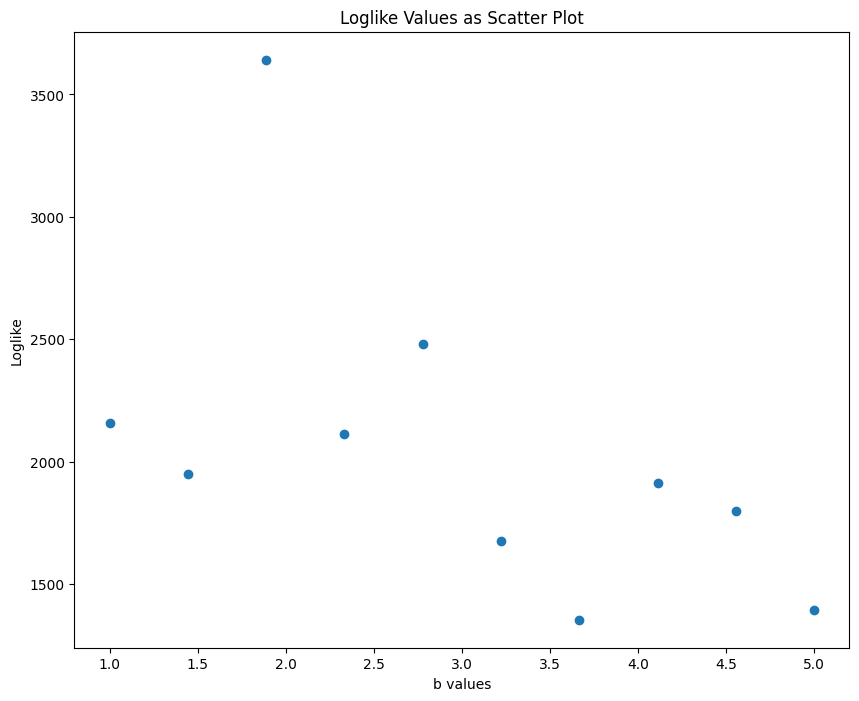

In [ ]:
class optim_p3_only_ab:
    def __init__(self, data_path, constant_b):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x_me = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x_me, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1
        self.constant_b = constant_b

    def create_priors(self):
        return np.random.uniform(low=[10**5, self.constant_b], high=[2 * 10**5, self.constant_b])
    
    def curve_torch_3(self, x, a_ft, b_ft):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft)
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        valid_indices = y_err_tensor > 0
        chi_sq = ((y_pred[valid_indices] - y[valid_indices]) ** 2) / (y_err_tensor[valid_indices] ** 2)
        return torch.mean(chi_sq)

    def threshold(self):
        return 10**5

    def adjust_theta_3(self, theta, y_pred_3):
        loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        while not self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor) < self.threshold():
            priors = self.create_priors()
            theta = []
            theta_opt = []
            for i in range(len(priors)):
                if i == 0:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 1:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
            theta = torch.tensor(theta, dtype=torch.float32)
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)
            y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1])
            loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)
        return loss, theta, theta_opt, y_pred_3

    def run(self):
        success = False

        while not success:
            priors = self.create_priors()
            theta = []
            theta_opt = []
            for i in range(len(priors)):
                if i == 0:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
                    theta_opt.append(torch.tensor(priors[i], dtype=torch.float32, requires_grad=True))
                if i == 1:
                    theta.append(torch.tensor(priors[i], dtype=torch.float32))
            theta = torch.tensor(theta, dtype=torch.float32)
            theta_opt = torch.tensor(theta_opt, dtype=torch.float32, requires_grad=True)

            y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1])
            initial_loss = self.loglike(y_pred_3, self.y_tensor, self.y_err_tensor)

            # print(f"First theta = {theta}")

            if initial_loss > self.threshold() and not torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3(theta, y_pred_3)
            if torch.isnan(initial_loss):
                # print("Invalid loss, adjusting.")
                initial_loss, theta, theta_opt, y_pred_3 = self.adjust_theta_3(theta, y_pred_3)
            else:
                pass
            #     # print("Valid start point found.")

            optimizer = Adam([theta_opt], lr=0.001)
            loss = initial_loss
            losses = []
            max_N = 5000
            loss_crit = 5
            N_iter = 0

            while N_iter < max_N:
                # if N_iter == 0:
                #     print(f"Initial Loss = {loss}")
                optimizer.zero_grad()
                y_pred_3 = self.curve_torch_3(self.x_tensor, theta_opt[0], theta[1])
                loss = self.loglike(y_pred_3, y_tensor, y_err_tensor)
                loss.backward()
                optimizer.step()
                losses.append(loss.detach().numpy())
                N_iter += 1
                # if loss < loss_crit:
                #     success = True
                #     break
                # if N_iter % 250 == 0:
                    # print(f"N_iter = {N_iter}")
                    # print(f"Loss = {loss}")
                # if N_iter == 1000 and loss > 5.3:
                #     # print("Loss too high. Starting again.")
                #     break
            # else:
                # print("Max number of iterations reach, no optimised value found. Starting again.")

            if N_iter == max_N:
                success = True

        if success:

            theta_final = []
        
            for i in range(len(theta)):
                if i == 0:
                    theta_final.append(theta_opt[i])
                if i == 1:
                    theta_final.append(theta[i])
        
            self.theta_final = torch.tensor(theta_final, dtype=torch.float32)

            print(f"Final loss = {losses[-1]}, Number of iterations = {N_iter}")
            # print(f"Final theta = {self.theta_final}, Final loss = {losses[-1]}, Number of iterations = {N_iter}")

# Pairwise contour plots of loss (loglike() function)

def b_loglike_scan_only_ab():

    # Grid of parameters
    b_ft_lower = 1 # Real is 10 Viewing is 
    b_ft_upper = 5 # Real is 1 Viewing is 

    b_ft_values = torch.linspace(b_ft_lower, b_ft_upper, 10)
    loglike_values = torch.zeros(b_ft_values.shape)

    # Evaluate loglike over the grid for optimised values of other parameters
    for i in range(len(b_ft_values)):
        # Usage
        data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        optimizer_class = optim_p3_only_ab(data_path, b_ft_values[i])
        optimizer_class.run()
        theta_final = optimizer_class.theta_final
        y_pred_3_b_p0 = optimizer_class.curve_torch_3(x_tensor, theta_final[0], b_ft_values[i])
        loglike_values[i] = optimizer_class.loglike(y_pred_3_b_p0, y_tensor, y_err_tensor)
        # print(f"{b_ft_values[i]}, {p0_ft_values[j]}, {loglike_values[i,j]}")
        print(f"Calculated loglike_values{[i]}, Loglike = {loglike_values[i]}, a = {theta_final[0]}")

    # Save file

    def save_loglike_values(loglike_values, b_ft_values, filename_prefix='loglike_history_bvsloglike'):
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        filename = f"{filename_prefix}_{timestamp}.csv"
        
        loglike_values = loglike_values.detach().numpy()

        b_values_array = []
        loglike_values_array = []
    
        for i in range(len(b_ft_values)):
            b_values_array.append(b_ft_values[i].item())
            loglike_values_array.append(loglike_values[i].item())
    
        b_values_array = np.array(b_values_array)
        loglike_values_array = np.array(loglike_values_array)

        # Create a DataFrame with appropriate headers
        df = pd.DataFrame({
            'b_values': b_values_array,
            'loglikelihood': loglike_values_array
        })

        # Save the DataFrame to a new CSV file with headers
        df.to_csv(filename, index=False)
        print(f"Data saved to {filename}")

    save_loglike_values(loglike_values, b_ft_values, filename_prefix='loglike_history_bvsloglike')
    
    # Scatter Plotting

    b_values_array = []
    loglike_values_array = []
    
    for i in range(len(b_ft_values)):
        b_values_array.append(b_ft_values[i].item())
        loglike_values_array.append(loglike_values[i].item())
    
    b_values_array = np.array(b_values_array)
    loglike_values_array = np.array(loglike_values_array)

    plt.figure(figsize=(10, 8))
    plt.scatter(b_values_array, loglike_values_array)
    plt.xlabel('b values')
    plt.ylabel('Loglike')
    plt.title('Loglike Values as Scatter Plot')

    # critical_loglike_value = 100

    # # Iterate over all points
    # for i, loglike_val in enumerate(loglike_values_array):
    #     if loglike_val < critical_loglike_value:
    #         plt.text(b_values_array[i] + 0.02, p0_values_array[i], str(round(loglike_val, 1)), fontsize=9, color='red')
    
    plt.show()

# Call contour plot function

b_loglike_scan_only_ab()

Calculated loglike_values[0]
Calculated loglike_values[1]
Calculated loglike_values[2]
Calculated loglike_values[3]
Calculated loglike_values[4]
Calculated loglike_values[5]
Calculated loglike_values[6]
Calculated loglike_values[7]
Calculated loglike_values[8]
Calculated loglike_values[9]


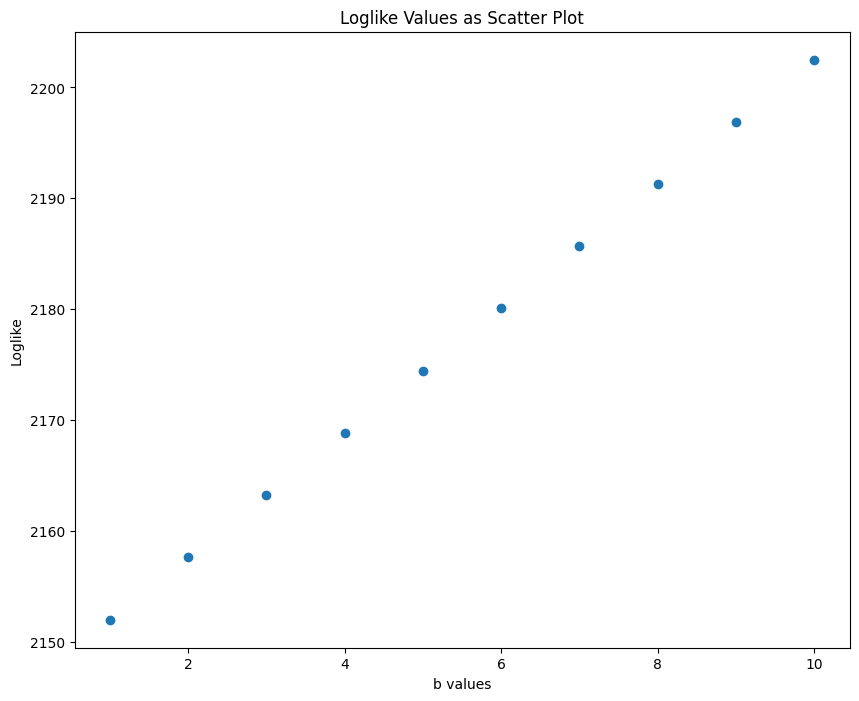

interactive(children=(FloatSlider(value=-10.0, continuous_update=False, description='p0', max=0.0, min=-15.0),…

<function __main__.b_loglike_scan_fix_a_slider_p0(p0)>

In [ ]:
class optim_p3_only_b:
    def __init__(self, data_path, constant_a, constant_b, p0):
        self.gamma = 2.4952
        self.mz = 91.1876
        self.De_mass, self.De_event, self.yerr = load_and_process_data(data_path)
        self.x_me = self.De_mass / 13000
        self.x_tensor = torch.tensor(self.x_me, dtype=torch.float32)
        self.y_tensor = torch.tensor(self.De_event, dtype=torch.float32)
        self.y_err_tensor = torch.tensor(self.yerr, dtype=torch.float32)
        self.c_e_ft = 1
        self.constant_b = constant_b
        self.constant_a = constant_a
        self.p0 = p0

    def create_priors(self):
        return np.random.uniform(low=[self.constant_b], high=[self.constant_b])
    
    def curve_torch_3(self, x, a_ft, b_ft, p0):
        BW2 = self.gamma / ((x * 13000 - self.mz) ** 2 + (self.gamma ** 2) / 4)
        log_x = torch.log(x)
        curve_ft = BW2 * ((1 - x ** self.c_e_ft) ** b_ft) * x ** p0
        norm_ft = a_ft / curve_ft.sum()
        return norm_ft * curve_ft

    def loglike(self, y_pred, y, y_err_tensor):
        valid_indices = y_err_tensor > 0
        chi_sq = ((y_pred[valid_indices] - y[valid_indices]) ** 2) / (y_err_tensor[valid_indices] ** 2)
        return torch.mean(chi_sq)

# Pairwise contour plots of loss (loglike() function)

def b_loglike_scan_fix_a_slider_p0(p0):

    # Grid of parameters
    b_ft_lower = 1 # Real is 10 Viewing is 
    b_ft_upper = 10 # Real is 1 Viewing is 

    b_ft_values = torch.linspace(b_ft_lower, b_ft_upper, 10)
    loglike_values = torch.zeros(b_ft_values.shape)

    # Evaluate loglike over the grid for optimised values of other parameters
    for i in range(len(b_ft_values)):
        # Usage
        data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
        optimizer_class = optim_p3_only_b(data_path, 180000, b_ft_values[i], p0)
        # optimizer_class.run()
        # theta_final = optimizer_class.theta_final
        y_pred_3_b= optimizer_class.curve_torch_3(x_tensor, 180000, b_ft_values[i], p0)
        loglike_values[i] = optimizer_class.loglike(y_pred_3_b, y_tensor, y_err_tensor)
        # print(f"{b_ft_values[i]}, {p0_ft_values[j]}, {loglike_values[i,j]}")
        print(f"Calculated loglike_values{[i]}")
    
    # Scatter Plotting

    b_values_array = []
    loglike_values_array = []
    
    for i in range(len(b_ft_values)):
        b_values_array.append(b_ft_values[i].item())
        loglike_values_array.append(loglike_values[i].item())
    
    b_values_array = np.array(b_values_array)
    loglike_values_array = np.array(loglike_values_array)

    plt.figure(figsize=(10, 8))
    plt.scatter(b_values_array, loglike_values_array)
    plt.xlabel('b values')
    plt.ylabel('Loglike')
    plt.title('Loglike Values as Scatter Plot')

# Call contour plot function

b_loglike_scan_fix_a_slider_p0(-10)
interact(b_loglike_scan_fix_a_slider_p0, p0=FloatSlider(value=-10, min=-15, max=0, step=0.1, continuous_update=False))

# Test

In [66]:
class MultimodalClassifierBase(nn.Module):
    """Multimodal classification model to distinguish between three different signal bins.

    This model includes:
        - Several hidden layers with LeakyReLU activation and batch normalization.
        - A softmax output layer to classify inputs into one of three categories.
        - Uses the CrossEntropyLoss for training, suitable for multi-class classification.
    """

    def __init__(self, input_dim, num_classes, internal_dim=16, initial_dim=130):
        super(MultimodalClassifierBase, self).__init__()

        self.model = nn.Sequential(
            nn.Linear(input_dim, initial_dim),
            nn.LeakyReLU(),
            nn.BatchNorm1d(initial_dim),
            nn.Linear(initial_dim, internal_dim),
            nn.LeakyReLU(),
            nn.BatchNorm1d(internal_dim),
            nn.Linear(internal_dim, internal_dim),
            nn.LeakyReLU(),
            nn.BatchNorm1d(internal_dim),
            nn.Linear(internal_dim, internal_dim),
            nn.LeakyReLU(),
            nn.BatchNorm1d(internal_dim),
            nn.Linear(internal_dim, internal_dim),
            nn.LeakyReLU(),
            nn.Linear(internal_dim, num_classes)  # Output layer for three classes
        )

    def forward(self, x):
        """Forward pass through the network, returning class logits."""
        return self.model(x)

class MultimodalClassifier(MultiClassifierBase):
    def train_model(model, X_train, y_train, **kwargs):
        
        num_epochs = kwargs.get("num_epochs", 30)
        batch_size = kwargs.get("batch_size", 512)
        decay_rate = kwargs.get("decay_rate", 0.95)
        lr = kwargs.get("lr", 0.001)
        device = torch.device(kwargs.get("device", "cpu"))

        print("Using device: ", device)

        # Convert labels and features to torch tensor
        X_train = torch.tensor(X_train, dtype=torch.float32)
        y_train = torch.tensor(y_train, dtype=torch.long)

        # Create a DataLoader for batch training
        dataset = TensorDataset(X_train, y_train)
        dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

        # Define the loss function and optimizer
        criterion = nn.CrossEntropyLoss()
        optimizer = optim.Adam(model.parameters(), lr=lr)
        scheduler = ExponentialLR(optimizer, gamma=decay_rate)

        model.train()  # Set the model to training mode

        for epoch in range(num_epochs):
            total_loss = 0
            for inputs, targets in dataloader:
                inputs, targets = inputs.to(device), targets.to(device)

                # Clear gradients
                optimizer.zero_grad()

                # Forward pass
                outputs = model(inputs)
                loss = criterion(outputs, targets)

                # Backward pass and optimize
                loss.backward()
                optimizer.step()

                total_loss += loss.item()

            # Decay learning rate
            scheduler.step()

            # Print loss statistics
            print(f"Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(dataloader)}")

        model.eval()  # Set the model to evaluation mode

    def predict(model, X_test, device='cpu'):
        """Predict class probabilities for new data."""
        X_test = torch.tensor(X_test, dtype=torch.float32).to(device)
        with torch.no_grad():
            logits = model(X_test)
            probabilities = nn.Softmax(dim=1)(logits)
        return probabilities.numpy()

# Generate datasets
            
log_K_3way_ratios_array = []
log_K_3way_3rdval_array = []
log_K_array = []
log_K_array_means = []
log_K_array_sub_array_means = []
num_sim_dataset_arrays_train_on = 1
num_sim_datasets_per_array = 10**3
num_val_datasets = 5
num_train_rounds = 1

for i in range(num_sim_dataset_arrays_train_on):

    N = num_sim_datasets_per_array

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p2_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_2 = []
    while len(array_vector_datasets_2) < N:
        theta = optimizer_class.create_priors()
        y_pred_2_rvs_priors = optimizer_class.curve_torch_2(x_tensor, *theta)
        y_pred_2_rvs_priors_plus_noise = torch.poisson(y_pred_2_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_2_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_2_rvs_priors_plus_noise[:1]) and all(y_pred_2_rvs_priors_plus_noise[0] > elem for elem in y_pred_2_rvs_priors_plus_noise[1:]):
            array_vector_datasets_2.append(y_pred_2_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_3 = []
    while len(array_vector_datasets_3) < N:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise[:1]) and all(y_pred_3_rvs_priors_plus_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_noise[1:]):
            array_vector_datasets_3.append(y_pred_3_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # Usage
    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_4 = []
    while len(array_vector_datasets_4) < N:
        theta = optimizer_class.create_priors()
        y_pred_4_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_4_rvs_priors_plus_noise = torch.poisson(y_pred_4_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_4_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_4_rvs_priors_plus_noise[:1]) and all(y_pred_4_rvs_priors_plus_noise[0] > elem for elem in y_pred_4_rvs_priors_plus_noise[1:]):
            array_vector_datasets_4.append(y_pred_4_rvs_priors_plus_noise.detach().numpy())

    print("Datasets simulated")

    # # Validation datasets as real data

    # array_vector_datasets_validation = []

    # array_vector_datasets_validation.append(De_event)

    # Validation dataset as i = 4 model

    data_path = '/Users/ptsandsway/github-classroom/Part-III-Project/De_data.csv'
    optimizer_class = optim_p3_poisson(data_path)
    x_tensor = optimizer_class.x_tensor
    array_vector_datasets_validation = []
    while len(array_vector_datasets_validation) < num_val_datasets:
        theta = optimizer_class.create_priors()
        y_pred_3_rvs_priors = optimizer_class.curve_torch_3(x_tensor, *theta)
        y_pred_3_rvs_priors_plus_noise = torch.poisson(y_pred_3_rvs_priors)
        if all(y_val > 1 for y_val in y_pred_3_rvs_priors_plus_noise[:80]) and all(y_val > 10**2 for y_val in y_pred_3_rvs_priors_plus_noise[:1]) and all(y_pred_3_rvs_priors_plus_noise[0] > elem for elem in y_pred_3_rvs_priors_plus_noise[1:]):
            array_vector_datasets_validation.append(y_pred_4_rvs_priors_plus_noise.detach().numpy())

    # D2 = np.array(array_vector_datasets_2)
    D3 = np.array(array_vector_datasets_3)
    D4 = np.array(array_vector_datasets_4)

    X = x_tensor

    # labels_D2 = np.zeros(N, dtype=int)
    labels_D3 = np.ones(N, dtype=int)
    labels_D4 = np.full(N, 1, dtype=int)

    X_train = np.concatenate((D3, D4))
    # X_train = np.concatenate((D2, D3, D4))
    y_train = np.concatenate((labels_D3, labels_D4))
    # y_train = np.concatenate((labels_D2, labels_D3, labels_D4))

    X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
    y_train_tensor = torch.tensor(y_train, dtype=torch.long)

    print(len(X_train_tensor))
    print(len(y_train_tensor))

    for j in range(num_val_datasets):
                
        X_test_tensor = torch.tensor(array_vector_datasets_validation[j], dtype=torch.float32)

        for k in range(num_train_rounds):
            multimodal_classifier = MultimodalClassifier(len(X), num_classes = 2)
            multimodal_classifier.train_model(X_train_tensor, y_train_tensor)
            log_K_3way_ratios = multimodal_classifier.predict(X_test_tensor[...,None].T).squeeze()
            # log_K_3way_ratios_array.append(log_K_3way_ratios)
            # log_K_3way_3rdval_array.append(log_K_3way_ratios[2])
            print(log_K_3way_ratios)

Datasets simulated
Datasets simulated
Datasets simulated
2000
2000
Using device:  cpu
Epoch 1/30, Loss: 0.5382103845477104
Epoch 2/30, Loss: 0.35397743433713913
Epoch 3/30, Loss: 0.24769451096653938
Epoch 4/30, Loss: 0.17078380286693573
Epoch 5/30, Loss: 0.11832827888429165
Epoch 6/30, Loss: 0.08211797848343849
Epoch 7/30, Loss: 0.057638089172542095


/var/folders/rw/0z5hx32j3mj7xfk6t229lqy40000gn/T/ipykernel_844/3318779772.py:47: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_train = torch.tensor(X_train, dtype=torch.float32)
/var/folders/rw/0z5hx32j3mj7xfk6t229lqy40000gn/T/ipykernel_844/3318779772.py:48: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  y_train = torch.tensor(y_train, dtype=torch.long)


Epoch 8/30, Loss: 0.04145511519163847
Epoch 9/30, Loss: 0.030683808960020542
Epoch 10/30, Loss: 0.02370812790468335
Epoch 11/30, Loss: 0.01871712366119027
Epoch 12/30, Loss: 0.015112389111891389
Epoch 13/30, Loss: 0.012695626122877002
Epoch 14/30, Loss: 0.010822722222656012
Epoch 15/30, Loss: 0.009820456616580486
Epoch 16/30, Loss: 0.008420977741479874
Epoch 17/30, Loss: 0.007810066686943173
Epoch 18/30, Loss: 0.006928501417860389
Epoch 19/30, Loss: 0.006378088379278779
Epoch 20/30, Loss: 0.005927455145865679
Epoch 21/30, Loss: 0.005631430190987885
Epoch 22/30, Loss: 0.005235461750999093
Epoch 23/30, Loss: 0.005004040547646582
Epoch 24/30, Loss: 0.004800503142178059
Epoch 25/30, Loss: 0.0045766489347442985
Epoch 26/30, Loss: 0.004299405496567488
Epoch 27/30, Loss: 0.004191365034785122
Epoch 28/30, Loss: 0.003988524724263698
Epoch 29/30, Loss: 0.0038788477540947497
Epoch 30/30, Loss: 0.0037576829781755805
[0.00265946 0.9973405 ]
Using device:  cpu
Epoch 1/30, Loss: 0.5522331967949867


/var/folders/rw/0z5hx32j3mj7xfk6t229lqy40000gn/T/ipykernel_844/3318779772.py:89: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_test = torch.tensor(X_test, dtype=torch.float32).to(device)


Epoch 2/30, Loss: 0.3638809323310852
Epoch 3/30, Loss: 0.2587326541543007
Epoch 4/30, Loss: 0.18846160918474197
Epoch 5/30, Loss: 0.13728565722703934
Epoch 6/30, Loss: 0.1001032181084156
Epoch 7/30, Loss: 0.07292659766972065
Epoch 8/30, Loss: 0.05441165342926979
Epoch 9/30, Loss: 0.041471391916275024
Epoch 10/30, Loss: 0.03238437790423632
Epoch 11/30, Loss: 0.02656283276155591
Epoch 12/30, Loss: 0.021490265149623156
Epoch 13/30, Loss: 0.0182316517457366
Epoch 14/30, Loss: 0.015617354307323694
Epoch 15/30, Loss: 0.013619016390293837
Epoch 16/30, Loss: 0.012285068165510893
Epoch 17/30, Loss: 0.011012681992724538
Epoch 18/30, Loss: 0.010015499545261264
Epoch 19/30, Loss: 0.009166065603494644
Epoch 20/30, Loss: 0.008509386563673615
Epoch 21/30, Loss: 0.007989511592313647
Epoch 22/30, Loss: 0.007486983900889754
Epoch 23/30, Loss: 0.007051963591948152
Epoch 24/30, Loss: 0.00667749997228384
Epoch 25/30, Loss: 0.006383824977092445
Epoch 26/30, Loss: 0.0061060222797095776
Epoch 27/30, Loss: 0.0